In [1]:
import numpy as np              # Массивы (матрицы, векторы, линейная алгебра)
import matplotlib.pyplot as plt # Научная графика
%matplotlib inline 
    # Говорим jupyter'у, чтобы весь графический вывод был в браузере, а не в отдельном окне
import pandas as pd             # Таблицы и временные ряды (dataframe, series)
import seaborn as sns           # Еще больше красивой графики для визуализации данных
import sklearn                  # Алгоритмы машинного обучения

In [2]:
url = "https://raw.githubusercontent.com/DKapustin/Cardio/main/data_arrhythmia.csv"
data_raw = pd.read_csv(url,delimiter=';',na_values=['?'])

In [3]:
data_raw.shape

(452, 280)

In [4]:
data_raw.head()

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
0,75,0,190,80,91,193,371,174,121,-16,...,0.0,9.0,-0.9,0.0,0,0.9,2.9,23.3,49.4,8
1,56,1,165,64,81,174,401,149,39,25,...,0.0,8.5,0.0,0.0,0,0.2,2.1,20.4,38.8,6
2,54,0,172,95,138,163,386,185,102,96,...,0.0,9.5,-2.4,0.0,0,0.3,3.4,12.3,49.0,10
3,55,0,175,94,100,202,380,179,143,28,...,0.0,12.2,-2.2,0.0,0,0.4,2.6,34.6,61.6,1
4,75,0,190,80,88,181,360,177,103,-16,...,0.0,13.1,-3.6,0.0,0,-0.1,3.9,25.4,62.8,7


In [5]:
data_raw.tail()

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
447,53,1,160,70,80,199,382,154,117,-37,...,0.0,4.3,-5.0,0.0,0,0.7,0.6,-4.4,-0.5,1
448,37,0,190,85,100,137,361,201,73,86,...,0.0,15.6,-1.6,0.0,0,0.4,2.4,38.0,62.4,10
449,36,0,166,68,108,176,365,194,116,-85,...,0.0,16.3,-28.6,0.0,0,1.5,1.0,-44.2,-33.2,2
450,32,1,155,55,93,106,386,218,63,54,...,-0.4,12.0,-0.7,0.0,0,0.5,2.4,25.0,46.6,1
451,78,1,160,70,79,127,364,138,78,28,...,0.0,10.4,-1.8,0.0,0,0.5,1.6,21.3,32.8,1


In [6]:
data_raw.columns

Index(['age', 'sex', 'height', 'weight', 'qrs_duration', 'p-r_interval',
       'q-t_interval', 't_interval', 'p_interval', 'qrs',
       ...
       'KY', 'KZ', 'LA', 'LB', 'LC', 'LD', 'LE', 'LF', 'LG', 'diagnosis'],
      dtype='object', length=280)

In [7]:
data_raw.index

RangeIndex(start=0, stop=452, step=1)

In [8]:
data_raw.loc[[2,5],:]

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172,95,138,163,386,185,102,96,...,0.0,9.5,-2.4,0.0,0,0.3,3.4,12.3,49.0,10
5,13,0,169,51,100,167,321,174,91,107,...,-0.6,12.2,-2.8,0.0,0,0.9,2.2,13.5,31.1,14


In [9]:
df = data_raw.iloc[:4,1:15]
df

,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,T,P,QRST,J,heart_rate
0,0,190,80,91,193,371,174,121,-16,13.0,64.0,-2.0,NaN,63.0
1,1,165,64,81,174,401,149,39,25,37.0,-17.0,31.0,NaN,53.0
2,0,172,95,138,163,386,185,102,96,34.0,70.0,66.0,23.0,75.0
3,0,175,94,100,202,380,179,143,28,11.0,-5.0,20.0,NaN,71.0


In [10]:
data_raw.loc[:, ['age']]

,age
0,75
1,56
2,54
3,55
4,75
...,...
447,53
448,37
449,36
450,32


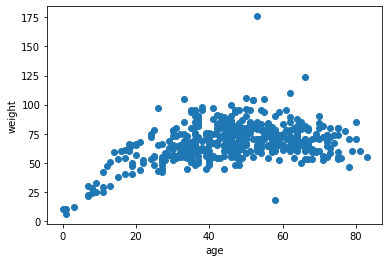

In [11]:
plt.scatter(data_raw['age'], data_raw['weight'])
plt.xlabel('age')
plt.ylabel('weight')
pass

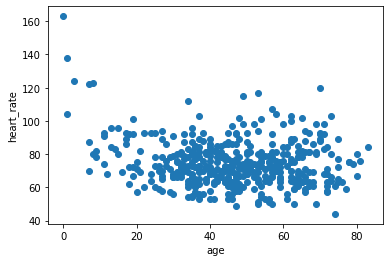

In [12]:
plt.scatter(data_raw['age'], data_raw['heart_rate'])
plt.xlabel('age')
plt.ylabel('heart_rate')
pass

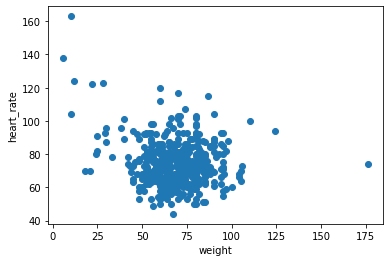

In [13]:
plt.scatter(data_raw['weight'], data_raw['heart_rate'])
plt.xlabel('weight')
plt.ylabel('heart_rate')
pass

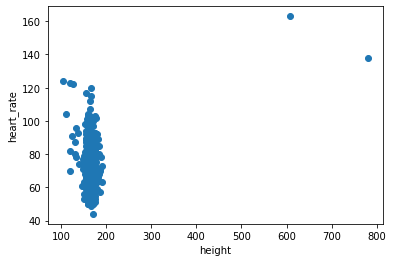

In [14]:
plt.scatter(data_raw['height'], data_raw['heart_rate'])
plt.xlabel('height')
plt.ylabel('heart_rate')
pass

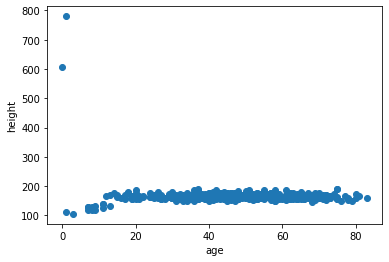

In [15]:
plt.scatter(data_raw['age'], data_raw['height'])
plt.xlabel('age')
plt.ylabel('height')
pass

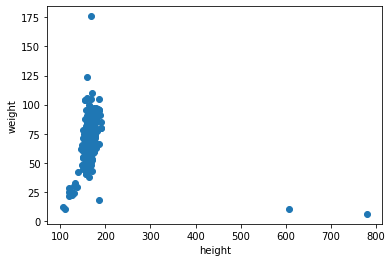

In [16]:
plt.scatter(data_raw['height'], data_raw['weight'])
plt.xlabel('height')
plt.ylabel('weight')
pass

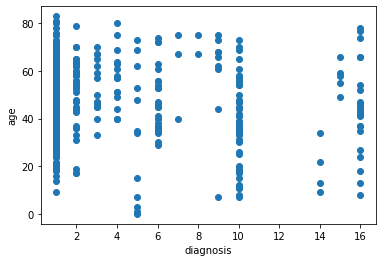

In [17]:
plt.scatter(data_raw['diagnosis'], data_raw['age'])
plt.xlabel('diagnosis')
plt.ylabel('age')
pass

In [18]:
data_raw['diagnosis'].quantile([0.005,.01,.05,.1,.5,.9,.95,.99,.995])

0.005     1.0
0.010     1.0
0.050     1.0
0.100     1.0
0.500     1.0
0.900    10.0
0.950    15.0
0.990    16.0
0.995    16.0
Name: diagnosis, dtype: float64

In [19]:
data_raw['age'].quantile([0.005,.01,.05,.1,.5,.9,.95,.99,.995])

0.005     1.51
0.010     7.00
0.050    17.00
0.100    26.00
0.500    47.00
0.900    67.00
0.950    72.00
0.990    78.49
0.995    80.00
Name: age, dtype: float64

In [20]:
data_raw.describe()

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
count,452.000000,452.000000,452.000000,452.000000,452.000000,452.000000,452.000000,452.000000,452.000000,452.000000,...,452.000000,452.000000,452.000000,452.000000,452.0,452.000000,452.000000,452.000000,452.000000,452.000000
mean,46.471239,0.550885,166.188053,68.170354,88.920354,155.152655,367.207965,169.949115,90.004425,33.676991,...,-0.278982,9.048009,-1.457301,0.003982,0.0,0.514823,1.222345,19.326106,29.473230,3.880531
std,16.466631,0.497955,37.170340,16.590803,15.364394,44.842283,33.385421,35.633072,25.826643,45.431434,...,0.548876,3.472862,2.002430,0.050118,0.0,0.347531,1.426052,13.503922,18.493927,4.407097
min,0.000000,0.000000,105.000000,6.000000,55.000000,0.000000,232.000000,108.000000,0.000000,-172.000000,...,-4.100000,0.000000,-28.600000,0.000000,0.0,-0.800000,-6.000000,-44.200000,-38.600000,1.000000
25%,36.000000,0.000000,160.000000,59.000000,80.000000,142.000000,350.000000,148.000000,79.000000,3.750000,...,-0.425000,6.600000,-2.100000,0.000000,0.0,0.400000,0.500000,11.450000,17.550000,1.000000
50%,47.000000,1.000000,164.000000,68.000000,86.000000,157.000000,367.000000,162.000000,91.000000,40.000000,...,0.000000,8.800000,-1.100000,0.000000,0.0,0.500000,1.350000,18.100000,27.900000,1.000000
75%,58.000000,1.000000,170.000000,79.000000,94.000000,175.000000,384.000000,179.000000,102.000000,66.000000,...,0.000000,11.200000,0.000000,0.000000,0.0,0.700000,2.100000,25.825000,41.125000,6.000000
max,83.000000,1.000000,780.000000,176.000000,188.000000,524.000000,509.000000,381.000000,205.000000,169.000000,...,0.000000,23.600000,0.000000,0.800000,0.0,2.400000,6.000000,88.800000,115.900000,16.000000


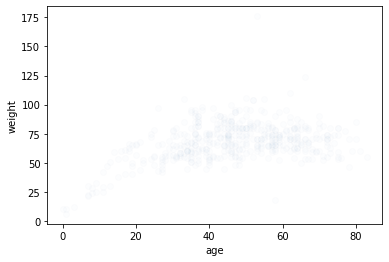

In [21]:
plt.scatter(data_raw['age'], data_raw['weight'], alpha=0.01)
plt.xlabel('age')
plt.ylabel('weight')
pass

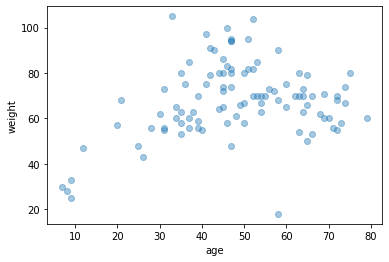

In [22]:
np.random.seed(42)
random_subset = np.random.choice(np.arange(data_raw.shape[0]), size=100, replace=False)
plt.scatter(data_raw.iloc[random_subset]['age'], data_raw.iloc[random_subset]['weight'], alpha=0.4)
plt.xlabel('age')
plt.ylabel('weight')
pass

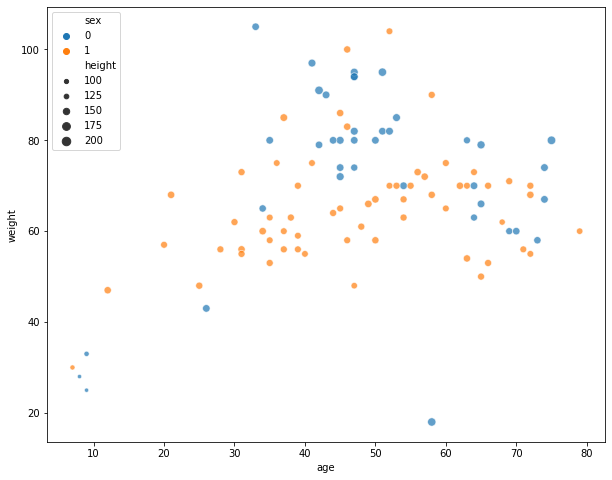

In [23]:
plt.figure(figsize = (10, 8))
sns.scatterplot(x='age', y='weight', size='height', hue='sex', data=data_raw.iloc[random_subset], alpha=0.7)
pass

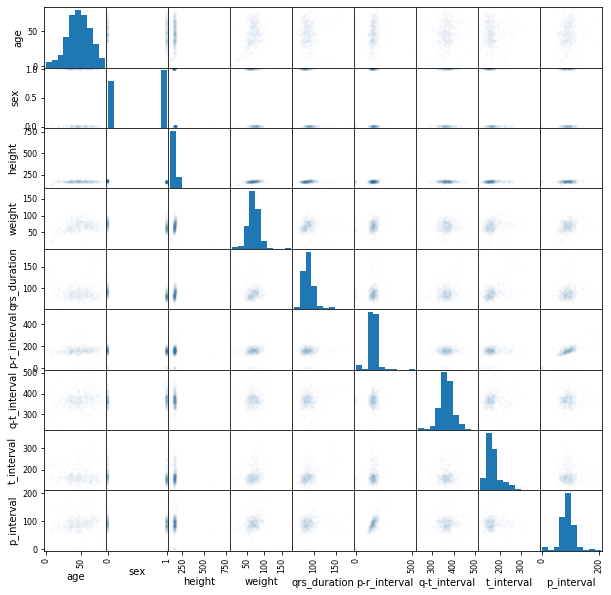

In [24]:
from pandas.plotting import scatter_matrix
scatter_matrix(data_raw.loc[:,:'p_interval'], alpha = .01, figsize = (10, 10))
pass

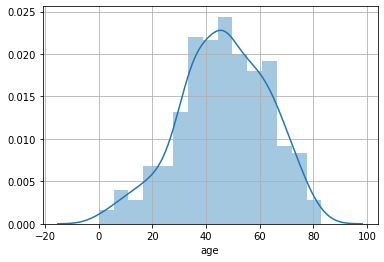

In [25]:
sns.distplot(data_raw['age'], bins=15)
plt.grid()
pass

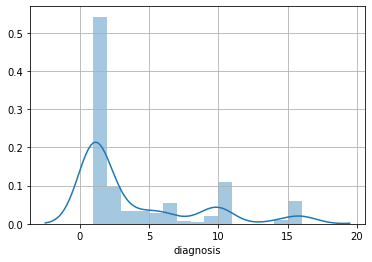

In [26]:
sns.distplot(data_raw['diagnosis'], bins=15)
plt.grid()
pass

H:\Anaconda\lib\site-packages\pandas\plotting\_matplotlib\misc.py:80: UserWarning: Attempting to set identical left == right == 0.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[j])
H:\Anaconda\lib\site-packages\pandas\plotting\_matplotlib\misc.py:81: UserWarning: Attempting to set identical bottom == top == 0.0 results in singular transformations; automatically expanding.
  ax.set_ylim(boundaries_list[i])
H:\Anaconda\lib\site-packages\pandas\plotting\_matplotlib\misc.py:71: UserWarning: Attempting to set identical left == right == 0.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[i])


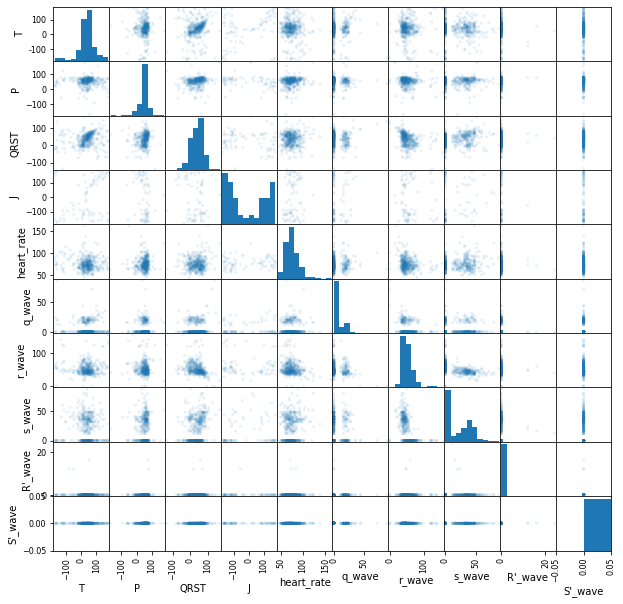

In [27]:
scatter_matrix(data_raw.iloc[:, 10:20], alpha = .1, figsize = (10, 10))
pass

In [28]:
data_raw.diagnosis.value_counts()

1     245
10     50
2      44
6      25
16     22
4      15
3      15
5      13
9       9
15      5
14      4
7       3
8       2
Name: diagnosis, dtype: int64

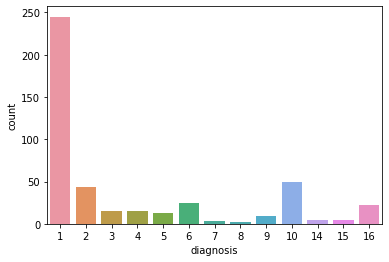

In [29]:
sns.countplot(x='diagnosis', data=data_raw)
pass

In [30]:
corr_mat = data_raw.corr()
corr_mat

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
age,1.000000,-0.059042,-0.109458,0.381555,-0.004032,0.041149,0.195691,0.025654,0.099755,-0.265868,...,0.164816,-0.158009,0.082376,0.090413,NaN,-0.037877,-0.271504,0.018043,-0.199728,-0.092381
sex,-0.059042,1.000000,-0.124685,-0.248104,-0.337101,-0.046771,0.072052,-0.184736,-0.081051,0.069434,...,0.230938,-0.042638,0.092879,0.027401,NaN,0.014210,0.065684,0.031688,0.046605,-0.178080
height,-0.109458,-0.124685,1.000000,-0.074957,-0.006329,0.013601,-0.237314,-0.038411,0.029025,0.061539,...,-0.018876,-0.073439,-0.091361,-0.002545,NaN,0.067670,-0.008471,-0.090370,-0.092235,0.006648
weight,0.381555,-0.248104,-0.074957,1.000000,0.100094,0.119826,0.118657,0.149987,0.120668,-0.173355,...,0.050471,-0.026926,0.051946,0.047448,NaN,-0.046278,-0.144721,0.062285,-0.050682,-0.090151
qrs_duration,-0.004032,-0.337101,-0.006329,0.100094,1.000000,0.021831,0.218681,0.397435,0.049682,-0.146043,...,-0.198941,0.091384,-0.228688,-0.013697,NaN,-0.065596,-0.222170,0.129796,-0.082791,0.323879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LD,-0.037877,0.014210,0.067670,-0.046278,-0.065596,0.143272,-0.034971,0.049175,0.248092,0.082009,...,-0.085446,-0.008013,-0.092069,-0.019946,NaN,1.000000,-0.043307,-0.069852,-0.064171,-0.086427
LE,-0.271504,0.065684,-0.008471,-0.144721,-0.222170,0.061160,-0.038884,-0.184846,0.016054,0.063300,...,0.116959,0.093749,-0.072408,-0.017690,NaN,-0.043307,1.000000,-0.124004,0.687877,-0.030798
LF,0.018043,0.031688,-0.090370,0.062285,0.129796,-0.027691,0.256200,0.130202,-0.016365,0.297780,...,0.002630,0.671383,0.562825,-0.051131,NaN,-0.069852,-0.124004,1.000000,0.611219,0.003476
LG,-0.199728,0.046605,-0.092235,-0.050682,-0.082791,0.021048,0.150979,-0.014430,0.004283,0.255203,...,0.082538,0.560374,0.341484,-0.049667,NaN,-0.064171,0.687877,0.611219,1.000000,-0.009275


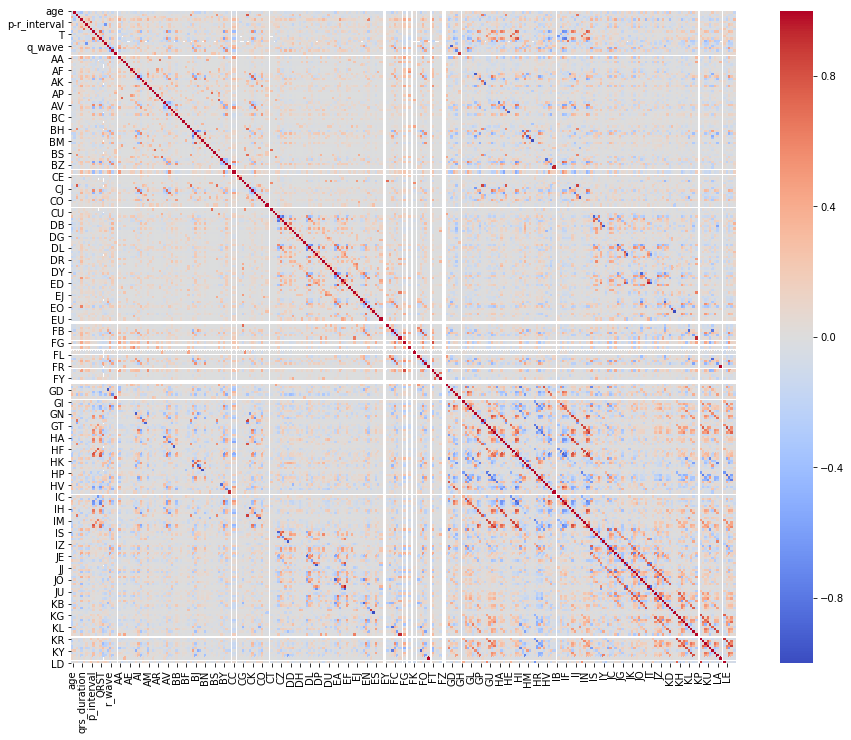

In [31]:
plt.figure(figsize = (16, 12))
sns.heatmap(corr_mat, square=True, vmin=-1, vmax=1, cmap='coolwarm')
pass

In [32]:
corr_mat.where(np.triu(np.abs(corr_mat) > 0.85, k=1)).stack().sort_values(ascending=False)

FR       LB    0.997769
ED       JS    0.966664
CA       IA    0.941517
FE       KO    0.933495
BL       HN    0.932293
HB       II    0.922657
HH       IO    0.917264
GO       II    0.913032
R'_wave  GG    0.909704
KR       LD    0.898566
HI       IP    0.887449
KU       LG    0.881998
EP       KE    0.881401
GY       IP    0.880143
KM       KZ    0.879162
CI       IK    0.871637
GV       IO    0.865314
KJ       KU    0.865112
GT       IM    0.864746
KS       LE    0.864417
JI       JT    0.856527
CI       GR    0.850711
HI       IF   -0.852363
EM       KB   -0.852971
CJ       IH   -0.859675
FN       KY   -0.871324
DK       JE   -0.874844
GU       HR   -0.876092
ED       JT   -0.877766
JS       JT   -0.880695
DZ       JO   -0.887884
HR       LE   -0.889263
AL       GS   -0.894083
CY       IS   -0.899971
HH       IE   -0.900113
BK       HM   -0.917582
AH       GN   -0.932623
q_wave   GD   -0.936717
AB'      HE   -0.940529
DO       JI   -0.953208
DC       IY   -0.957753
CN       IL   -0

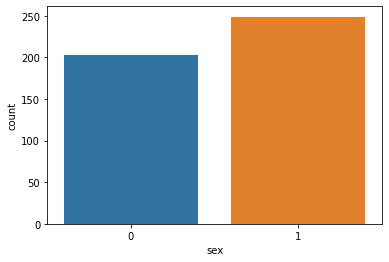

In [33]:
sns.countplot(x='sex', data=data_raw)
pass

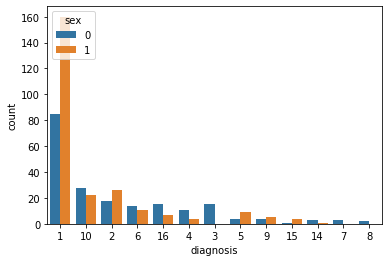

In [34]:
sns.countplot(x='diagnosis', order=data_raw.diagnosis.value_counts().index, hue='sex', data=data_raw)
pass

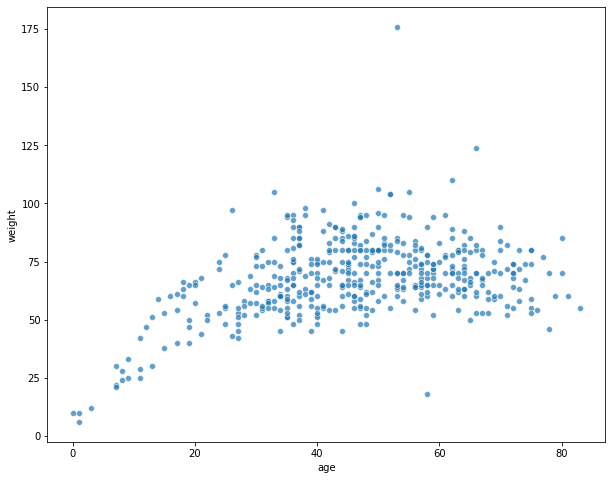

In [35]:
plt.figure(figsize = (10, 8))
sns.scatterplot(x='age', y='weight', data=data_raw, alpha=0.7)
pass

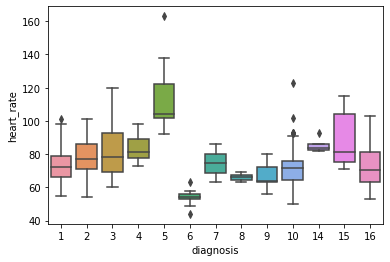

In [36]:
sns.boxplot(x="diagnosis", y="heart_rate", data=data_raw)
pass

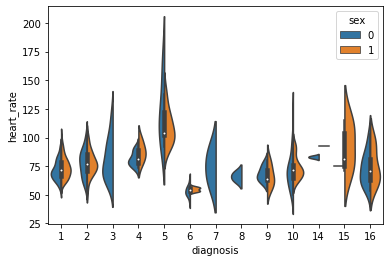

In [37]:
sns.violinplot(x="diagnosis", y="heart_rate", hue='sex', split=True, data=data_raw)
pass

In [38]:
categorical_columns = [c for c in data_raw.columns if data_raw[c].dtype.name == 'object']
numerical_columns   = [c for c in data_raw.columns if data_raw[c].dtype.name != 'object']
print(categorical_columns)
print(numerical_columns)

[]
['age', 'sex', 'height', 'weight', 'qrs_duration', 'p-r_interval', 'q-t_interval', 't_interval', 'p_interval', 'qrs', 'T', 'P', 'QRST', 'J', 'heart_rate', 'q_wave', 'r_wave', 's_wave', "R'_wave", "S'_wave", 'AA', 'AB', 'AC', 'AD', 'AE', 'AF', 'AG', 'AH', 'AI', 'AJ', 'AK', 'AL', 'AM', 'AN', 'AO', 'AP', 'AR', 'AS', 'AT', 'AU', 'AV', 'AY', 'AZ', "AB'", 'BB', 'BC', 'BD', 'BE', 'BF', 'BG', 'BH', 'BI', 'BJ', 'BK', 'BL', 'BM', 'BN', 'BO', 'BP', 'BR', 'BS', 'BT', 'BU', 'BV', 'BY', 'BZ', 'CA', 'CB', 'CC', 'CD', 'CE', 'Cf', 'CG', 'CH', 'CI', 'CJ', 'CK', 'CL', 'CM', 'CN', 'CO', 'CP', 'CR', 'CS', 'CT', 'CU', 'CV', 'CY', 'CZ', 'DA', 'DB', 'DC', 'DD', 'DE', 'DF', 'DG', 'DH', 'DI', 'DJ', 'DK', 'DL', 'DM', 'DN', 'DO', 'DP', 'DR', 'DS', 'DT', 'DU', 'DV', 'DY', 'DZ', 'EA', 'EB', 'EC', 'ED', 'EF', 'EG', 'EH', 'EI', 'EJ', 'EK', 'EL', 'EM', 'EN', 'EO', 'EP', 'ER', 'ES', 'ET', 'EU', 'EV', 'EY', 'EZ', 'FA', 'FB', 'FC', 'FD', 'FE', 'FF', 'FG', 'FH', 'FI', 'FJ', 'FK', 'FL', 'FM', 'FN', 'FO', 'FP', 'FR', 'FS

In [39]:
df = data_raw.iloc[:4, 9:14]
df

,qrs,T,P,QRST,J
0,-16,13.0,64.0,-2.0,NaN
1,25,37.0,-17.0,31.0,NaN
2,96,34.0,70.0,66.0,23.0
3,28,11.0,-5.0,20.0,NaN


In [40]:
data_raw.fillna(data_raw.median(axis = 0), axis=0 , inplace=True)

In [41]:
X = data_raw.drop('diagnosis', axis = 1)
y = data_raw['diagnosis']
feature_names = X.columns

In [42]:
type(feature_names)

pandas.core.indexes.base.Index

In [43]:
feature_names

Index(['age', 'sex', 'height', 'weight', 'qrs_duration', 'p-r_interval',
       'q-t_interval', 't_interval', 'p_interval', 'qrs',
       ...
       'KV', 'KY', 'KZ', 'LA', 'LB', 'LC', 'LD', 'LE', 'LF', 'LG'],
      dtype='object', length=279)

In [44]:
data_raw.fillna(data_raw.median(axis = 0), axis=0 , inplace=True)

In [45]:
X = X.to_numpy()

In [46]:
y = np.array(y != 1, dtype='int')

In [47]:
print(X.shape)
print(y.shape)
N, d = X.shape

(452, 279)
(452,)


In [48]:
type(X)

numpy.ndarray

In [49]:
data_raw.fillna(data_raw.median(axis = 0), axis=0 , inplace=True)

In [50]:
df = data_raw.iloc[:4, 11:14]
df

,P,QRST,J
0,64.0,-2.0,-50.5
1,-17.0,31.0,-50.5
2,70.0,66.0,23.0
3,-5.0,20.0,-50.5


In [51]:
type(y)

numpy.ndarray

In [52]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

N_train, _ = X_train.shape 
N_test,  _ = X_test.shape 

print(N_train, N_test)

316 136


In [53]:
data_raw.fillna(data_raw.median(axis = 0), axis=0 , inplace=True)

In [54]:
print(X_train)

[[ 64.    0.  160.  ...   1.1  16.4  26.3]
 [ 17.    0.  170.  ...  -1.7  29.6   9.6]
 [ 80.    0.  173.  ...  -0.4  24.1  19.7]
 ...
 [ 34.    1.  165.  ...   0.8   1.9   8.1]
 [ 39.    1.  164.  ...   1.3  24.1  33.7]
 [ 19.    1.  157.  ...   1.3   9.4  17.9]]


In [55]:
np.where(np.isnan(X))

(array([], dtype=int64), array([], dtype=int64))

In [56]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_train, y_train)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    y_train_predict = knn.predict(X_train)
    err_train  = np.mean(y_train  != y_train_predict)
    #print(y_test_predict,y_train_predict)
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_train,y_train_predict))
    print("Mera F1 Train:",f1_score(y_train,y_train_predict))
    print("Precision Score Train: ",precision_score(y_train, y_train_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_train, y_train_predict, pos_label='positive',average='micro'))
    i=i+1

neighbours = 2 err_train = 0.22468354430379747 err_test = 0.4264705882352941
[[176   0]
 [ 71  69]]
Mera F1 Train: 0.6602870813397129
Precision Score Train:  0.7753164556962026
Recall Score Train:  0.7753164556962026
neighbours = 3 err_train = 0.16455696202531644 err_test = 0.39705882352941174
[[167   9]
 [ 43  97]]
Mera F1 Train: 0.7886178861788617
Precision Score Train:  0.8354430379746836
Recall Score Train:  0.8354430379746836
neighbours =

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)
H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


 5 err_train = 0.23417721518987342 err_test = 0.4485294117647059
[[165  11]
 [ 63  77]]
Mera F1 Train: 0.6754385964912282
Precision Score Train:  0.7658227848101266
Recall Score Train:  0.7658227848101266
neighbours = 7 err_train = 0.26582278481012656 err_test = 0.45588235294117646
[[166  10]
 [ 74  66]]
Mera F1 Train: 0.6111111111111112
Precision Score Train:  0.7341772151898734
Recall Score Train:  0.7341772151898734
neighbours =

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)
H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


 10 err_train = 0.3291139240506329 err_test = 0.45588235294117646
[[174   2]
 [102  38]]
Mera F1 Train: 0.4222222222222222
Precision Score Train:  0.6708860759493671
Recall Score Train:  0.6708860759493671
neighbours = 15 err_train = 0.31962025316455694 err_test = 0.4485294117647059
[[174   2]
 [ 99  41]]
Mera F1 Train: 0.4480874316939891
Precision Score Train:  0.680379746835443
Recall Score Train:  0.680379746835443
neighbours = 20 err_train = 0.37341772151898733 err_test = 0.4632352941176471


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)
H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


[[175   1]
 [117  23]]
Mera F1 Train: 0.28048780487804875
Precision Score Train:  0.6265822784810127
Recall Score Train:  0.6265822784810127
neighbours = 50 err_train = 0.43037974683544306 err_test = 0.47058823529411764
[[176   0]
 [136   4]]
Mera F1 Train: 0.05555555555555556
Precision Score Train:  0.569620253164557
Recall Score Train:  0.569620253164557


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)
H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


neighbours = 100 err_train = 0.4430379746835443 err_test = 0.49264705882352944
[[176   0]
 [140   0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5569620253164557
Recall Score Train:  0.5569620253164557


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [57]:
from sklearn.linear_model import SGDClassifier
sgd_clf = SGDClassifier(random_state=42)
sgd_clf.fit(X_train, y_train)

SGDClassifier(random_state=42)

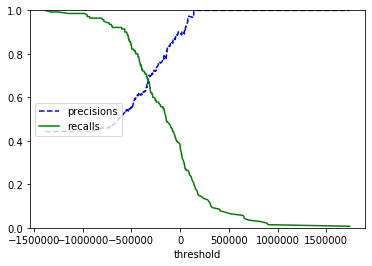

In [58]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import precision_recall_curve
y_scores = cross_val_predict(sgd_clf,X_train,y_train,cv=3,method="decision_function")
precisions,recalls,thresholds=precision_recall_curve(y_train,y_scores)
def plot_precision_recall_vs_threshold(precisions,recalls,thresholds):
    plt.plot(thresholds,precisions[:-1],"b--",label="precisions") #tochnost
    plt.plot(thresholds,recalls[:-1],"g-",label="recalls") #polnota
    plt.xlabel("threshold")#porog
    plt.legend(loc="center left")
    plt.ylim([0,1])
plot_precision_recall_vs_threshold(precisions,recalls,thresholds)
plt.show()

Text(0, 0.5, 'precisions')

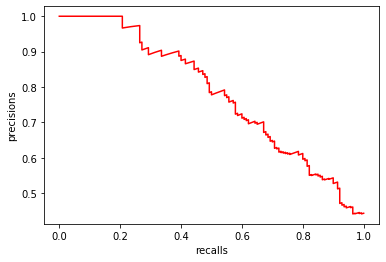

In [59]:
plt.plot(recalls,precisions,"r-")
plt.xlabel("recalls")
plt.ylabel("precisions")

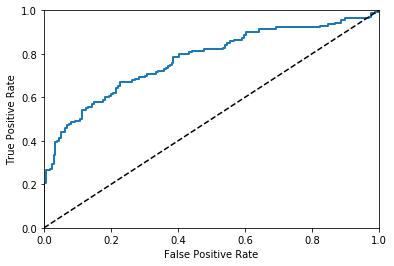

In [60]:
from sklearn.metrics import roc_curve
fpr,tpr,thresholds= roc_curve(y_train, y_scores)
def plot_roc_curve(fpr,tpr,label=None):
    plt.plot(fpr,tpr,linewidth=2 , label=label )
    plt.plot([0,1],[0,1],'k--')
    plt.axis([0,1,0,1])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
plot_roc_curve (fpr,tpr)
plt.show()

In [61]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_train,y_scores)

0.7742288961038961

In [62]:
from sklearn.ensemble import RandomForestClassifier
forest_clf = RandomForestClassifier(random_state=42 )
y_probas_forest = cross_val_predict(forest_clf,X_train,y_train,cv=3,method="predict_proba") 

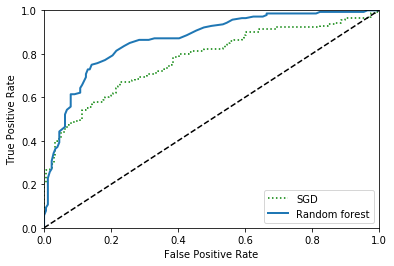

In [63]:
y_scores_forest=y_probas_forest[:,1]
fpr_forest,tpr_forest,thresholds_forest=roc_curve(y_train,y_scores_forest)
plt.plot(fpr,tpr,"g:",label="SGD")
plot_roc_curve(fpr_forest,tpr_forest,"Random forest")
plt.legend(loc="lower right")
plt.show()

In [64]:
roc_auc_score(y_train,y_scores_forest)

0.8653814935064935

In [65]:
X_train

array([[ 64. ,   0. , 160. , ...,   1.1,  16.4,  26.3],
       [ 17. ,   0. , 170. , ...,  -1.7,  29.6,   9.6],
       [ 80. ,   0. , 173. , ...,  -0.4,  24.1,  19.7],
       ...,
       [ 34. ,   1. , 165. , ...,   0.8,   1.9,   8.1],
       [ 39. ,   1. , 164. , ...,   1.3,  24.1,  33.7],
       [ 19. ,   1. , 157. , ...,   1.3,   9.4,  17.9]])

In [66]:
y_train

array([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1,
       0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0,
       1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1,
       0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1,
       0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1,

In [67]:
X_test

array([[ 51. ,   0. , 170. , ...,   2.6,  23.7,  47.6],
       [ 45. ,   0. , 175. , ...,   1. ,  10.5,  17.9],
       [ 31. ,   1. , 165. , ...,   0.9,   9.6,  14.4],
       ...,
       [ 35. ,   1. , 155. , ...,   0.8,  11.5,  15.5],
       [ 34. ,   0. , 170. , ...,   2.6,  44. ,  68.4],
       [ 49. ,   1. , 162. , ...,   0.5,  15.8,  19.8]])

In [68]:
y_test

array([0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0,
       1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0,
       1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
       0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1,
       1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0,
       1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1,
       0, 0, 1, 0])

In [69]:
from sklearn.svm import SVC
svc = SVC(gamma='auto')
svc.fit(X_train, y_train)

err_train = np.mean(y_train != svc.predict(X_train))
err_test  = np.mean(y_test  != svc.predict(X_test))

print(err_train, err_test)

0.0 0.49264705882352944


# Plural

In [70]:
X = data_raw.drop('diagnosis', axis = 1)
#X = data.dropna
#X = data.drop('Class', axis = 1)# выбрасываем столбец 'class'
y = data_raw['diagnosis']
feature_names = X.columns

In [71]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)


In [72]:
type(X)

pandas.core.frame.DataFrame

In [73]:
some_digit = X.loc[0]

In [74]:
some_digit

age              75.0
sex               0.0
height          190.0
weight           80.0
qrs_duration     91.0
                ...  
LC                0.0
LD                0.9
LE                2.9
LF               23.3
LG               49.4
Name: 0, Length: 279, dtype: float64

In [75]:
y.loc[0]

8

In [76]:
sgd_clf.fit(X_train, y_train)
sgd_clf.predict([some_digit])

array([10], dtype=int64)

предсказание SGDClassifier выдало 10 вместо 8?

In [77]:
some_digit_scores = sgd_clf.decision_function([some_digit])
some_digit_scores 

array([[ -152017.08684742, -1013087.01888318, -1139968.97187583,
         -556231.9610083 ,  -804842.8019646 ,  -524132.61242644,
         -167812.91448254,  -730362.67242948, -1094813.74983989,
          -84382.52229497,  -550609.43513032,  -380564.22894608,
         -448780.1042127 ]])

максимальное число 10, т.е тоже ошибка?

In [78]:
sgd_clf.classes_

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 14, 15, 16], dtype=int64)

отсутсвуют классы 11,12,13

In [79]:
sgd_clf.classes_[5]

6

In [80]:
from sklearn.multiclass import OneVsOneClassifier
ovo_clf = OneVsOneClassifier(SGDClassifier(random_state=42))
ovo_clf.fit(X_train,y_train)
ovo_clf.predict([some_digit]) 

array([1], dtype=int64)

neighbours = 2 err_train = 0.27848101265822783 err_test = 0.4485294117647059
[[176   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 17  16   0   0   0   0   0   0   0   0   0   0   0]
 [  2   0   6   0   0   0   0   0   0   0   0   0   0]
 [  6   1   0   5   0   0   0   0   0   0   0   0   0]
 [  4   0   0   1   4   0   0   0   0   0   0   0   0]
 [ 11   0   0   0   0   4   0   0   0   0   0   0   0]
 [  2   1   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   7   0   0   0   0]
 [ 19   1   0   0   0   3   0   0   0   8   0   0   0]
 [  0   1   0   0   0   0   0   0   0   0   0   0   0]
 [  0   1   0   0   0   0   0   0   0   1   0   2   0]
 [  8   1   1   1   0   1   0   0   0   2   0   1   0]]


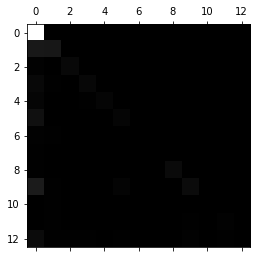

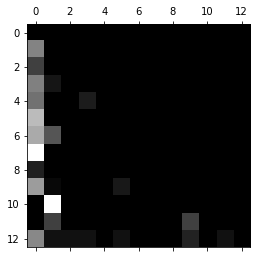

Mera F1 Train: 0.7215189873417721
Precision Score Train:  0.7215189873417721
Recall Score Train:  0.7215189873417721
neighbours = 3 err_train = 0.29430379746835444 err_test = 0.41911764705882354
[[173   1   0   1   0   1   0   0   0   0   0   0   0]
 [ 19  13   0   0   0   0   0   0   0   0   0   1   0]
 [  2   0   6   0   0   0   0   0   0   0   0   0   0]
 [  6   0   0   6   0   0   0   0   0   0   0   0   0]
 [  6   0   0   0   2   0   0   0   0   1   0   0   0]
 [ 11   0   0   0   0   4   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   1   0   0   6   0   0   0   0]
 [ 19   1   0   0   0   0   0   0   0  11   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  2   0   0   0   0   0   0   0   0   0   0   2   0]
 [ 11   1   1   0   1   1   0   0   0   0   0   0   0]]


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


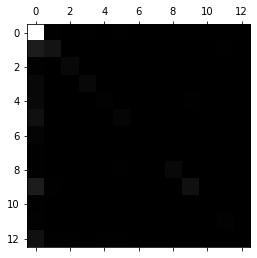

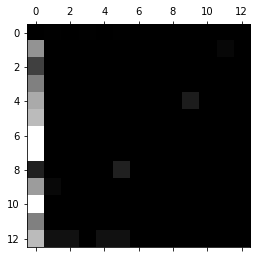

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


Mera F1 Train: 0.7056962025316456
Precision Score Train:  0.7056962025316456
Recall Score Train:  0.7056962025316456
neighbours = 5 err_train = 0.31962025316455694 err_test = 0.4411764705882353
[[172   3   0   0   0   0   0   0   0   1   0   0   0]
 [ 19  14   0   0   0   0   0   0   0   0   0   0   0]
 [  2   0   6   0   0   0   0   0   0   0   0   0   0]
 [  9   0   0   3   0   0   0   0   0   0   0   0   0]
 [  6   0   0   0   2   0   0   0   0   1   0   0   0]
 [ 14   0   0   0   0   1   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   7   0   0   0   0]
 [ 22   0   0   0   0   1   0   0   0   8   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   1   0   0   0   0   0   0   0   0   0   2   0]
 [ 10   3   1   0   0   1   0   0   0   0   0   0   0]]


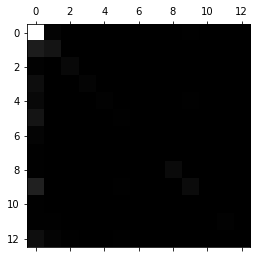

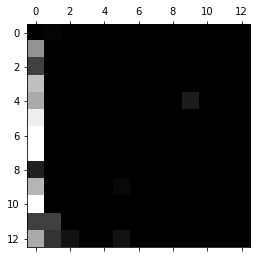

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


Mera F1 Train: 0.680379746835443
Precision Score Train:  0.680379746835443
Recall Score Train:  0.680379746835443
neighbours = 7 err_train = 0.36075949367088606 err_test = 0.4411764705882353
[[174   2   0   0   0   0   0   0   0   0   0   0   0]
 [ 24   8   0   0   0   0   0   0   0   1   0   0   0]
 [  3   1   4   0   0   0   0   0   0   0   0   0   0]
 [ 10   0   0   2   0   0   0   0   0   0   0   0   0]
 [  6   0   0   0   2   0   0   0   0   1   0   0   0]
 [ 14   0   0   0   0   1   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  2   0   0   0   0   1   0   0   5   0   0   0   0]
 [ 27   0   0   0   0   0   0   0   0   4   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   1   0   0   0   0   0   0   0   0   0   2   0]
 [ 12   3   0   0   0   0   0   0   0   0   0   0   0]]


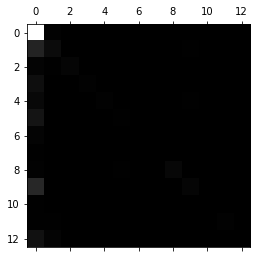

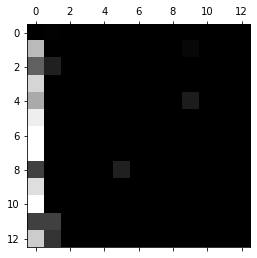

Mera F1 Train: 0.6392405063291139
Precision Score Train:  0.6392405063291139
Recall Score Train:  0.6392405063291139
neighbours = 10 err_train = 0.41139240506329117 err_test = 0.45588235294117646
[[175   1   0   0   0   0   0   0   0   0   0   0   0]
 [ 27   5   0   0   0   0   0   0   0   1   0   0   0]
 [  4   1   3   0   0   0   0   0   0   0   0   0   0]
 [ 12   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   1   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   0   0   0   0   0   0   0   3   1   0   0   0]
 [ 31   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 14   1   0   0   0   0   0   0   0   0   0   0   0]]


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


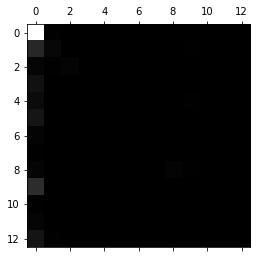

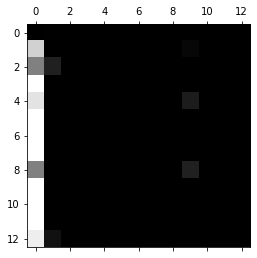

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


Mera F1 Train: 0.5886075949367089
Precision Score Train:  0.5886075949367089
Recall Score Train:  0.5886075949367089
neighbours = 15 err_train = 0.43354430379746833 err_test = 0.4632352941176471
[[175   1   0   0   0   0   0   0   0   0   0   0   0]
 [ 32   1   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 12   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   1   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   1   0   0   0   0   0   0   3   0   0   0   0]
 [ 31   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]]


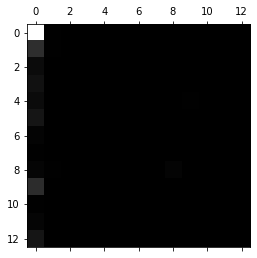

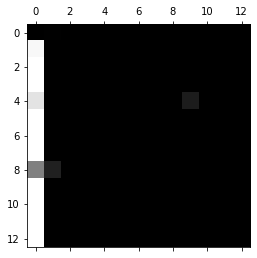

Mera F1 Train: 0.5664556962025317
Precision Score Train:  0.5664556962025317
Recall Score Train:  0.5664556962025317
neighbours = 20 err_train = 0.439873417721519 err_test = 0.47794117647058826
[[176   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 32   1   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 12   0   0   0   0   0   0   0   0   0   0   0   0]
 [  9   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 31   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]]


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


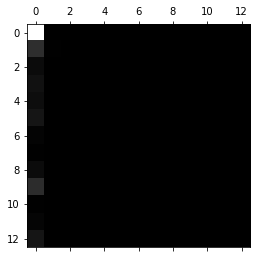

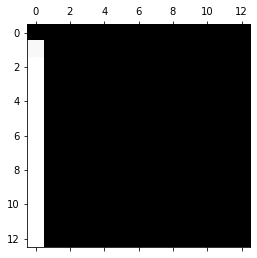

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


Mera F1 Train: 0.560126582278481
Precision Score Train:  0.560126582278481
Recall Score Train:  0.560126582278481
neighbours = 50 err_train = 0.4430379746835443 err_test = 0.49264705882352944
[[176   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 33   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 12   0   0   0   0   0   0   0   0   0   0   0   0]
 [  9   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 31   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]]


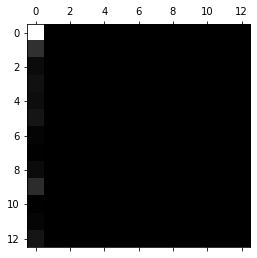

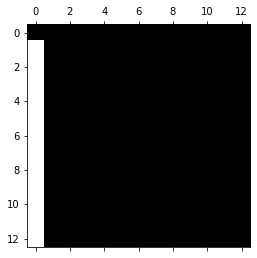

H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


Mera F1 Train: 0.5569620253164557
Precision Score Train:  0.5569620253164557
Recall Score Train:  0.5569620253164557
neighbours = 100 err_train = 0.4430379746835443 err_test = 0.49264705882352944
[[176   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 33   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 12   0   0   0   0   0   0   0   0   0   0   0   0]
 [  9   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]
 [  3   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  8   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 31   0   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0   0   0   0   0   0   0   0   0]
 [  4   0   0   0   0   0   0   0   0   0   0   0   0]
 [ 15   0   0   0   0   0   0   0   0   0   0   0   0]]


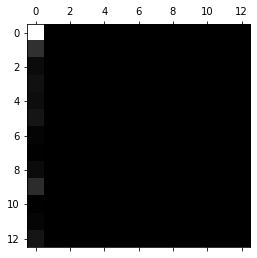

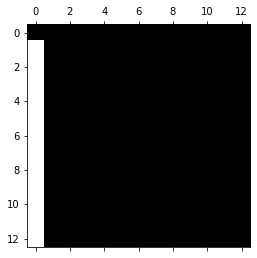

Mera F1 Train: 0.5569620253164557
Precision Score Train:  0.5569620253164557
Recall Score Train:  0.5569620253164557


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [81]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_train, y_train)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    y_train_predict = knn.predict(X_train)
    err_train  = np.mean(y_train  != y_train_predict)
    #print(y_test_predict,y_train_predict)
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_train,y_train_predict))
    confmx=confusion_matrix(y_train,y_train_predict)
    plt.matshow(confusion_matrix(y_train,y_train_predict),cmap=plt.cm.gray)
    plt.show()
    row_sums = confmx.sum ( axis=1 , keepdims=True )
    norm_conf_mx = confmx / row_sums 
    np.fill_diagonal (norm_conf_mx, 0 )
    plt.matshow ( norm_conf_mx, cmap=plt.cm.gray)
    plt.show ()
    print("Mera F1 Train:",f1_score(y_train,y_train_predict,pos_label='positive',average='micro'))
    print("Precision Score Train: ",precision_score(y_train, y_train_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_train, y_train_predict, pos_label='positive',average='micro'))
    i=i+1

на первом графике матрицы неточностей в виде изображения не все изображения на главной диагонали, что уже говорит о неточной классификации, далее ситуация хуже

In [82]:
from sklearn.linear_model import SGDClassifier
sgd_clf = SGDClassifier(random_state=42)
sgd_clf.fit(X_train, y_train)

SGDClassifier(random_state=42)

In [83]:
forest_clf.fit(X_train,y_train)
forest_clf.predict([some_digit]) 

array([1], dtype=int64)

In [84]:
forest_clf.fit(X_train,y_train)
forest_clf.predict((X_train)) 

array([ 2,  2,  4,  1,  1,  6,  2,  6, 10,  1,  1, 16,  5,  5,  1,  2,  2,
        1,  1,  1, 10,  2,  1,  1,  3,  4,  1,  4,  1,  1, 10,  2,  1,  1,
        1,  1,  9,  1, 16,  1,  8,  1,  1,  1,  1,  2,  1,  1,  1,  1,  1,
       10,  1,  1,  1,  1,  1,  1,  1,  2,  3,  1,  1,  1,  1,  1,  1,  9,
        1, 16, 10,  2,  1,  1,  9,  1,  1,  3,  1, 10,  1, 16,  1,  6,  1,
        1, 10,  1,  1,  2,  1,  1,  2,  6,  1, 10, 10,  1,  4,  1,  1,  1,
        6,  1,  1,  5,  1,  1, 10,  1, 10,  1,  1,  1,  1,  2, 16, 16,  1,
        3,  1,  6, 10, 16,  5,  1,  1,  1,  2,  1,  1,  2,  1, 10,  1,  6,
        1,  1, 16,  5,  1,  1,  1, 10,  1,  1, 10,  5,  1,  1,  2,  1,  1,
        1,  1,  1,  6,  9,  1,  2,  1, 10,  1,  2,  1,  1,  3, 10,  1,  1,
        1,  1,  2, 10,  1,  1,  1,  1,  1,  1,  2,  7,  2,  1,  4,  1, 16,
        2,  1,  1,  1,  1,  5,  1,  1,  1,  7,  2,  1, 10, 16,  1,  1,  1,
        1,  6,  1,  1,  1,  1, 10,  1, 10,  1,  1, 15,  1,  1,  1,  1,  9,
        2,  1,  1,  1,  1

In [85]:
forest_clf.fit(X_test,y_test)
forest_clf.predict([some_digit]) 

array([8], dtype=int64)

In [86]:
forest_clf.fit(X_test,y_test)
forest_clf.predict(X_test) 

array([ 1,  6, 10, 16,  6,  1,  1,  1,  3,  6,  1,  1,  1,  9,  1,  6, 14,
       16,  1,  2,  2,  1,  4,  1,  3,  3,  1,  1, 10, 16, 10,  2, 10,  1,
        1,  3, 10,  1,  1,  1, 10,  1,  6,  1, 15, 10,  6,  1, 16,  1,  2,
        1,  1, 10,  1, 10,  1,  1,  1,  1, 10,  8,  1,  1, 10,  1,  1,  1,
       10,  1,  3,  1, 16,  1,  2,  2,  1, 10, 10, 16,  1,  1, 10,  1,  5,
        1,  1, 10,  5,  1,  2,  1,  1,  2,  1,  3,  1,  6,  1,  1,  4, 16,
       10,  1,  5,  6,  1,  1,  6,  1, 14,  4,  2,  1,  1,  1, 10,  1,  1,
        2,  1,  1,  1,  5,  1,  1, 10,  1,  1,  3,  6,  2,  1,  1, 14,  1],
      dtype=int64)

In [87]:
y_test

299     1
39      6
336    10
332    16
153     6
       ..
29      2
148     1
265     1
26     14
7       1
Name: diagnosis, Length: 136, dtype: int64

In [88]:
y_train

411    2
108    2
231    4
422    1
118    1
      ..
106    6
270    1
348    5
435    1
102    1
Name: diagnosis, Length: 316, dtype: int64

In [89]:
y_train.iloc[31]

2

In [90]:
forest_clf.fit(X_test,y_test)

RandomForestClassifier(random_state=42)

In [91]:
err_test  = np.mean(y_test  != forest_clf.predict(X_test))
print('forest_clf_err_test =',err_test)

forest_clf_err_test = 0.0


In [92]:
err_train  = np.mean(y_train  != forest_clf.predict(X_train))
print('forest_clf_err_train =',err_train)

forest_clf_err_train = 0.31645569620253167


In [93]:
forest_clf.predict_proba([ some_digit ])

array([[0.2 , 0.  , 0.  , 0.04, 0.06, 0.04, 0.63, 0.  , 0.02, 0.  , 0.  ,
        0.01]])

дерево говорит, что класс 1, т.к там 0.5, что тоже ошибка

Text(0, 0.5, 'precisions')

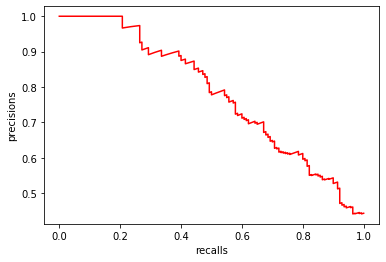

In [94]:
plt.plot(recalls,precisions,"r-")
plt.xlabel("recalls")
plt.ylabel("precisions")

In [95]:
cross_val_score ( sgd_clf , X_train , y_train ,cv=3 , scoring="accuracy")


H:\Anaconda\lib\site-packages\sklearn\model_selection\_split.py:672: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  % (min_groups, self.n_splits)), UserWarning)


array([0.67924528, 0.68571429, 0.7047619 ])

In [96]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler ()
X_train_scaled = scaler.fit_transform (X_train.astype(np.float64))
cross_val_score(sgd_clf , X_train_scaled, y_train,cv=3,scoring="accuracy") 

H:\Anaconda\lib\site-packages\sklearn\model_selection\_split.py:672: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  % (min_groups, self.n_splits)), UserWarning)


array([0.70754717, 0.6952381 , 0.64761905])

In [97]:
y_train_pred = cross_val_predict(sgd_clf,X_train_scaled,y_train, cv=3 )
confmx = confusion_matrix ( y_train,y_train_pred)
confmx

H:\Anaconda\lib\site-packages\sklearn\model_selection\_split.py:672: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  % (min_groups, self.n_splits)), UserWarning)


array([[151,   7,   0,   2,   0,   4,   1,   0,   1,   5,   0,   0,   5],
       [ 10,  17,   1,   1,   1,   1,   0,   0,   0,   0,   0,   0,   2],
       [  2,   0,   4,   0,   0,   0,   0,   0,   1,   0,   0,   0,   1],
       [  2,   0,   0,  10,   0,   0,   0,   0,   0,   0,   0,   0,   0],
       [  5,   0,   0,   0,   2,   0,   0,   1,   0,   1,   0,   0,   0],
       [ 11,   0,   0,   0,   0,   3,   0,   0,   0,   1,   0,   0,   0],
       [  1,   0,   1,   0,   0,   0,   0,   0,   0,   1,   0,   0,   0],
       [  1,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   8,   0,   0,   0,   0],
       [  8,   0,   0,   0,   0,   0,   1,   0,   0,  21,   0,   0,   1],
       [  0,   0,   0,   0,   0,   1,   0,   0,   0,   0,   0,   0,   0],
       [  1,   1,   1,   0,   0,   0,   0,   0,   0,   0,   0,   0,   1],
       [  7,   1,   0,   1,   0,   2,   0,   0,   2,   2,   0,   0,   0]],
      dtype=int64)

In [98]:
row_sums = confmx.sum ( axis=1 , keepdims=True )
norm_conf_mx = confmx / row_sums 

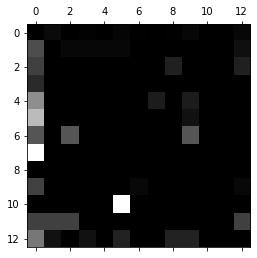

In [99]:
row_sums = confmx.sum ( axis=1 , keepdims=True )
norm_conf_mx = confmx / row_sums 
np.fill_diagonal (norm_conf_mx, 0 )
plt.matshow ( norm_conf_mx, cmap=plt.cm.gray)
plt.show ()

In [100]:
from sklearn.ensemble import RandomForestClassifier
forest_clf = RandomForestClassifier(random_state=42 )
y_probas_forest = cross_val_predict(forest_clf,X_train,y_train,cv=3,method="predict_proba") 

H:\Anaconda\lib\site-packages\sklearn\model_selection\_split.py:672: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  % (min_groups, self.n_splits)), UserWarning)
H:\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:905: RuntimeWarning: Number of classes in training fold (12) does not match total number of classes (13). Results may not be appropriate for your use case. To fix this, use a cross-validation technique resulting in properly stratified folds
  RuntimeWarning)
H:\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:905: RuntimeWarning: Number of classes in training fold (12) does not match total number of classes (13). Results may not be appropriate for your use case. To fix this, use a cross-validation technique resulting in properly stratified folds
  RuntimeWarning)


# Binary for 1 and 10

In [101]:
data_1_10 = data_raw[(data_raw["diagnosis"]==1) | (data_raw["diagnosis"]==10)]

In [102]:
data_1_10

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172,95,138,163,386,185,102,96,...,0.0,9.5,-2.4,0.0,0,0.3,3.4,12.3,49.0,10
3,55,0,175,94,100,202,380,179,143,28,...,0.0,12.2,-2.2,0.0,0,0.4,2.6,34.6,61.6,1
6,40,1,160,52,77,129,377,133,77,77,...,0.0,6.5,0.0,0.0,0,0.4,1.0,14.3,20.5,1
7,49,1,162,54,78,0,376,157,70,67,...,0.0,8.2,-1.9,0.0,0,0.1,0.5,15.8,19.8,1
8,44,0,168,56,84,118,354,160,63,61,...,0.0,7.0,-1.3,0.0,0,0.6,2.1,12.5,30.9,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
446,20,1,157,57,81,151,363,166,80,43,...,0.0,7.2,-0.7,0.0,0,0.5,2.3,17.6,39.2,1
447,53,1,160,70,80,199,382,154,117,-37,...,0.0,4.3,-5.0,0.0,0,0.7,0.6,-4.4,-0.5,1
448,37,0,190,85,100,137,361,201,73,86,...,0.0,15.6,-1.6,0.0,0,0.4,2.4,38.0,62.4,10
450,32,1,155,55,93,106,386,218,63,54,...,-0.4,12.0,-0.7,0.0,0,0.5,2.4,25.0,46.6,1


In [103]:
data_10 = data_1_10[data_1_10["diagnosis"]==10]
data_10_copy=data_10

In [104]:
import random
#for i in range (0,len(data_10)):

for column in data_10:
    if (column!='age') and (column!='sex') and (column!='diagnosis'):
         data_10[column]=data_10[column]+random.uniform(0.05,0.1)
data_10_p1=data_10
data_10=data_10_copy

H:\Anaconda\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [105]:
data_10_p1

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172.09949,95.075257,138.08662,163.082512,386.071333,185.052464,102.08003,96.071539,...,0.056781,9.585984,-2.30617,0.075614,0.066288,0.365684,3.48515,12.376833,49.069907,10
9,50,1,167.09949,67.075257,89.08662,130.082512,383.071333,156.052464,73.08003,85.071539,...,-0.543219,10.885984,-1.60617,0.075614,0.066288,0.865684,0.98515,20.176833,25.169907,10
12,54,1,172.09949,58.075257,78.08662,155.082512,382.071333,163.052464,81.08003,-23.928461,...,0.056781,6.385984,-2.00617,0.075614,0.066288,0.865684,0.58515,8.876833,12.169907,10
16,47,0,171.09949,59.075257,82.08662,145.082512,347.071333,169.052464,61.08003,77.071539,...,0.056781,9.485984,-1.60617,0.075614,0.066288,0.665684,2.38515,19.576833,41.169907,10
27,31,1,160.09949,54.075257,95.08662,161.082512,407.071333,168.052464,83.08003,10.071539,...,0.056781,12.785984,-1.70617,0.075614,0.066288,0.365684,3.28515,25.476833,54.869907,10
37,35,1,164.09949,94.075257,85.08662,200.082512,385.071333,174.052464,74.08003,48.071539,...,0.056781,11.285984,-1.20617,0.075614,0.066288,1.065684,4.38515,26.576833,67.769907,10
52,39,0,172.09949,76.075257,103.08662,147.082512,356.071333,162.052464,80.08003,11.071539,...,-0.843219,12.485984,-2.00617,0.075614,0.066288,0.565684,0.68515,23.676833,28.569907,10
75,34,0,165.09949,65.075257,88.08662,159.082512,371.071333,167.052464,92.08003,88.071539,...,-1.443219,10.885984,-1.30617,0.075614,0.066288,0.465684,2.28515,15.176833,30.569907,10
94,25,1,168.09949,55.075257,97.08662,133.082512,338.071333,235.052464,96.08003,-136.928461,...,0.056781,5.785984,-3.20617,0.075614,0.066288,0.865684,2.48515,2.676833,31.469907,10
96,33,1,150.09949,55.075257,102.08662,143.082512,364.071333,168.052464,82.08003,33.071539,...,-1.243219,13.185984,-2.40617,0.075614,0.066288,0.665684,2.18515,21.376833,41.869907,10


In [106]:
for column in data_10:
    if (column!='age') and (column!='sex') and (column!='diagnosis'):
         data_10[column]=data_10[column]+random.uniform(0.06,0.09)
data_10_p2=data_10
data_10=data_10_copy

H:\Anaconda\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [107]:
data_10_p2

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172.179917,95.157094,138.160461,163.159575,386.158013,185.140947,102.150677,96.160299,...,0.142769,9.649329,-2.226438,0.157246,0.154631,0.437831,3.557659,12.440091,49.136618,10
9,50,1,167.179917,67.157094,89.160461,130.159575,383.158013,156.140947,73.150677,85.160299,...,-0.457231,10.949329,-1.526438,0.157246,0.154631,0.937831,1.057659,20.240091,25.236618,10
12,54,1,172.179917,58.157094,78.160461,155.159575,382.158013,163.140947,81.150677,-23.839701,...,0.142769,6.449329,-1.926438,0.157246,0.154631,0.937831,0.657659,8.940091,12.236618,10
16,47,0,171.179917,59.157094,82.160461,145.159575,347.158013,169.140947,61.150677,77.160299,...,0.142769,9.549329,-1.526438,0.157246,0.154631,0.737831,2.457659,19.640091,41.236618,10
27,31,1,160.179917,54.157094,95.160461,161.159575,407.158013,168.140947,83.150677,10.160299,...,0.142769,12.849329,-1.626438,0.157246,0.154631,0.437831,3.357659,25.540091,54.936618,10
37,35,1,164.179917,94.157094,85.160461,200.159575,385.158013,174.140947,74.150677,48.160299,...,0.142769,11.349329,-1.126438,0.157246,0.154631,1.137831,4.457659,26.640091,67.836618,10
52,39,0,172.179917,76.157094,103.160461,147.159575,356.158013,162.140947,80.150677,11.160299,...,-0.757231,12.549329,-1.926438,0.157246,0.154631,0.637831,0.757659,23.740091,28.636618,10
75,34,0,165.179917,65.157094,88.160461,159.159575,371.158013,167.140947,92.150677,88.160299,...,-1.357231,10.949329,-1.226438,0.157246,0.154631,0.537831,2.357659,15.240091,30.636618,10
94,25,1,168.179917,55.157094,97.160461,133.159575,338.158013,235.140947,96.150677,-136.839701,...,0.142769,5.849329,-3.126438,0.157246,0.154631,0.937831,2.557659,2.740091,31.536618,10
96,33,1,150.179917,55.157094,102.160461,143.159575,364.158013,168.140947,82.150677,33.160299,...,-1.157231,13.249329,-2.326438,0.157246,0.154631,0.737831,2.257659,21.440091,41.936618,10


In [108]:
for column in data_10:
    if (column!='age') and (column!='sex') and (column!='diagnosis'):
         data_10[column]=data_10[column]+random.uniform(0.045,0.11)
data_10_p3=data_10
data_10=data_10_copy

H:\Anaconda\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [109]:
data_10_p3

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172.23148,95.224585,138.233263,163.2376,386.210483,185.209339,102.241147,96.234475,...,0.190748,9.714032,-2.167392,0.262889,0.203552,0.527592,3.658273,12.546332,49.232727,10
9,50,1,167.23148,67.224585,89.233263,130.2376,383.210483,156.209339,73.241147,85.234475,...,-0.409252,11.014032,-1.467392,0.262889,0.203552,1.027592,1.158273,20.346332,25.332727,10
12,54,1,172.23148,58.224585,78.233263,155.2376,382.210483,163.209339,81.241147,-23.765525,...,0.190748,6.514032,-1.867392,0.262889,0.203552,1.027592,0.758273,9.046332,12.332727,10
16,47,0,171.23148,59.224585,82.233263,145.2376,347.210483,169.209339,61.241147,77.234475,...,0.190748,9.614032,-1.467392,0.262889,0.203552,0.827592,2.558273,19.746332,41.332727,10
27,31,1,160.23148,54.224585,95.233263,161.2376,407.210483,168.209339,83.241147,10.234475,...,0.190748,12.914032,-1.567392,0.262889,0.203552,0.527592,3.458273,25.646332,55.032727,10
37,35,1,164.23148,94.224585,85.233263,200.2376,385.210483,174.209339,74.241147,48.234475,...,0.190748,11.414032,-1.067392,0.262889,0.203552,1.227592,4.558273,26.746332,67.932727,10
52,39,0,172.23148,76.224585,103.233263,147.2376,356.210483,162.209339,80.241147,11.234475,...,-0.709252,12.614032,-1.867392,0.262889,0.203552,0.727592,0.858273,23.846332,28.732727,10
75,34,0,165.23148,65.224585,88.233263,159.2376,371.210483,167.209339,92.241147,88.234475,...,-1.309252,11.014032,-1.167392,0.262889,0.203552,0.627592,2.458273,15.346332,30.732727,10
94,25,1,168.23148,55.224585,97.233263,133.2376,338.210483,235.209339,96.241147,-136.765525,...,0.190748,5.914032,-3.067392,0.262889,0.203552,1.027592,2.658273,2.846332,31.632727,10
96,33,1,150.23148,55.224585,102.233263,143.2376,364.210483,168.209339,82.241147,33.234475,...,-1.109252,13.314032,-2.267392,0.262889,0.203552,0.827592,2.358273,21.546332,42.032727,10


In [110]:
for column in data_10:
    if (column!='age') and (column!='sex') and (column!='diagnosis'):
         data_10[column]=data_10[column]+random.uniform(0.055,0.12)
data_10_p4=data_10
data_10=data_10_copy

H:\Anaconda\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [111]:
data_10_p4

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172.323059,95.328428,138.331285,163.294771,386.304713,185.2999,102.338814,96.331242,...,0.255295,9.799784,-2.093932,0.360864,0.27857,0.623075,3.763439,12.643463,49.317573,10
9,50,1,167.323059,67.328428,89.331285,130.294771,383.304713,156.2999,73.338814,85.331242,...,-0.344705,11.099784,-1.393932,0.360864,0.27857,1.123075,1.263439,20.443463,25.417573,10
12,54,1,172.323059,58.328428,78.331285,155.294771,382.304713,163.2999,81.338814,-23.668758,...,0.255295,6.599784,-1.793932,0.360864,0.27857,1.123075,0.863439,9.143463,12.417573,10
16,47,0,171.323059,59.328428,82.331285,145.294771,347.304713,169.2999,61.338814,77.331242,...,0.255295,9.699784,-1.393932,0.360864,0.27857,0.923075,2.663439,19.843463,41.417573,10
27,31,1,160.323059,54.328428,95.331285,161.294771,407.304713,168.2999,83.338814,10.331242,...,0.255295,12.999784,-1.493932,0.360864,0.27857,0.623075,3.563439,25.743463,55.117573,10
37,35,1,164.323059,94.328428,85.331285,200.294771,385.304713,174.2999,74.338814,48.331242,...,0.255295,11.499784,-0.993932,0.360864,0.27857,1.323075,4.663439,26.843463,68.017573,10
52,39,0,172.323059,76.328428,103.331285,147.294771,356.304713,162.2999,80.338814,11.331242,...,-0.644705,12.699784,-1.793932,0.360864,0.27857,0.823075,0.963439,23.943463,28.817573,10
75,34,0,165.323059,65.328428,88.331285,159.294771,371.304713,167.2999,92.338814,88.331242,...,-1.244705,11.099784,-1.093932,0.360864,0.27857,0.723075,2.563439,15.443463,30.817573,10
94,25,1,168.323059,55.328428,97.331285,133.294771,338.304713,235.2999,96.338814,-136.668758,...,0.255295,5.999784,-2.993932,0.360864,0.27857,1.123075,2.763439,2.943463,31.717573,10
96,33,1,150.323059,55.328428,102.331285,143.294771,364.304713,168.2999,82.338814,33.331242,...,-1.044705,13.399784,-2.193932,0.360864,0.27857,0.923075,2.463439,21.643463,42.117573,10


In [112]:
data_1_10_for_train = pd.concat([data_1_10,data_10_p1,data_10_p2,data_10_p3,data_10_p4],axis=0)
data_1_10_for_train

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
2,54,0,172.000000,95.000000,138.000000,163.000000,386.000000,185.0000,102.000000,96.000000,...,0.000000,9.500000,-2.400000,0.000000,0.00000,0.300000,3.400000,12.300000,49.000000,10
3,55,0,175.000000,94.000000,100.000000,202.000000,380.000000,179.0000,143.000000,28.000000,...,0.000000,12.200000,-2.200000,0.000000,0.00000,0.400000,2.600000,34.600000,61.600000,1
6,40,1,160.000000,52.000000,77.000000,129.000000,377.000000,133.0000,77.000000,77.000000,...,0.000000,6.500000,0.000000,0.000000,0.00000,0.400000,1.000000,14.300000,20.500000,1
7,49,1,162.000000,54.000000,78.000000,0.000000,376.000000,157.0000,70.000000,67.000000,...,0.000000,8.200000,-1.900000,0.000000,0.00000,0.100000,0.500000,15.800000,19.800000,1
8,44,0,168.000000,56.000000,84.000000,118.000000,354.000000,160.0000,63.000000,61.000000,...,0.000000,7.000000,-1.300000,0.000000,0.00000,0.600000,2.100000,12.500000,30.900000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
427,58,0,160.323059,65.328428,133.331285,148.294771,417.304713,260.2999,92.338814,-157.668758,...,-0.144705,6.699784,-3.193932,0.360864,0.27857,0.723075,1.163439,-2.556537,6.817573,10
430,11,0,138.323059,29.328428,123.331285,145.294771,361.304713,221.2999,80.338814,112.331242,...,-3.144705,19.899784,-3.893932,0.360864,0.27857,0.523075,2.163439,12.543463,25.417573,10
432,11,0,140.323059,42.328428,88.331285,123.294771,362.304713,228.2999,81.338814,-17.668758,...,0.255295,17.399784,-6.793932,0.360864,0.27857,1.023075,5.863439,15.443463,84.717573,10
443,41,1,154.323059,75.328428,88.331285,157.294771,384.304713,132.2999,112.338814,65.331242,...,-0.144705,10.799784,-2.193932,0.360864,0.27857,0.823075,1.763439,18.143463,29.817573,10


In [113]:
from sklearn.utils import shuffle 
data_1_10_for_train = shuffle(data_1_10_for_train) 
data_1_10_for_train

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KY,KZ,LA,LB,LC,LD,LE,LF,LG,diagnosis
423,51,0,186.000000,95.000000,94.000000,203.000000,367.000000,171.0000,106.000000,-7.000000,...,0.000000,9.600000,-3.500000,0.000000,0.00000,1.000000,1.600000,9.400000,23.400000,1
353,26,0,170.323059,43.328428,92.331285,0.294771,363.304713,151.2999,204.338814,-31.668758,...,0.255295,8.399784,0.306068,0.360864,0.27857,0.623075,1.363439,21.343463,28.717573,10
437,35,1,155.000000,63.000000,87.000000,142.000000,391.000000,137.0000,88.000000,66.000000,...,0.000000,10.700000,0.000000,0.000000,0.00000,1.000000,2.100000,25.600000,43.200000,1
43,34,1,165.000000,61.000000,84.000000,152.000000,383.000000,144.0000,71.000000,59.000000,...,-1.000000,16.300000,0.000000,0.000000,0.00000,0.400000,-1.100000,37.900000,22.100000,1
260,33,1,165.000000,85.000000,80.000000,149.000000,348.000000,136.0000,99.000000,-6.000000,...,0.000000,5.400000,0.000000,0.000000,0.00000,1.000000,0.400000,19.400000,22.500000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
280,41,0,175.000000,97.000000,91.000000,198.000000,402.000000,254.0000,143.000000,-4.000000,...,0.000000,7.100000,-3.300000,0.500000,0.00000,0.600000,1.100000,15.000000,25.700000,1
130,56,0,165.000000,54.000000,89.000000,130.000000,347.000000,175.0000,70.000000,84.000000,...,0.000000,7.000000,-2.700000,0.000000,0.00000,0.400000,2.000000,5.600000,23.200000,1
353,26,0,170.323059,43.328428,92.331285,0.294771,363.304713,151.2999,204.338814,-31.668758,...,0.255295,8.399784,0.306068,0.360864,0.27857,0.623075,1.363439,21.343463,28.717573,10
353,26,0,170.323059,43.328428,92.331285,0.294771,363.304713,151.2999,204.338814,-31.668758,...,0.255295,8.399784,0.306068,0.360864,0.27857,0.623075,1.363439,21.343463,28.717573,10


In [114]:
X_1_10_for_train = data_1_10_for_train.drop('diagnosis', axis = 1)
y_1_10_for_train = data_1_10_for_train['diagnosis']
feature_names = X_1_10_for_train.columns

In [115]:
X_1_10_for_test = data_1_10.drop('diagnosis', axis = 1)
y_1_10_for_test = data_1_10['diagnosis']

threshold =  0.0


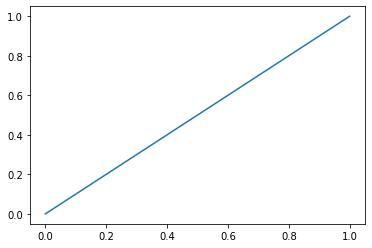

threshold =  0.2


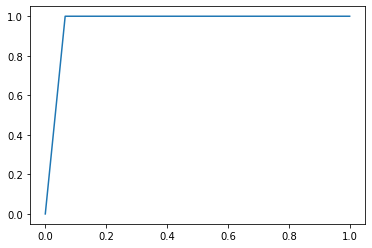

threshold =  0.4


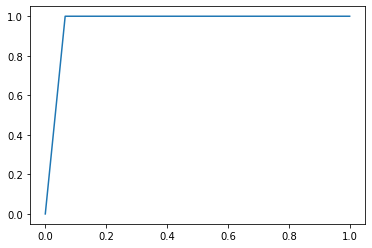

threshold =  0.5


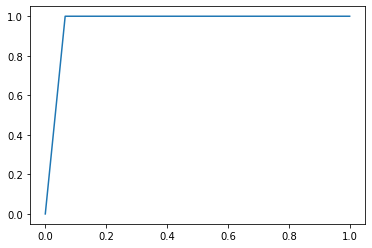

threshold =  0.7


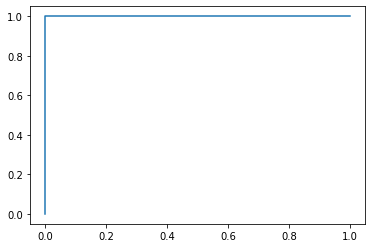

threshold =  0.8


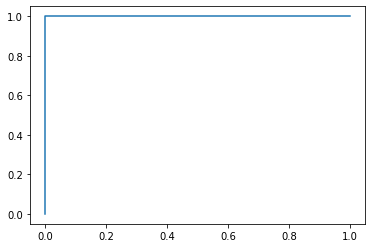

auto threshold


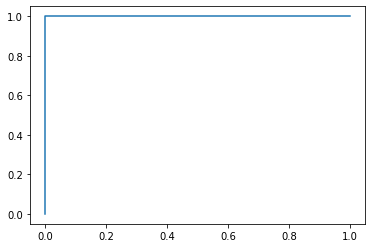

neighbours = 2 err_train = 0.0 err_test = 0.0
[[245   0]
 [  0  50]]
Mera F1 Train: 1.0
Precision Score Train:  1.0
Recall Score Train:  1.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


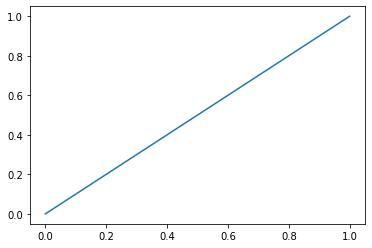

threshold =  0.2


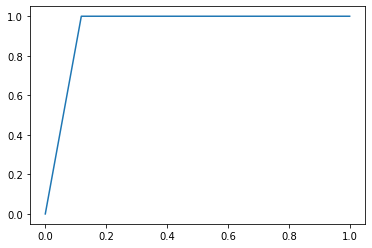

threshold =  0.4


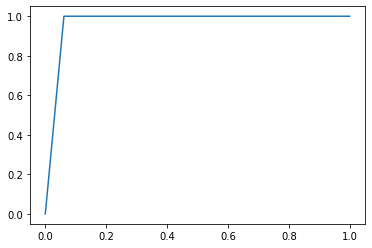

threshold =  0.5


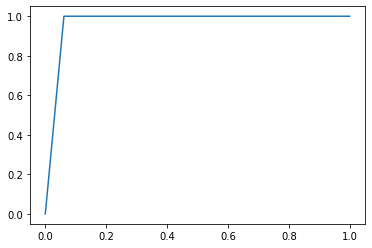

threshold =  0.7


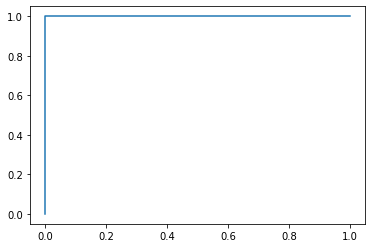

threshold =  0.8


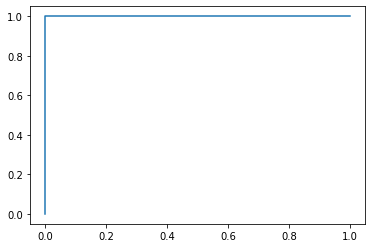

auto threshold


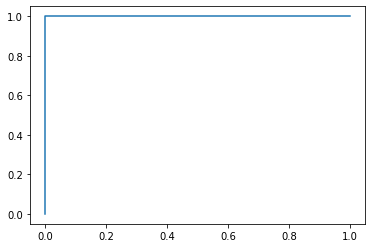

neighbours = 3 err_train = 0.030303030303030304 err_test = 0.05084745762711865
[[230  15]
 [  0  50]]
Mera F1 Train: 0.968421052631579
Precision Score Train:  0.9491525423728814
Recall Score Train:  0.9491525423728814


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


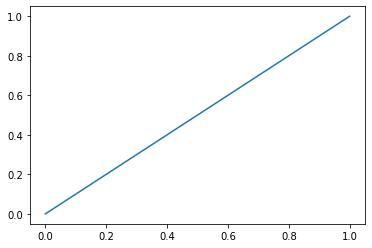

threshold =  0.2


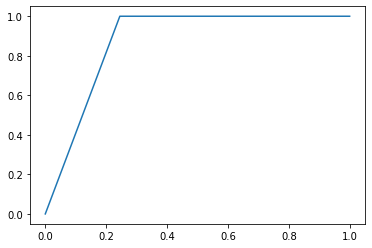

threshold =  0.4


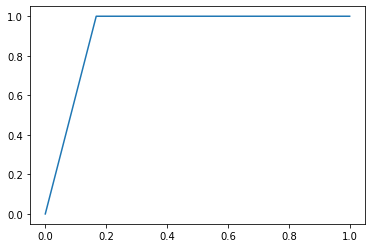

threshold =  0.5


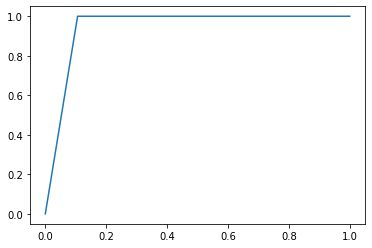

threshold =  0.7


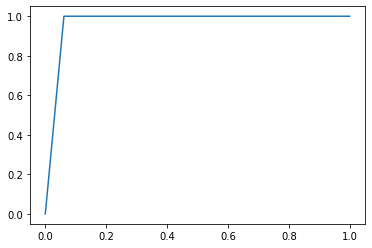

threshold =  0.8


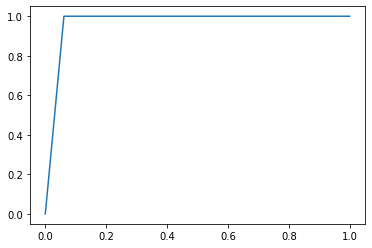

auto threshold


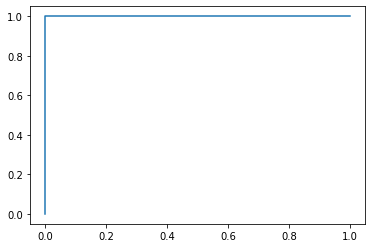

neighbours = 5 err_train = 0.052525252525252523 err_test = 0.08813559322033898
[[219  26]
 [  0  50]]
Mera F1 Train: 0.9439655172413792
Precision Score Train:  0.911864406779661
Recall Score Train:  0.911864406779661


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


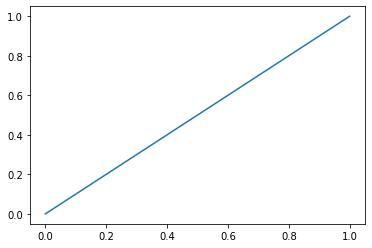

threshold =  0.2


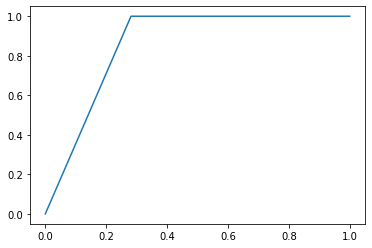

threshold =  0.4


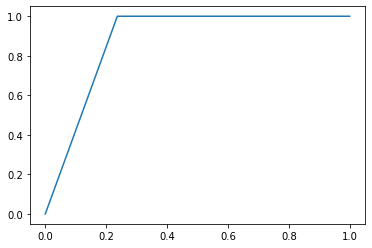

threshold =  0.5


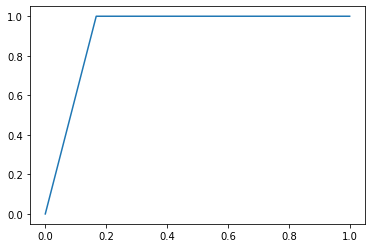

threshold =  0.7


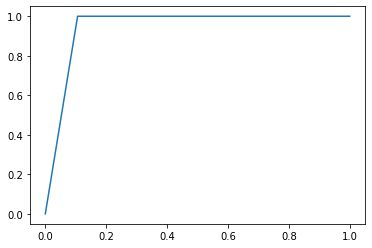

threshold =  0.8


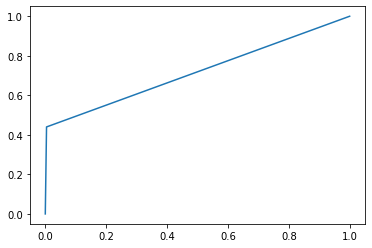

auto threshold


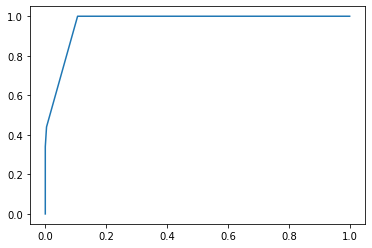

neighbours = 7 err_train = 0.08282828282828283 err_test = 0.13898305084745763
[[204  41]
 [  0  50]]
Mera F1 Train: 0.9086859688195991
Precision Score Train:  0.8610169491525423
Recall Score Train:  0.8610169491525423


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


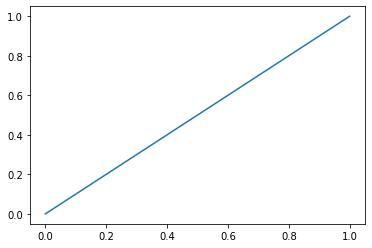

threshold =  0.2


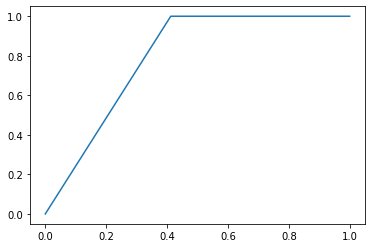

threshold =  0.4


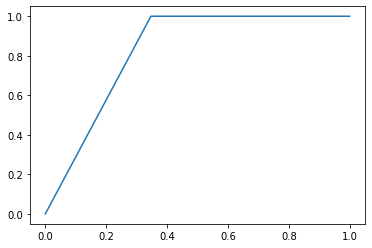

threshold =  0.5


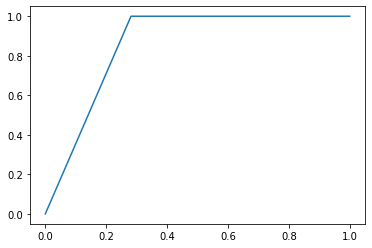

threshold =  0.7


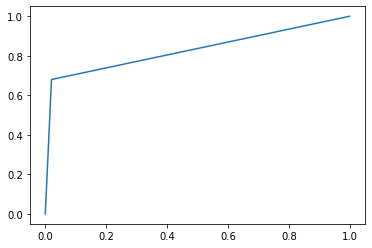

threshold =  0.8


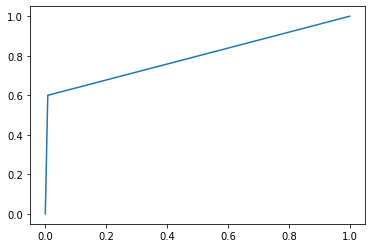

auto threshold


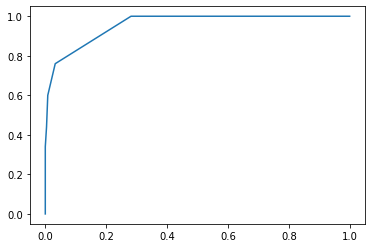

neighbours = 10 err_train = 0.13737373737373737 err_test = 0.06779661016949153
[[237   8]
 [ 12  38]]
Mera F1 Train: 0.9595141700404859
Precision Score Train:  0.9322033898305084
Recall Score Train:  0.9322033898305084


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


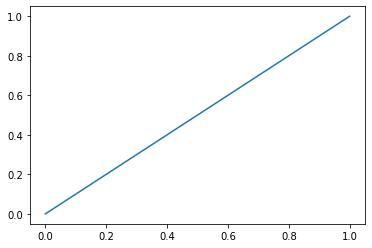

threshold =  0.2


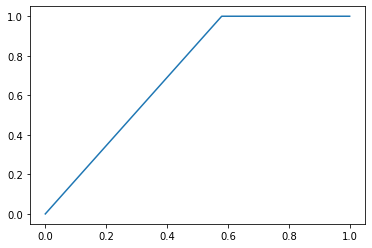

threshold =  0.4


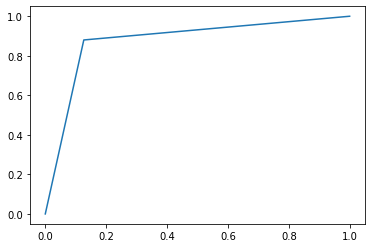

threshold =  0.5


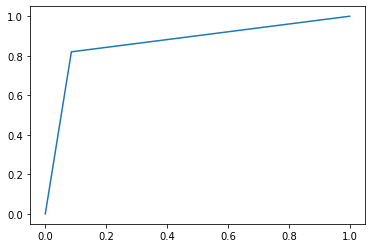

threshold =  0.7


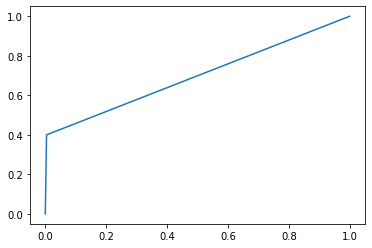

threshold =  0.8


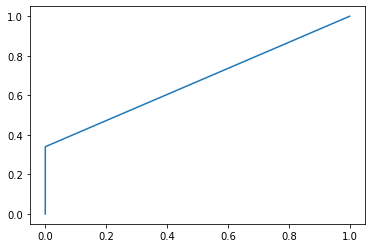

auto threshold


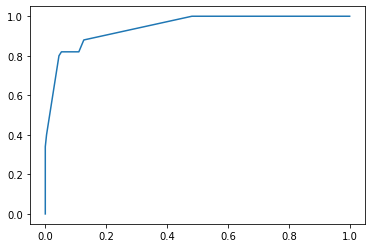

neighbours = 15 err_train = 0.13333333333333333 err_test = 0.1016949152542373
[[224  21]
 [  9  41]]
Mera F1 Train: 0.9372384937238494
Precision Score Train:  0.8983050847457628
Recall Score Train:  0.8983050847457628


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


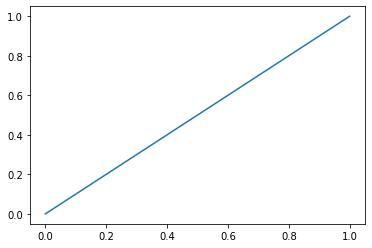

threshold =  0.2


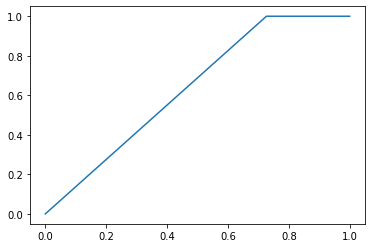

threshold =  0.4


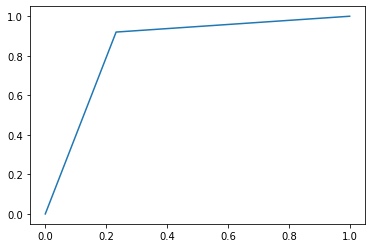

threshold =  0.5


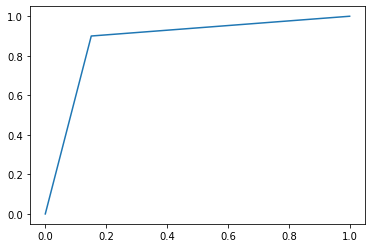

threshold =  0.7


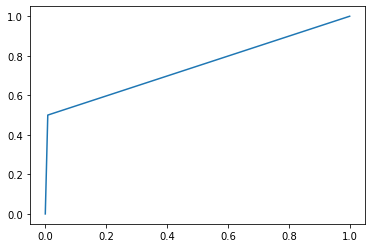

threshold =  0.8


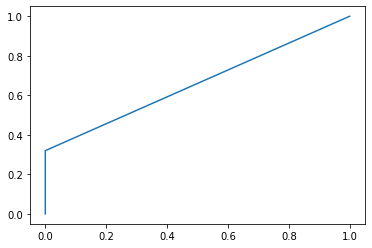

auto threshold


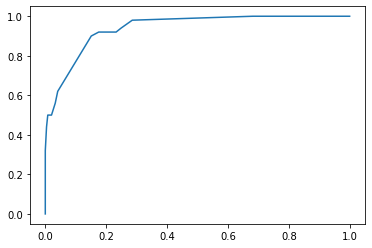

neighbours = 20 err_train = 0.19595959595959597 err_test = 0.09830508474576272
[[235  10]
 [ 19  31]]
Mera F1 Train: 0.9418837675350701
Precision Score Train:  0.9016949152542373
Recall Score Train:  0.9016949152542373


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


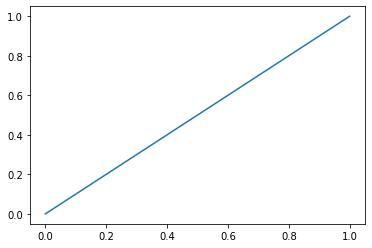

threshold =  0.2


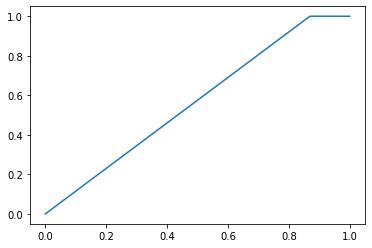

threshold =  0.4


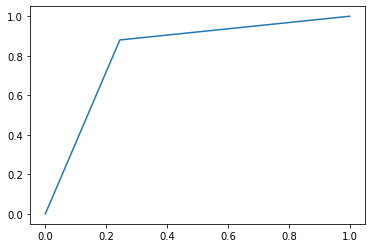

threshold =  0.5


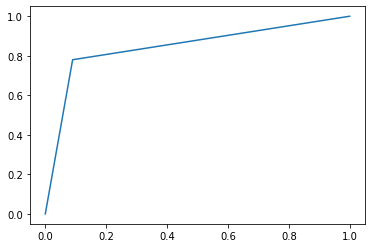

threshold =  0.7


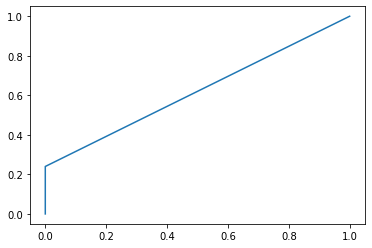

threshold =  0.8


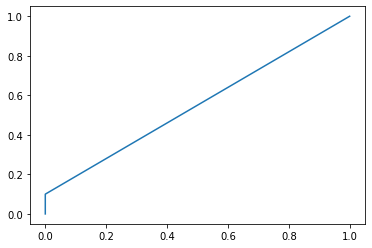

auto threshold


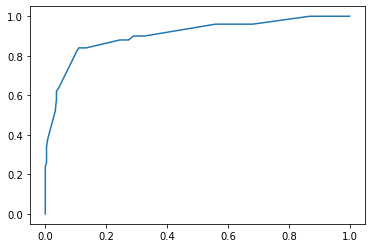

neighbours = 50 err_train = 0.19595959595959597 err_test = 0.09830508474576272
[[234  11]
 [ 18  32]]
Mera F1 Train: 0.9416498993963782
Precision Score Train:  0.9016949152542373
Recall Score Train:  0.9016949152542373


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


threshold =  0.0


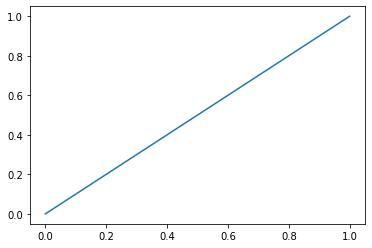

threshold =  0.2


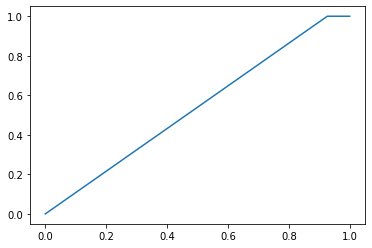

threshold =  0.4


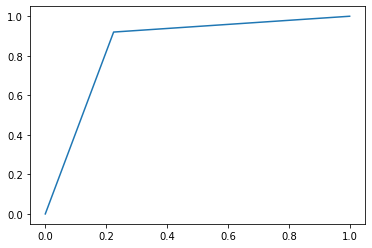

threshold =  0.5


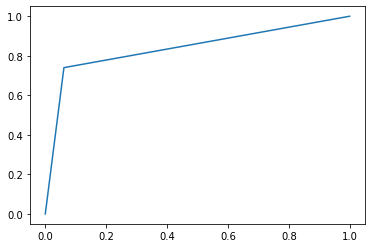

threshold =  0.7


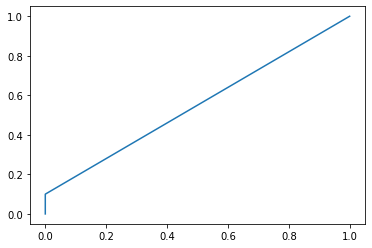

threshold =  0.8


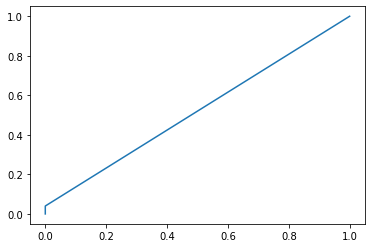

auto threshold


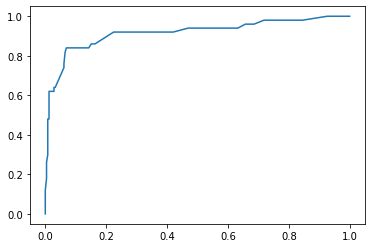

neighbours = 100 err_train = 0.19797979797979798 err_test = 0.08813559322033898
[[237   8]
 [ 18  32]]
Mera F1 Train: 0.9480000000000001
Precision Score Train:  0.911864406779661
Recall Score Train:  0.911864406779661


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [116]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_1_10_for_train, y_1_10_for_train)
    y_1_10_for_test_predict = knn.predict(X_1_10_for_test)
    err_test  = np.mean(y_1_10_for_test  != y_1_10_for_test_predict)
    y_1_10_for_train_predict = knn.predict(X_1_10_for_train)
    err_train  = np.mean(y_1_10_for_train  !=  y_1_10_for_train_predict)
    y_1_10_for_test_binary = np.array(y_1_10_for_test != 1, dtype='int')
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_1_10_for_test_binary,knn.predict_proba(X_1_10_for_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_1_10_for_test_binary,knn.predict_proba(X_1_10_for_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    #print("predict_proba для кнн",knn.predict_proba(X_1_10_for_test))
    #print("thresholds",thresholds)
    #print(y_test_predict,y_train_predict)
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_1_10_for_test,y_1_10_for_test_predict))
    print("Mera F1 Train:",f1_score(y_1_10_for_test,y_1_10_for_test_predict))
    print("Precision Score Train: ",precision_score(y_1_10_for_test, y_1_10_for_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_1_10_for_test, y_1_10_for_test_predict, pos_label='positive',average='micro'))
    i=i+1

In [117]:
y_1_10_for_test

2      10
3       1
6       1
7       1
8       1
       ..
446     1
447     1
448    10
450     1
451     1
Name: diagnosis, Length: 295, dtype: int64

In [118]:
y_1_10_for_test_binary = np.array(y_1_10_for_test != 1, dtype='int')
y_1_10_for_test_binary

array([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1,
       0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0,
       1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 1, 0, 0])

In [119]:
from sklearn.linear_model import SGDClassifier
sgd_clf = SGDClassifier(random_state=42)
sgd_clf.fit(X_1_10_for_test, y_1_10_for_test)

SGDClassifier(random_state=42)

In [120]:
y_scores = cross_val_predict(sgd_clf,X_1_10_for_test,y_1_10_for_test,cv=3,method="decision_function")
#y_scores

Text(0, 0.5, 'precisions')

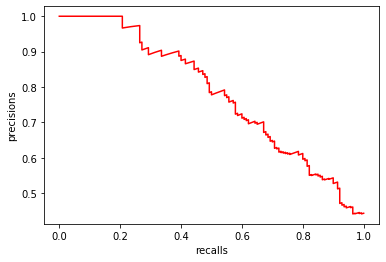

In [121]:
plt.plot(recalls,precisions,"r-")
plt.xlabel("recalls")
plt.ylabel("precisions")

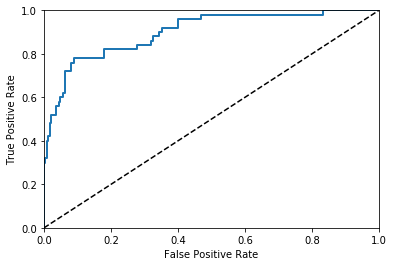

In [122]:
from sklearn.metrics import roc_curve
fpr,tpr,thresholds= roc_curve(y_1_10_for_test_binary, y_scores)
def plot_roc_curve(fpr,tpr,label=None):
    plt.plot(fpr,tpr,linewidth=2 , label=label )
    plt.plot([0,1],[0,1],'k--')
    plt.axis([0,1,0,1])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
plot_roc_curve (fpr,tpr)
plt.show()

In [123]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_1_10_for_test_binary,y_scores)

0.9

In [124]:
from sklearn.ensemble import RandomForestClassifier
forest_clf = RandomForestClassifier(random_state=42 )
y_probas_forest = cross_val_predict(forest_clf,X_1_10_for_test,y_1_10_for_test_binary,cv=3,method="predict_proba") 

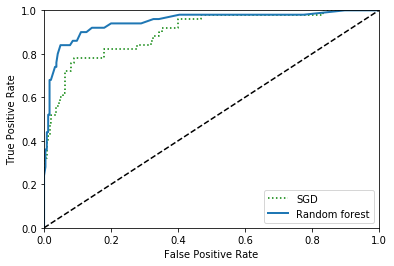

In [125]:
y_scores_forest=y_probas_forest[:,1]
fpr_forest,tpr_forest,thresholds_forest=roc_curve(y_1_10_for_test_binary,y_scores_forest)
plt.plot(fpr,tpr,"g:",label="SGD")
plot_roc_curve(fpr_forest,tpr_forest,"Random forest")
plt.legend(loc="lower right")
plt.show()

In [126]:
roc_auc_score(y_1_10_for_test_binary,y_scores_forest)

0.9470204081632653

# New Methods

In [127]:
pip install -U imbalanced-learn

Requirement already up-to-date: imbalanced-learn in h:\anaconda\lib\site-packages (0.7.0)
Note: you may need to restart the kernel to use updated packages.


In [128]:
pip install git+git://github.com/scikit-learn-contrib/imbalanced-learn.git

  Cloning git://github.com/scikit-learn-contrib/imbalanced-learn.git to c:\users\aace~1\appdata\local\temp\pip-req-build-dn9olq4a
  Created wheel for imbalanced-learn: filename=imbalanced_learn-0.7.0-cp37-none-any.whl size=176564 sha256=b9a6c49335ddd17b34c8d0b05d499abafab78811f100613e5f6f2143759b45f6
  Stored in directory: C:\Users\AACE~1\AppData\Local\Temp\pip-ephem-wheel-cache-2_oxqn6i\wheels\5e\65\a9\5fb89313536ea2aa87e813a80ead05e3c1ecbf2a4d4a53f1f1
Successfully built imbalanced-learn
Note: you may need to restart the kernel to use updated packages.


  Running command git clone -q git://github.com/scikit-learn-contrib/imbalanced-learn.git 'C:\Users\AACE~1\AppData\Local\Temp\pip-req-build-dn9olq4a'


## Data 1 and 10

In [129]:
methods=['Naive',
         'SMOTE',
         'BorderlineSMOTE',
         'ADASYN',
         'ClusterCentroids',
         'RandomUnderSampler',
         'NearMiss',
         'EditedNearestNeighbours',
         'RepeatedEditedNearestNeighbours',
         'AllKNN',
         'CondensedNearestNeighbour',
         'OneSidedSelection',
         'NeighbourhoodCleaningRule',
         'Instance hardness threshold',
         'SMOTEENN',
         'SMOTETomek']
Knn_test=[[0]*9 for j in range(16)]
Knn_train=[[0]*9 for j in range(16)]
SVC_test=[0]*16
SVC_train=[0]*16

In [130]:
print(Knn_test)

[[0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]


# Naive

Наивная стратегия - генерировать новые образцы путем случайной выборки с заменой текущих доступных образцов.

In [131]:
X_1_10 = data_1_10.drop('diagnosis', axis = 1)
y_1_10 = data_1_10['diagnosis']

In [132]:
X_train, X_test, y_train, y_test = train_test_split(X_1_10, y_1_10, test_size = 0.3, random_state = 42)

In [133]:
X_test

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KV,KY,KZ,LA,LB,LC,LD,LE,LF,LG
426,35,1,160,53,55,163,340,162,102,40,...,0.0,0.0,8.7,-0.5,0.0,0,0.5,2.3,20.9,40.6
236,43,0,176,72,85,166,335,156,109,76,...,0.0,-0.7,6.9,0.0,0.0,0,0.3,1.7,26.9,40.5
129,46,0,163,86,99,163,393,150,113,-5,...,-0.5,0.0,8.7,-1.2,0.0,0,0.6,0.3,25.4,27.7
127,61,0,185,95,95,197,340,139,132,39,...,-0.6,-0.7,12.0,-2.3,0.0,0,0.8,1.7,26.4,34.5
408,58,1,148,65,85,140,431,179,94,71,...,-0.5,0.0,9.7,-4.5,0.0,0,0.5,0.4,7.7,11.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448,37,0,190,85,100,137,361,201,73,86,...,-0.5,0.0,15.6,-1.6,0.0,0,0.4,2.4,38.0,62.4
208,42,1,157,65,86,109,374,167,61,66,...,-1.4,-0.4,17.3,0.0,0.0,0,0.5,2.5,41.2,64.2
417,65,0,172,66,98,199,339,149,181,-4,...,-1.1,0.0,15.0,-4.5,0.0,0,0.2,-0.4,26.4,23.0
110,71,1,162,72,82,294,366,148,178,-12,...,-0.6,0.0,9.5,0.0,0.0,0,-0.3,1.3,24.7,35.6


In [134]:
X_train

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KV,KY,KZ,LA,LB,LC,LD,LE,LF,LG
112,33,1,163,75,79,170,364,167,97,58,...,0.1,0.0,8.0,-1.6,0.0,0,0.5,1.3,14.4,26.6
443,41,1,154,75,88,157,384,132,112,65,...,-0.4,-0.4,10.5,-2.5,0.0,0,0.5,1.4,17.8,29.5
250,15,1,170,53,105,149,362,143,82,-38,...,0.1,-0.6,8.7,-3.9,0.0,0,0.5,2.1,6.1,21.6
180,63,1,156,70,85,165,415,172,82,80,...,-0.4,0.0,12.5,0.0,0.0,0,0.7,1.2,37.5,46.8
337,33,1,165,58,76,130,333,160,71,64,...,-0.9,0.0,10.1,-1.8,0.0,0,0.8,1.6,19.0,33.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
286,33,1,160,69,83,174,381,125,83,69,...,-0.2,0.0,12.3,0.0,0.0,0,0.4,1.1,34.4,41.2
115,39,1,160,45,75,163,418,155,90,12,...,0.1,-0.4,5.3,-1.3,0.0,0,0.6,1.9,8.2,22.2
152,36,0,172,90,89,164,357,172,67,-50,...,0.1,0.0,4.3,-3.3,0.0,0,0.6,2.2,-0.2,19.1
422,29,1,162,57,83,164,359,154,69,64,...,-0.4,0.0,14.1,-2.2,0.0,0,0.5,3.0,32.7,56.1


In [135]:
y_test_binary = np.array(y_test != 1, dtype='int')
y_test_binary

array([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0,
       0])

In [136]:
y_train_binary = np.array(y_train != 1, dtype='int')
y_train_binary

array([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0])

In [137]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_resampled, y_resampled = ros.fit_resample(X_train, y_train_binary)
from collections import Counter
print(sorted(Counter(y_resampled).items()))

[(0, 174), (1, 174)]


In [138]:
X_resampled

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KV,KY,KZ,LA,LB,LC,LD,LE,LF,LG
0,33,1,163,75,79,170,364,167,97,58,...,0.1,0.0,8.0,-1.6,0.0,0,0.5,1.3,14.4,26.6
1,41,1,154,75,88,157,384,132,112,65,...,-0.4,-0.4,10.5,-2.5,0.0,0,0.5,1.4,17.8,29.5
2,15,1,170,53,105,149,362,143,82,-38,...,0.1,-0.6,8.7,-3.9,0.0,0,0.5,2.1,6.1,21.6
3,63,1,156,70,85,165,415,172,82,80,...,-0.4,0.0,12.5,0.0,0.0,0,0.7,1.2,37.5,46.8
4,33,1,165,58,76,130,333,160,71,64,...,-0.9,0.0,10.1,-1.8,0.0,0,0.8,1.6,19.0,33.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,8,0,120,28,118,126,303,164,80,120,...,-0.9,-0.6,12.5,-3.6,0.0,0,0.5,2.3,9.2,32.2
344,58,1,160,62,98,158,358,154,114,85,...,0.1,0.0,9.1,-2.6,0.0,0,0.7,0.8,17.9,24.3
345,18,0,175,60,102,135,379,167,73,91,...,-0.3,-1.8,11.8,-2.0,0.0,0,0.6,1.4,17.1,29.7
346,57,0,170,66,102,177,429,163,86,62,...,0.0,0.0,10.2,-2.0,0.0,0,0.6,2.3,16.0,38.0


## Knn

threshold =  0.0


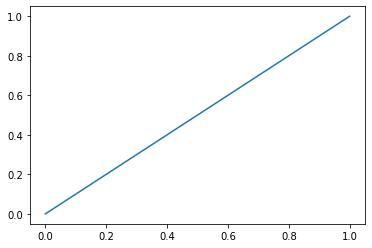

threshold =  0.2


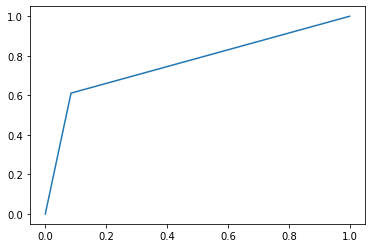

threshold =  0.4


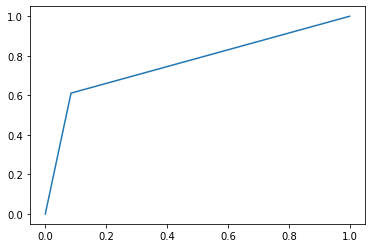

threshold =  0.5


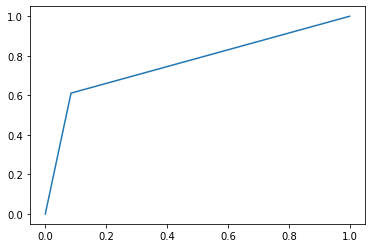

threshold =  0.7


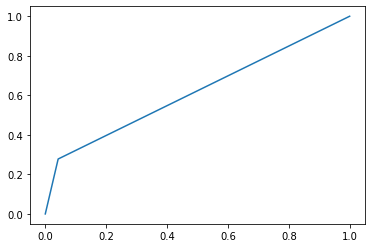

threshold =  0.8


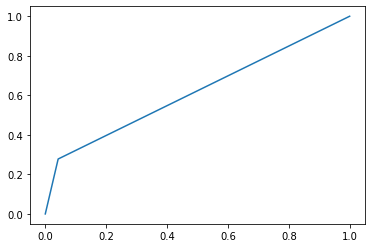

auto threshold


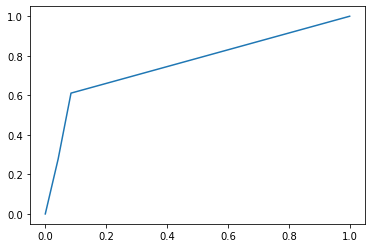

neighbours = 2 err_train = 0.0028735632183908046 err_test = 0.1797752808988764
[[68  3]
 [13  5]]
Mera F1 Train: 0.3846153846153846
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


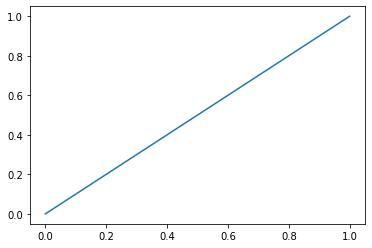

threshold =  0.2


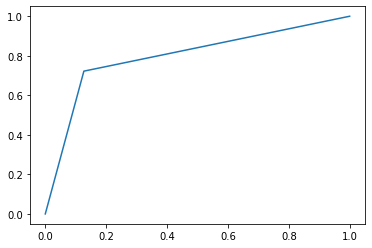

threshold =  0.4


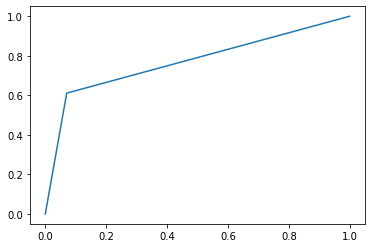

threshold =  0.5


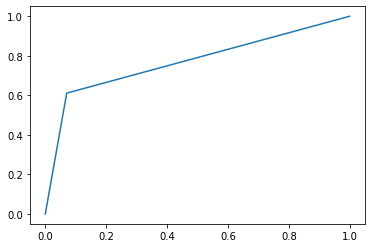

threshold =  0.7


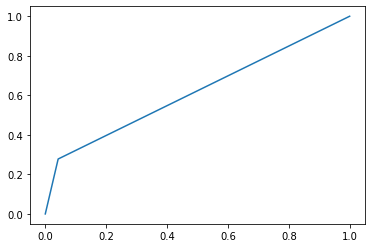

threshold =  0.8


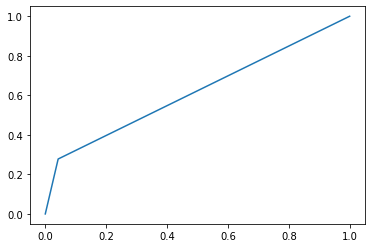

auto threshold


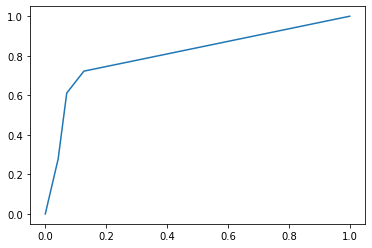

neighbours = 3 err_train = 0.02586206896551724 err_test = 0.1348314606741573
[[66  5]
 [ 7 11]]
Mera F1 Train: 0.6470588235294118
Precision Score Train:  0.8651685393258427
Recall Score Train:  0.8651685393258427
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


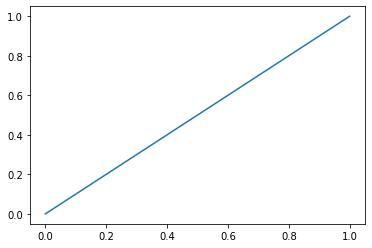

threshold =  0.2


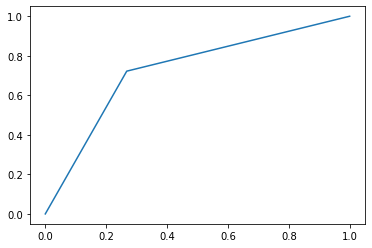

threshold =  0.4


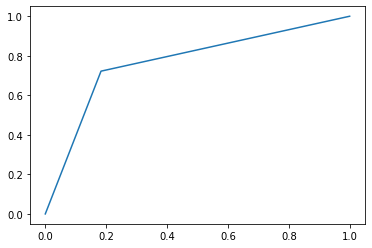

threshold =  0.5


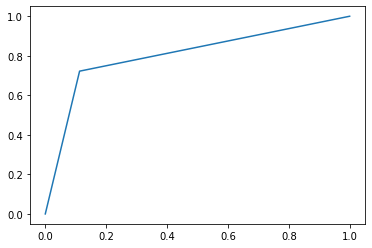

threshold =  0.7


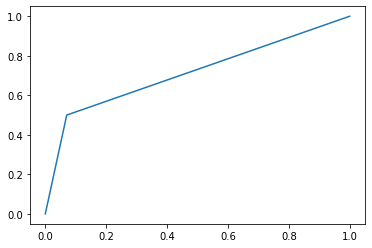

threshold =  0.8


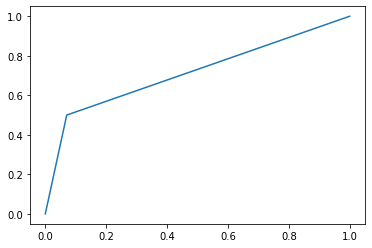

auto threshold


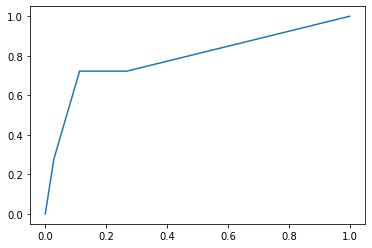

neighbours = 5 err_train = 0.06321839080459771 err_test = 0.14606741573033707
[[63  8]
 [ 5 13]]
Mera F1 Train: 0.6666666666666666
Precision Score Train:  0.8539325842696629
Recall Score Train:  0.8539325842696629
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


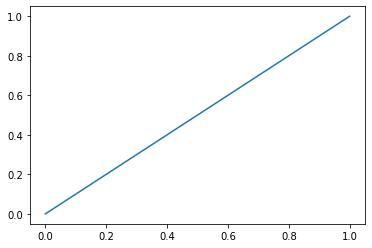

threshold =  0.2


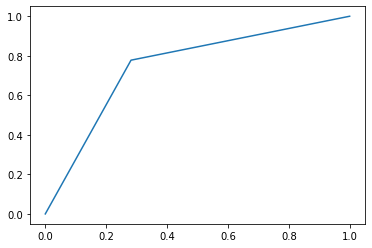

threshold =  0.4


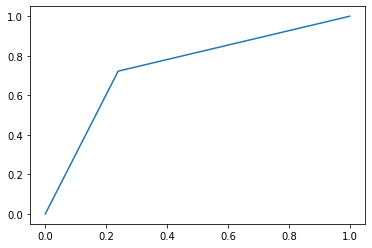

threshold =  0.5


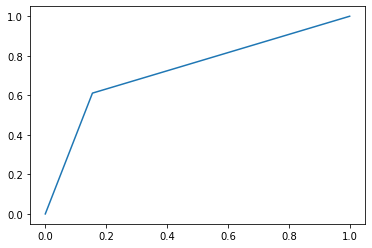

threshold =  0.7


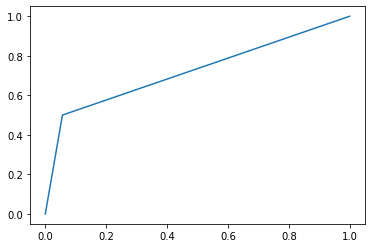

threshold =  0.8


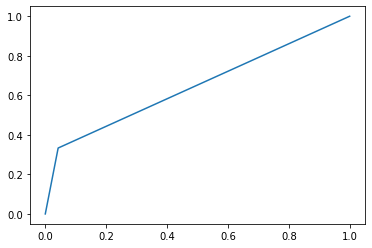

auto threshold


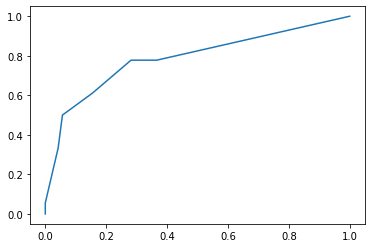

neighbours = 7 err_train = 0.09770114942528736 err_test = 0.20224719101123595
[[60 11]
 [ 7 11]]
Mera F1 Train: 0.55
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


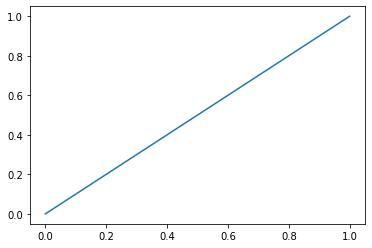

threshold =  0.2


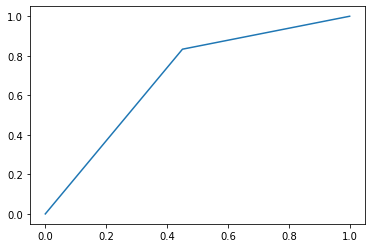

threshold =  0.4


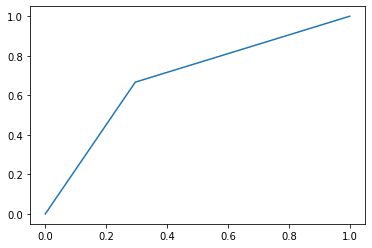

threshold =  0.5


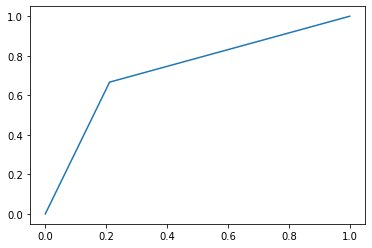

threshold =  0.7


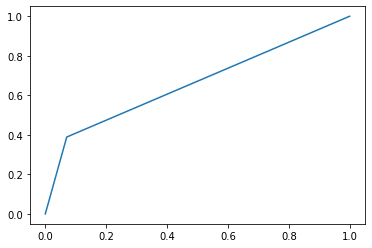

threshold =  0.8


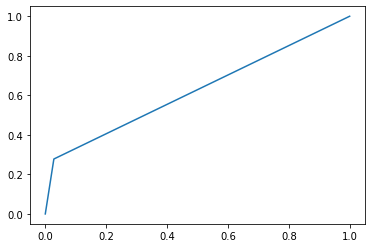

auto threshold


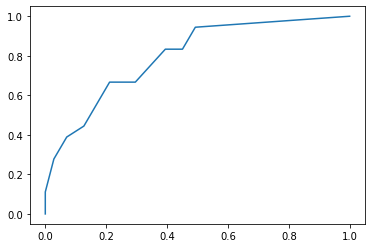

neighbours = 10 err_train = 0.11781609195402298 err_test = 0.21348314606741572
[[62  9]
 [10  8]]
Mera F1 Train: 0.45714285714285713
Precision Score Train:  0.7865168539325843
Recall Score Train:  0.7865168539325843
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


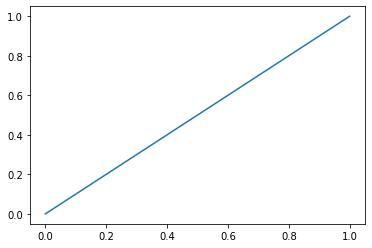

threshold =  0.2


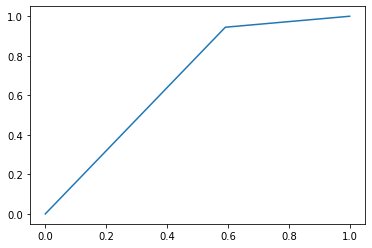

threshold =  0.4


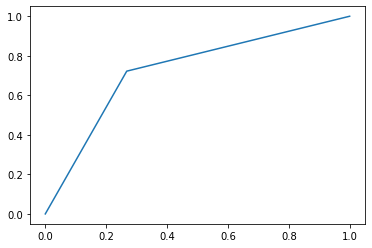

threshold =  0.5


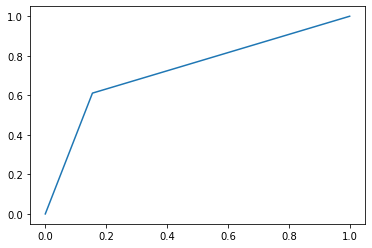

threshold =  0.7


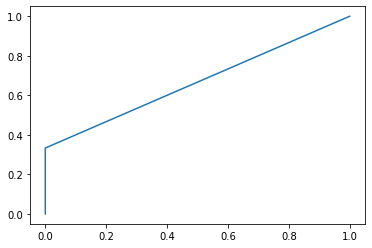

threshold =  0.8


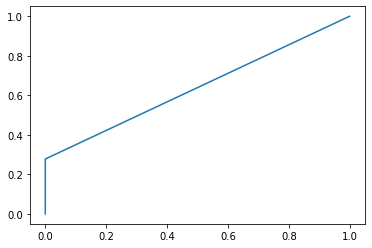

auto threshold


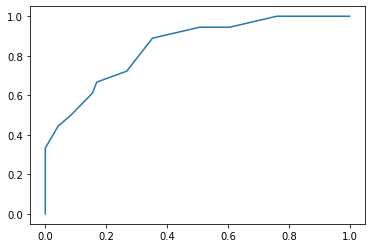

neighbours = 15 err_train = 0.10632183908045977 err_test = 0.20224719101123595
[[60 11]
 [ 7 11]]
Mera F1 Train: 0.55
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


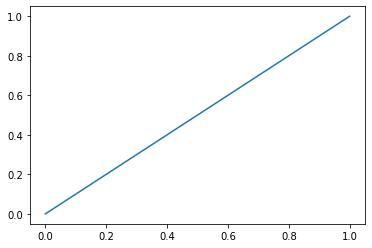

threshold =  0.2


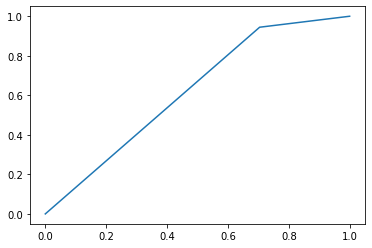

threshold =  0.4


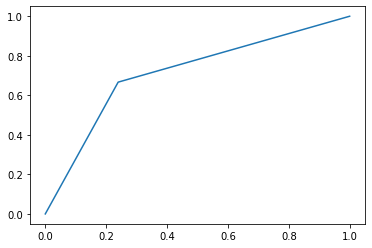

threshold =  0.5


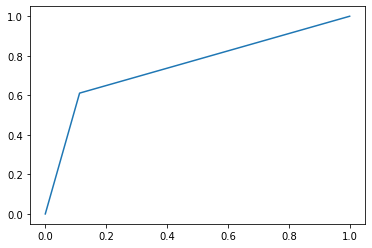

threshold =  0.7


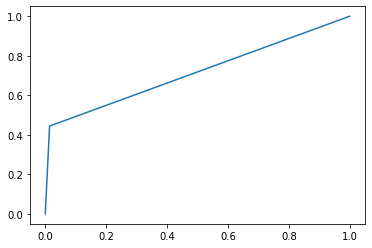

threshold =  0.8


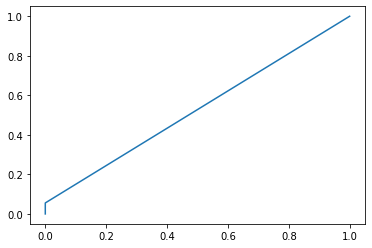

auto threshold


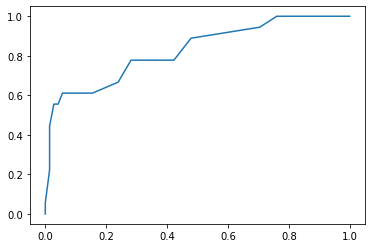

neighbours = 20 err_train = 0.15804597701149425 err_test = 0.12359550561797752
[[67  4]
 [ 7 11]]
Mera F1 Train: 0.6666666666666666
Precision Score Train:  0.8764044943820225
Recall Score Train:  0.8764044943820225
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


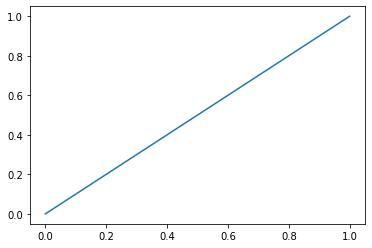

threshold =  0.2


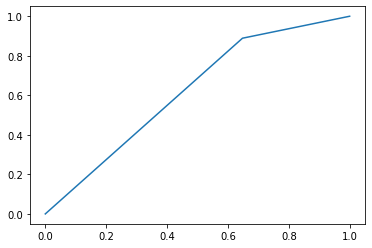

threshold =  0.4


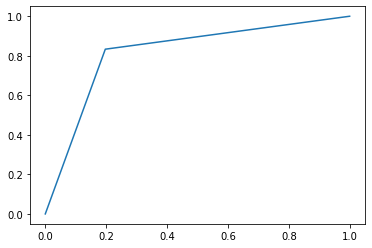

threshold =  0.5


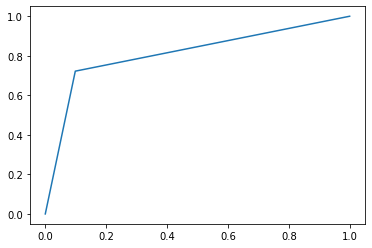

threshold =  0.7


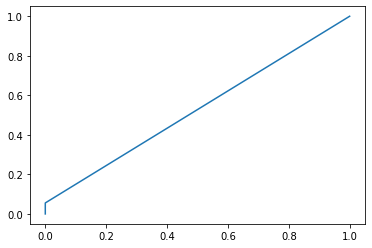

threshold =  0.8


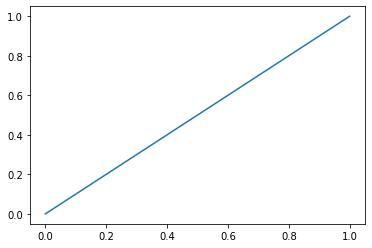

auto threshold


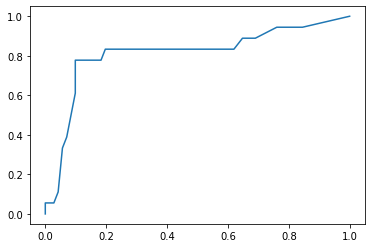

neighbours = 50 err_train = 0.15517241379310345 err_test = 0.15730337078651685
[[64  7]
 [ 7 11]]
Mera F1 Train: 0.6111111111111112
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


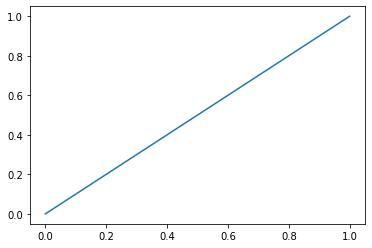

threshold =  0.2


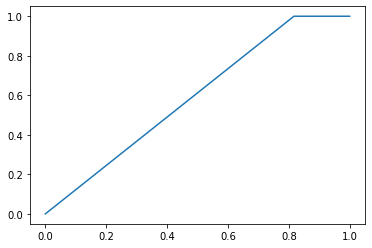

threshold =  0.4


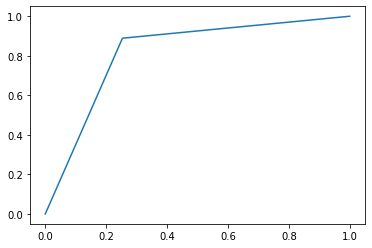

threshold =  0.5


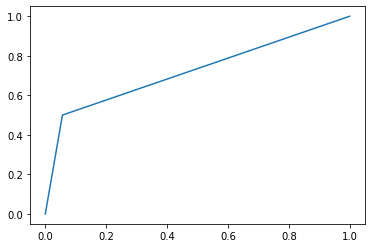

threshold =  0.7


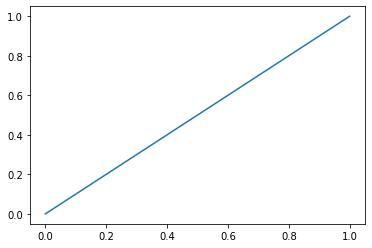

threshold =  0.8


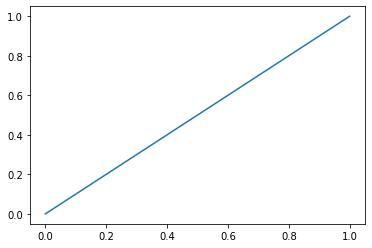

auto threshold


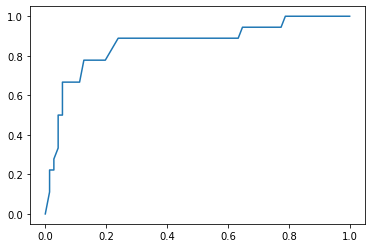

neighbours = 100 err_train = 0.11781609195402298 err_test = 0.1348314606741573
[[68  3]
 [ 9  9]]
Mera F1 Train: 0.6
Precision Score Train:  0.8651685393258427
Recall Score Train:  0.8651685393258427


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [139]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[0][i]=err_test
    Knn_train[0][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [140]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)

SVC()

In [141]:
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[0]= err_test
SVC_train[0]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.034482758620689655 err_test_SVC = 0.0898876404494382


# SMOTE

Mетод синтетической передискретизации меньшинства

In [142]:
from imblearn.over_sampling import SMOTE
X_resampled, y_resampled = SMOTE().fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 174), (1, 174)]


In [143]:
X_resampled

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KV,KY,KZ,LA,LB,LC,LD,LE,LF,LG
0,33,1,163,75,79,170,364,167,97,58,...,0.100000,0.000000,8.000000,-1.600000,0.0,0,0.500000,1.300000,14.400000,26.600000
1,41,1,154,75,88,157,384,132,112,65,...,-0.400000,-0.400000,10.500000,-2.500000,0.0,0,0.500000,1.400000,17.800000,29.500000
2,15,1,170,53,105,149,362,143,82,-38,...,0.100000,-0.600000,8.700000,-3.900000,0.0,0,0.500000,2.100000,6.100000,21.600000
3,63,1,156,70,85,165,415,172,82,80,...,-0.400000,0.000000,12.500000,0.000000,0.0,0,0.700000,1.200000,37.500000,46.800000
4,33,1,165,58,76,130,333,160,71,64,...,-0.900000,0.000000,10.100000,-1.800000,0.0,0,0.800000,1.600000,19.000000,33.700000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,21,1,131,33,91,160,350,196,101,81,...,0.021951,0.000000,8.709755,-4.160979,0.0,0,0.621951,3.453664,6.660952,38.192713
344,56,0,170,66,102,176,427,163,86,62,...,0.022907,0.000000,10.182183,-2.010181,0.0,0,0.592364,2.327998,15.905825,38.279980
345,52,0,161,62,95,158,360,156,109,85,...,0.033928,-0.330362,9.474410,-2.335711,0.0,0,0.633928,1.108338,17.283325,25.665496
346,10,0,135,28,122,142,354,214,80,112,...,-0.368543,-3.080134,18.788911,-4.131457,0.0,0,0.234271,1.857119,11.857286,25.911089


## Knn

threshold =  0.0


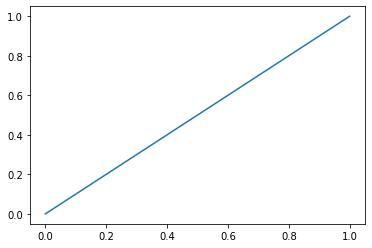

threshold =  0.2


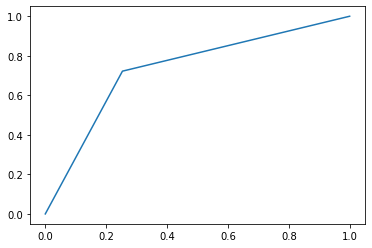

threshold =  0.4


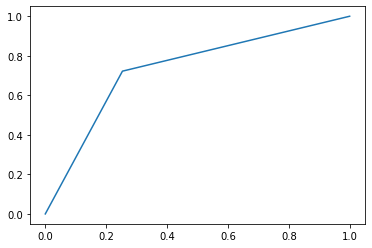

threshold =  0.5


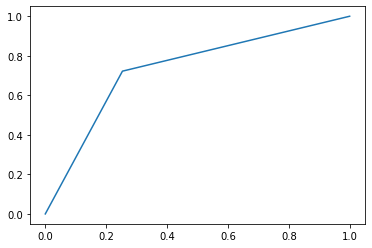

threshold =  0.7


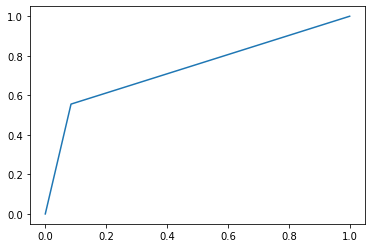

threshold =  0.8


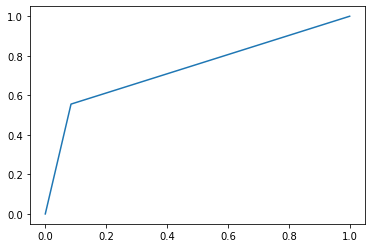

auto threshold


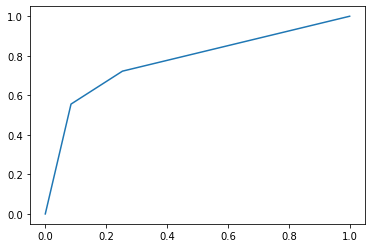

neighbours = 2 err_train = 0.0028735632183908046 err_test = 0.15730337078651685
[[65  6]
 [ 8 10]]
Mera F1 Train: 0.5882352941176471
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


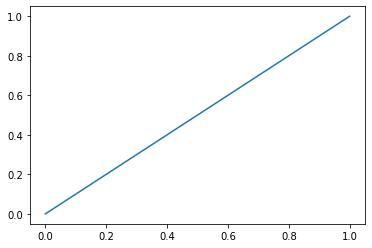

threshold =  0.2


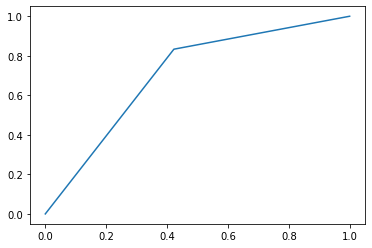

threshold =  0.4


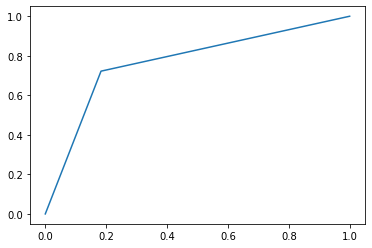

threshold =  0.5


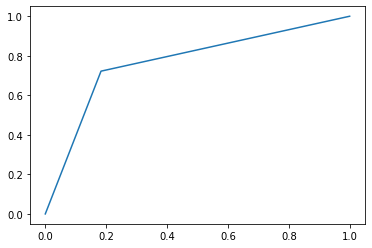

threshold =  0.7


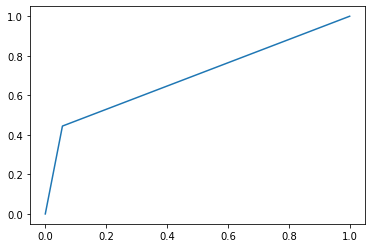

threshold =  0.8


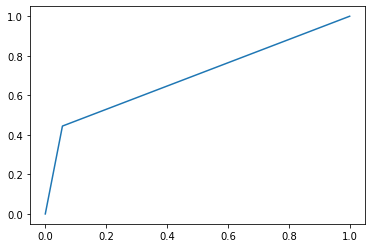

auto threshold


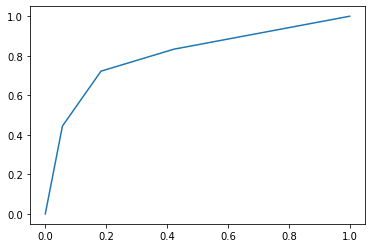

neighbours = 3 err_train = 0.06896551724137931 err_test = 0.20224719101123595
[[58 13]
 [ 5 13]]
Mera F1 Train: 0.5909090909090908
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


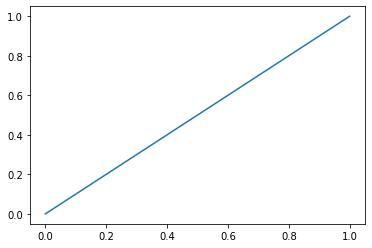

threshold =  0.2


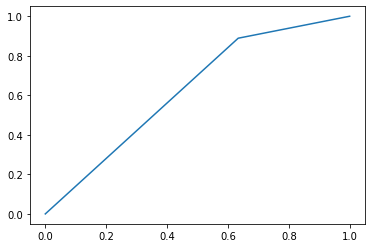

threshold =  0.4


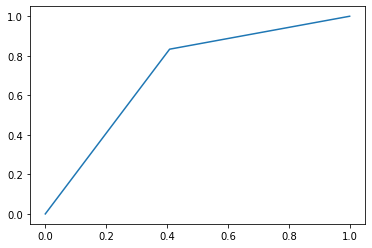

threshold =  0.5


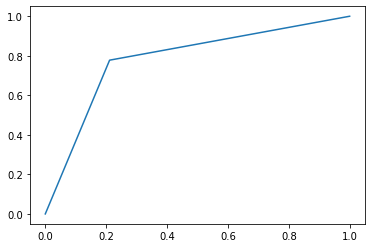

threshold =  0.7


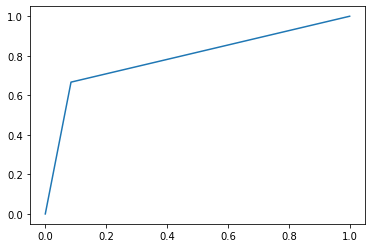

threshold =  0.8


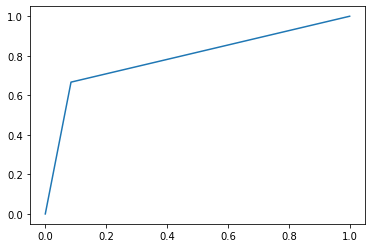

auto threshold


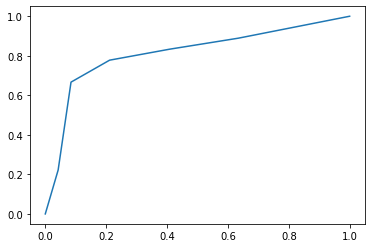

neighbours = 5 err_train = 0.10344827586206896 err_test = 0.21348314606741572
[[56 15]
 [ 4 14]]
Mera F1 Train: 0.5957446808510638
Precision Score Train:  0.7865168539325843
Recall Score Train:  0.7865168539325843
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


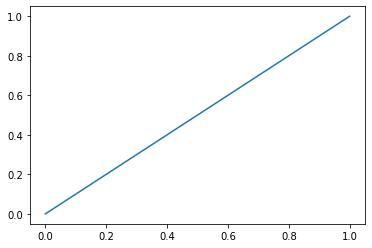

threshold =  0.2


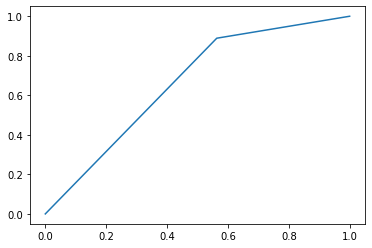

threshold =  0.4


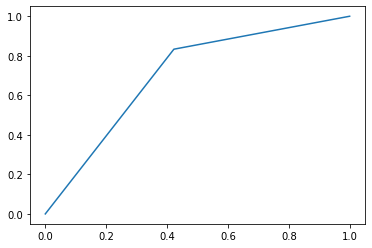

threshold =  0.5


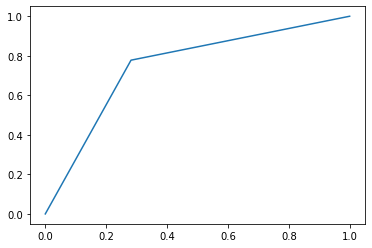

threshold =  0.7


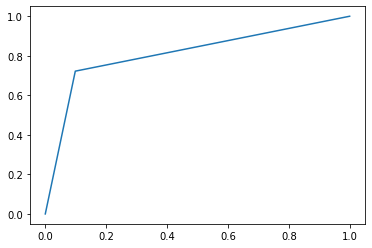

threshold =  0.8


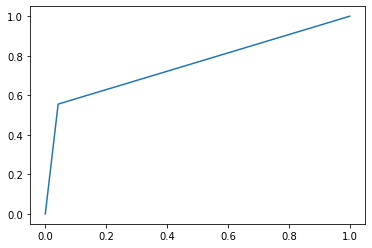

auto threshold


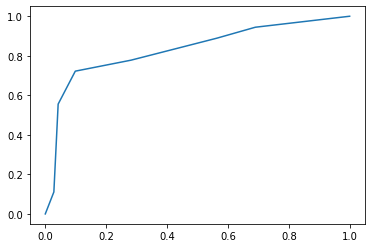

neighbours = 7 err_train = 0.13218390804597702 err_test = 0.2696629213483146
[[51 20]
 [ 4 14]]
Mera F1 Train: 0.5384615384615384
Precision Score Train:  0.7303370786516854
Recall Score Train:  0.7303370786516854
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


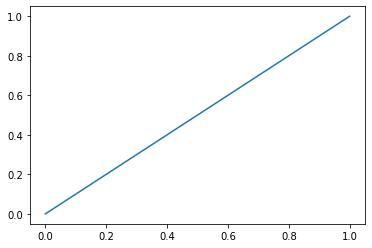

threshold =  0.2


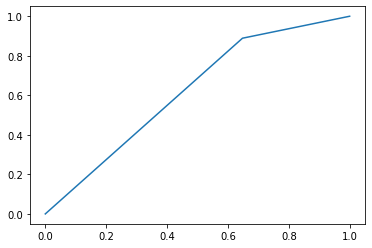

threshold =  0.4


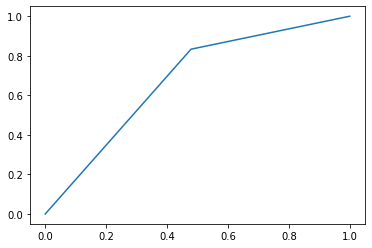

threshold =  0.5


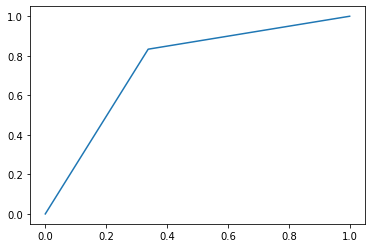

threshold =  0.7


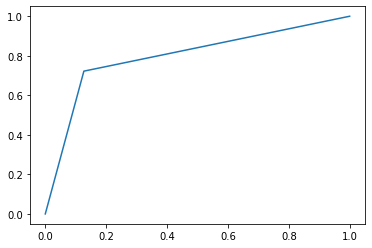

threshold =  0.8


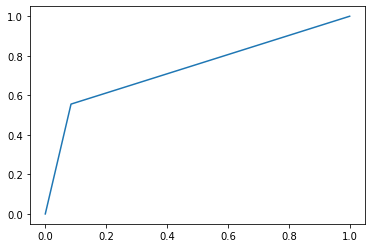

auto threshold


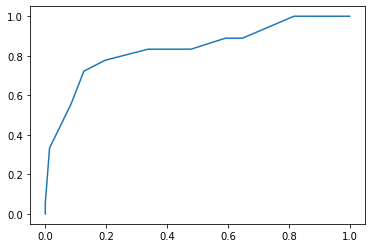

neighbours = 10 err_train = 0.11494252873563218 err_test = 0.20224719101123595
[[57 14]
 [ 4 14]]
Mera F1 Train: 0.6086956521739131
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


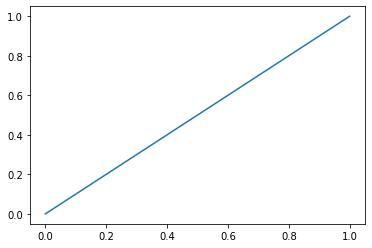

threshold =  0.2


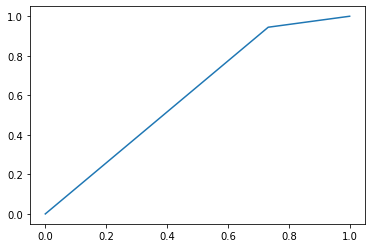

threshold =  0.4


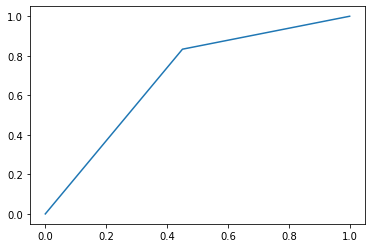

threshold =  0.5


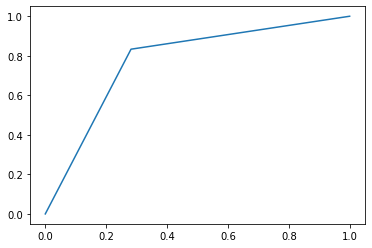

threshold =  0.7


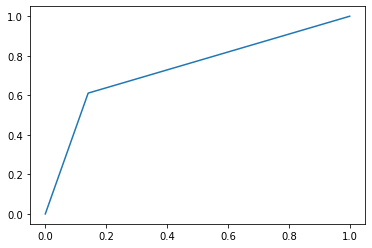

threshold =  0.8


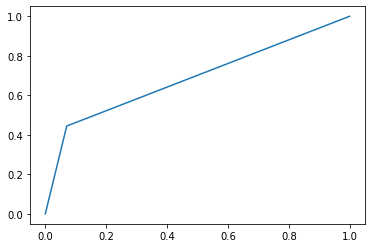

auto threshold


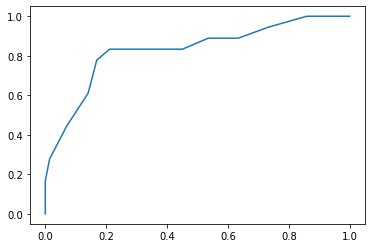

neighbours = 15 err_train = 0.15517241379310345 err_test = 0.25842696629213485
[[51 20]
 [ 3 15]]
Mera F1 Train: 0.5660377358490566
Precision Score Train:  0.7415730337078652
Recall Score Train:  0.7415730337078652
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


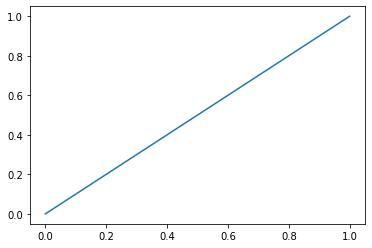

threshold =  0.2


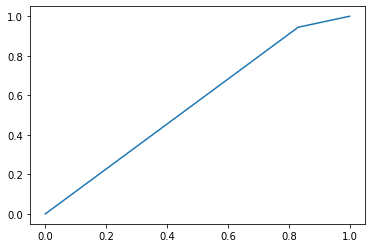

threshold =  0.4


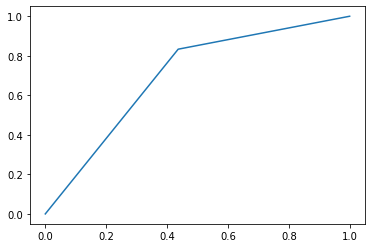

threshold =  0.5


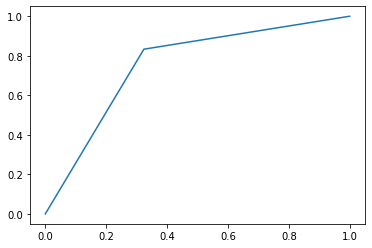

threshold =  0.7


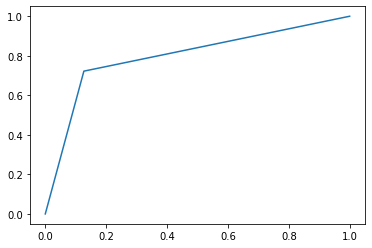

threshold =  0.8


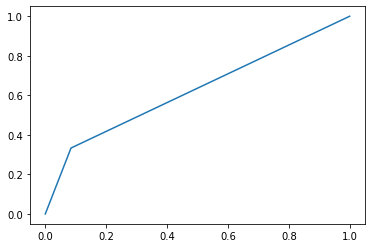

auto threshold


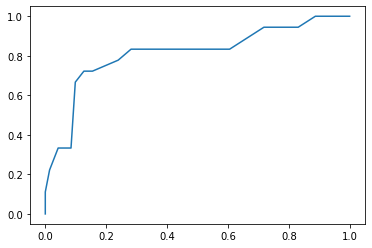

neighbours = 20 err_train = 0.14367816091954022 err_test = 0.25842696629213485
[[51 20]
 [ 3 15]]
Mera F1 Train: 0.5660377358490566
Precision Score Train:  0.7415730337078652
Recall Score Train:  0.7415730337078652
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


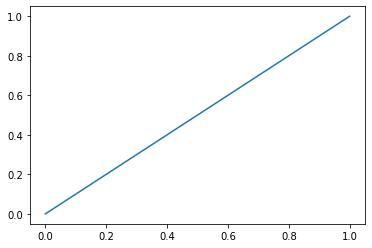

threshold =  0.2


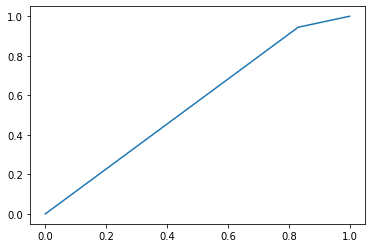

threshold =  0.4


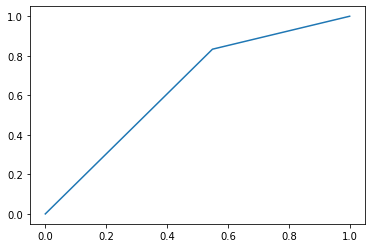

threshold =  0.5


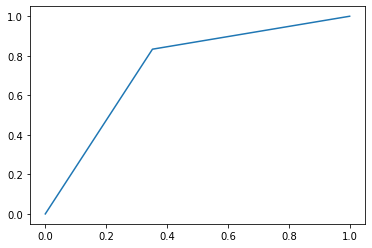

threshold =  0.7


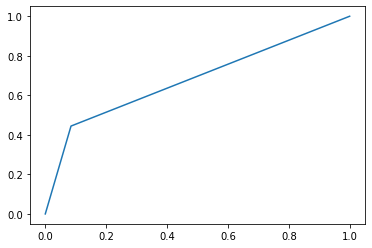

threshold =  0.8


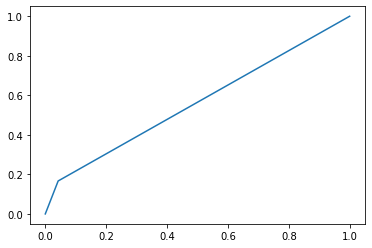

auto threshold


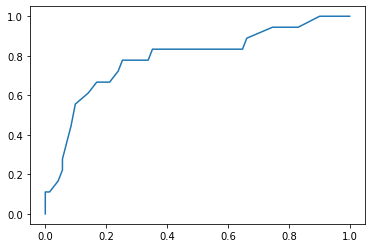

neighbours = 50 err_train = 0.1839080459770115 err_test = 0.3146067415730337
[[47 24]
 [ 4 14]]
Mera F1 Train: 0.5
Precision Score Train:  0.6853932584269663
Recall Score Train:  0.6853932584269663
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


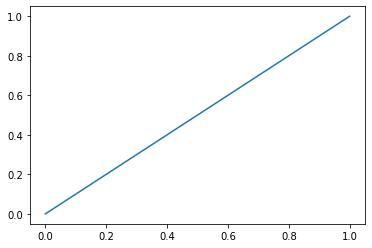

threshold =  0.2


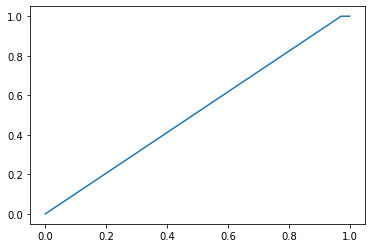

threshold =  0.4


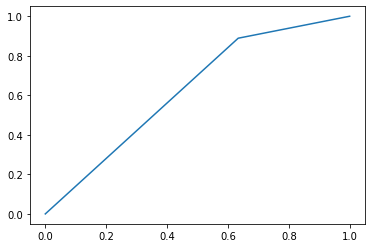

threshold =  0.5


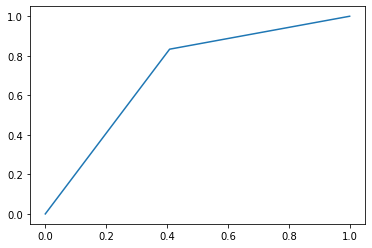

threshold =  0.7


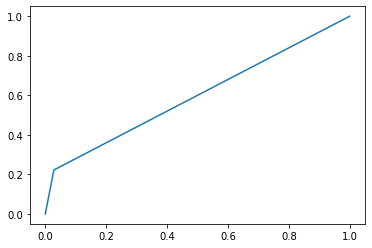

threshold =  0.8


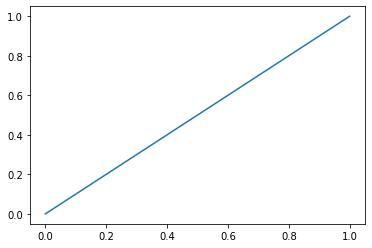

auto threshold


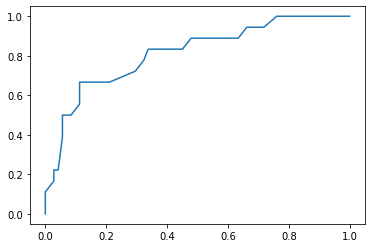

neighbours = 100 err_train = 0.1925287356321839 err_test = 0.33707865168539325
[[44 27]
 [ 3 15]]
Mera F1 Train: 0.5
Precision Score Train:  0.6629213483146067
Recall Score Train:  0.6629213483146067


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [144]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[1][i]=err_test
    Knn_train[1][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [145]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[1]= err_test
SVC_train[1]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.05459770114942529 err_test_SVC = 0.11235955056179775


In [146]:
X_resampled

,age,sex,height,weight,qrs_duration,p-r_interval,q-t_interval,t_interval,p_interval,qrs,...,KV,KY,KZ,LA,LB,LC,LD,LE,LF,LG
0,33,1,163,75,79,170,364,167,97,58,...,0.100000,0.000000,8.000000,-1.600000,0.0,0,0.500000,1.300000,14.400000,26.600000
1,41,1,154,75,88,157,384,132,112,65,...,-0.400000,-0.400000,10.500000,-2.500000,0.0,0,0.500000,1.400000,17.800000,29.500000
2,15,1,170,53,105,149,362,143,82,-38,...,0.100000,-0.600000,8.700000,-3.900000,0.0,0,0.500000,2.100000,6.100000,21.600000
3,63,1,156,70,85,165,415,172,82,80,...,-0.400000,0.000000,12.500000,0.000000,0.0,0,0.700000,1.200000,37.500000,46.800000
4,33,1,165,58,76,130,333,160,71,64,...,-0.900000,0.000000,10.100000,-1.800000,0.0,0,0.800000,1.600000,19.000000,33.700000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,21,1,131,33,91,160,350,196,101,81,...,0.021951,0.000000,8.709755,-4.160979,0.0,0,0.621951,3.453664,6.660952,38.192713
344,56,0,170,66,102,176,427,163,86,62,...,0.022907,0.000000,10.182183,-2.010181,0.0,0,0.592364,2.327998,15.905825,38.279980
345,52,0,161,62,95,158,360,156,109,85,...,0.033928,-0.330362,9.474410,-2.335711,0.0,0,0.633928,1.108338,17.283325,25.665496
346,10,0,135,28,122,142,354,214,80,112,...,-0.368543,-3.080134,18.788911,-4.131457,0.0,0,0.234271,1.857119,11.857286,25.911089


# BorderlineSMOTE

In [147]:
from imblearn.over_sampling import BorderlineSMOTE
X_resampled, y_resampled = BorderlineSMOTE().fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 174), (1, 174)]


## Knn

threshold =  0.0


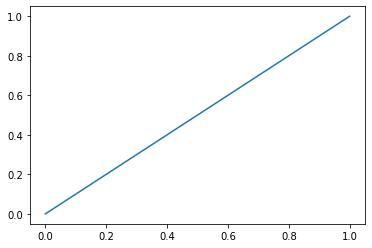

threshold =  0.2


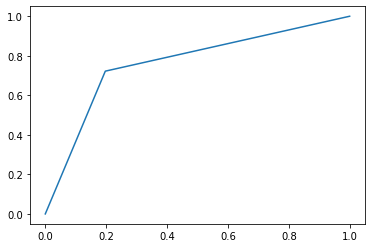

threshold =  0.4


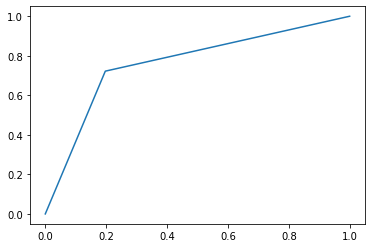

threshold =  0.5


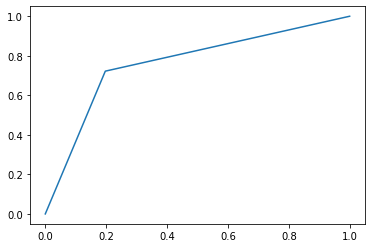

threshold =  0.7


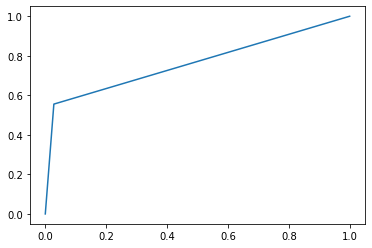

threshold =  0.8


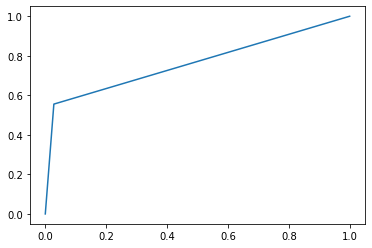

auto threshold


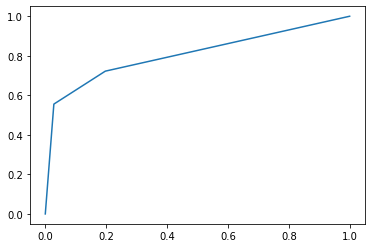

neighbours = 2 err_train = 0.005747126436781609 err_test = 0.11235955056179775
[[69  2]
 [ 8 10]]
Mera F1 Train: 0.6666666666666667
Precision Score Train:  0.8876404494382022
Recall Score Train:  0.8876404494382022
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


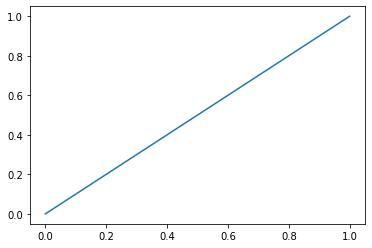

threshold =  0.2


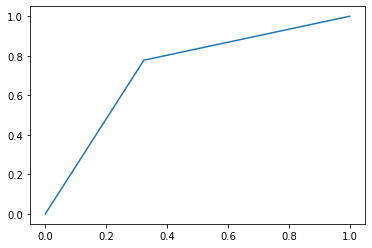

threshold =  0.4


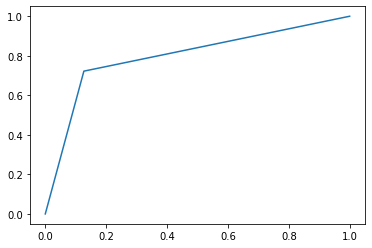

threshold =  0.5


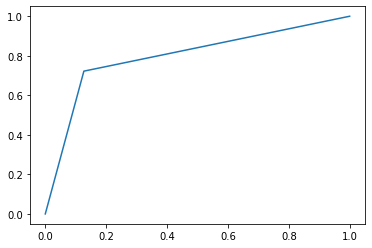

threshold =  0.7


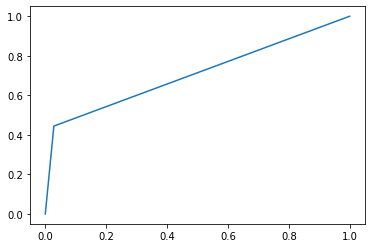

threshold =  0.8


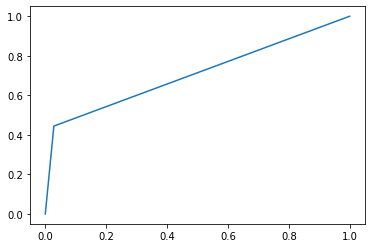

auto threshold


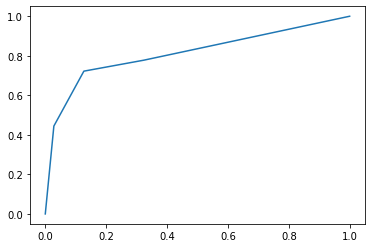

neighbours = 3 err_train = 0.0603448275862069 err_test = 0.15730337078651685
[[62  9]
 [ 5 13]]
Mera F1 Train: 0.65
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


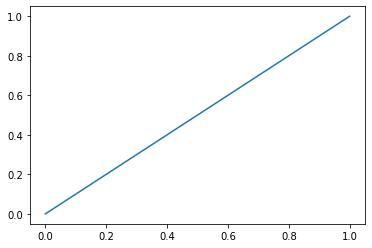

threshold =  0.2


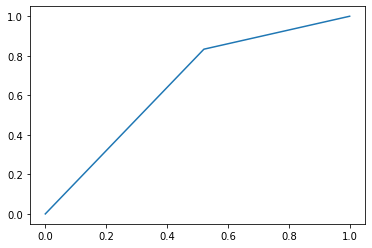

threshold =  0.4


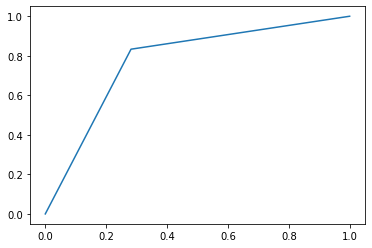

threshold =  0.5


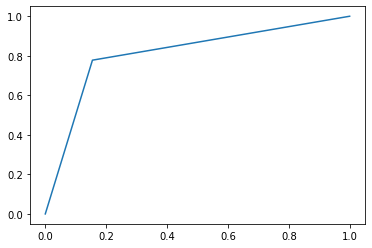

threshold =  0.7


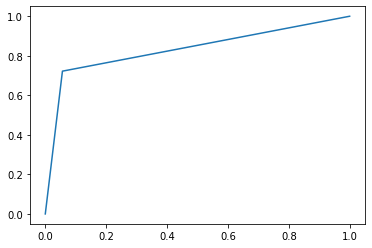

threshold =  0.8


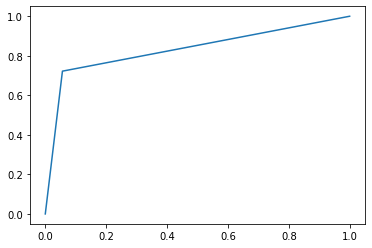

auto threshold


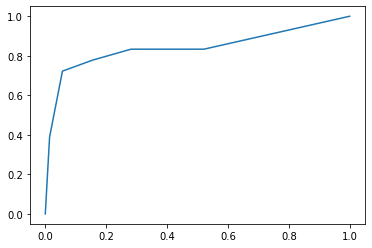

neighbours = 5 err_train = 0.08333333333333333 err_test = 0.16853932584269662
[[60 11]
 [ 4 14]]
Mera F1 Train: 0.6511627906976745
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


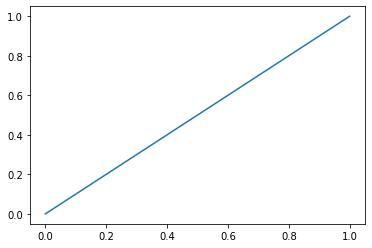

threshold =  0.2


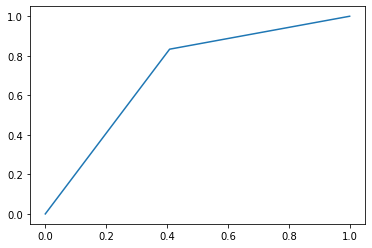

threshold =  0.4


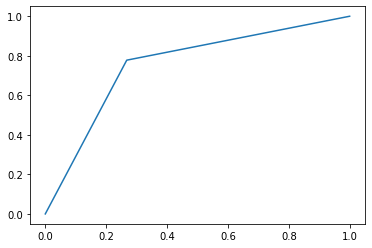

threshold =  0.5


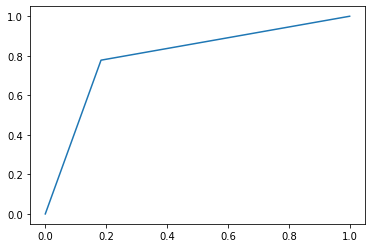

threshold =  0.7


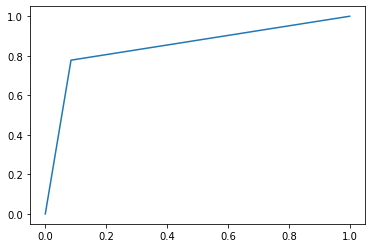

threshold =  0.8


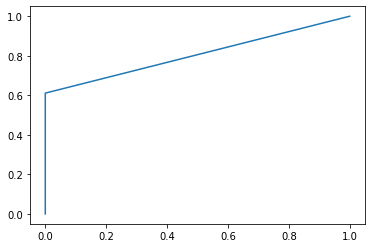

auto threshold


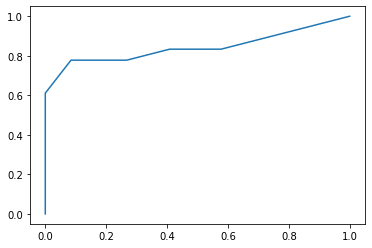

neighbours = 7 err_train = 0.09195402298850575 err_test = 0.19101123595505617
[[58 13]
 [ 4 14]]
Mera F1 Train: 0.6222222222222222
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


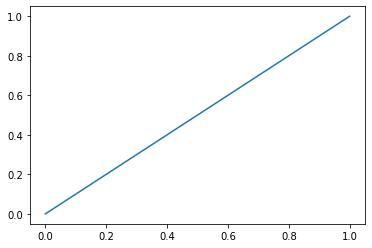

threshold =  0.2


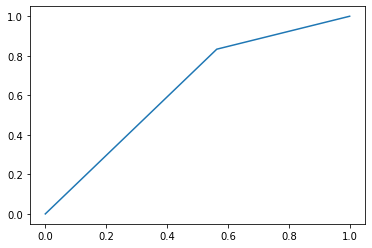

threshold =  0.4


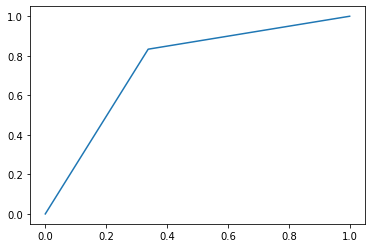

threshold =  0.5


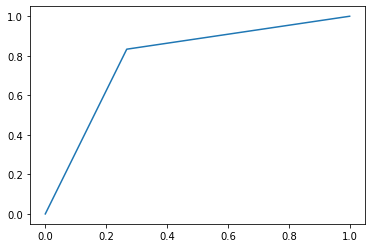

threshold =  0.7


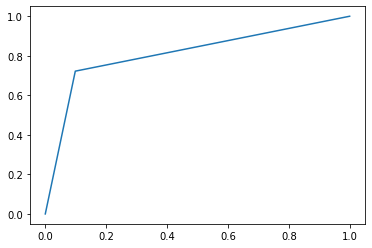

threshold =  0.8


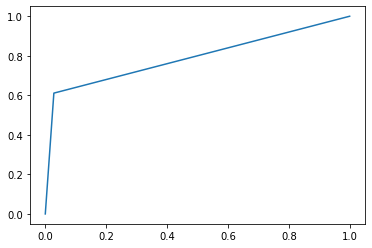

auto threshold


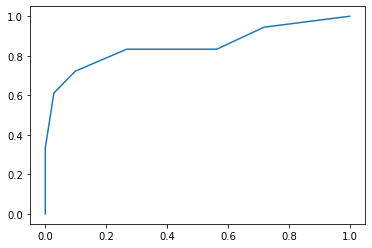

neighbours = 10 err_train = 0.09770114942528736 err_test = 0.19101123595505617
[[58 13]
 [ 4 14]]
Mera F1 Train: 0.6222222222222222
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


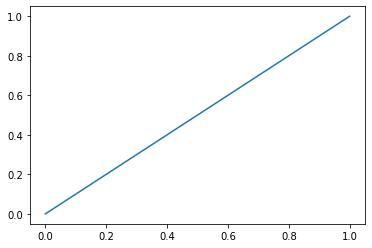

threshold =  0.2


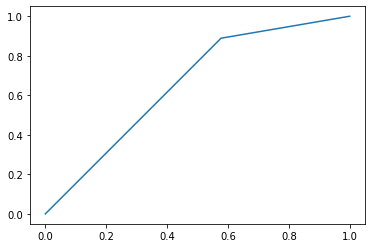

threshold =  0.4


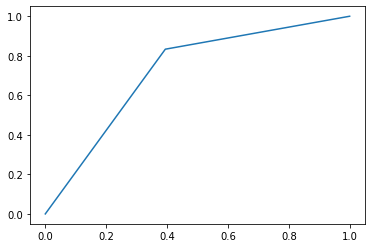

threshold =  0.5


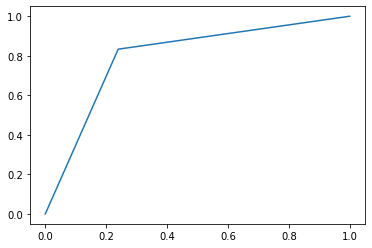

threshold =  0.7


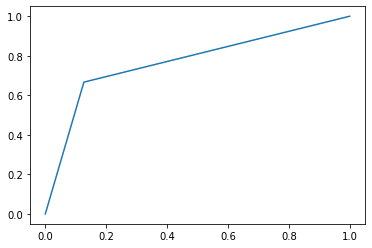

threshold =  0.8


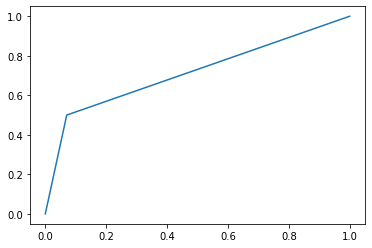

auto threshold


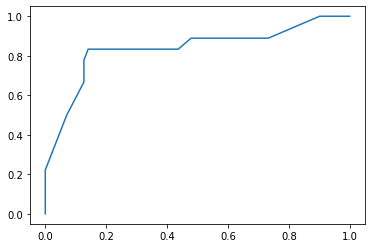

neighbours = 15 err_train = 0.13218390804597702 err_test = 0.2247191011235955
[[54 17]
 [ 3 15]]
Mera F1 Train: 0.6
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


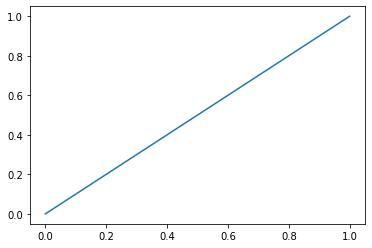

threshold =  0.2


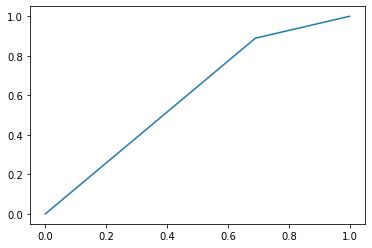

threshold =  0.4


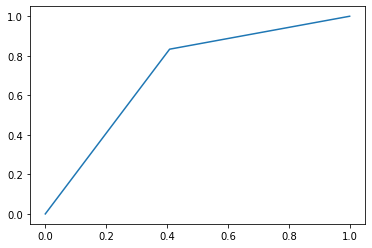

threshold =  0.5


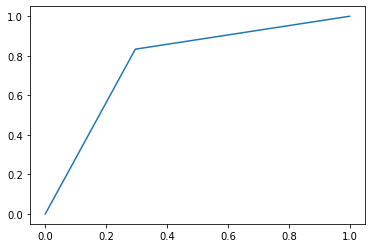

threshold =  0.7


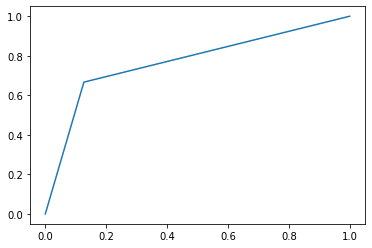

threshold =  0.8


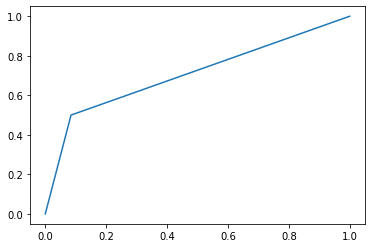

auto threshold


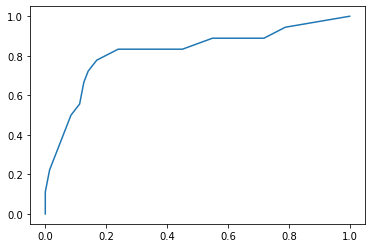

neighbours = 20 err_train = 0.1206896551724138 err_test = 0.2247191011235955
[[54 17]
 [ 3 15]]
Mera F1 Train: 0.6
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


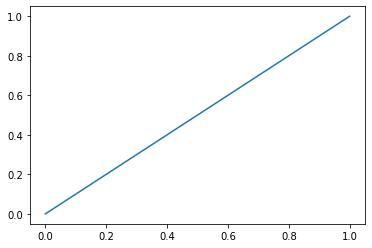

threshold =  0.2


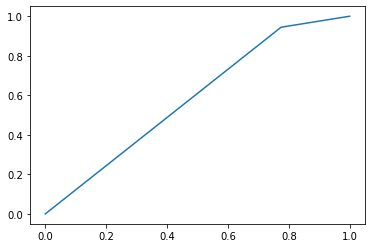

threshold =  0.4


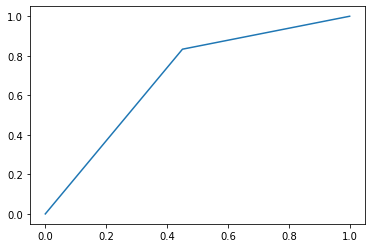

threshold =  0.5


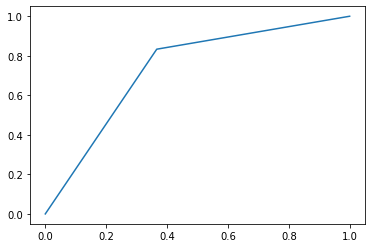

threshold =  0.7


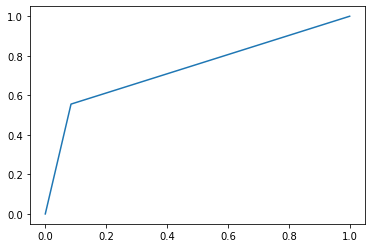

threshold =  0.8


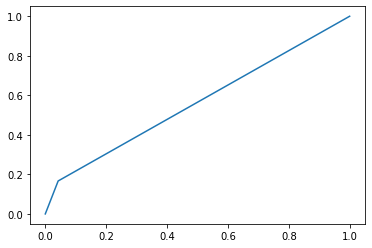

auto threshold


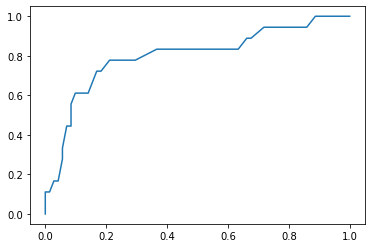

neighbours = 50 err_train = 0.14942528735632185 err_test = 0.3258426966292135
[[45 26]
 [ 3 15]]
Mera F1 Train: 0.5084745762711864
Precision Score Train:  0.6741573033707865
Recall Score Train:  0.6741573033707865
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


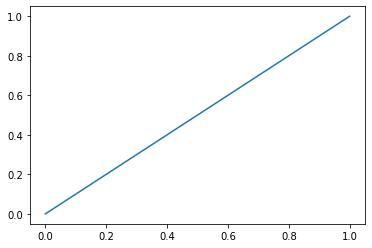

threshold =  0.2


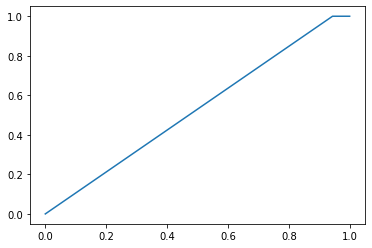

threshold =  0.4


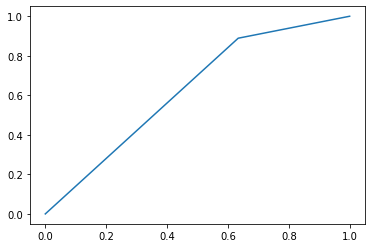

threshold =  0.5


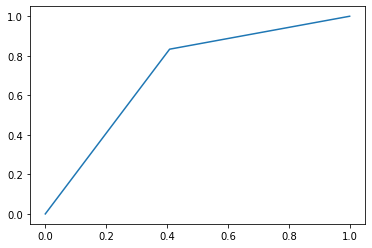

threshold =  0.7


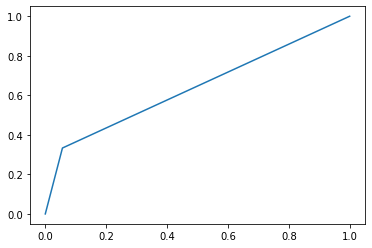

threshold =  0.8


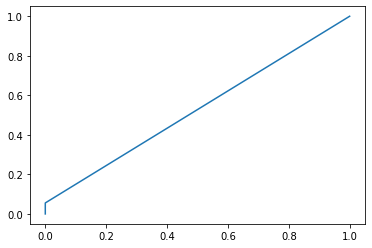

auto threshold


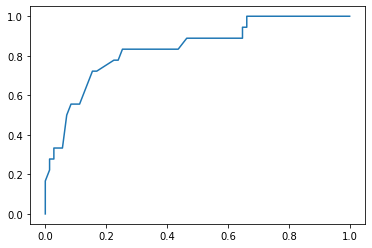

neighbours = 100 err_train = 0.1839080459770115 err_test = 0.3258426966292135
[[45 26]
 [ 3 15]]
Mera F1 Train: 0.5084745762711864
Precision Score Train:  0.6741573033707865
Recall Score Train:  0.6741573033707865


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [148]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[2][i]=err_test
    Knn_train[2][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [149]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[2]= err_test
SVC_train[2]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.03735632183908046 err_test_SVC = 0.11235955056179775


# ADASYN

Метод адаптивной синтетической выборки

In [150]:
from imblearn.over_sampling import ADASYN
X_resampled, y_resampled = ADASYN().fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 174), (1, 171)]


threshold =  0.0


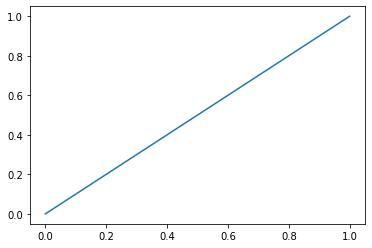

threshold =  0.2


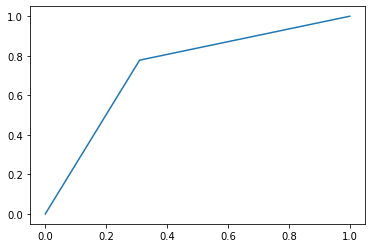

threshold =  0.4


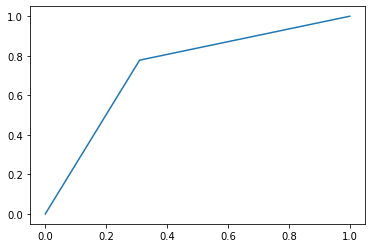

threshold =  0.5


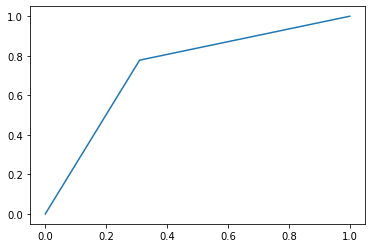

threshold =  0.7


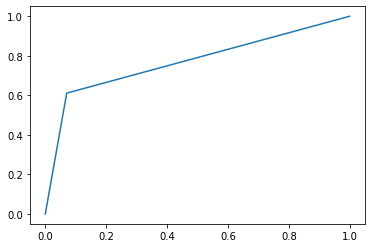

threshold =  0.8


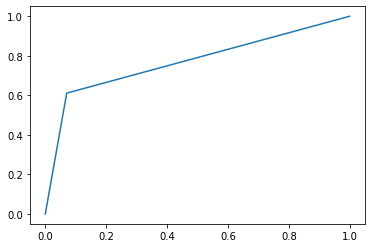

auto threshold


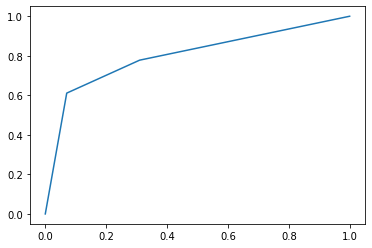

neighbours = 2 err_train = 0.0 err_test = 0.1348314606741573
[[66  5]
 [ 7 11]]
Mera F1 Train: 0.6470588235294118
Precision Score Train:  0.8651685393258427
Recall Score Train:  0.8651685393258427
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


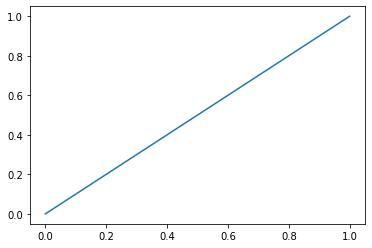

threshold =  0.2


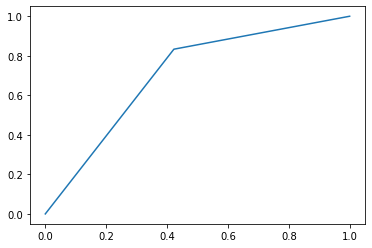

threshold =  0.4


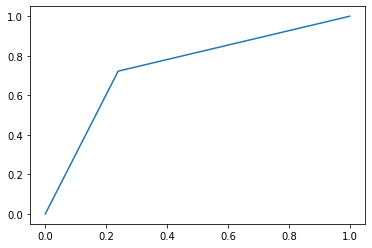

threshold =  0.5


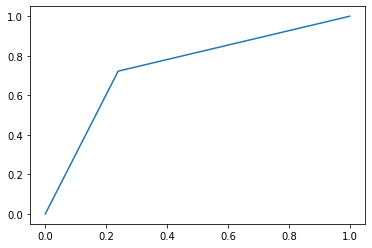

threshold =  0.7


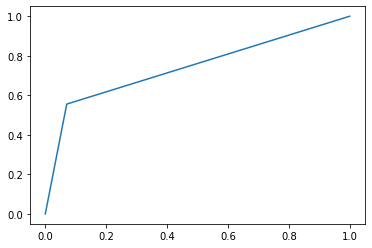

threshold =  0.8


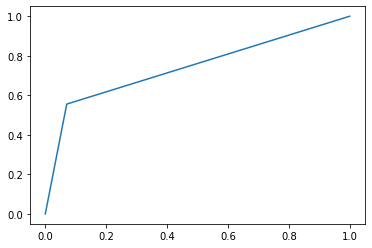

auto threshold


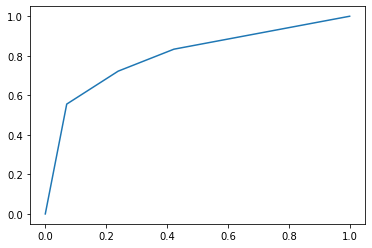

neighbours = 3 err_train = 0.08405797101449275 err_test = 0.24719101123595505
[[54 17]
 [ 5 13]]
Mera F1 Train: 0.5416666666666666
Precision Score Train:  0.7528089887640449
Recall Score Train:  0.7528089887640449
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


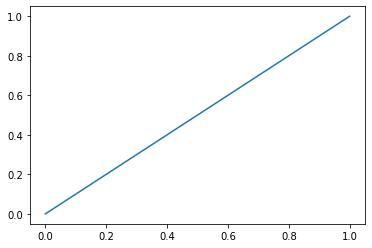

threshold =  0.2


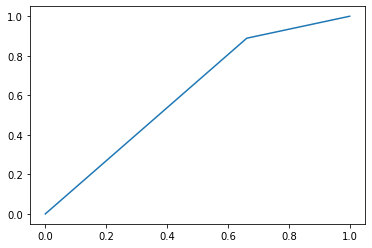

threshold =  0.4


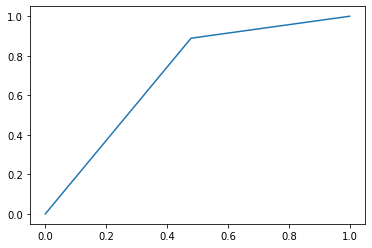

threshold =  0.5


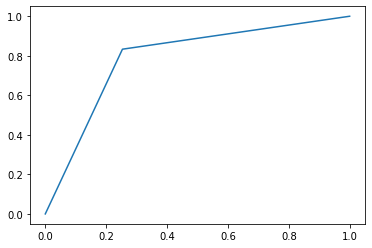

threshold =  0.7


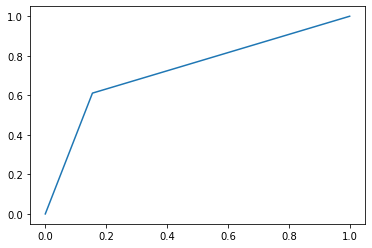

threshold =  0.8


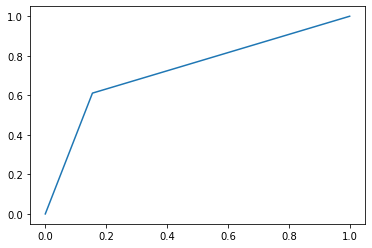

auto threshold


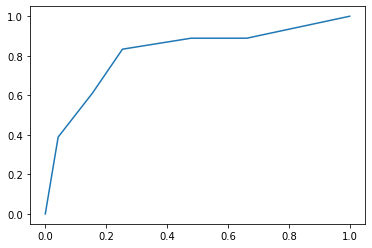

neighbours = 5 err_train = 0.1246376811594203 err_test = 0.23595505617977527
[[53 18]
 [ 3 15]]
Mera F1 Train: 0.5882352941176471
Precision Score Train:  0.7640449438202247
Recall Score Train:  0.7640449438202247
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


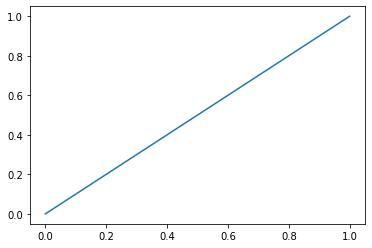

threshold =  0.2


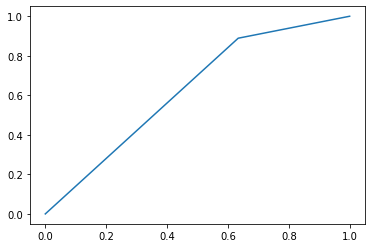

threshold =  0.4


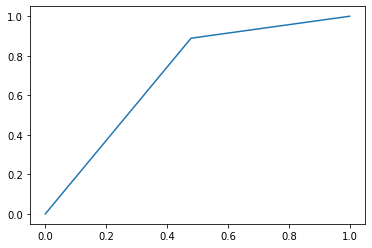

threshold =  0.5


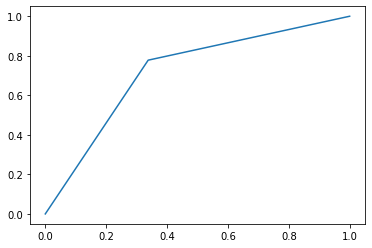

threshold =  0.7


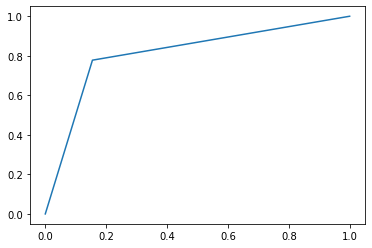

threshold =  0.8


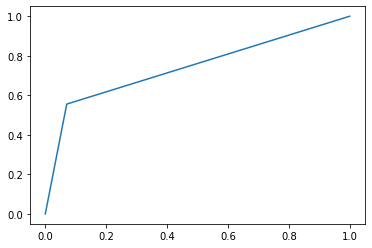

auto threshold


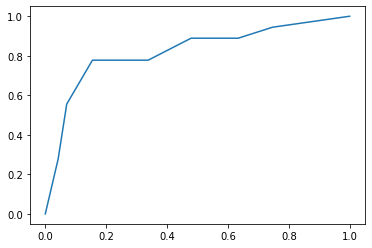

neighbours = 7 err_train = 0.15942028985507245 err_test = 0.3146067415730337
[[47 24]
 [ 4 14]]
Mera F1 Train: 0.5
Precision Score Train:  0.6853932584269663
Recall Score Train:  0.6853932584269663
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


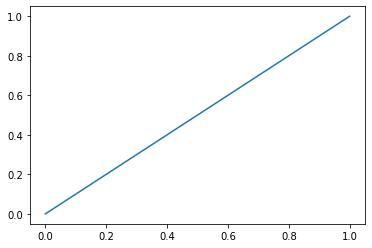

threshold =  0.2


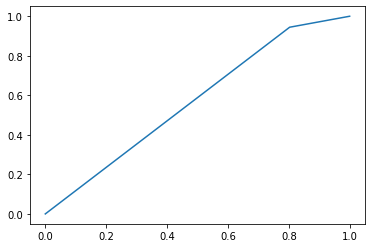

threshold =  0.4


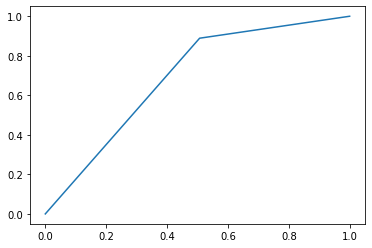

threshold =  0.5


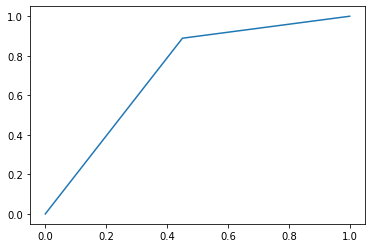

threshold =  0.7


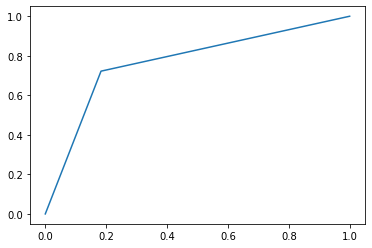

threshold =  0.8


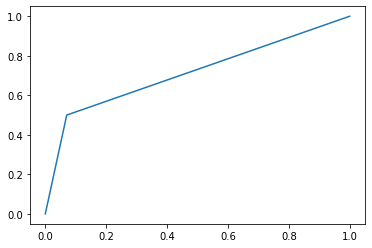

auto threshold


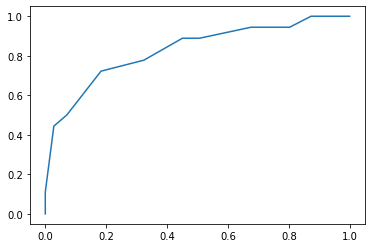

neighbours = 10 err_train = 0.15942028985507245 err_test = 0.30337078651685395
[[48 23]
 [ 4 14]]
Mera F1 Train: 0.5090909090909091
Precision Score Train:  0.6966292134831461
Recall Score Train:  0.6966292134831461
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


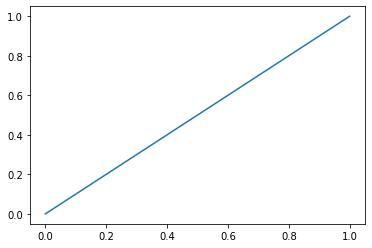

threshold =  0.2


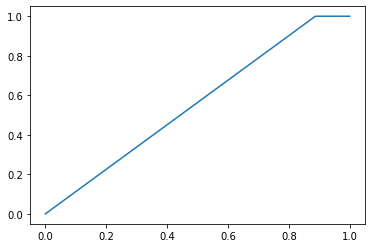

threshold =  0.4


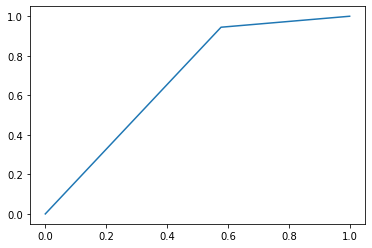

threshold =  0.5


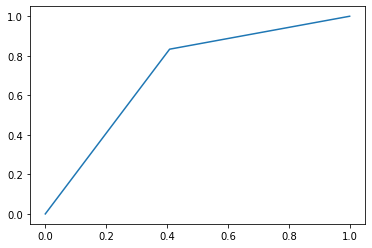

threshold =  0.7


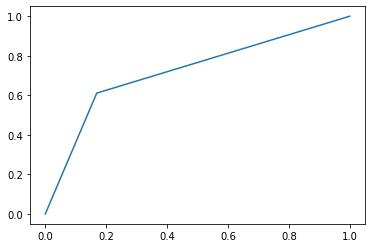

threshold =  0.8


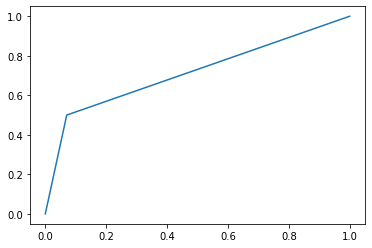

auto threshold


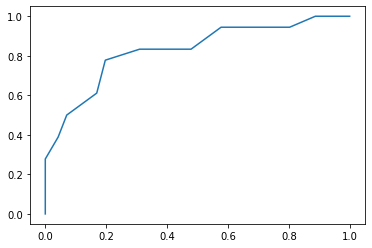

neighbours = 15 err_train = 0.20869565217391303 err_test = 0.3595505617977528
[[42 29]
 [ 3 15]]
Mera F1 Train: 0.4838709677419354
Precision Score Train:  0.6404494382022472
Recall Score Train:  0.6404494382022472
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


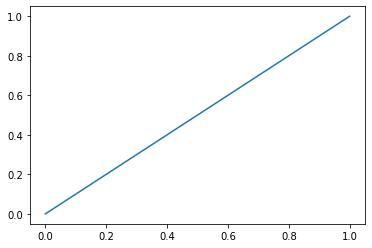

threshold =  0.2


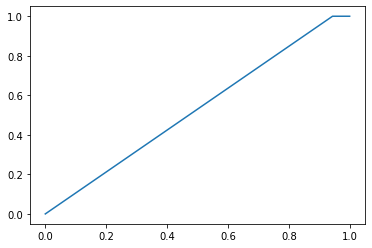

threshold =  0.4


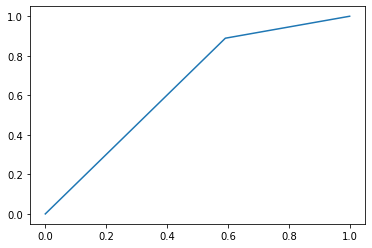

threshold =  0.5


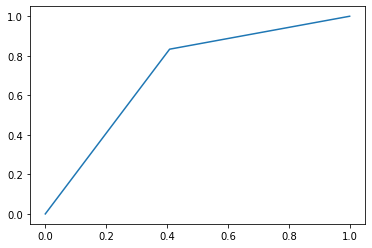

threshold =  0.7


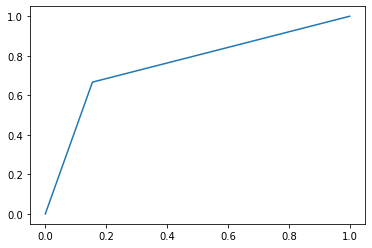

threshold =  0.8


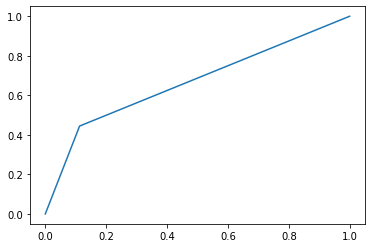

auto threshold


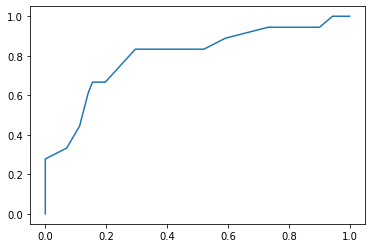

neighbours = 20 err_train = 0.18840579710144928 err_test = 0.33707865168539325
[[44 27]
 [ 3 15]]
Mera F1 Train: 0.5
Precision Score Train:  0.6629213483146067
Recall Score Train:  0.6629213483146067
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


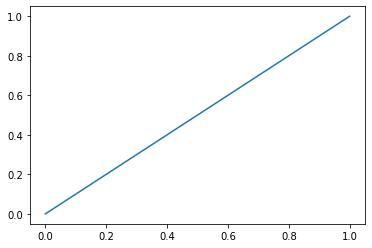

threshold =  0.2


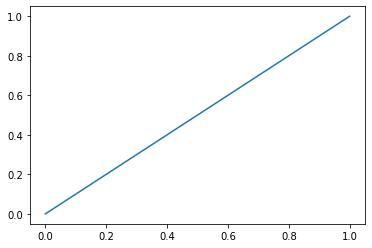

threshold =  0.4


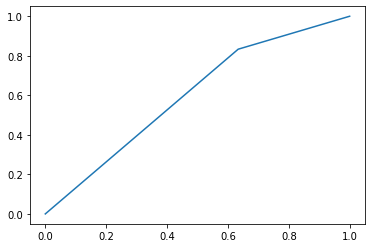

threshold =  0.5


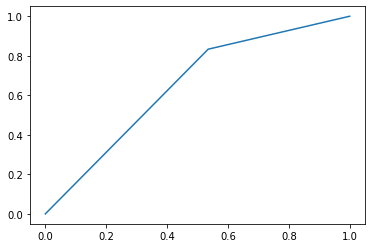

threshold =  0.7


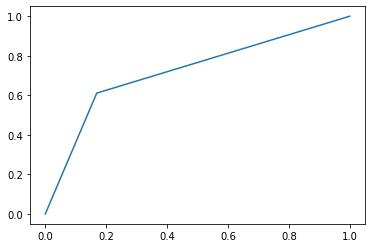

threshold =  0.8


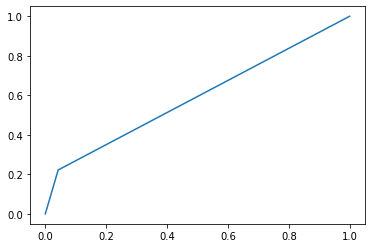

auto threshold


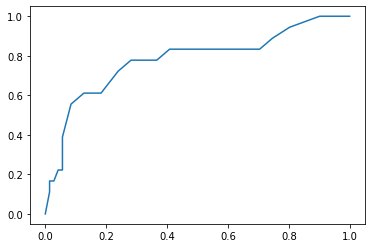

neighbours = 50 err_train = 0.22608695652173913 err_test = 0.449438202247191
[[34 37]
 [ 3 15]]
Mera F1 Train: 0.42857142857142855
Precision Score Train:  0.550561797752809
Recall Score Train:  0.550561797752809
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


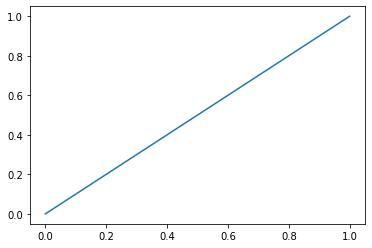

threshold =  0.2


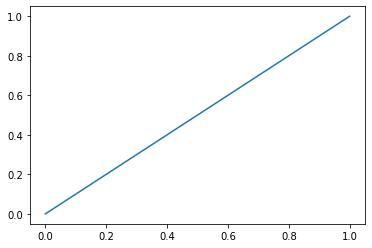

threshold =  0.4


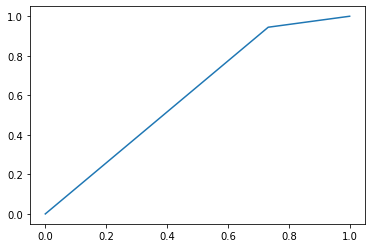

threshold =  0.5


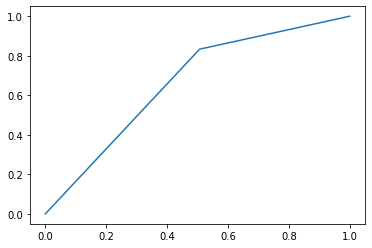

threshold =  0.7


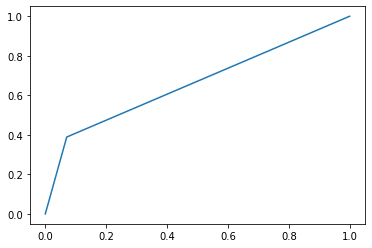

threshold =  0.8


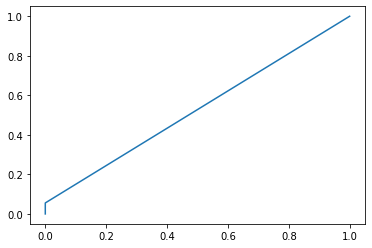

auto threshold


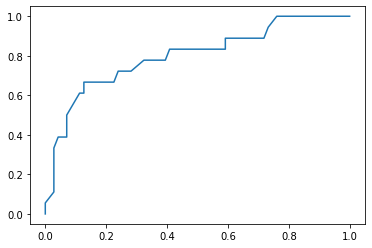

neighbours = 100 err_train = 0.2608695652173913 err_test = 0.42696629213483145
[[36 35]
 [ 3 15]]
Mera F1 Train: 0.4411764705882353
Precision Score Train:  0.5730337078651685
Recall Score Train:  0.5730337078651685


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [151]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[3][i]=err_test
    Knn_train[3][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

В ADASYN основное внимание уделяется генерации выборок рядом с исходными выборками, которые ошибочно классифицируются с использованием классификатора k-ближайших соседей.
SMOTE не делает никаких различий между простыми и жесткими выборками, которые должны быть классифицированы с использованием правила ближайших соседей.
Это подтверждают исследования, метод k-ближайших соседей для ADASYN работает хуже, чем для SMOTE

## Support Vector Classifier

In [152]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[3]= err_test
SVC_train[3]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.06956521739130435 err_test_SVC = 0.12359550561797752


# Prototype generation

## ClusterCentroids

In [153]:
from imblearn.under_sampling import ClusterCentroids
cc = ClusterCentroids(random_state=0)
X_resampled, y_resampled = cc.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 32), (1, 32)]


## Knn

threshold =  0.0


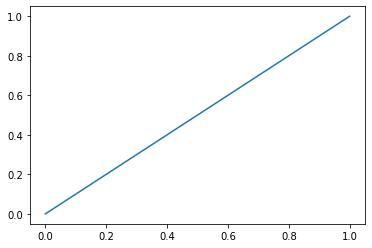

threshold =  0.2


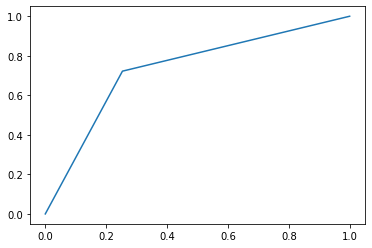

threshold =  0.4


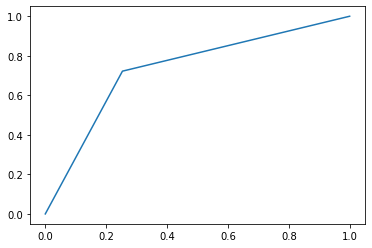

threshold =  0.5


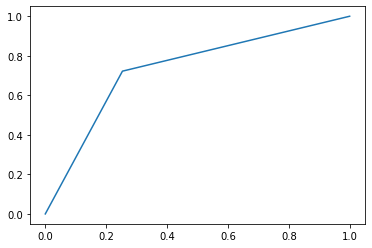

threshold =  0.7


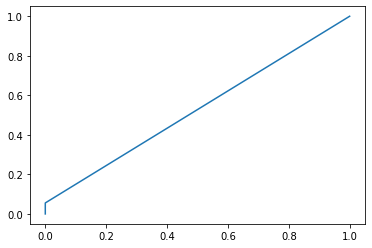

threshold =  0.8


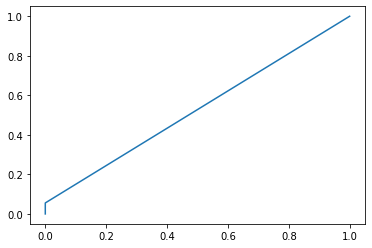

auto threshold


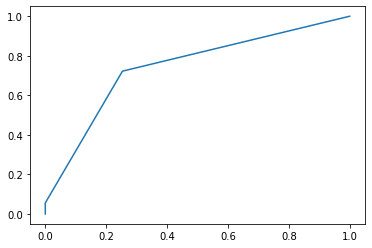

neighbours = 2 err_train = 0.234375 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


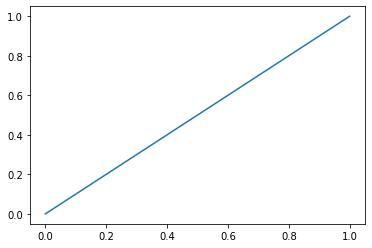

threshold =  0.2


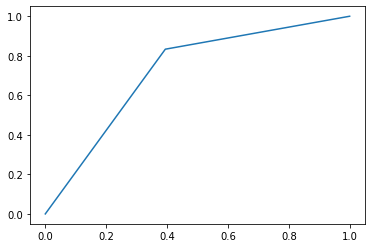

threshold =  0.4


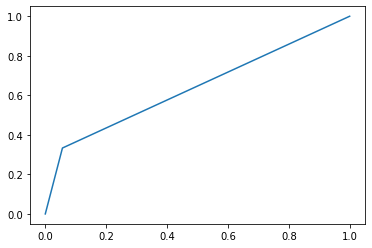

threshold =  0.5


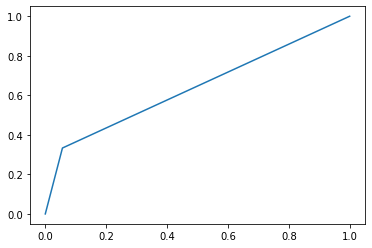

threshold =  0.7


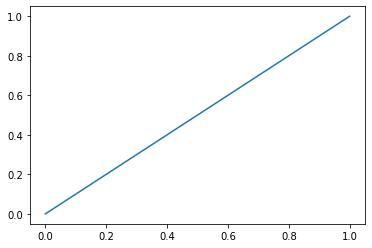

threshold =  0.8


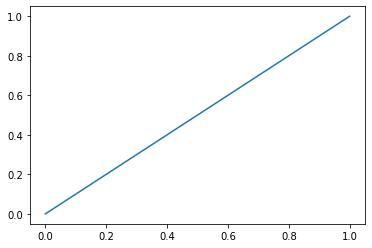

auto threshold


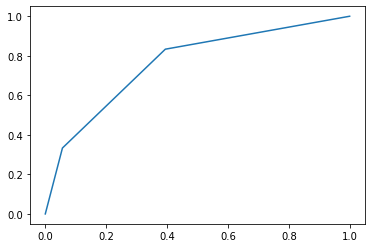

neighbours = 3 err_train = 0.171875 err_test = 0.1797752808988764
[[67  4]
 [12  6]]
Mera F1 Train: 0.42857142857142855
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


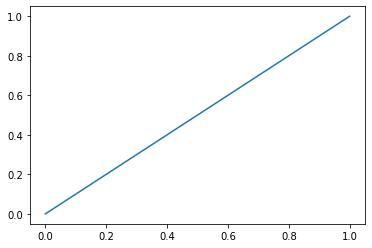

threshold =  0.2


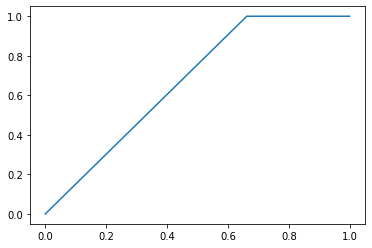

threshold =  0.4


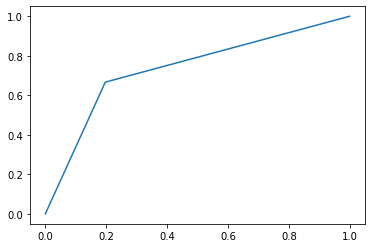

threshold =  0.5


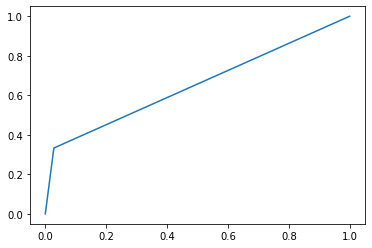

threshold =  0.7


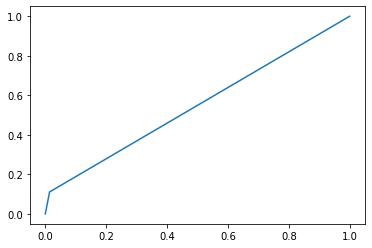

threshold =  0.8


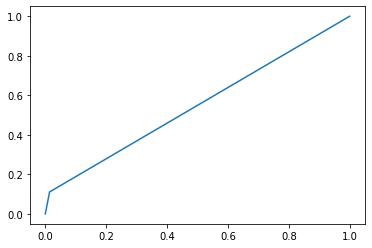

auto threshold


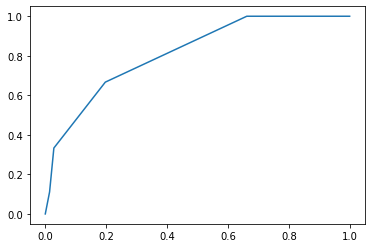

neighbours = 5 err_train = 0.234375 err_test = 0.15730337078651685
[[69  2]
 [12  6]]
Mera F1 Train: 0.46153846153846156
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


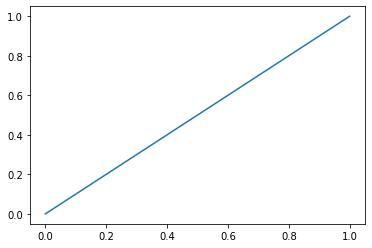

threshold =  0.2


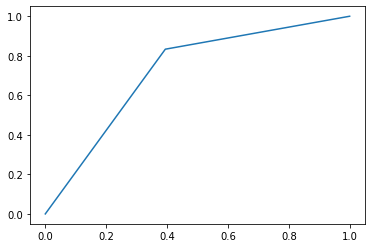

threshold =  0.4


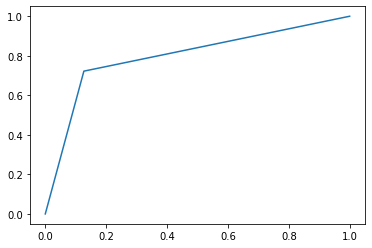

threshold =  0.5


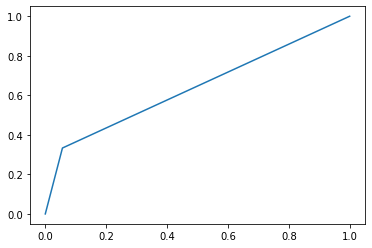

threshold =  0.7


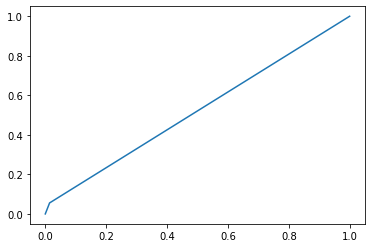

threshold =  0.8


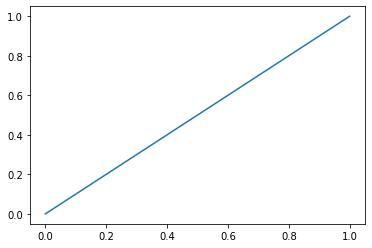

auto threshold


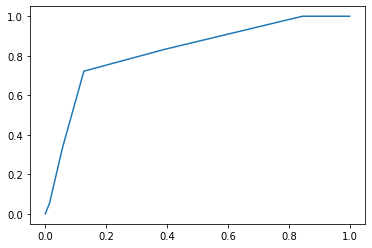

neighbours = 7 err_train = 0.28125 err_test = 0.1797752808988764
[[67  4]
 [12  6]]
Mera F1 Train: 0.42857142857142855
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


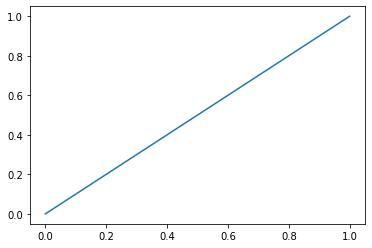

threshold =  0.2


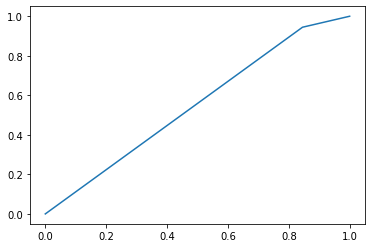

threshold =  0.4


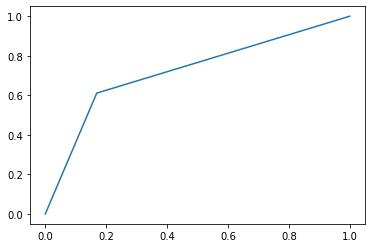

threshold =  0.5


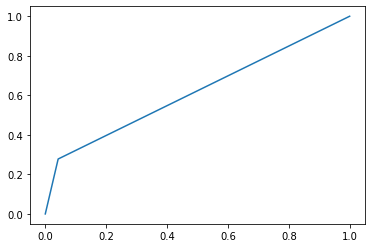

threshold =  0.7


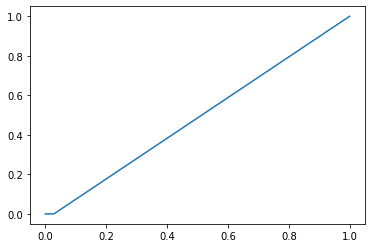

threshold =  0.8


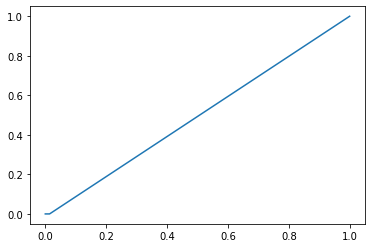

auto threshold


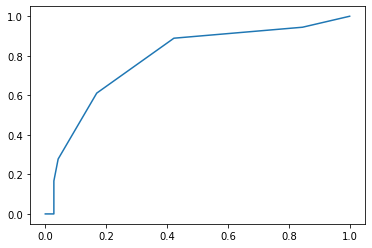

neighbours = 10 err_train = 0.328125 err_test = 0.19101123595505617
[[69  2]
 [15  3]]
Mera F1 Train: 0.2608695652173913
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


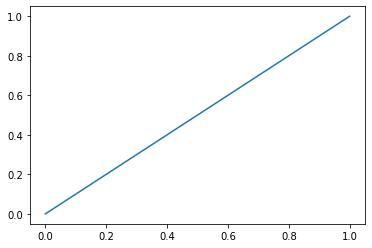

threshold =  0.2


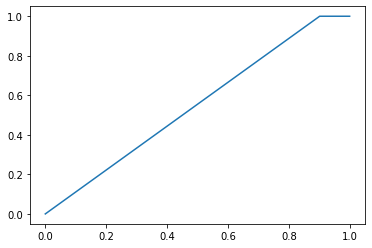

threshold =  0.4


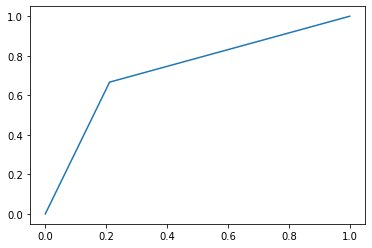

threshold =  0.5


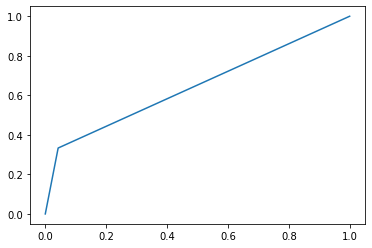

threshold =  0.7


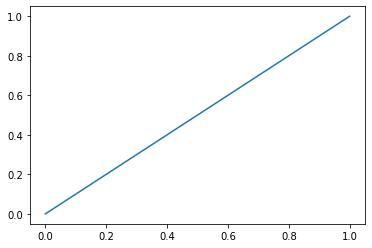

threshold =  0.8


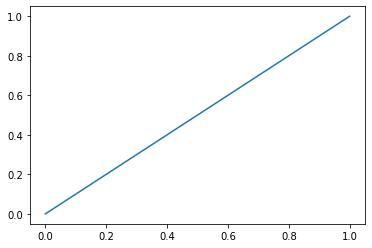

auto threshold


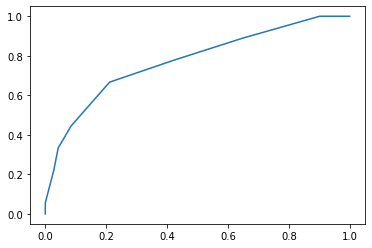

neighbours = 15 err_train = 0.234375 err_test = 0.16853932584269662
[[68  3]
 [12  6]]
Mera F1 Train: 0.4444444444444444
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


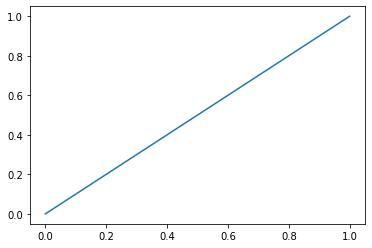

threshold =  0.2


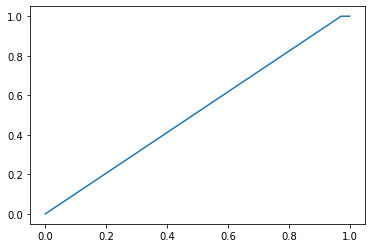

threshold =  0.4


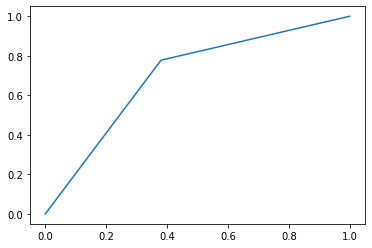

threshold =  0.5


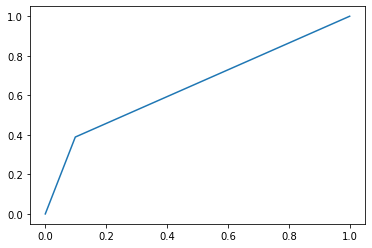

threshold =  0.7


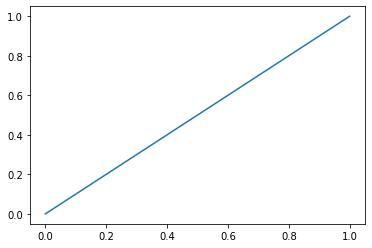

threshold =  0.8


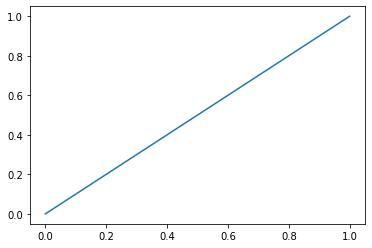

auto threshold


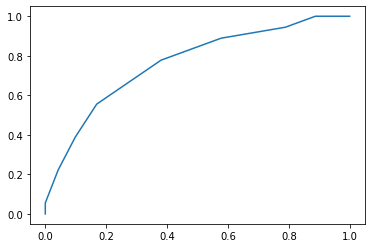

neighbours = 20 err_train = 0.28125 err_test = 0.19101123595505617
[[68  3]
 [14  4]]
Mera F1 Train: 0.32
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


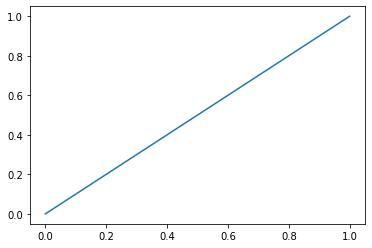

threshold =  0.2


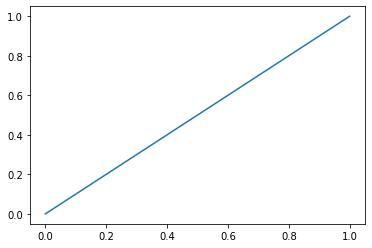

threshold =  0.4


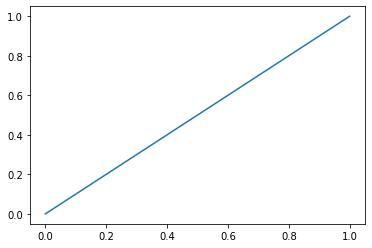

threshold =  0.5


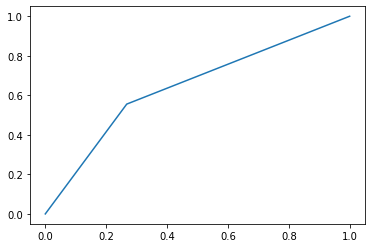

threshold =  0.7


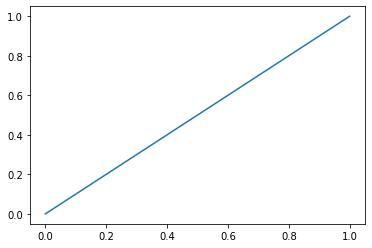

threshold =  0.8


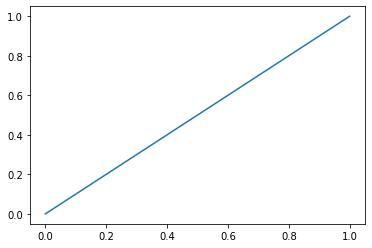

auto threshold


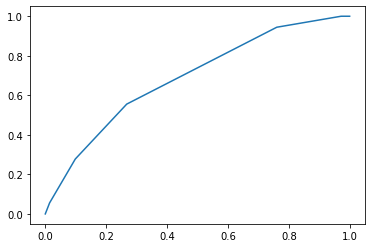

neighbours = 50 err_train = 0.21875 err_test = 0.2247191011235955
[[64  7]
 [13  5]]
Mera F1 Train: 0.33333333333333337
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [154]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[4][i]=err_test
    Knn_train[4][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [155]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[4]= err_test
SVC_train[4]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.0625 err_test_SVC = 0.15730337078651685


# Controlled under-sampling techniques

## RandomUnderSampler

In [156]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=0)
X_resampled, y_resampled = rus.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 32), (1, 32)]


## Knn

threshold =  0.0


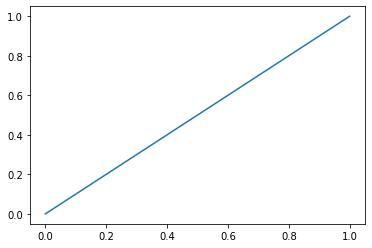

threshold =  0.2


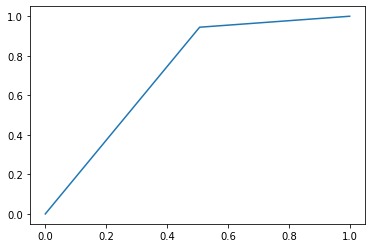

threshold =  0.4


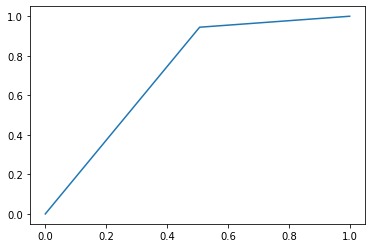

threshold =  0.5


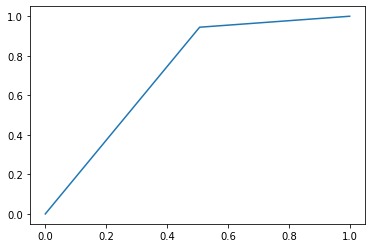

threshold =  0.7


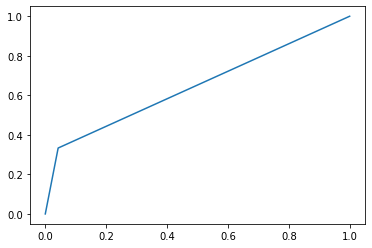

threshold =  0.8


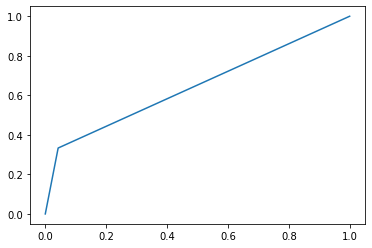

auto threshold


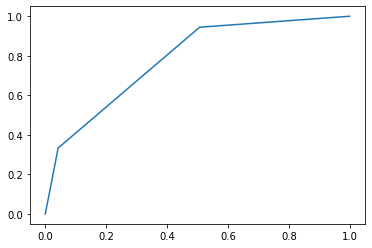

neighbours = 2 err_train = 0.234375 err_test = 0.16853932584269662
[[68  3]
 [12  6]]
Mera F1 Train: 0.4444444444444444
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


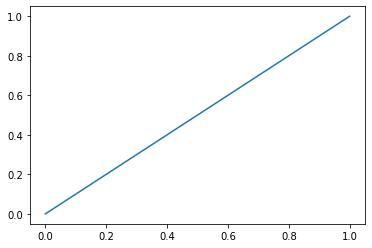

threshold =  0.2


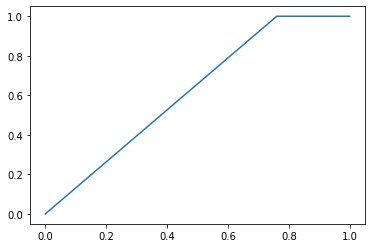

threshold =  0.4


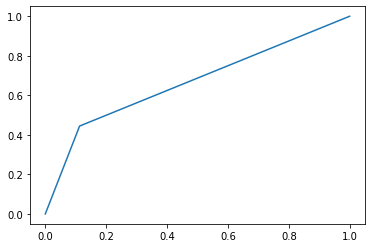

threshold =  0.5


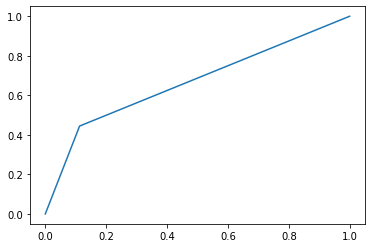

threshold =  0.7


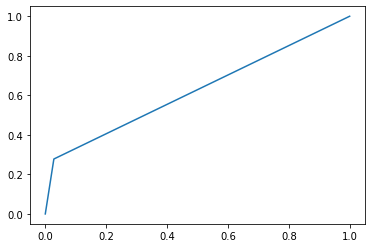

threshold =  0.8


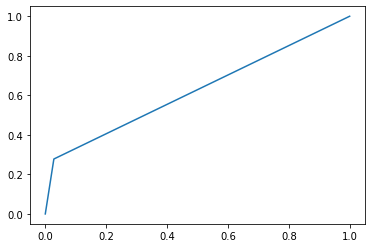

auto threshold


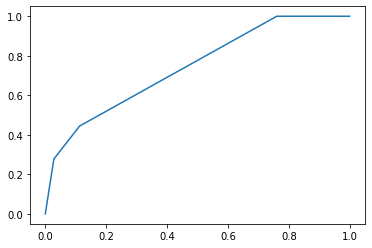

neighbours = 3 err_train = 0.15625 err_test = 0.20224719101123595
[[63  8]
 [10  8]]
Mera F1 Train: 0.47058823529411764
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


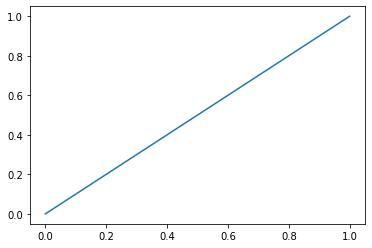

threshold =  0.2


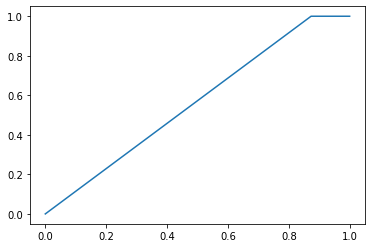

threshold =  0.4


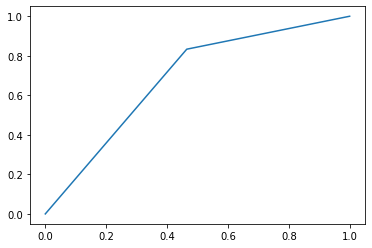

threshold =  0.5


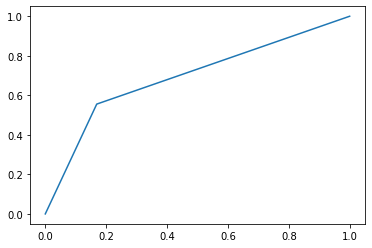

threshold =  0.7


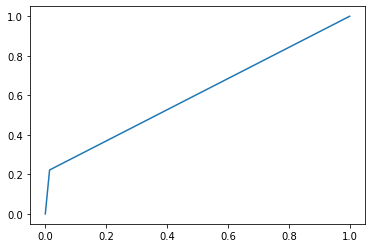

threshold =  0.8


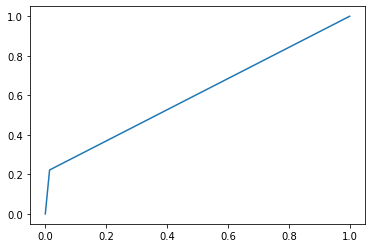

auto threshold


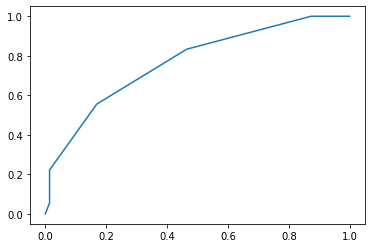

neighbours = 5 err_train = 0.21875 err_test = 0.2247191011235955
[[59 12]
 [ 8 10]]
Mera F1 Train: 0.5
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


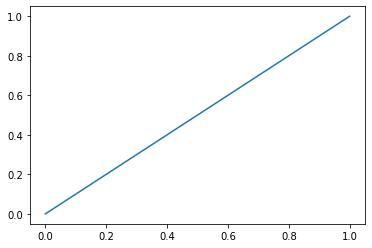

threshold =  0.2


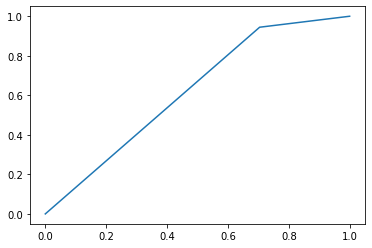

threshold =  0.4


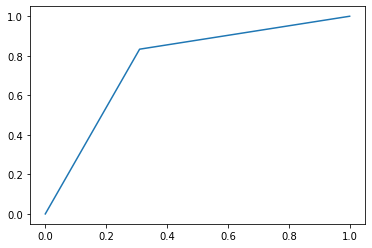

threshold =  0.5


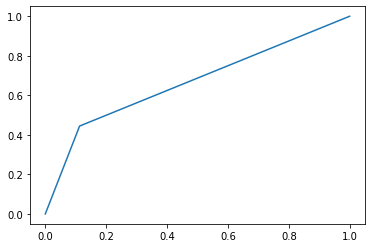

threshold =  0.7


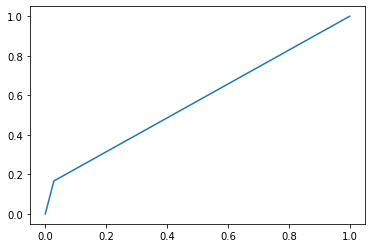

threshold =  0.8


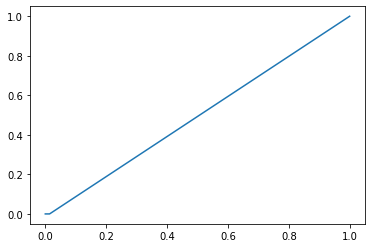

auto threshold


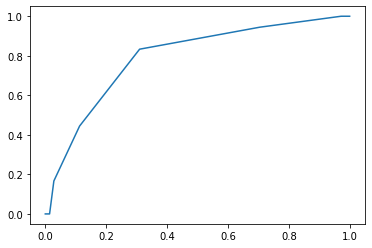

neighbours = 7 err_train = 0.234375 err_test = 0.20224719101123595
[[63  8]
 [10  8]]
Mera F1 Train: 0.47058823529411764
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


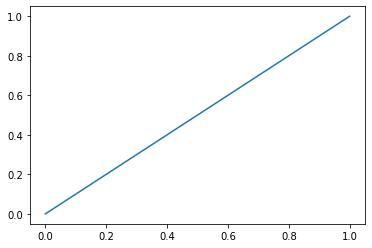

threshold =  0.2


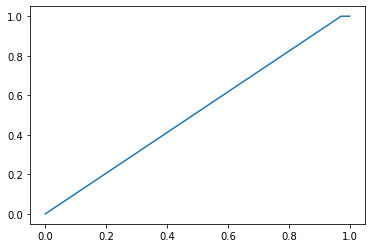

threshold =  0.4


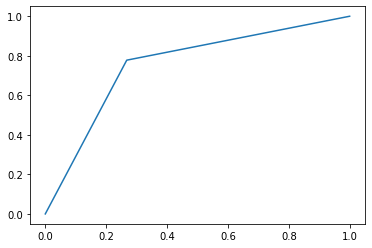

threshold =  0.5


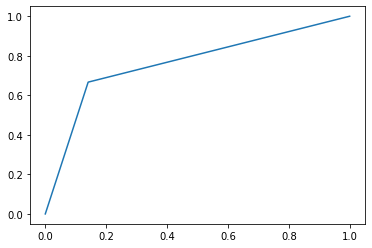

threshold =  0.7


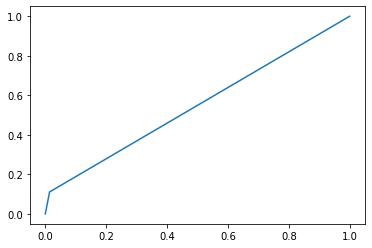

threshold =  0.8


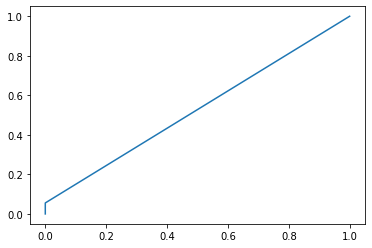

auto threshold


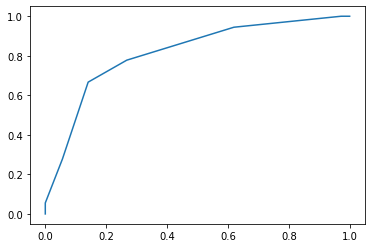

neighbours = 10 err_train = 0.234375 err_test = 0.19101123595505617
[[67  4]
 [13  5]]
Mera F1 Train: 0.3703703703703704
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


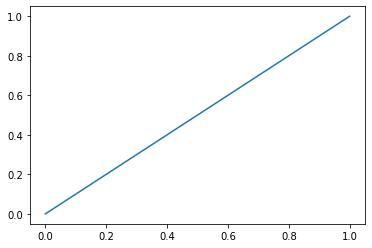

threshold =  0.2


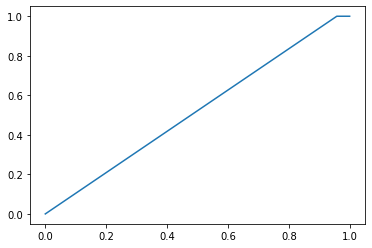

threshold =  0.4


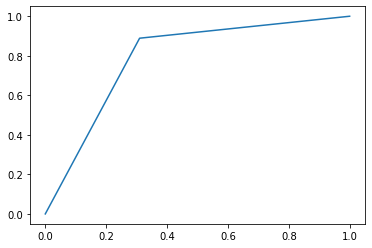

threshold =  0.5


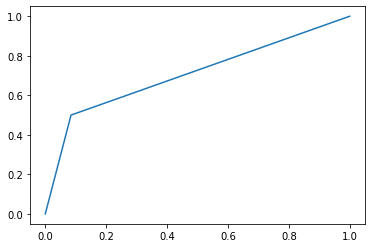

threshold =  0.7


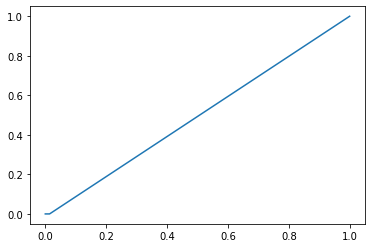

threshold =  0.8


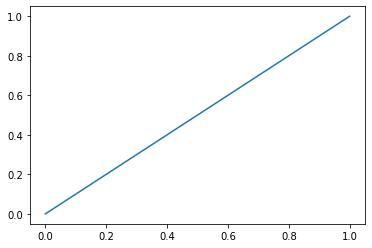

auto threshold


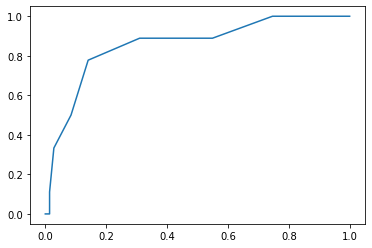

neighbours = 15 err_train = 0.21875 err_test = 0.16853932584269662
[[65  6]
 [ 9  9]]
Mera F1 Train: 0.5454545454545454
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


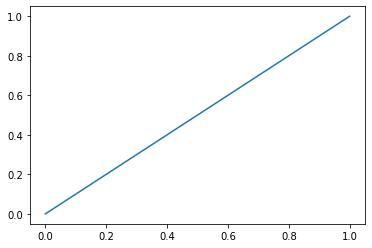

threshold =  0.2


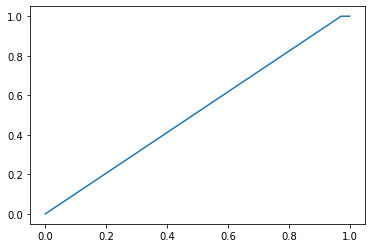

threshold =  0.4


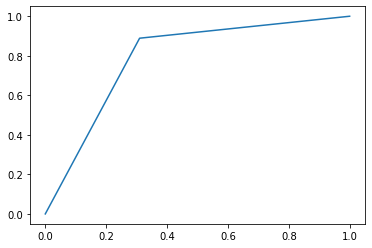

threshold =  0.5


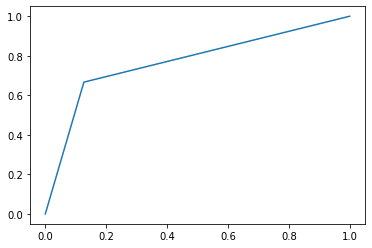

threshold =  0.7


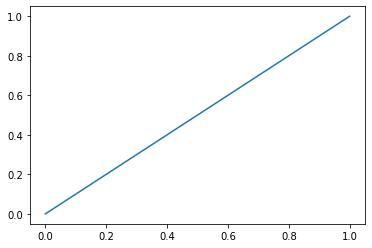

threshold =  0.8


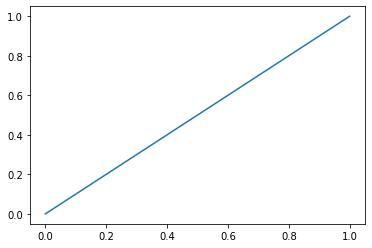

auto threshold


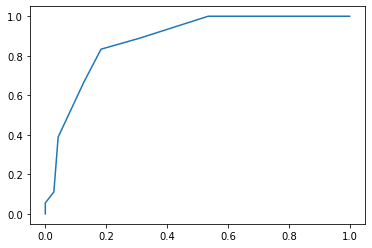

neighbours = 20 err_train = 0.21875 err_test = 0.15730337078651685
[[68  3]
 [11  7]]
Mera F1 Train: 0.5
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


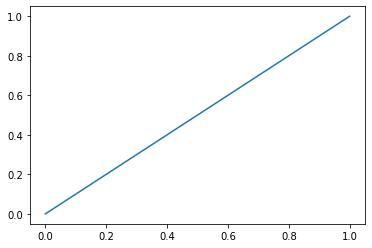

threshold =  0.2


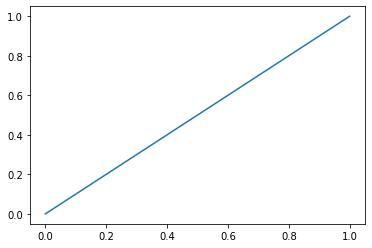

threshold =  0.4


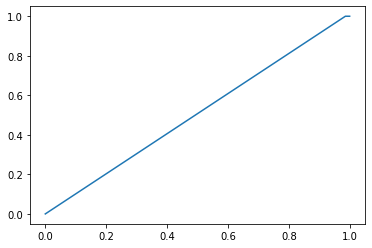

threshold =  0.5


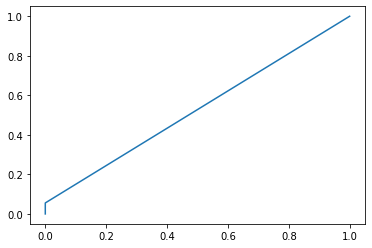

threshold =  0.7


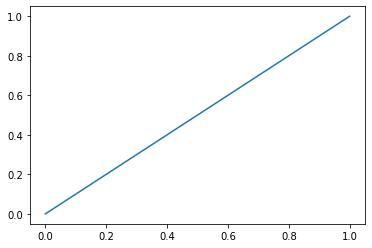

threshold =  0.8


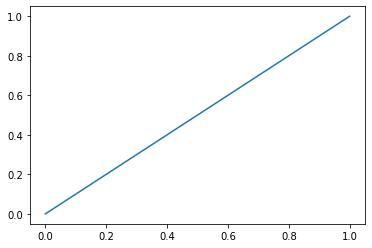

auto threshold


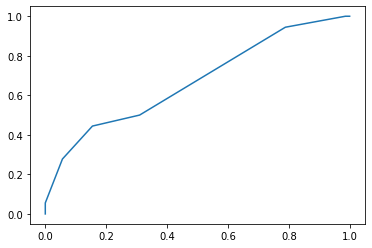

neighbours = 50 err_train = 0.40625 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [157]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[5][i]=err_test
    Knn_train[5][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

Быстрый и простой способ сбалансировать данные путем случайного выбора подмножества данных для целевых классов

## Support Vector Classifier

In [158]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[5]= err_test
SVC_train[5]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.125 err_test_SVC = 0.0898876404494382


## NearMiss

In [159]:
from imblearn.under_sampling import NearMiss
nm1 = NearMiss(version=1)
X_resampled_nm1, y_resampled = nm1.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 32), (1, 32)]


## Knn

threshold =  0.0


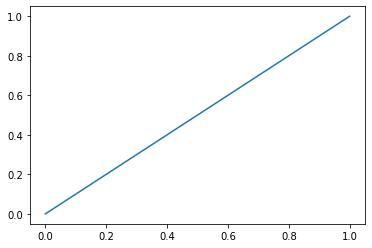

threshold =  0.2


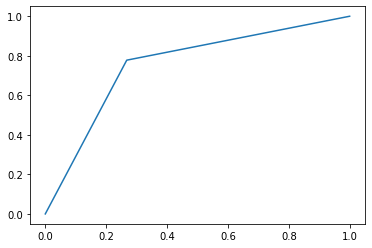

threshold =  0.4


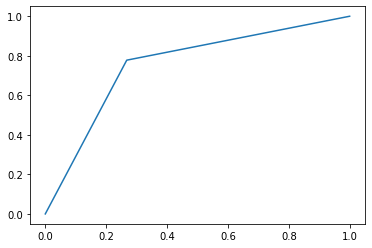

threshold =  0.5


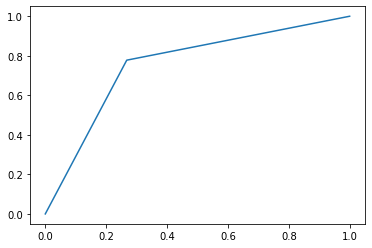

threshold =  0.7


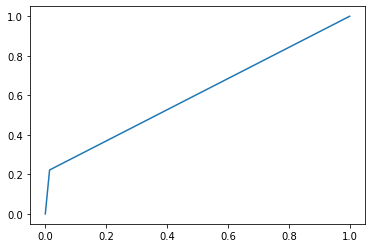

threshold =  0.8


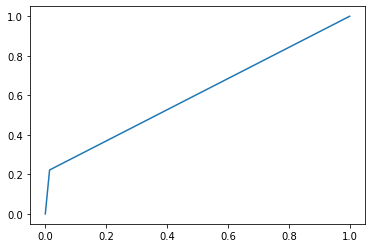

auto threshold


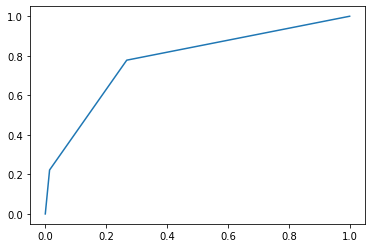

neighbours = 2 err_train = 0.296875 err_test = 0.16853932584269662
[[70  1]
 [14  4]]
Mera F1 Train: 0.3478260869565218
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


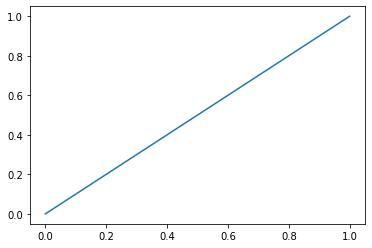

threshold =  0.2


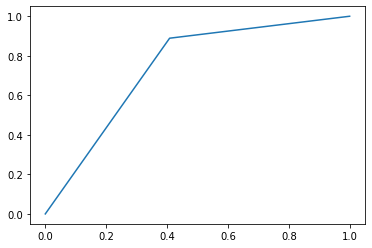

threshold =  0.4


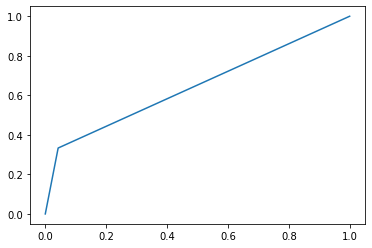

threshold =  0.5


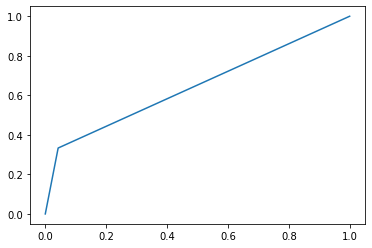

threshold =  0.7


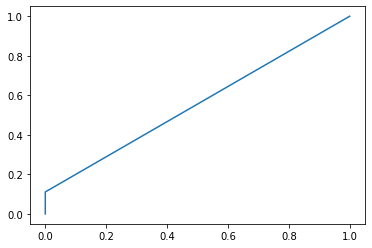

threshold =  0.8


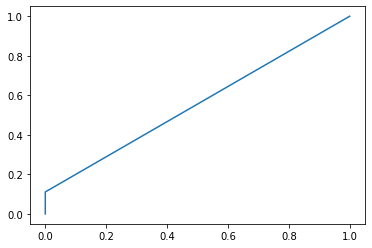

auto threshold


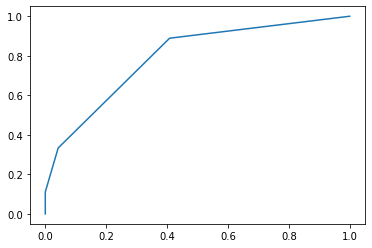

neighbours = 3 err_train = 0.171875 err_test = 0.16853932584269662
[[68  3]
 [12  6]]
Mera F1 Train: 0.4444444444444444
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


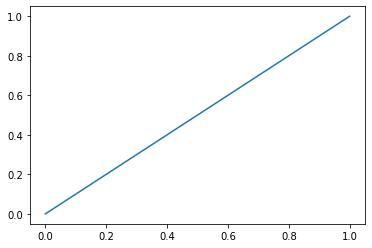

threshold =  0.2


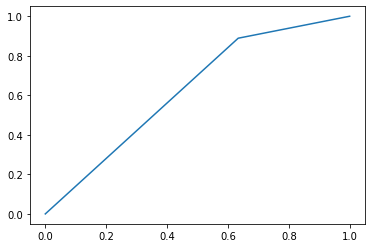

threshold =  0.4


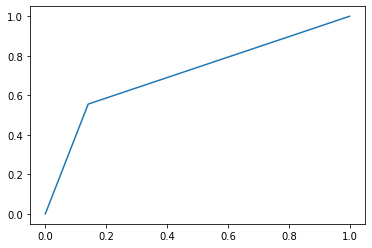

threshold =  0.5


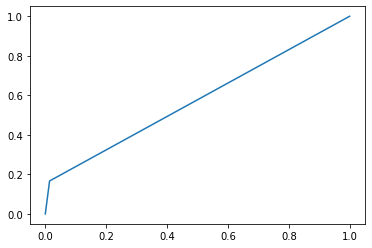

threshold =  0.7


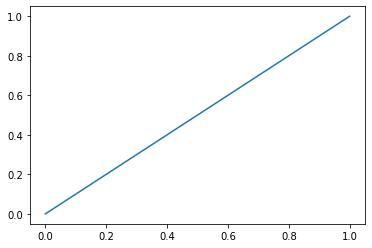

threshold =  0.8


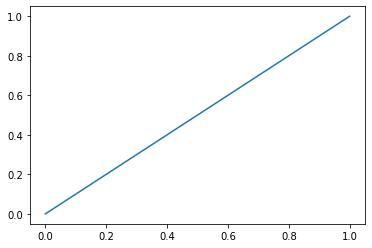

auto threshold


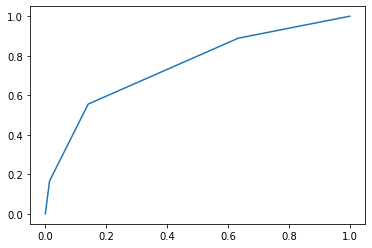

neighbours = 5 err_train = 0.265625 err_test = 0.1797752808988764
[[70  1]
 [15  3]]
Mera F1 Train: 0.27272727272727276
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


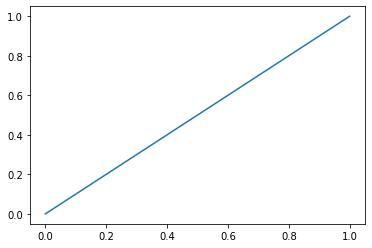

threshold =  0.2


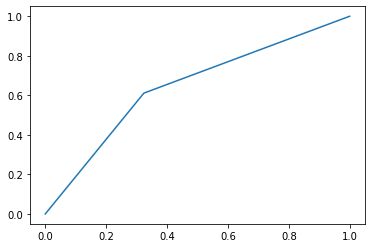

threshold =  0.4


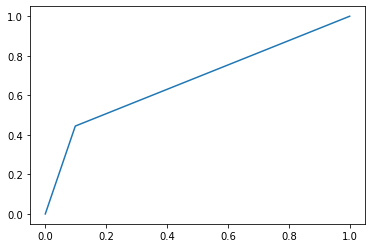

threshold =  0.5


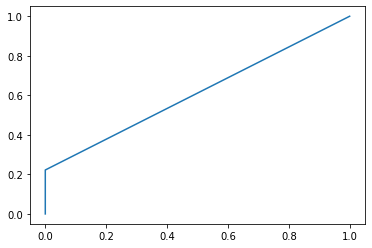

threshold =  0.7


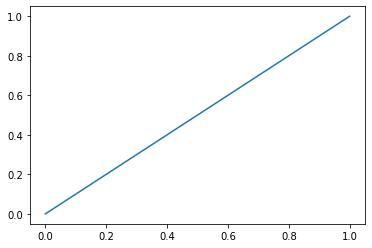

threshold =  0.8


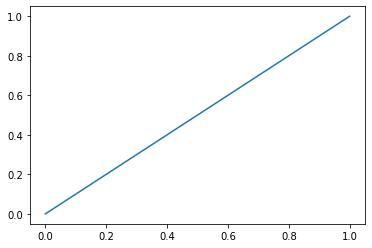

auto threshold


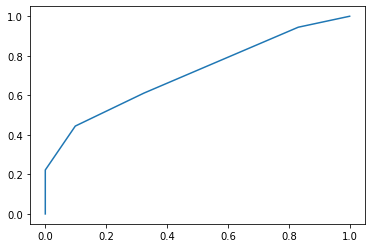

neighbours = 7 err_train = 0.296875 err_test = 0.15730337078651685
[[71  0]
 [14  4]]
Mera F1 Train: 0.3636363636363636
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


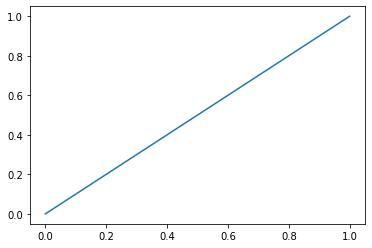

threshold =  0.2


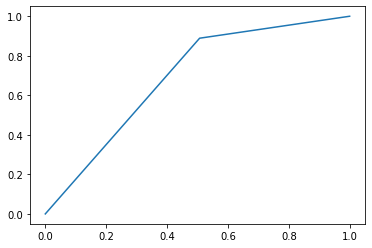

threshold =  0.4


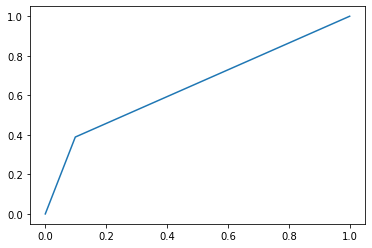

threshold =  0.5


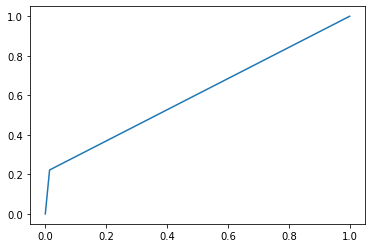

threshold =  0.7


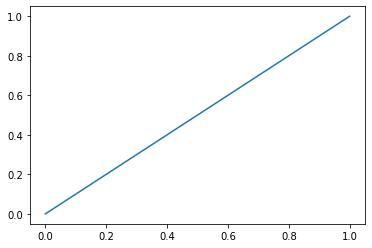

threshold =  0.8


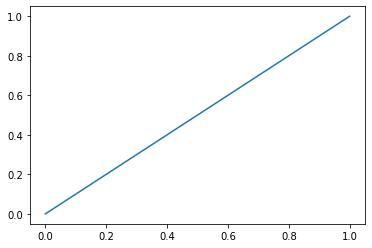

auto threshold


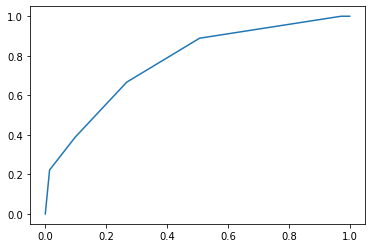

neighbours = 10 err_train = 0.390625 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


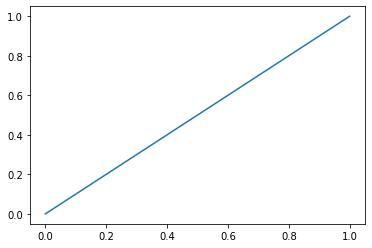

threshold =  0.2


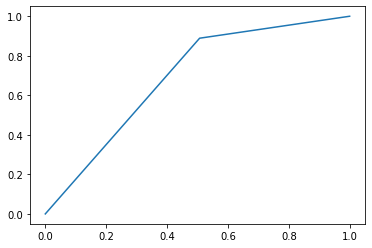

threshold =  0.4


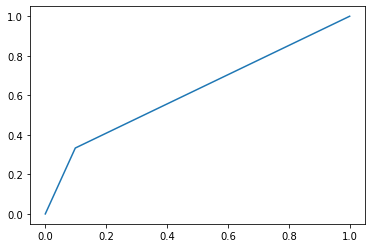

threshold =  0.5


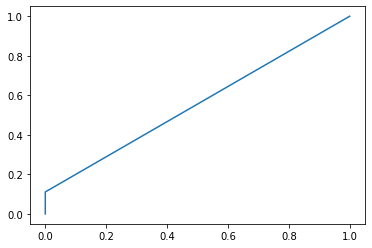

threshold =  0.7


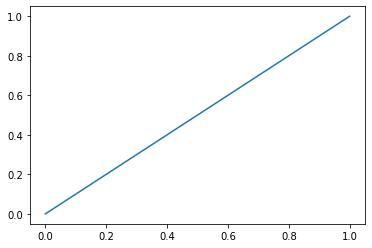

threshold =  0.8


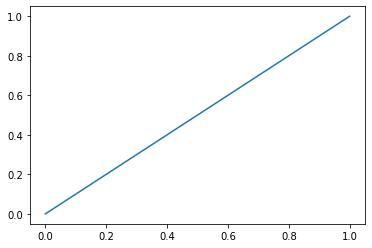

auto threshold


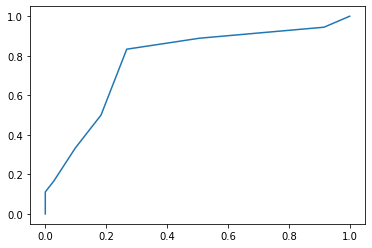

neighbours = 15 err_train = 0.375 err_test = 0.1797752808988764
[[71  0]
 [16  2]]
Mera F1 Train: 0.19999999999999998
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


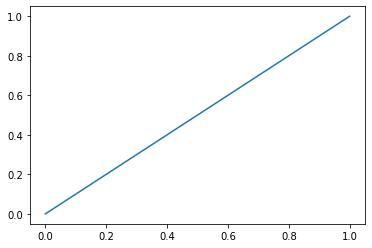

threshold =  0.2


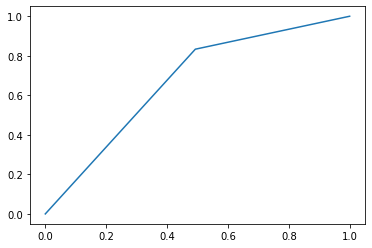

threshold =  0.4


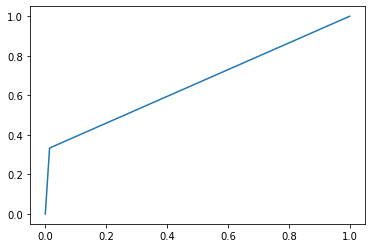

threshold =  0.5


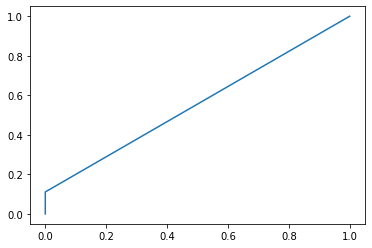

threshold =  0.7


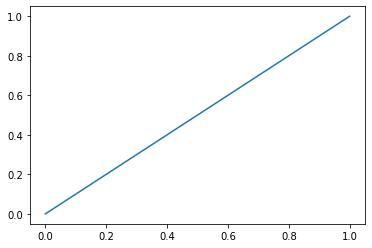

threshold =  0.8


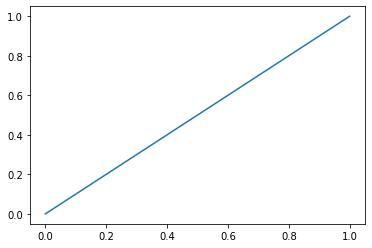

auto threshold


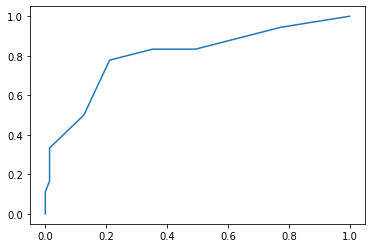

neighbours = 20 err_train = 0.4375 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


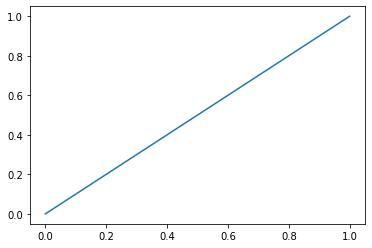

threshold =  0.2


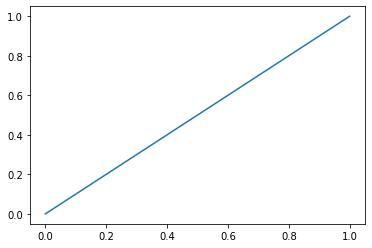

threshold =  0.4


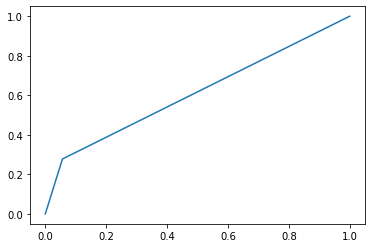

threshold =  0.5


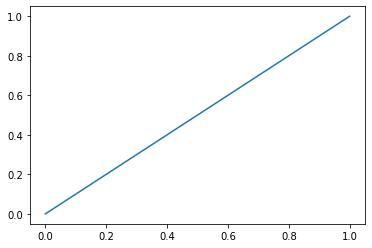

threshold =  0.7


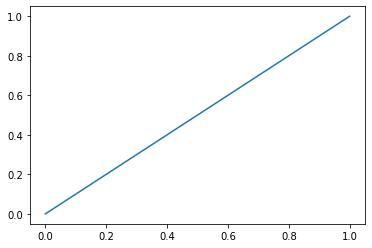

threshold =  0.8


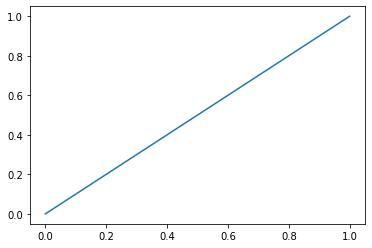

auto threshold


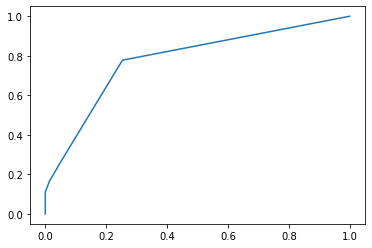

neighbours = 50 err_train = 0.5 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [160]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled_nm1, y_resampled)
    y_train_predict = knn.predict(X_resampled_nm1)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[6][i]=err_test
    Knn_train[6][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [161]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled_nm1, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled_nm1))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[6]= err_test
SVC_train[6]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.171875 err_test_SVC = 0.12359550561797752


# Edited data set using nearest neighbours

## EditedNearestNeighbours

In [162]:
from imblearn.under_sampling import EditedNearestNeighbours
enn = EditedNearestNeighbours()
X_resampled, y_resampled = enn.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 135), (1, 32)]


## Knn

threshold =  0.0


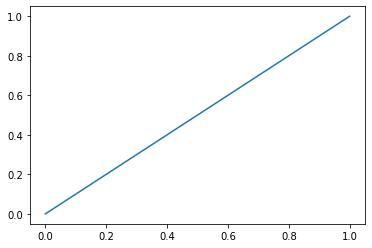

threshold =  0.2


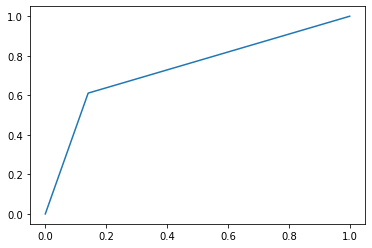

threshold =  0.4


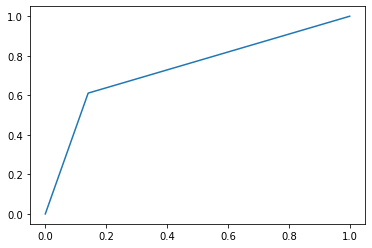

threshold =  0.5


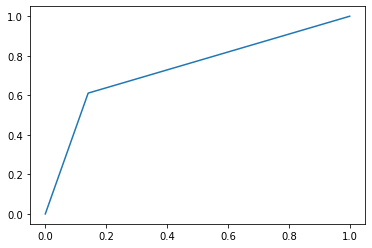

threshold =  0.7


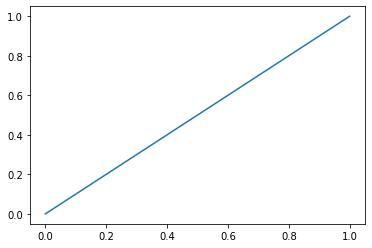

threshold =  0.8


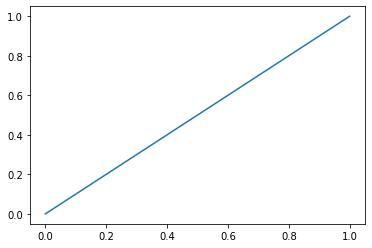

auto threshold


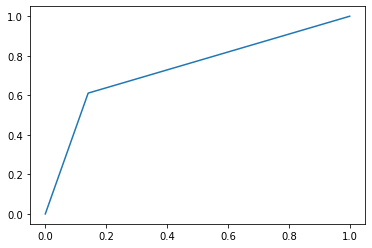

neighbours = 2 err_train = 0.09580838323353294 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


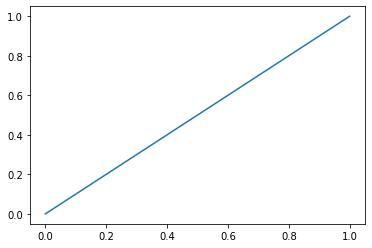

threshold =  0.2


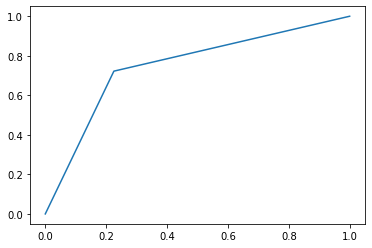

threshold =  0.4


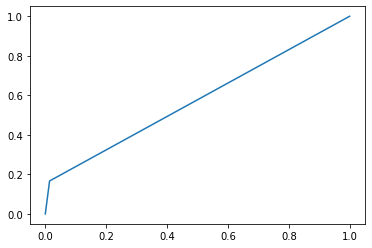

threshold =  0.5


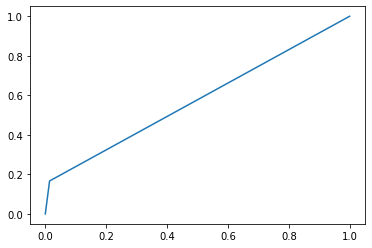

threshold =  0.7


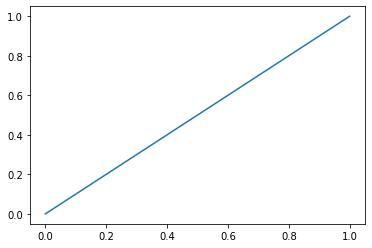

threshold =  0.8


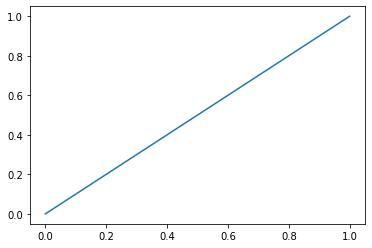

auto threshold


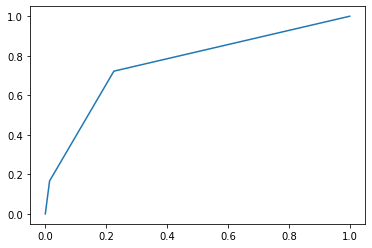

neighbours = 3 err_train = 0.0658682634730539 err_test = 0.1797752808988764
[[70  1]
 [15  3]]
Mera F1 Train: 0.27272727272727276
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


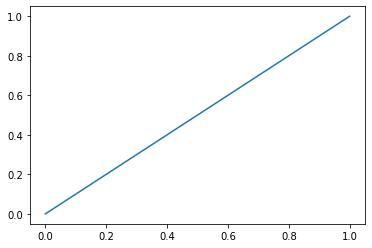

threshold =  0.2


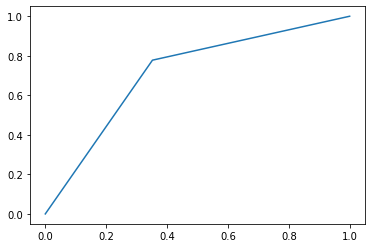

threshold =  0.4


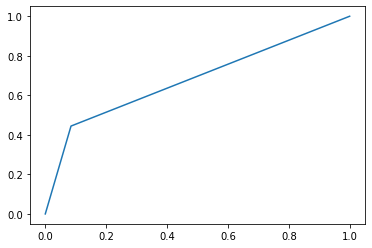

threshold =  0.5


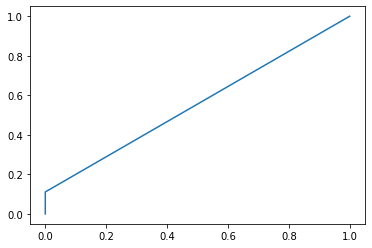

threshold =  0.7


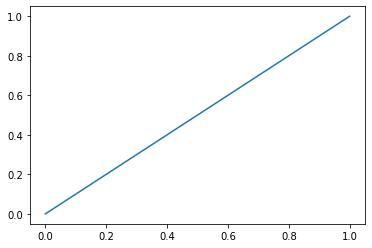

threshold =  0.8


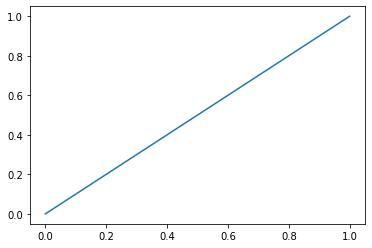

auto threshold


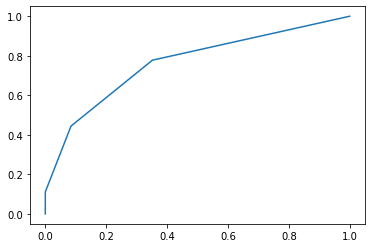

neighbours = 5 err_train = 0.11377245508982035 err_test = 0.1797752808988764
[[71  0]
 [16  2]]
Mera F1 Train: 0.19999999999999998
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


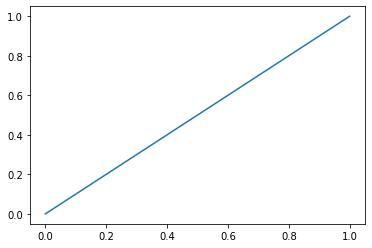

threshold =  0.2


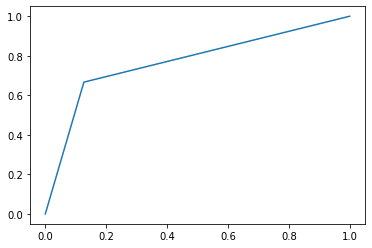

threshold =  0.4


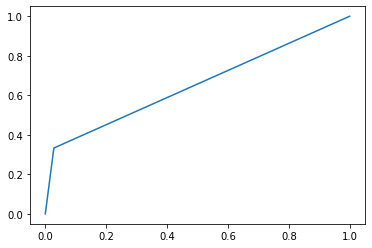

threshold =  0.5


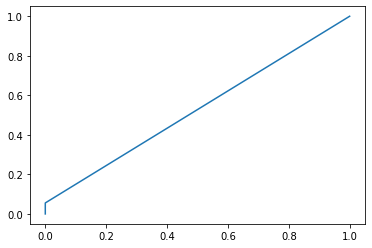

threshold =  0.7


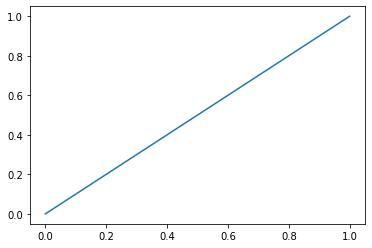

threshold =  0.8


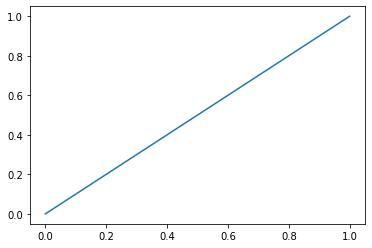

auto threshold


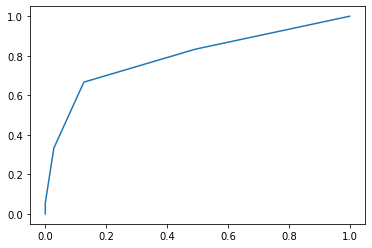

neighbours = 7 err_train = 0.1437125748502994 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


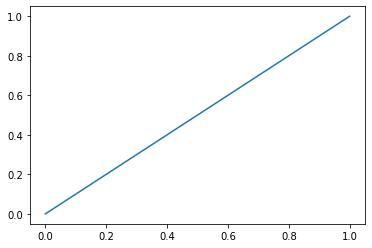

threshold =  0.2


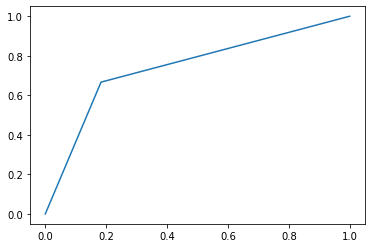

threshold =  0.4


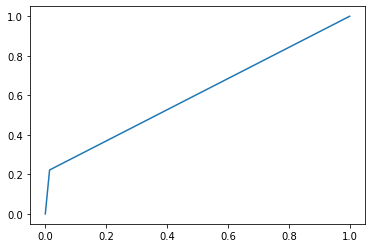

threshold =  0.5


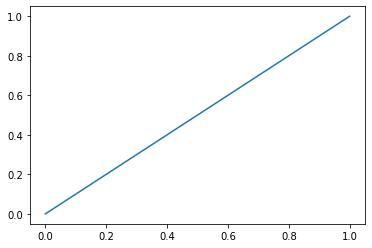

threshold =  0.7


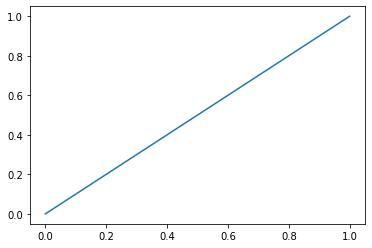

threshold =  0.8


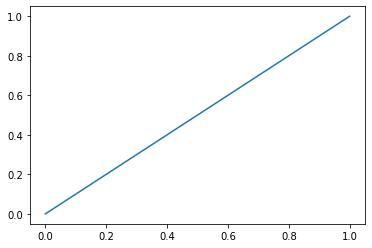

auto threshold


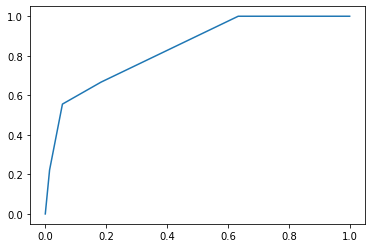

neighbours = 10 err_train = 0.16167664670658682 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


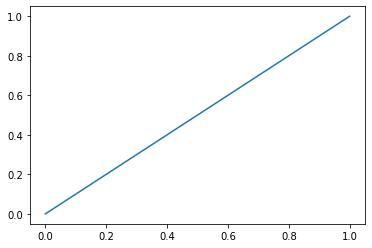

threshold =  0.2


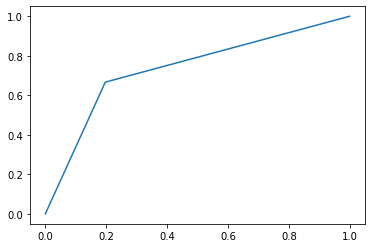

threshold =  0.4


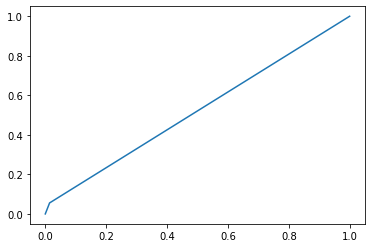

threshold =  0.5


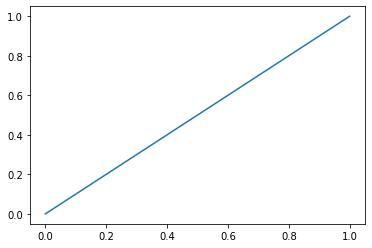

threshold =  0.7


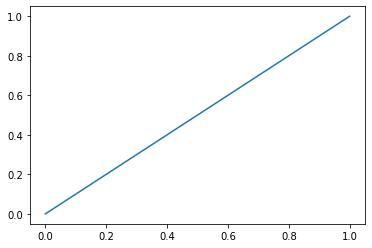

threshold =  0.8


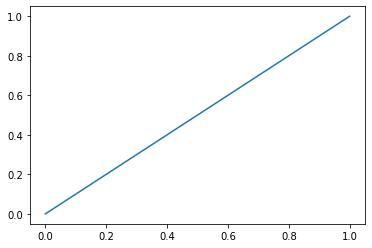

auto threshold


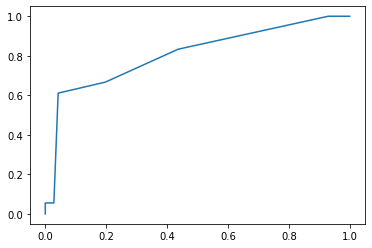

neighbours = 15 err_train = 0.16167664670658682 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


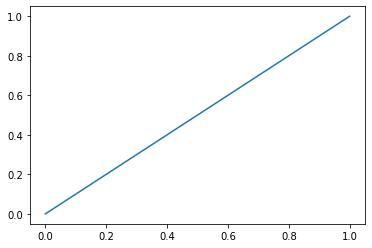

threshold =  0.2


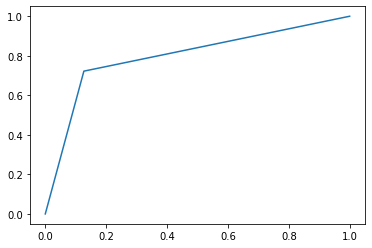

threshold =  0.4


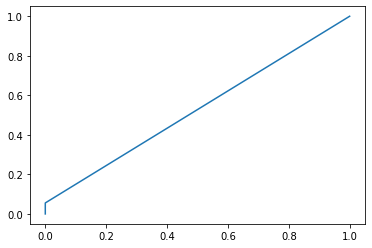

threshold =  0.5


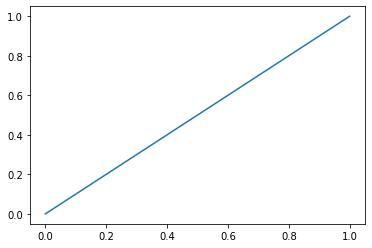

threshold =  0.7


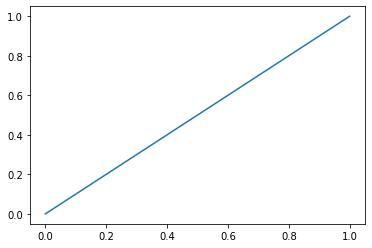

threshold =  0.8


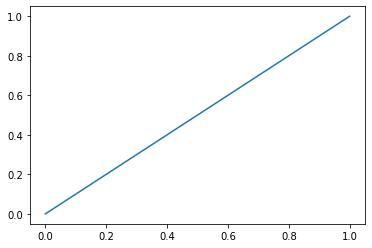

auto threshold


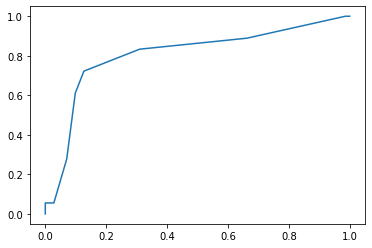

neighbours = 20 err_train = 0.17964071856287425 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


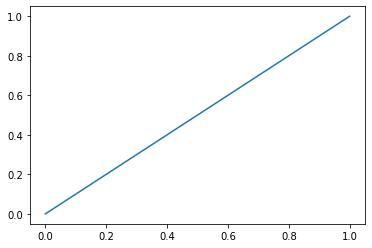

threshold =  0.2


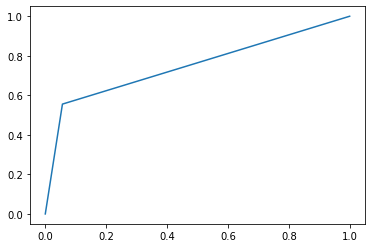

threshold =  0.4


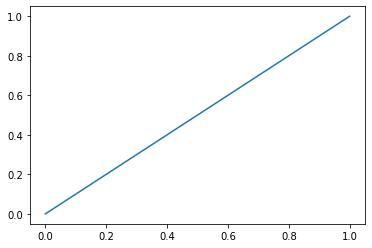

threshold =  0.5


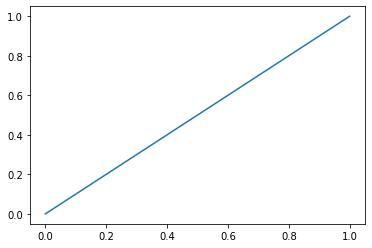

threshold =  0.7


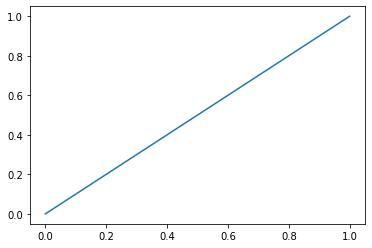

threshold =  0.8


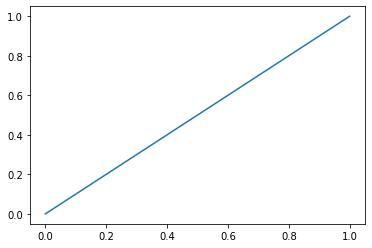

auto threshold


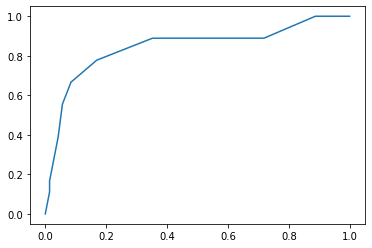

neighbours = 50 err_train = 0.19161676646706588 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [163]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[7][i]=err_test
    Knn_train[7][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [164]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[7]= err_test
SVC_train[7]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.1497005988023952 err_test_SVC = 0.1797752808988764


## RepeatedEditedNearestNeighbours

In [165]:
from imblearn.under_sampling import RepeatedEditedNearestNeighbours
renn = RepeatedEditedNearestNeighbours()
X_resampled, y_resampled = renn.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 121), (1, 32)]


## Knn

threshold =  0.0


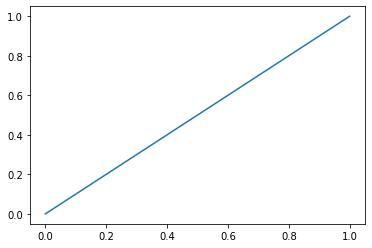

threshold =  0.2


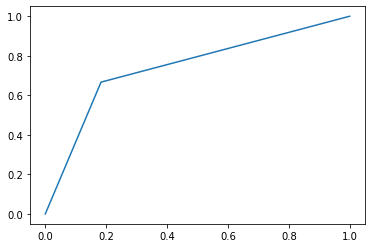

threshold =  0.4


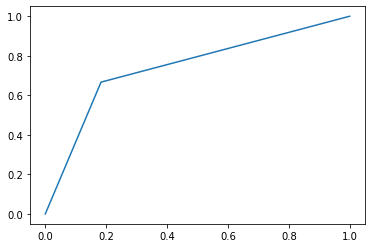

threshold =  0.5


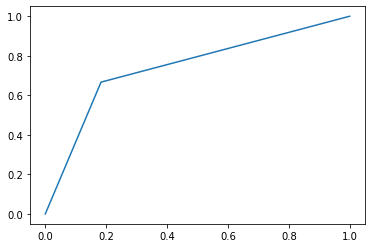

threshold =  0.7


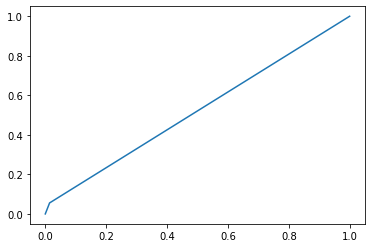

threshold =  0.8


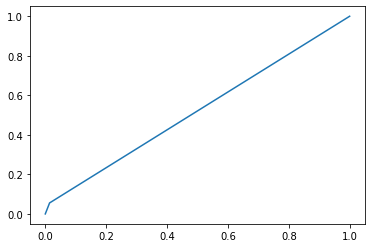

auto threshold


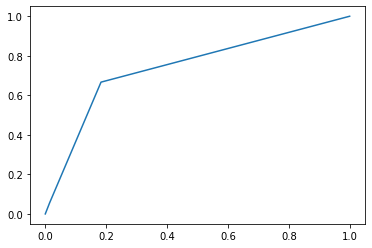

neighbours = 2 err_train = 0.10457516339869281 err_test = 0.20224719101123595
[[70  1]
 [17  1]]
Mera F1 Train: 0.09999999999999999
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


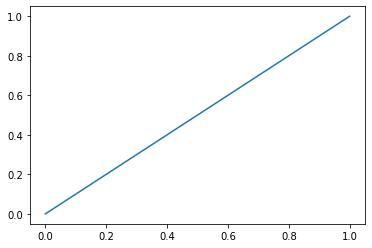

threshold =  0.2


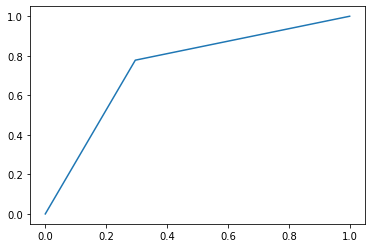

threshold =  0.4


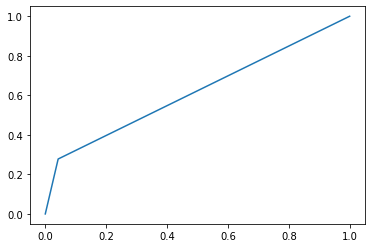

threshold =  0.5


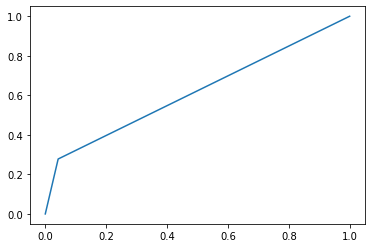

threshold =  0.7


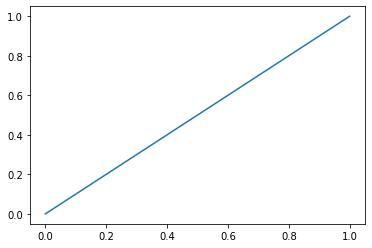

threshold =  0.8


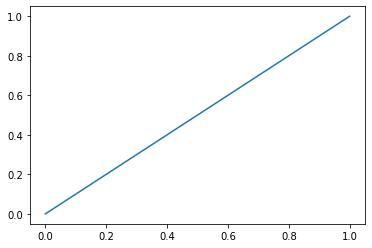

auto threshold


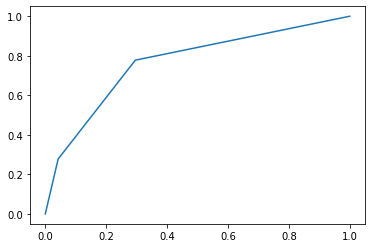

neighbours = 3 err_train = 0.058823529411764705 err_test = 0.1797752808988764
[[68  3]
 [13  5]]
Mera F1 Train: 0.3846153846153846
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


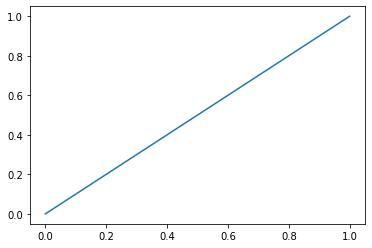

threshold =  0.2


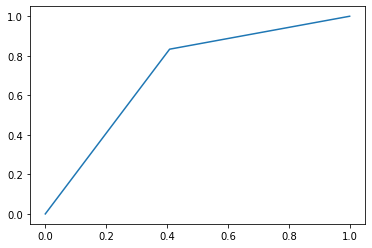

threshold =  0.4


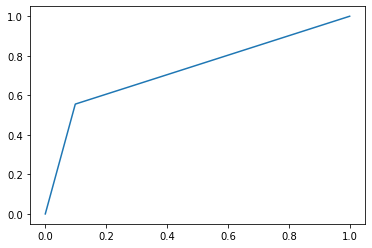

threshold =  0.5


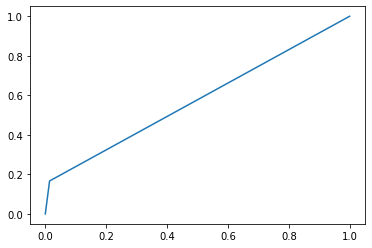

threshold =  0.7


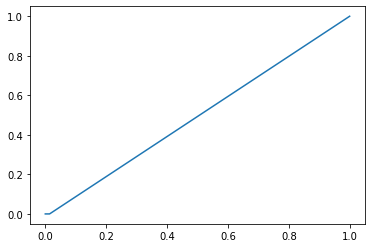

threshold =  0.8


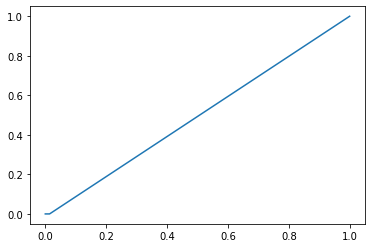

auto threshold


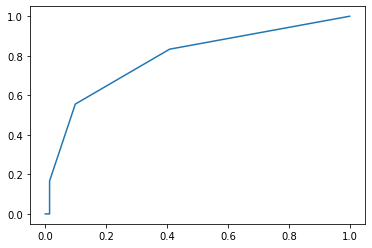

neighbours = 5 err_train = 0.1111111111111111 err_test = 0.1797752808988764
[[70  1]
 [15  3]]
Mera F1 Train: 0.27272727272727276
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


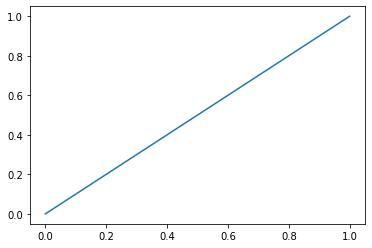

threshold =  0.2


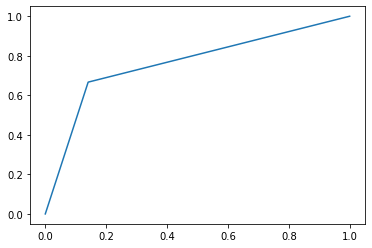

threshold =  0.4


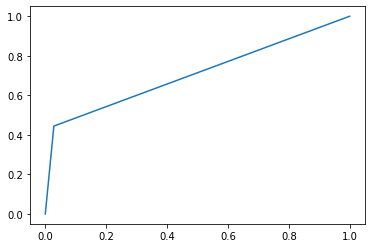

threshold =  0.5


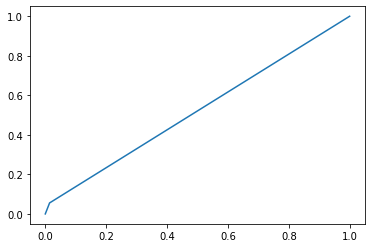

threshold =  0.7


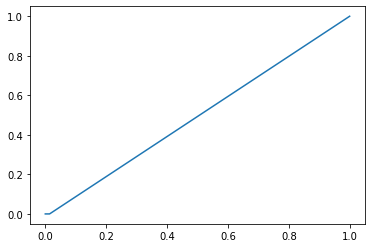

threshold =  0.8


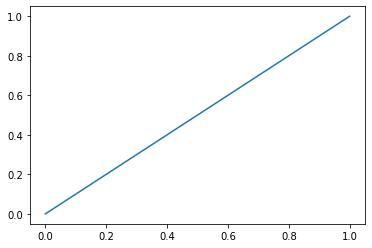

auto threshold


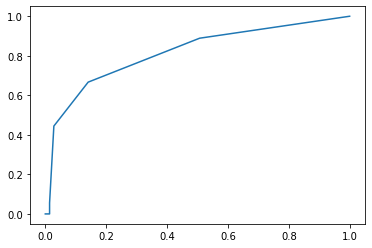

neighbours = 7 err_train = 0.13725490196078433 err_test = 0.20224719101123595
[[70  1]
 [17  1]]
Mera F1 Train: 0.09999999999999999
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


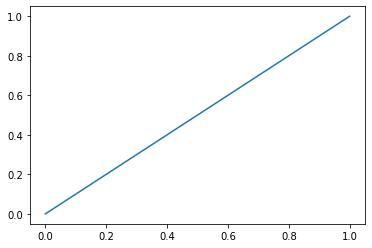

threshold =  0.2


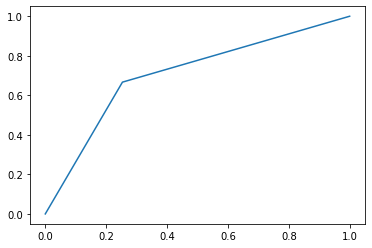

threshold =  0.4


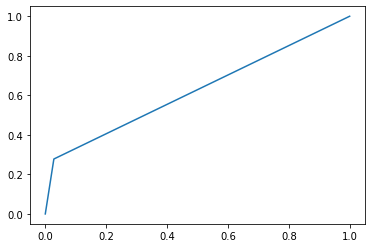

threshold =  0.5


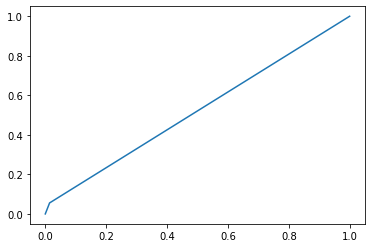

threshold =  0.7


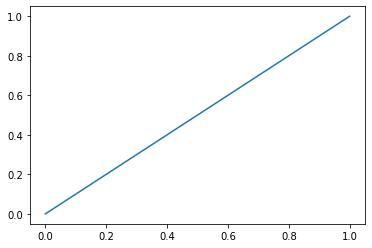

threshold =  0.8


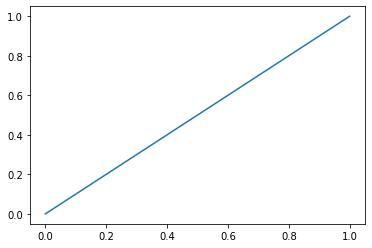

auto threshold


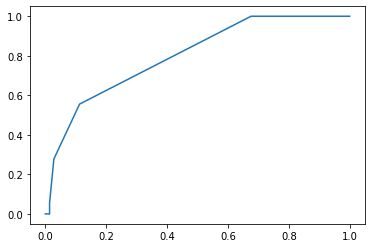

neighbours = 10 err_train = 0.17647058823529413 err_test = 0.21348314606741572
[[70  1]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.7865168539325843
Recall Score Train:  0.7865168539325843
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


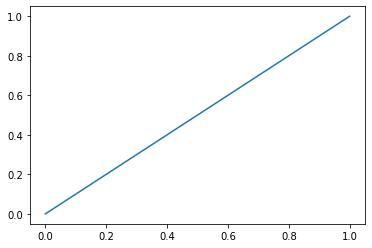

threshold =  0.2


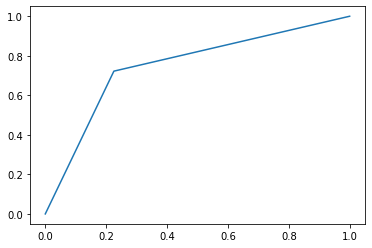

threshold =  0.4


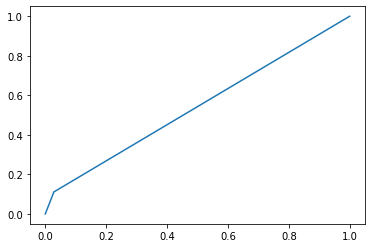

threshold =  0.5


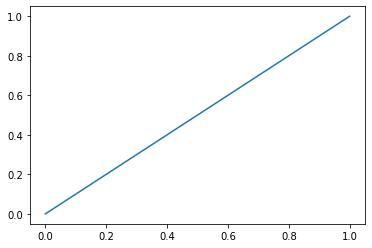

threshold =  0.7


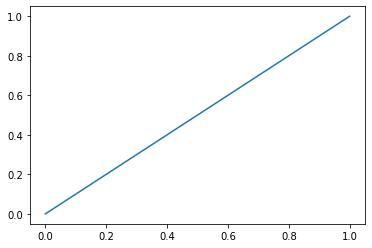

threshold =  0.8


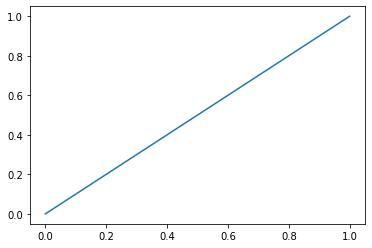

auto threshold


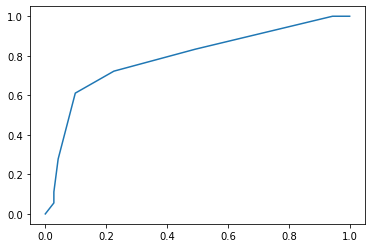

neighbours = 15 err_train = 0.17647058823529413 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


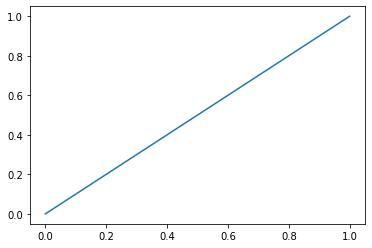

threshold =  0.2


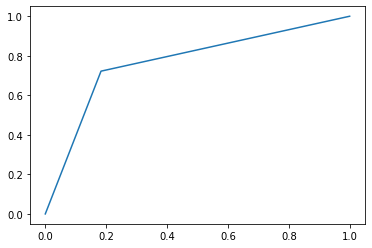

threshold =  0.4


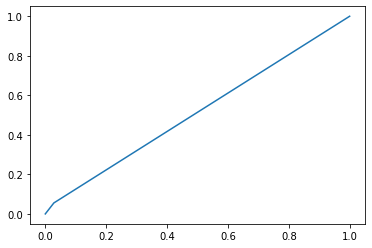

threshold =  0.5


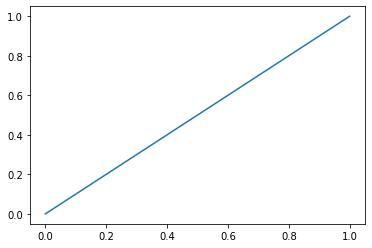

threshold =  0.7


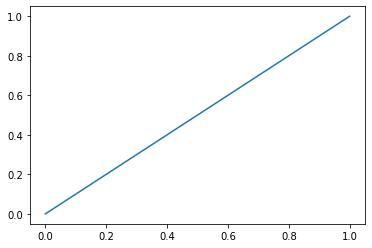

threshold =  0.8


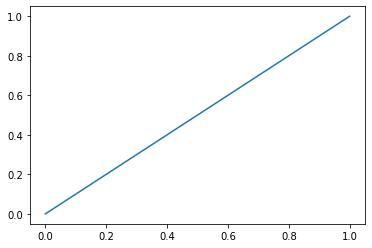

auto threshold


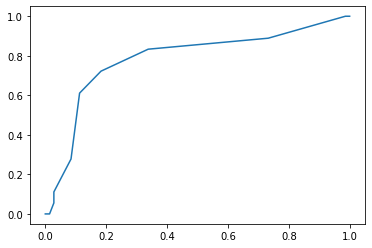

neighbours = 20 err_train = 0.19607843137254902 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


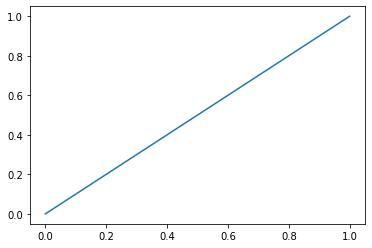

threshold =  0.2


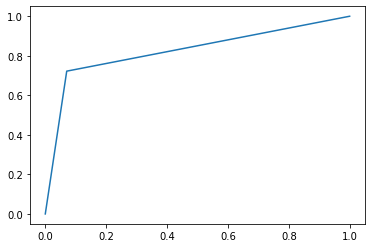

threshold =  0.4


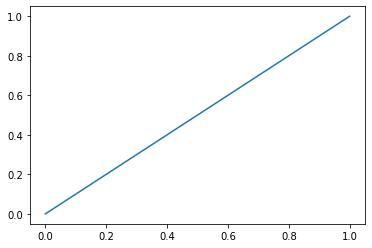

threshold =  0.5


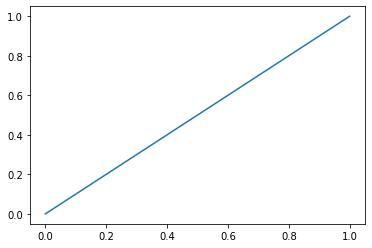

threshold =  0.7


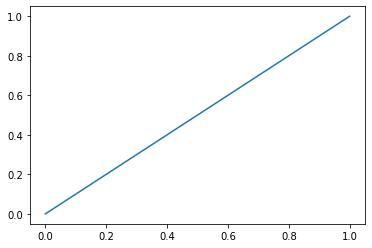

threshold =  0.8


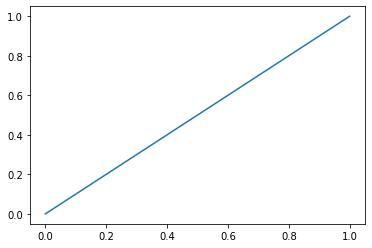

auto threshold


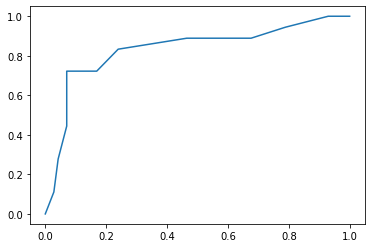

neighbours = 50 err_train = 0.20915032679738563 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [166]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[8][i]=err_test
    Knn_train[8][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [167]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[8]= err_test
SVC_train[8]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.1437908496732026 err_test_SVC = 0.19101123595505617


## AllKNN

In [168]:
from imblearn.under_sampling import AllKNN
allknn = AllKNN()
X_resampled, y_resampled = allknn.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 130), (1, 32)]


## Knn

threshold =  0.0


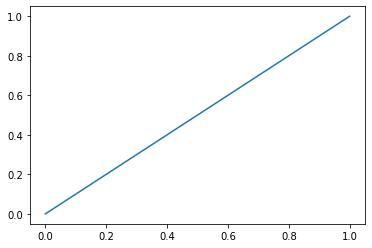

threshold =  0.2


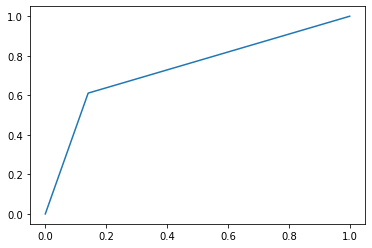

threshold =  0.4


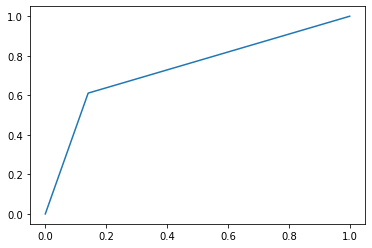

threshold =  0.5


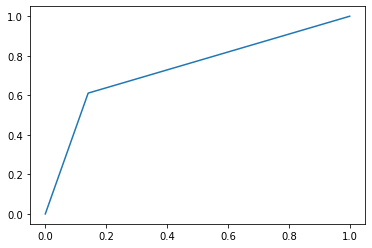

threshold =  0.7


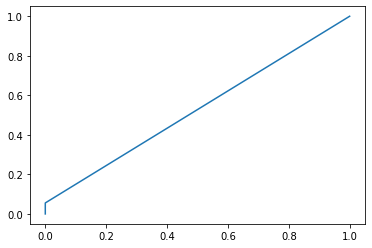

threshold =  0.8


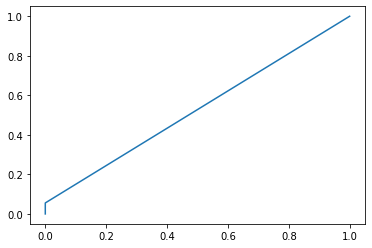

auto threshold


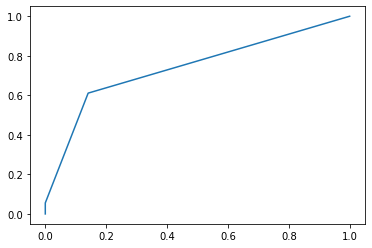

neighbours = 2 err_train = 0.09876543209876543 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


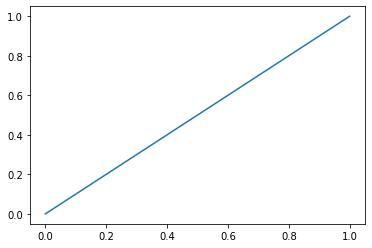

threshold =  0.2


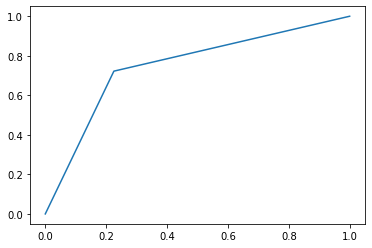

threshold =  0.4


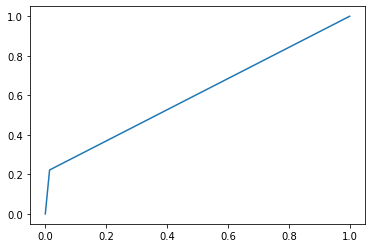

threshold =  0.5


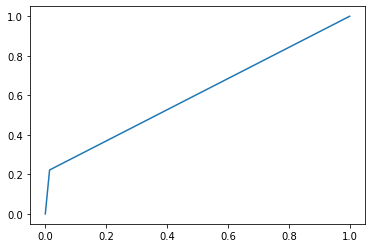

threshold =  0.7


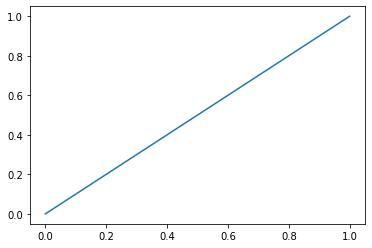

threshold =  0.8


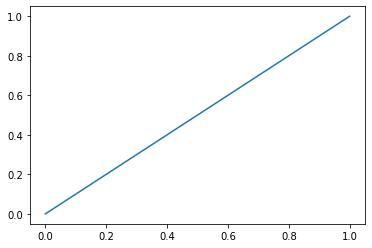

auto threshold


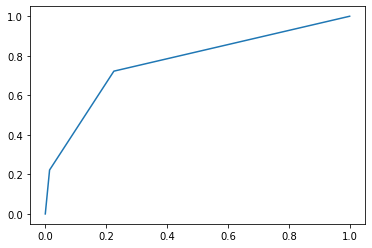

neighbours = 3 err_train = 0.06172839506172839 err_test = 0.16853932584269662
[[70  1]
 [14  4]]
Mera F1 Train: 0.3478260869565218
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


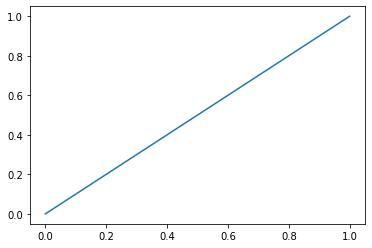

threshold =  0.2


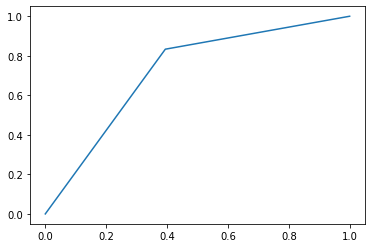

threshold =  0.4


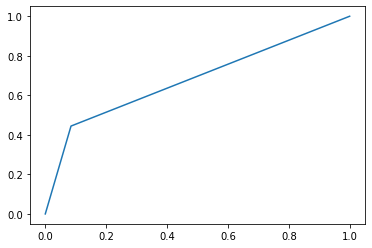

threshold =  0.5


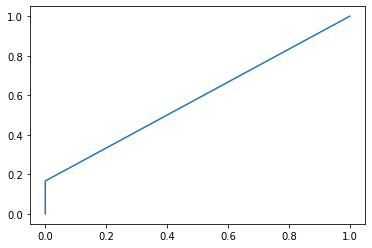

threshold =  0.7


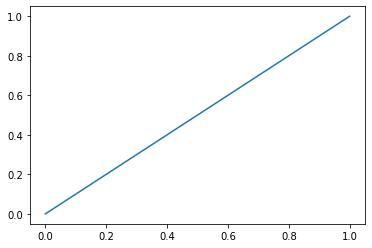

threshold =  0.8


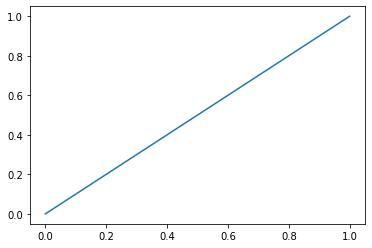

auto threshold


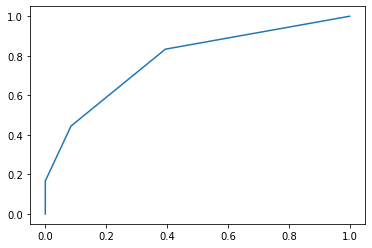

neighbours = 5 err_train = 0.11728395061728394 err_test = 0.16853932584269662
[[71  0]
 [15  3]]
Mera F1 Train: 0.2857142857142857
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


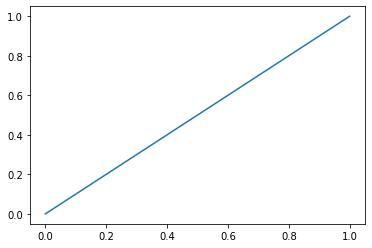

threshold =  0.2


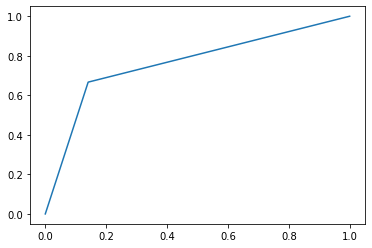

threshold =  0.4


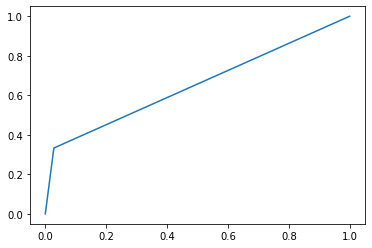

threshold =  0.5


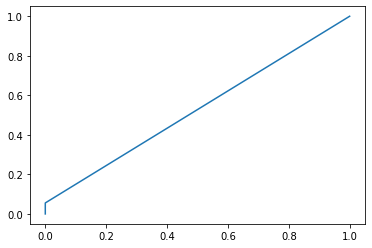

threshold =  0.7


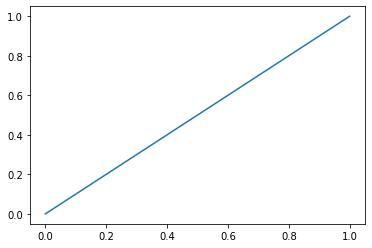

threshold =  0.8


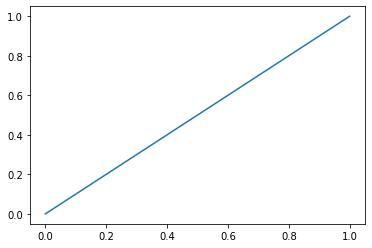

auto threshold


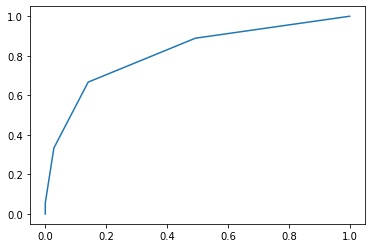

neighbours = 7 err_train = 0.1419753086419753 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


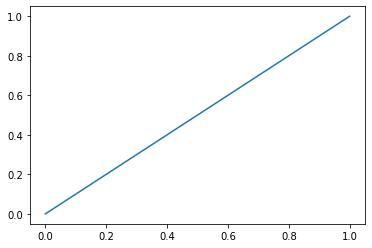

threshold =  0.2


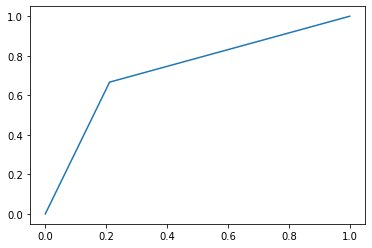

threshold =  0.4


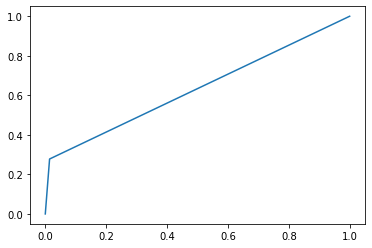

threshold =  0.5


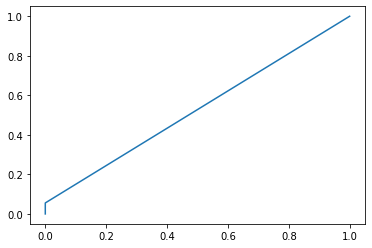

threshold =  0.7


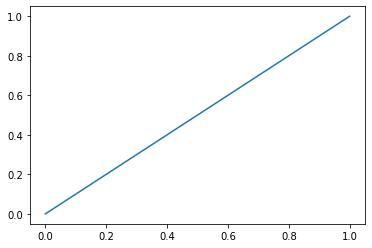

threshold =  0.8


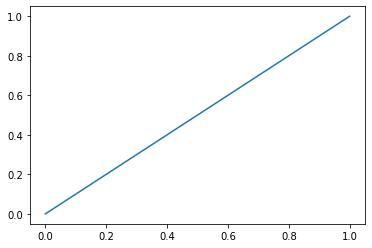

auto threshold


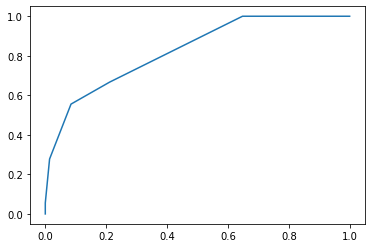

neighbours = 10 err_train = 0.16666666666666666 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


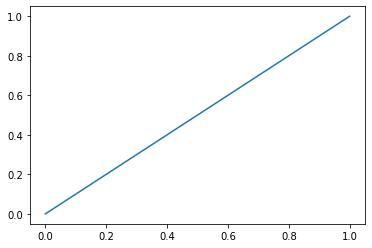

threshold =  0.2


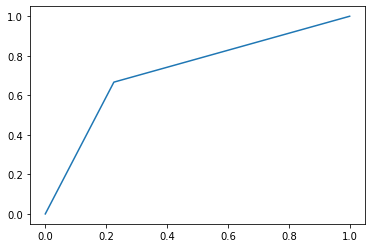

threshold =  0.4


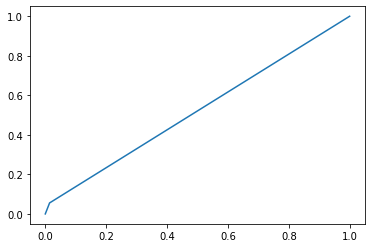

threshold =  0.5


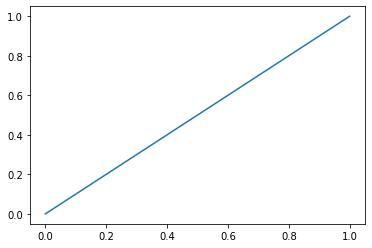

threshold =  0.7


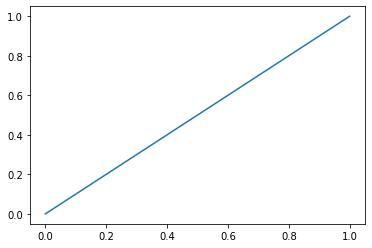

threshold =  0.8


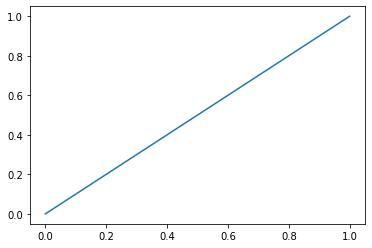

auto threshold


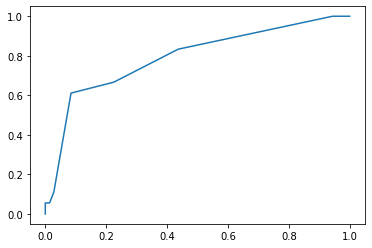

neighbours = 15 err_train = 0.16666666666666666 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


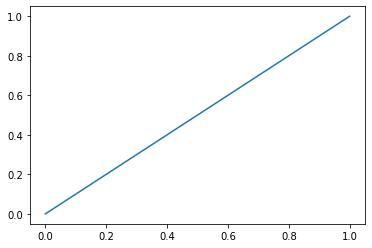

threshold =  0.2


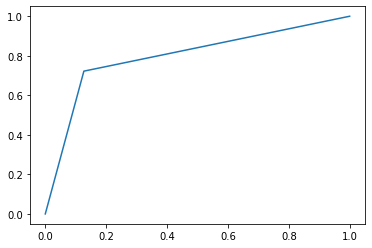

threshold =  0.4


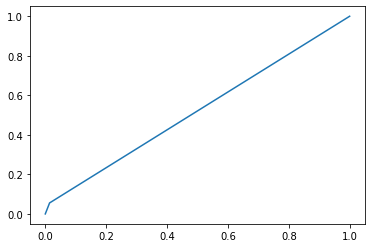

threshold =  0.5


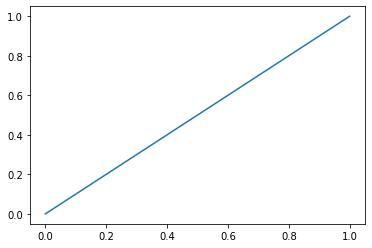

threshold =  0.7


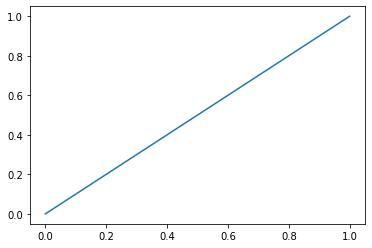

threshold =  0.8


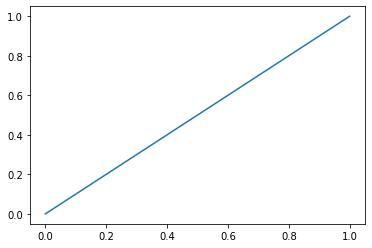

auto threshold


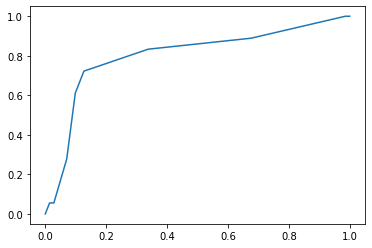

neighbours = 20 err_train = 0.18518518518518517 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


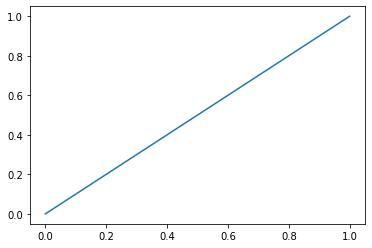

threshold =  0.2


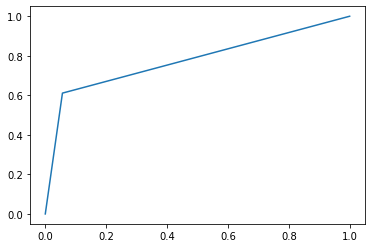

threshold =  0.4


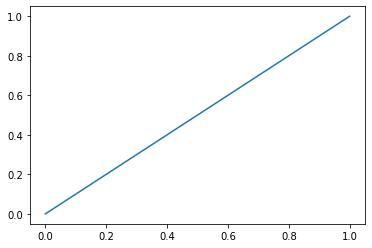

threshold =  0.5


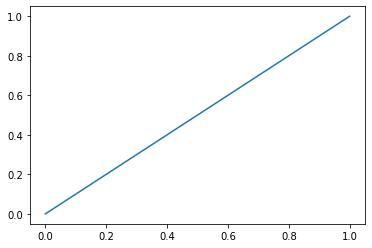

threshold =  0.7


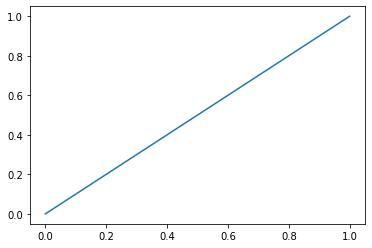

threshold =  0.8


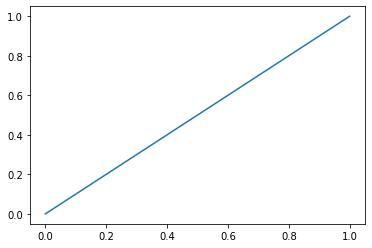

auto threshold


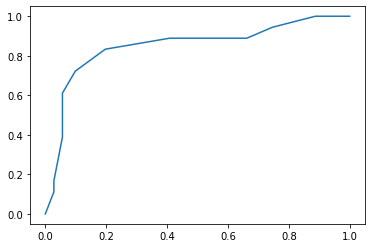

neighbours = 50 err_train = 0.19753086419753085 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [169]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[9][i]=err_test
    Knn_train[9][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [170]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[9]= err_test
SVC_train[9]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.15432098765432098 err_test_SVC = 0.1797752808988764


# Condensed nearest neighbors and derived algorithms

## CondensedNearestNeighbour

In [171]:
from imblearn.under_sampling import CondensedNearestNeighbour
cnn = CondensedNearestNeighbour(random_state=0)
X_resampled, y_resampled = cnn.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 51), (1, 32)]


## Knn

threshold =  0.0


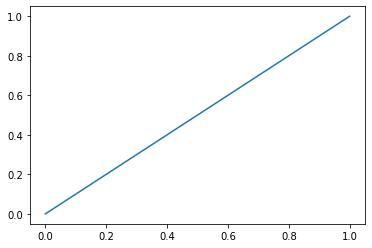

threshold =  0.2


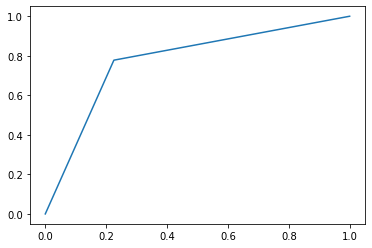

threshold =  0.4


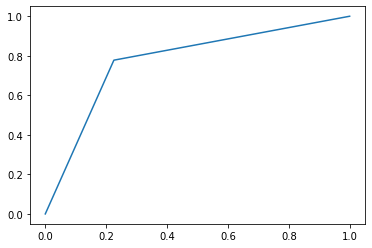

threshold =  0.5


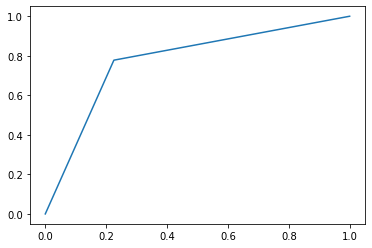

threshold =  0.7


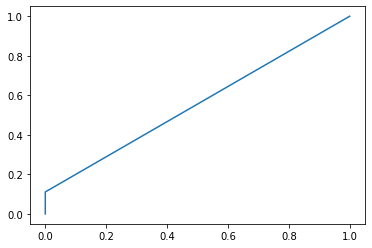

threshold =  0.8


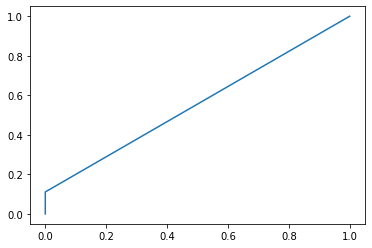

auto threshold


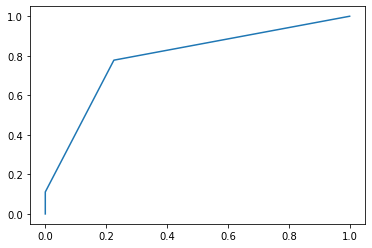

neighbours = 2 err_train = 0.20481927710843373 err_test = 0.1797752808988764
[[71  0]
 [16  2]]
Mera F1 Train: 0.19999999999999998
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


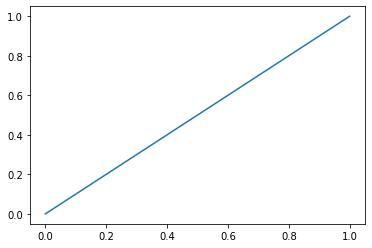

threshold =  0.2


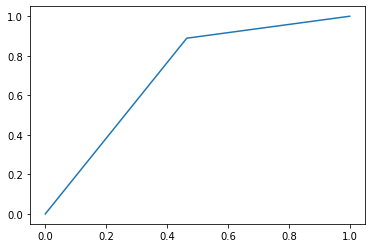

threshold =  0.4


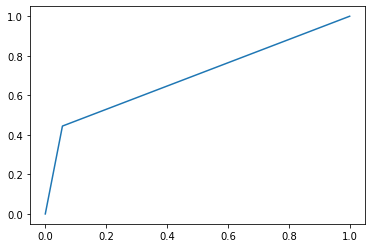

threshold =  0.5


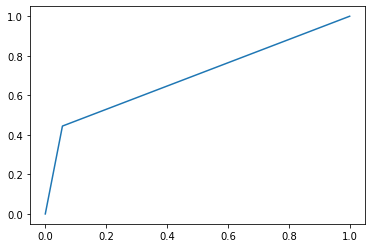

threshold =  0.7


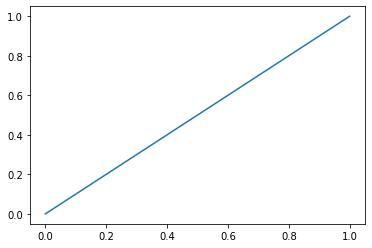

threshold =  0.8


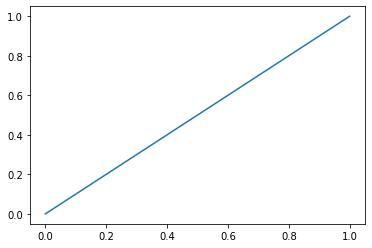

auto threshold


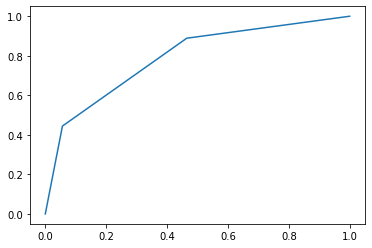

neighbours = 3 err_train = 0.1566265060240964 err_test = 0.15730337078651685
[[67  4]
 [10  8]]
Mera F1 Train: 0.5333333333333333
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


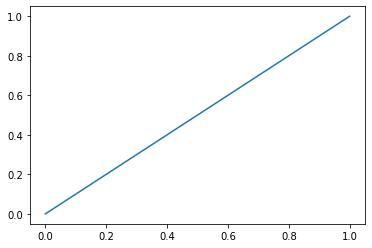

threshold =  0.2


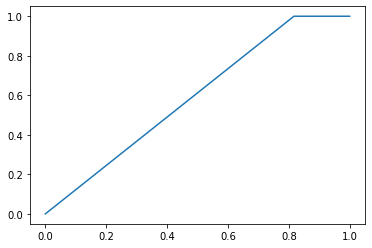

threshold =  0.4


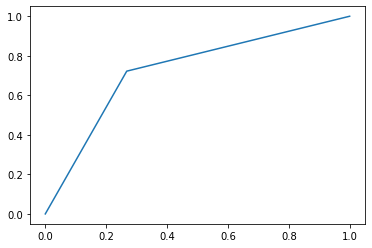

threshold =  0.5


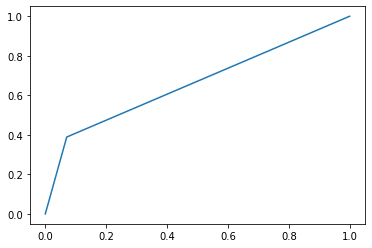

threshold =  0.7


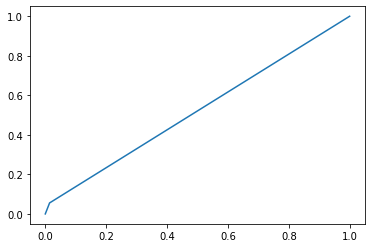

threshold =  0.8


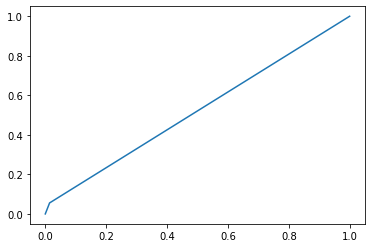

auto threshold


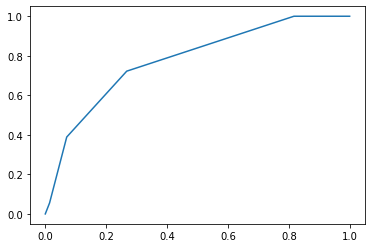

neighbours = 5 err_train = 0.18072289156626506 err_test = 0.1797752808988764
[[66  5]
 [11  7]]
Mera F1 Train: 0.4666666666666666
Precision Score Train:  0.8202247191011236
Recall Score Train:  0.8202247191011236
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


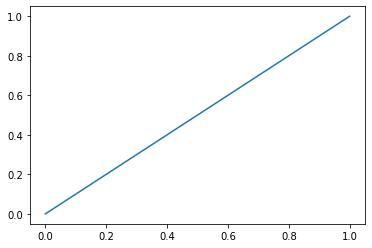

threshold =  0.2


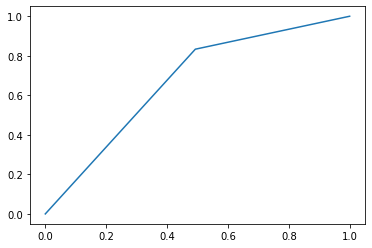

threshold =  0.4


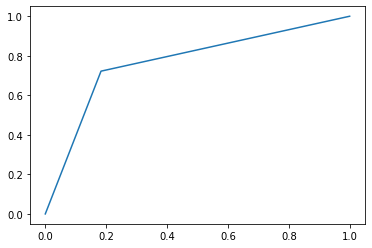

threshold =  0.5


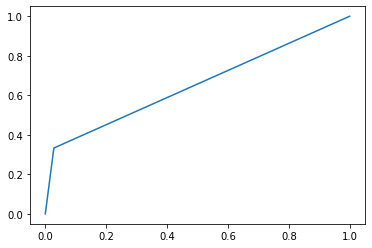

threshold =  0.7


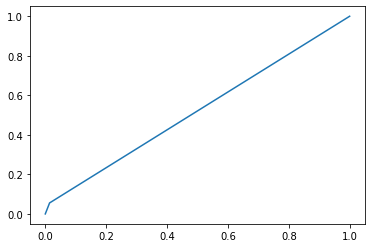

threshold =  0.8


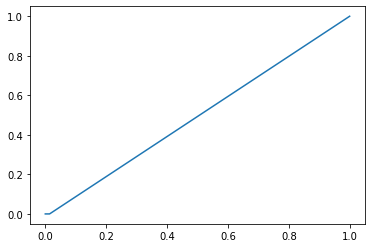

auto threshold


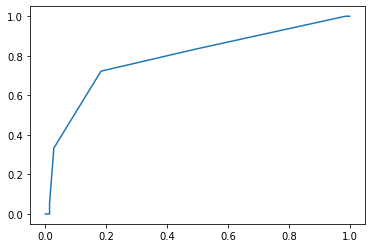

neighbours = 7 err_train = 0.21686746987951808 err_test = 0.15730337078651685
[[69  2]
 [12  6]]
Mera F1 Train: 0.46153846153846156
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


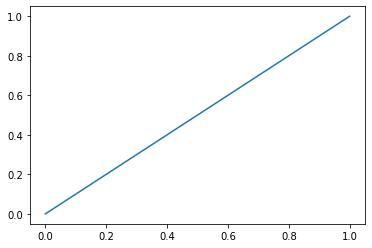

threshold =  0.2


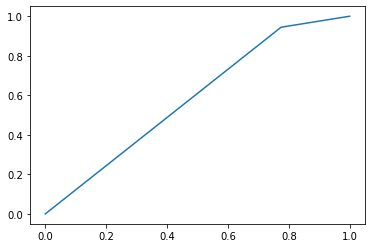

threshold =  0.4


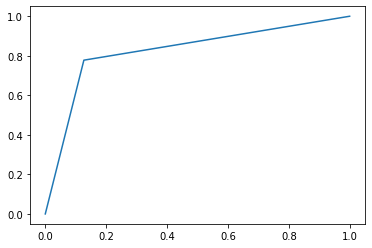

threshold =  0.5


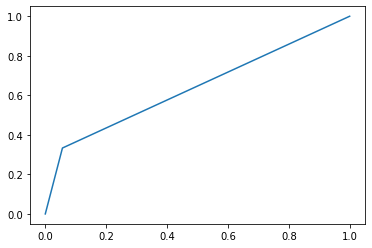

threshold =  0.7


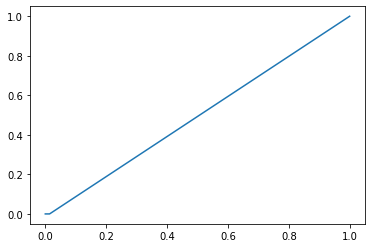

threshold =  0.8


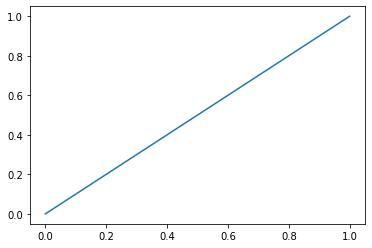

auto threshold


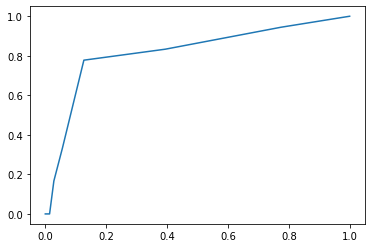

neighbours = 10 err_train = 0.26506024096385544 err_test = 0.19101123595505617
[[69  2]
 [15  3]]
Mera F1 Train: 0.2608695652173913
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


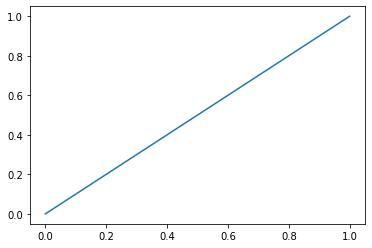

threshold =  0.2


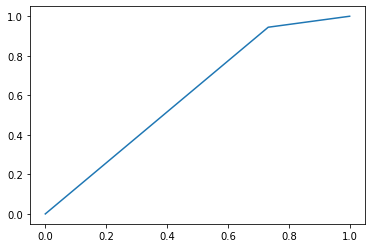

threshold =  0.4


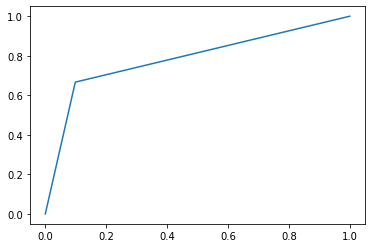

threshold =  0.5


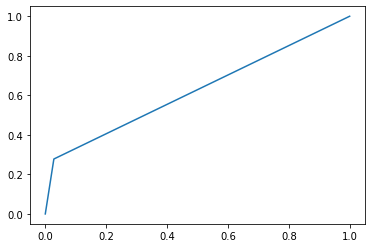

threshold =  0.7


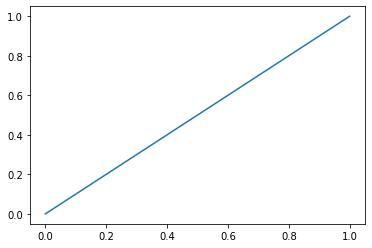

threshold =  0.8


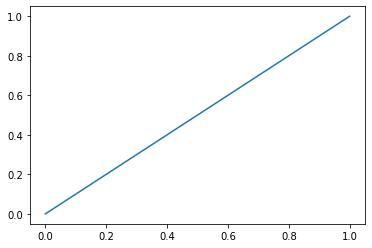

auto threshold


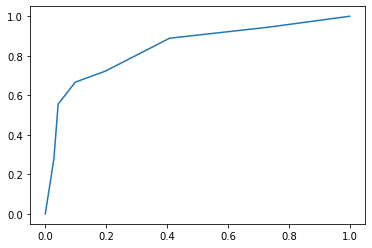

neighbours = 15 err_train = 0.25301204819277107 err_test = 0.16853932584269662
[[69  2]
 [13  5]]
Mera F1 Train: 0.4
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


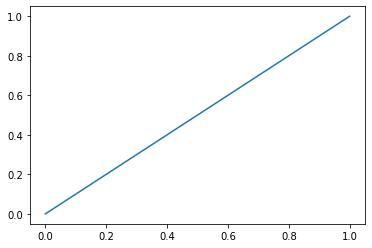

threshold =  0.2


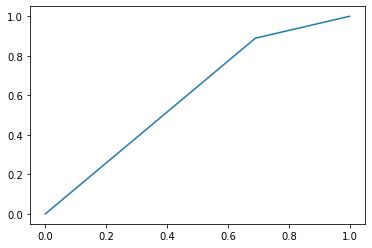

threshold =  0.4


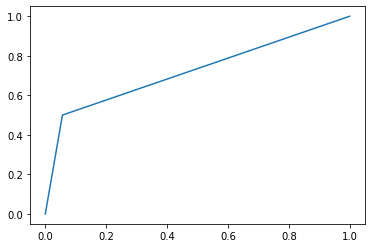

threshold =  0.5


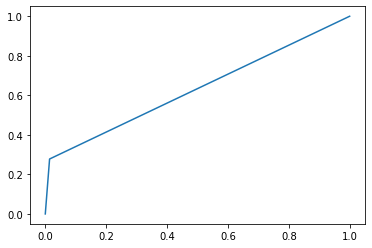

threshold =  0.7


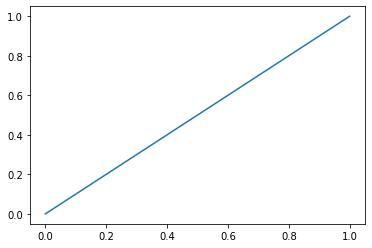

threshold =  0.8


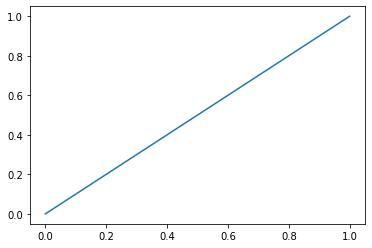

auto threshold


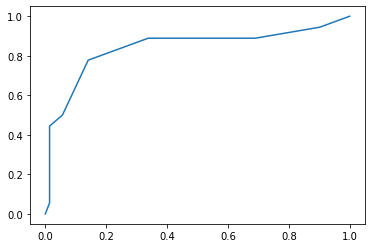

neighbours = 20 err_train = 0.30120481927710846 err_test = 0.20224719101123595
[[70  1]
 [17  1]]
Mera F1 Train: 0.09999999999999999
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


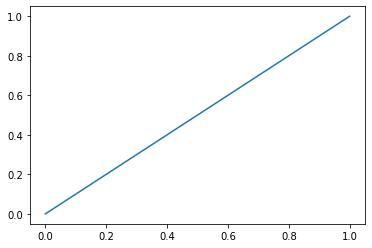

threshold =  0.2


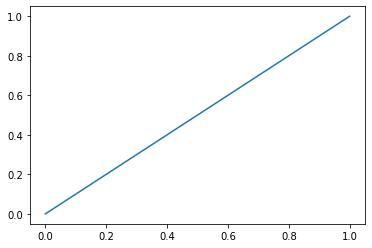

threshold =  0.4


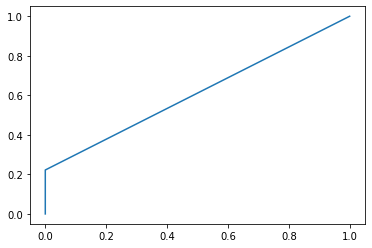

threshold =  0.5


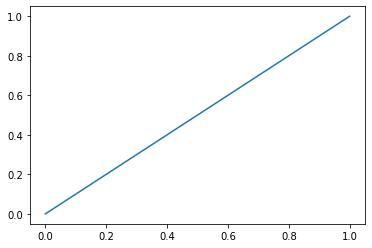

threshold =  0.7


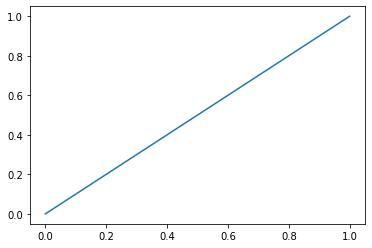

threshold =  0.8


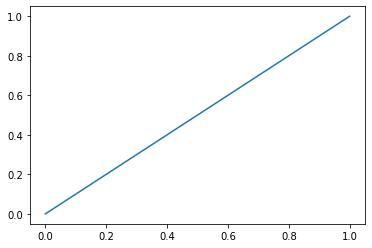

auto threshold


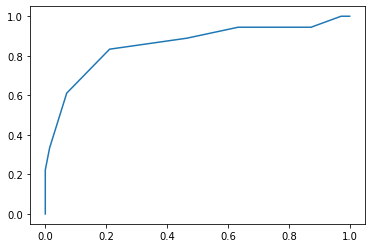

neighbours = 50 err_train = 0.3855421686746988 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [172]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[10][i]=err_test
    Knn_train[10][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [173]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[10]= err_test
SVC_train[10]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.25301204819277107 err_test_SVC = 0.1797752808988764


## OneSidedSelection

In [174]:
from imblearn.under_sampling import OneSidedSelection
oss = OneSidedSelection(random_state=0)
X_resampled, y_resampled = oss.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 154), (1, 32)]


## Knn

threshold =  0.0


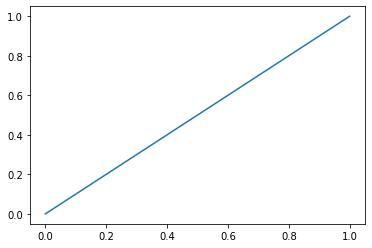

threshold =  0.2


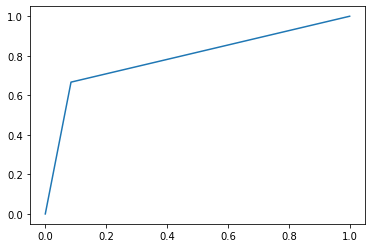

threshold =  0.4


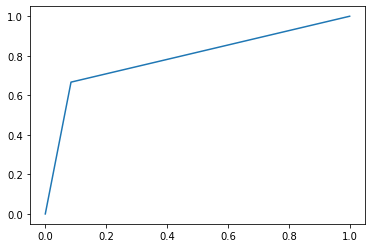

threshold =  0.5


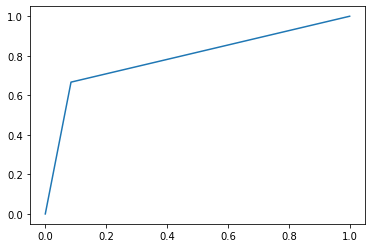

threshold =  0.7


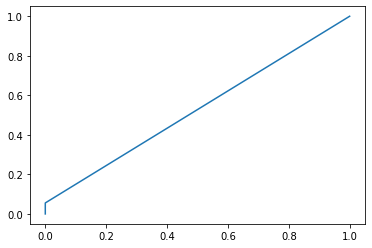

threshold =  0.8


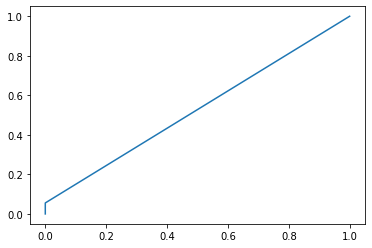

auto threshold


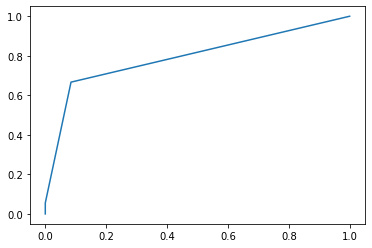

neighbours = 2 err_train = 0.10215053763440861 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


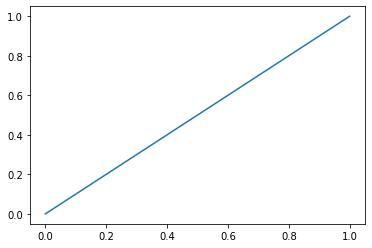

threshold =  0.2


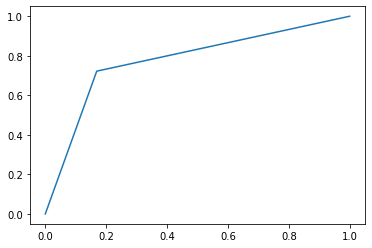

threshold =  0.4


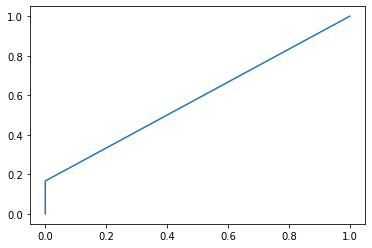

threshold =  0.5


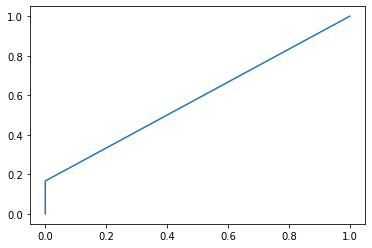

threshold =  0.7


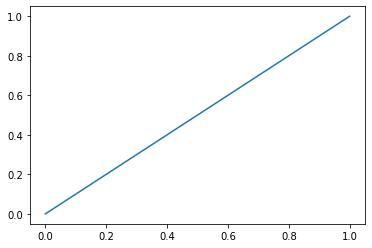

threshold =  0.8


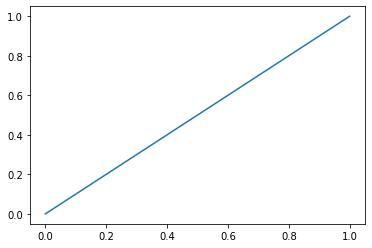

auto threshold


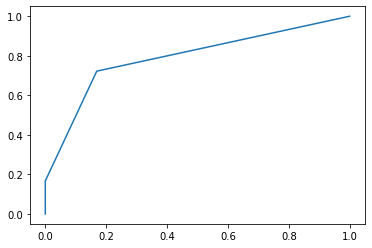

neighbours = 3 err_train = 0.06451612903225806 err_test = 0.16853932584269662
[[71  0]
 [15  3]]
Mera F1 Train: 0.2857142857142857
Precision Score Train:  0.8314606741573034
Recall Score Train:  0.8314606741573034
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


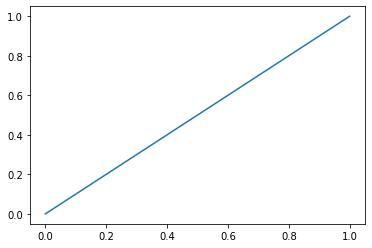

threshold =  0.2


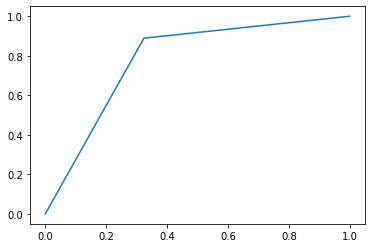

threshold =  0.4


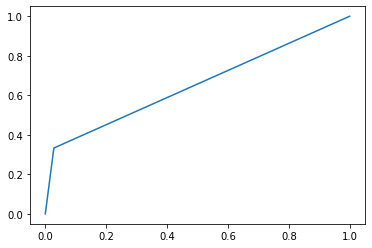

threshold =  0.5


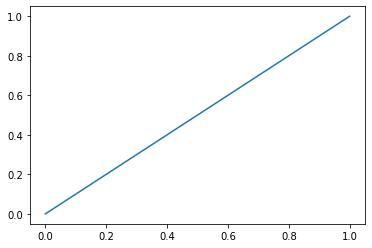

threshold =  0.7


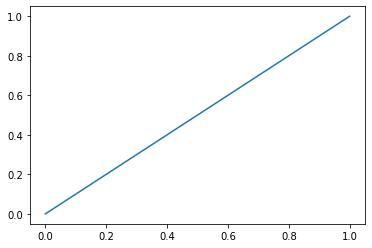

threshold =  0.8


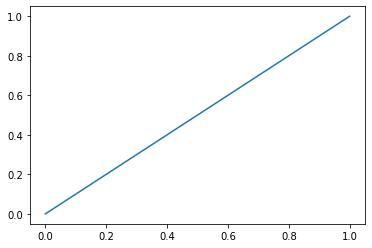

auto threshold


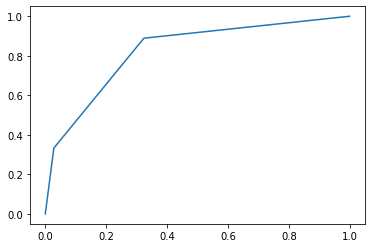

neighbours = 5 err_train = 0.11290322580645161 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


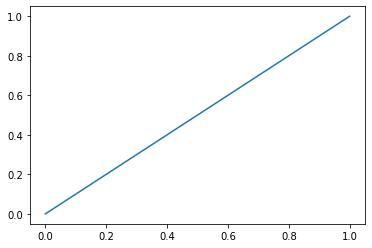

threshold =  0.2


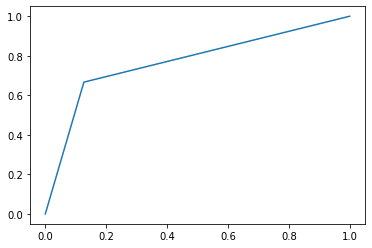

threshold =  0.4


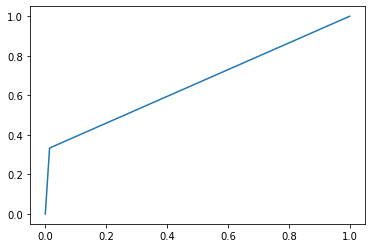

threshold =  0.5


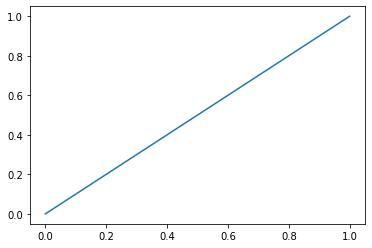

threshold =  0.7


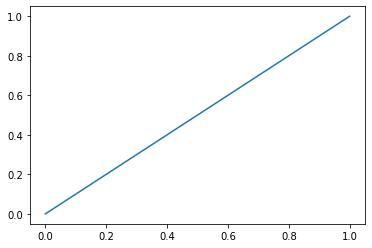

threshold =  0.8


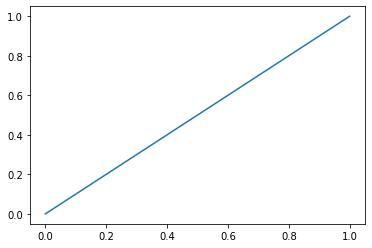

auto threshold


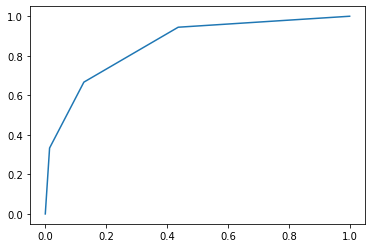

neighbours = 7 err_train = 0.12903225806451613 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


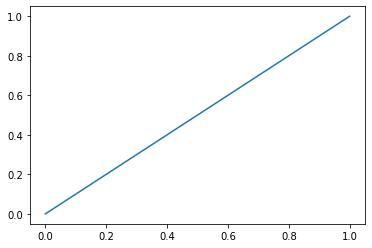

threshold =  0.2


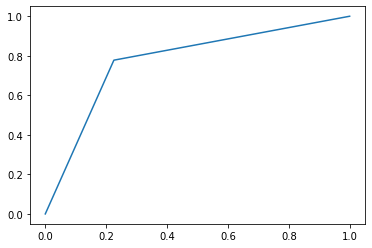

threshold =  0.4


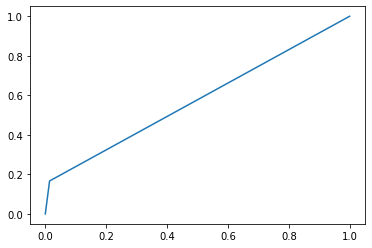

threshold =  0.5


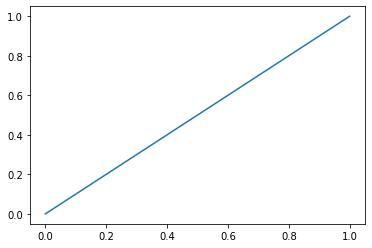

threshold =  0.7


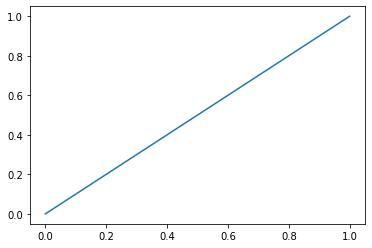

threshold =  0.8


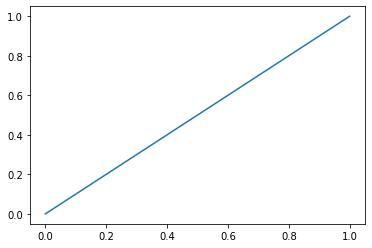

auto threshold


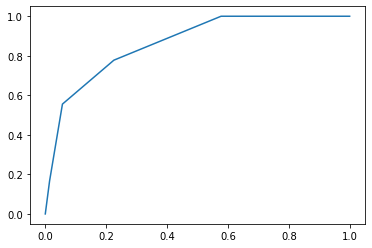

neighbours = 10 err_train = 0.13978494623655913 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


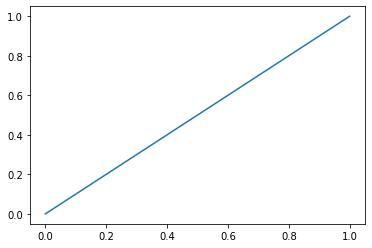

threshold =  0.2


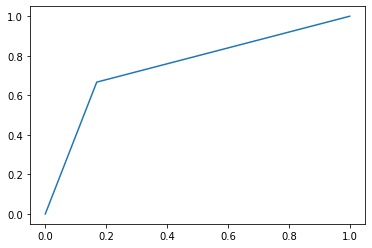

threshold =  0.4


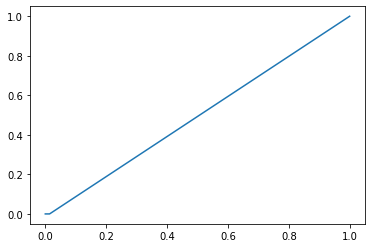

threshold =  0.5


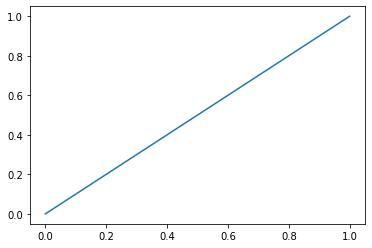

threshold =  0.7


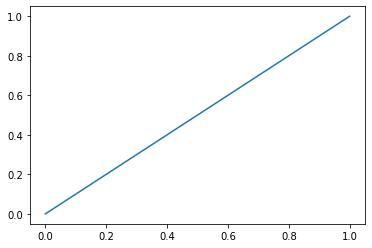

threshold =  0.8


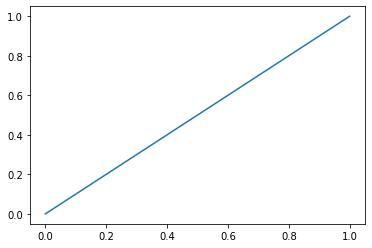

auto threshold


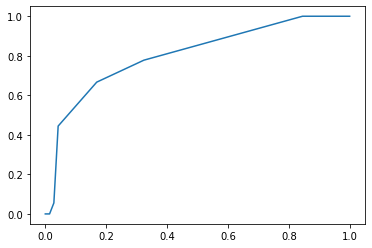

neighbours = 15 err_train = 0.15053763440860216 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


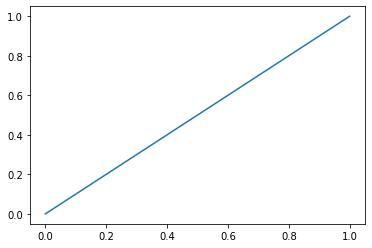

threshold =  0.2


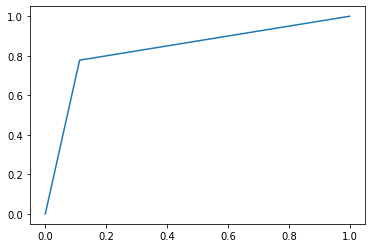

threshold =  0.4


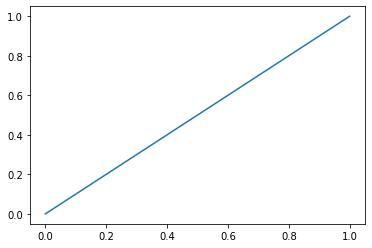

threshold =  0.5


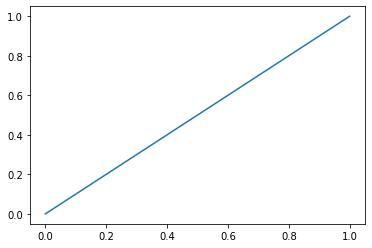

threshold =  0.7


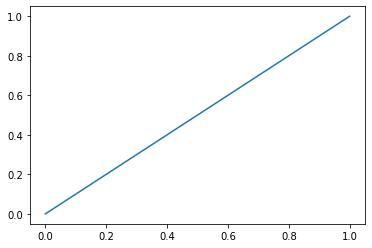

threshold =  0.8


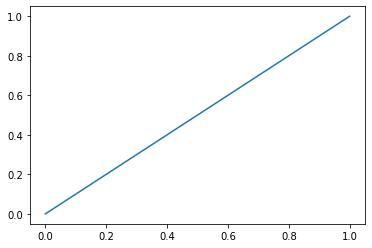

auto threshold


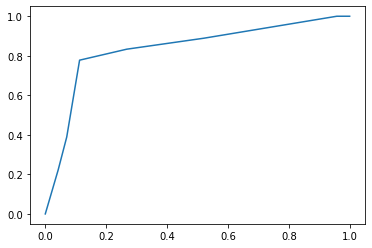

neighbours = 20 err_train = 0.16129032258064516 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


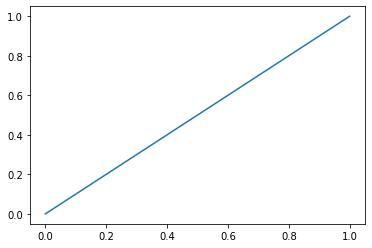

threshold =  0.2


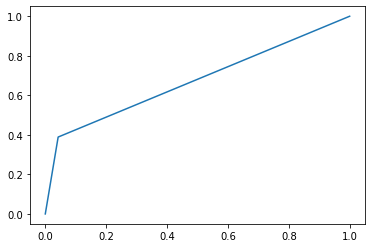

threshold =  0.4


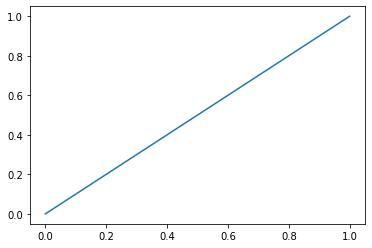

threshold =  0.5


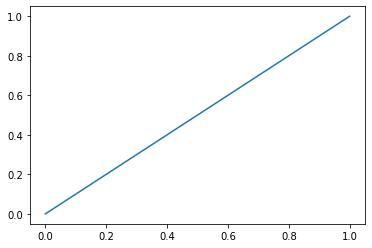

threshold =  0.7


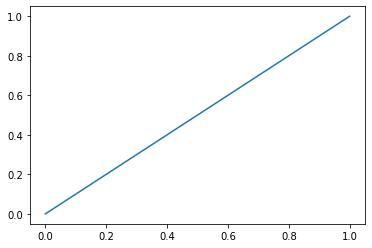

threshold =  0.8


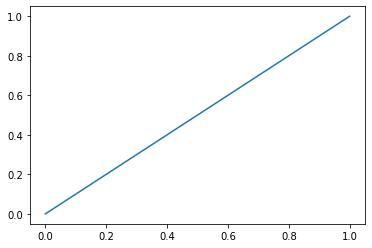

auto threshold


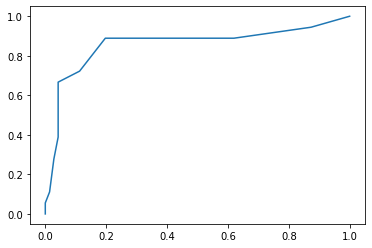

neighbours = 50 err_train = 0.17204301075268819 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [175]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[11][i]=err_test
    Knn_train[11][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [176]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[11]= err_test
SVC_train[11]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.12903225806451613 err_test_SVC = 0.20224719101123595


## NeighbourhoodCleaningRule

In [177]:
from imblearn.under_sampling import NeighbourhoodCleaningRule
ncr = NeighbourhoodCleaningRule()
X_resampled, y_resampled = ncr.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 129), (1, 32)]


## Knn

threshold =  0.0


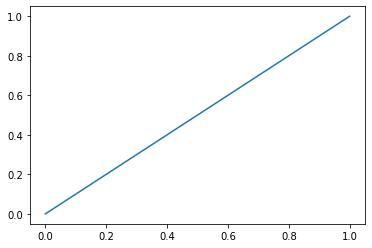

threshold =  0.2


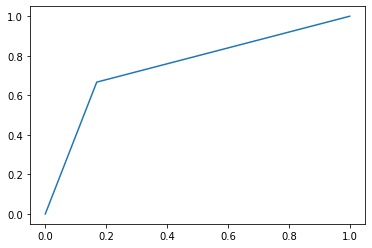

threshold =  0.4


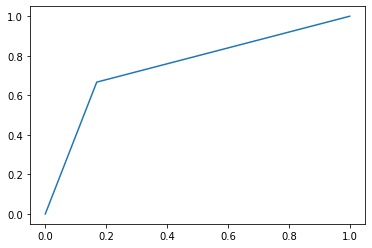

threshold =  0.5


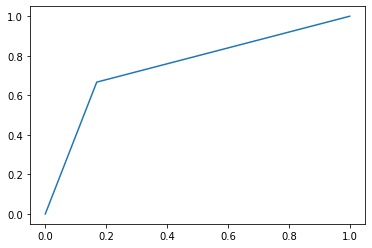

threshold =  0.7


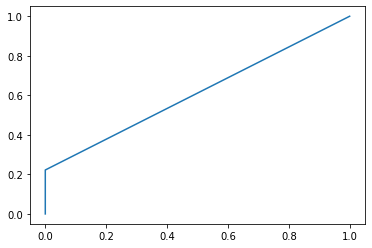

threshold =  0.8


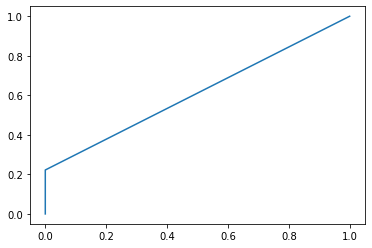

auto threshold


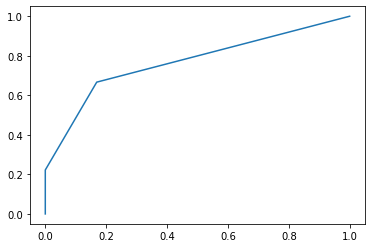

neighbours = 2 err_train = 0.043478260869565216 err_test = 0.15730337078651685
[[71  0]
 [14  4]]
Mera F1 Train: 0.3636363636363636
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


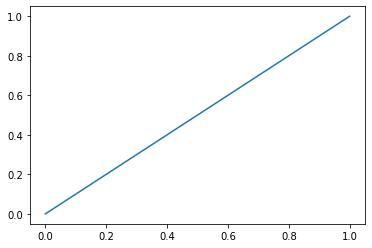

threshold =  0.2


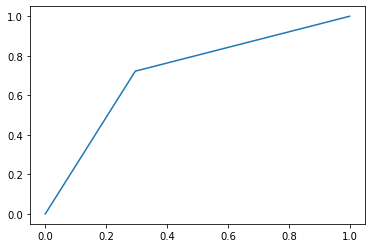

threshold =  0.4


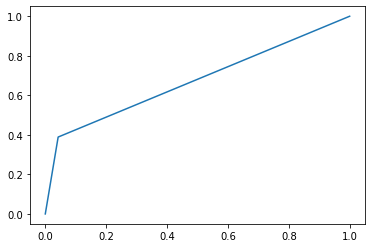

threshold =  0.5


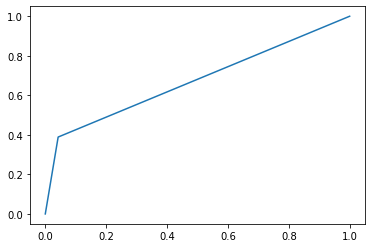

threshold =  0.7


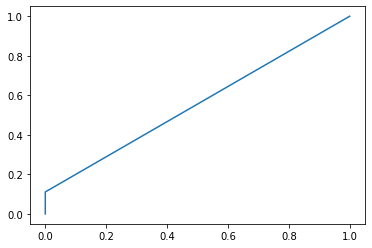

threshold =  0.8


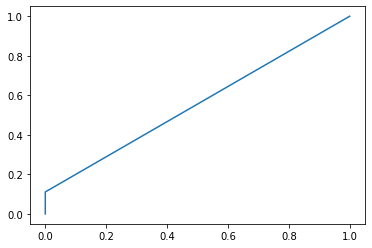

auto threshold


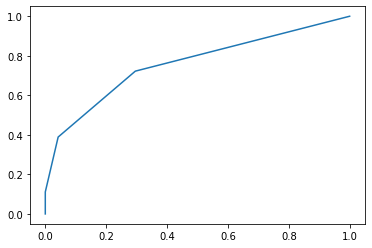

neighbours = 3 err_train = 0.043478260869565216 err_test = 0.15730337078651685
[[68  3]
 [11  7]]
Mera F1 Train: 0.5
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


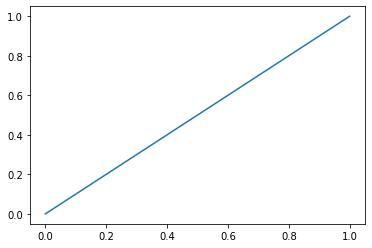

threshold =  0.2


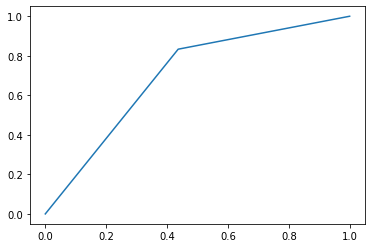

threshold =  0.4


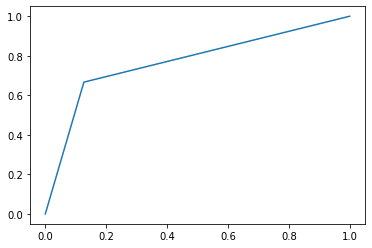

threshold =  0.5


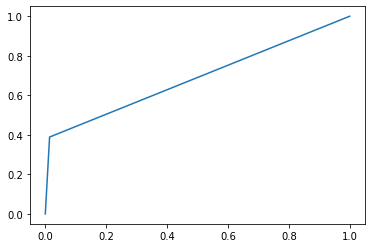

threshold =  0.7


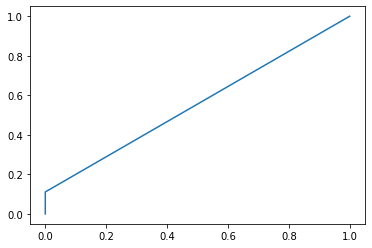

threshold =  0.8


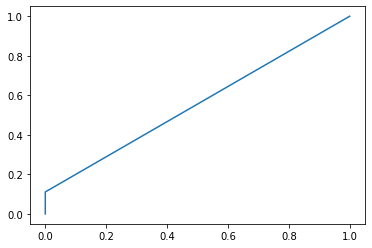

auto threshold


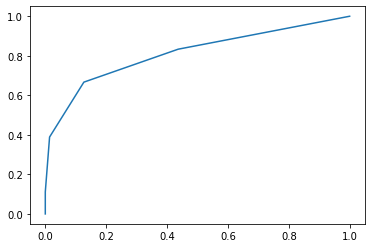

neighbours = 5 err_train = 0.09316770186335403 err_test = 0.1348314606741573
[[70  1]
 [11  7]]
Mera F1 Train: 0.5384615384615385
Precision Score Train:  0.8651685393258427
Recall Score Train:  0.8651685393258427
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


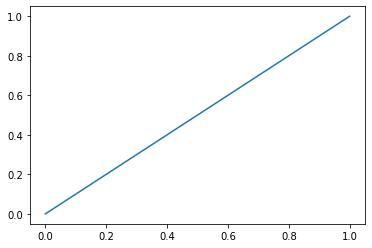

threshold =  0.2


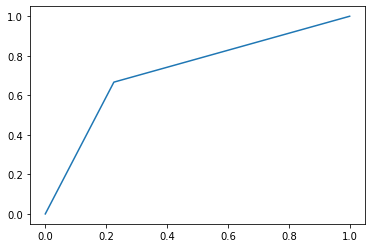

threshold =  0.4


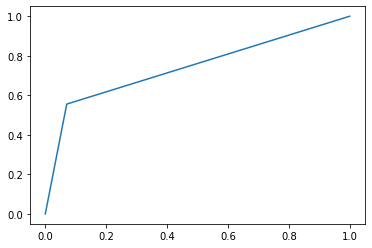

threshold =  0.5


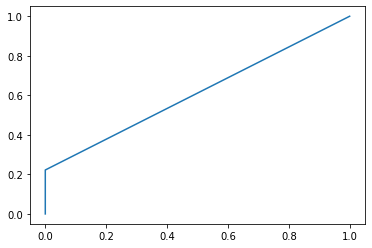

threshold =  0.7


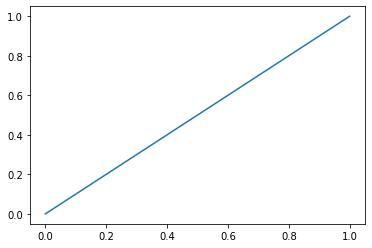

threshold =  0.8


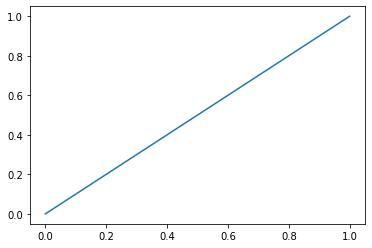

auto threshold


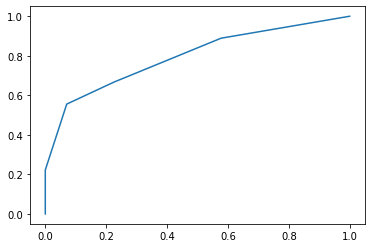

neighbours = 7 err_train = 0.08695652173913043 err_test = 0.15730337078651685
[[71  0]
 [14  4]]
Mera F1 Train: 0.3636363636363636
Precision Score Train:  0.8426966292134831
Recall Score Train:  0.8426966292134831
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


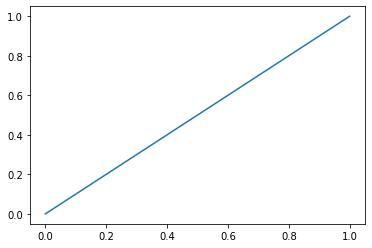

threshold =  0.2


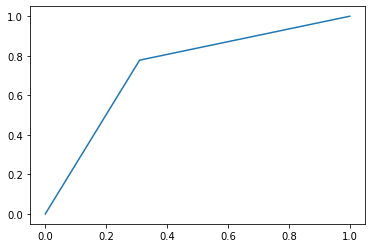

threshold =  0.4


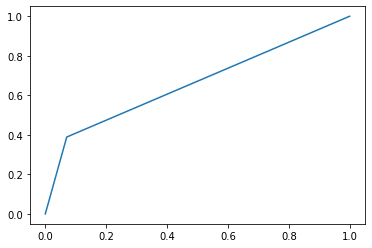

threshold =  0.5


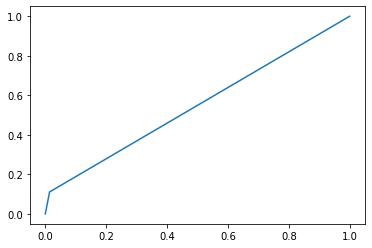

threshold =  0.7


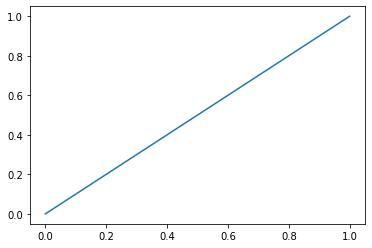

threshold =  0.8


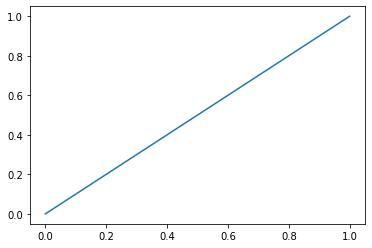

auto threshold


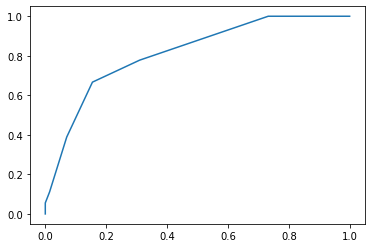

neighbours = 10 err_train = 0.14285714285714285 err_test = 0.19101123595505617
[[71  0]
 [17  1]]
Mera F1 Train: 0.10526315789473684
Precision Score Train:  0.8089887640449438
Recall Score Train:  0.8089887640449438
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


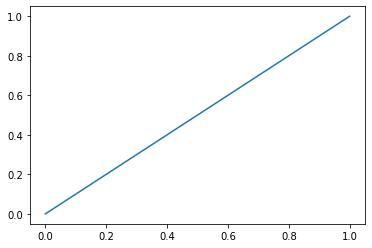

threshold =  0.2


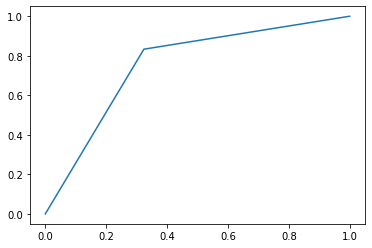

threshold =  0.4


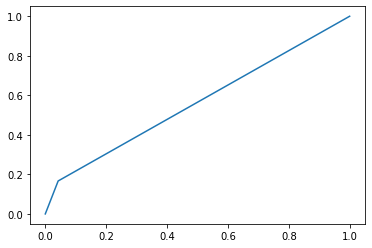

threshold =  0.5


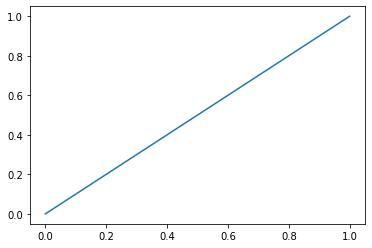

threshold =  0.7


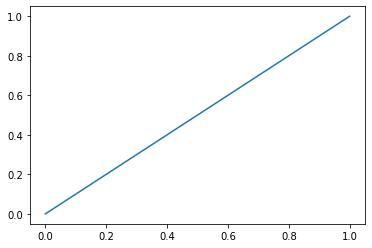

threshold =  0.8


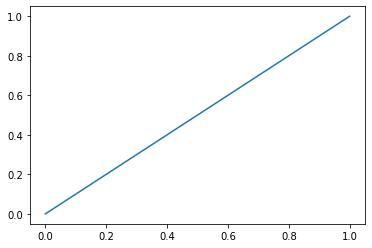

auto threshold


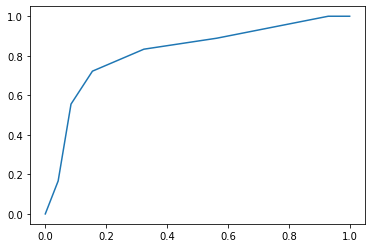

neighbours = 15 err_train = 0.14285714285714285 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


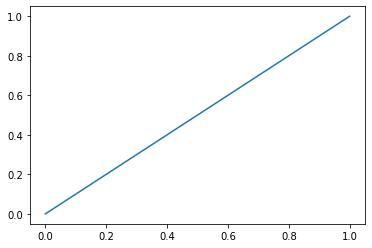

threshold =  0.2


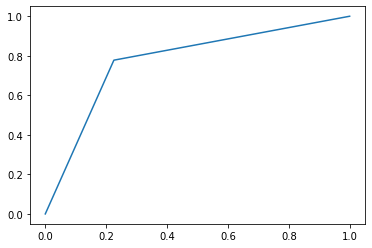

threshold =  0.4


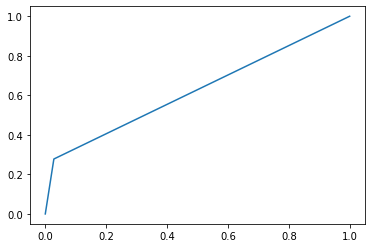

threshold =  0.5


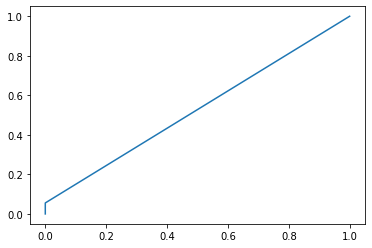

threshold =  0.7


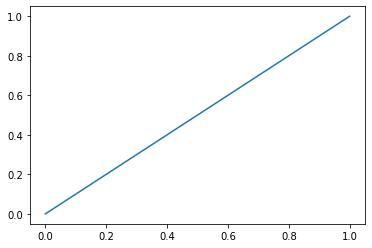

threshold =  0.8


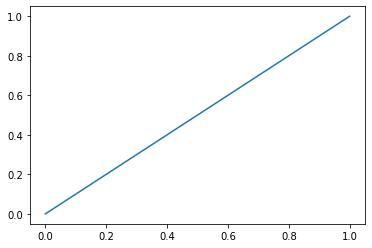

auto threshold


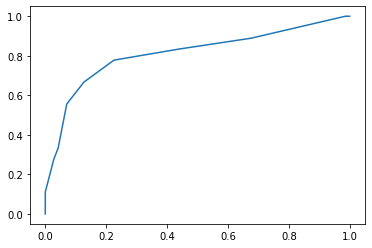

neighbours = 20 err_train = 0.18012422360248448 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


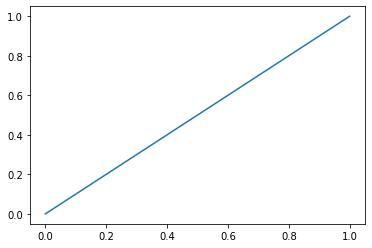

threshold =  0.2


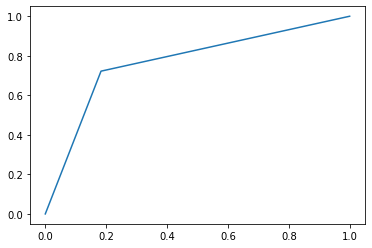

threshold =  0.4


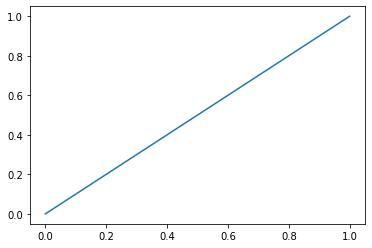

threshold =  0.5


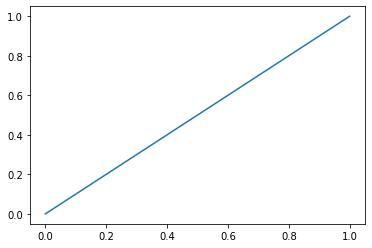

threshold =  0.7


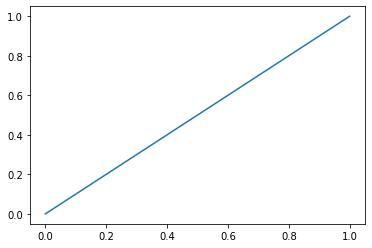

threshold =  0.8


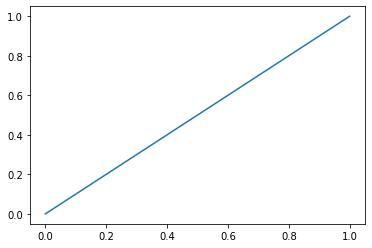

auto threshold


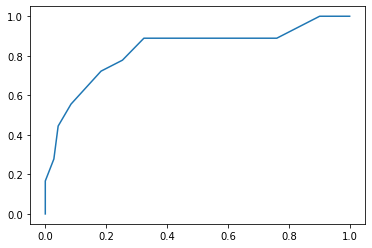

neighbours = 50 err_train = 0.19875776397515527 err_test = 0.20224719101123595
[[71  0]
 [18  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.797752808988764
Recall Score Train:  0.797752808988764


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [178]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[12][i]=err_test
    Knn_train[12][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [179]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[12]= err_test
SVC_train[12]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.14906832298136646 err_test_SVC = 0.1797752808988764


 ## Instance hardness threshold

In [180]:
from sklearn.linear_model import LogisticRegression
from imblearn.under_sampling import InstanceHardnessThreshold
iht = InstanceHardnessThreshold(random_state=0,
                                estimator=LogisticRegression(
                                    solver='lbfgs', multi_class='auto'))
X_resampled, y_resampled = iht.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 32), (1, 32)]


H:\Anaconda\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
H:\Anaconda\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_ms

## Knn

threshold =  0.0


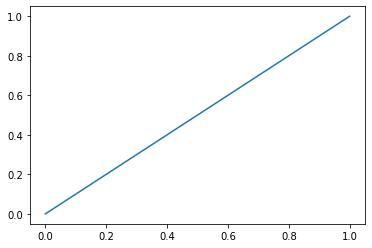

threshold =  0.2


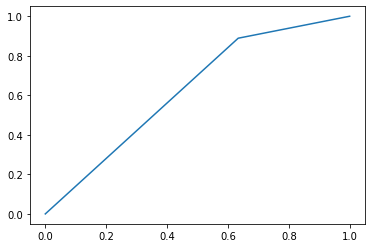

threshold =  0.4


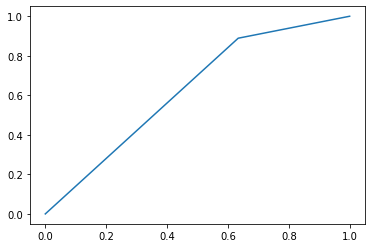

threshold =  0.5


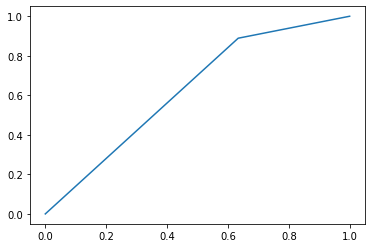

threshold =  0.7


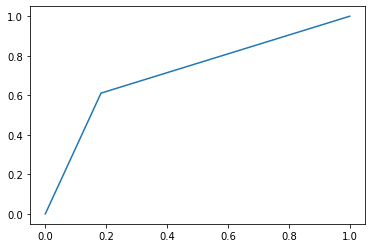

threshold =  0.8


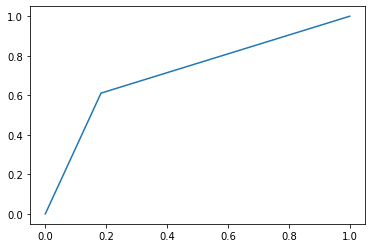

auto threshold


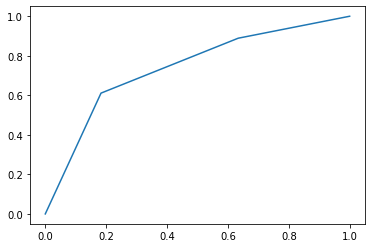

neighbours = 2 err_train = 0.078125 err_test = 0.2247191011235955
[[58 13]
 [ 7 11]]
Mera F1 Train: 0.5238095238095238
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


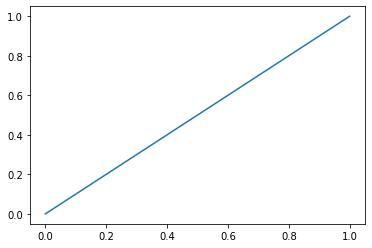

threshold =  0.2


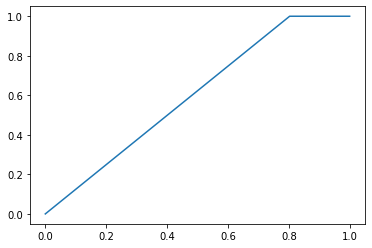

threshold =  0.4


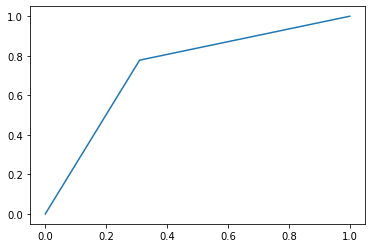

threshold =  0.5


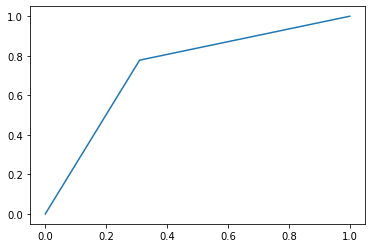

threshold =  0.7


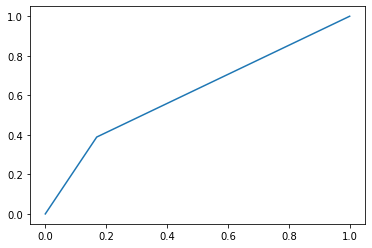

threshold =  0.8


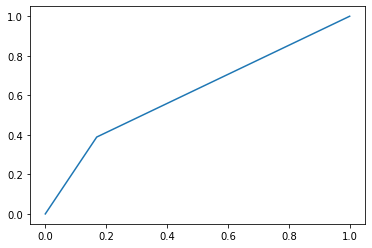

auto threshold


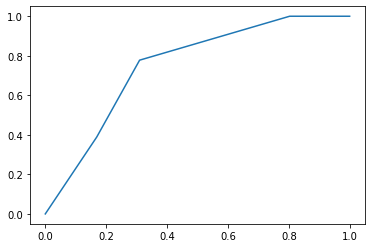

neighbours = 3 err_train = 0.0625 err_test = 0.29213483146067415
[[49 22]
 [ 4 14]]
Mera F1 Train: 0.5185185185185185
Precision Score Train:  0.7078651685393258
Recall Score Train:  0.7078651685393258
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


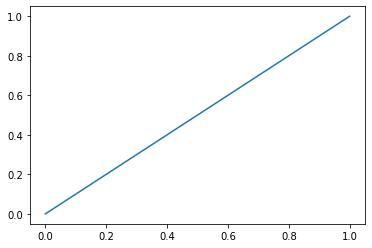

threshold =  0.2


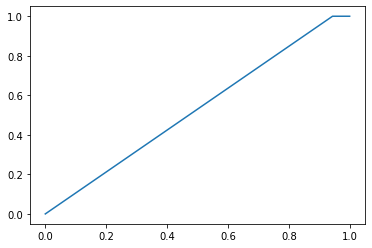

threshold =  0.4


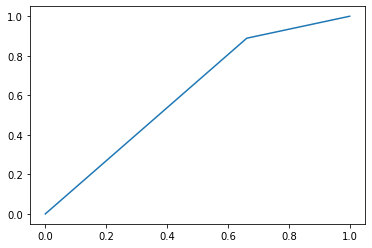

threshold =  0.5


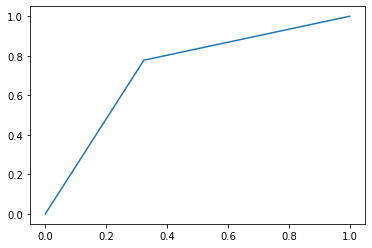

threshold =  0.7


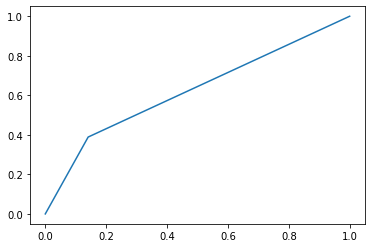

threshold =  0.8


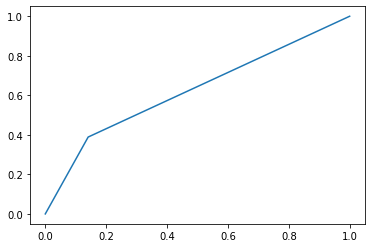

auto threshold


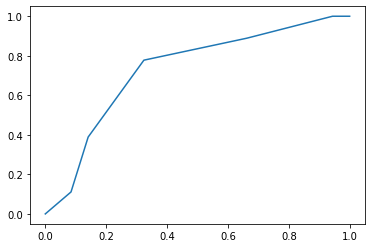

neighbours = 5 err_train = 0.078125 err_test = 0.30337078651685395
[[48 23]
 [ 4 14]]
Mera F1 Train: 0.5090909090909091
Precision Score Train:  0.6966292134831461
Recall Score Train:  0.6966292134831461
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


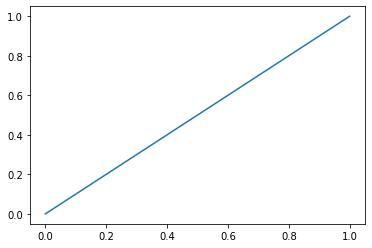

threshold =  0.2


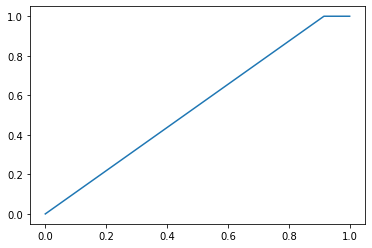

threshold =  0.4


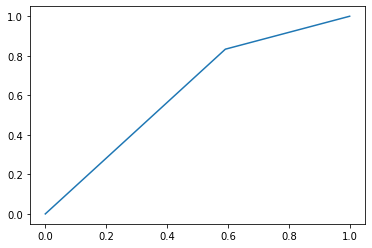

threshold =  0.5


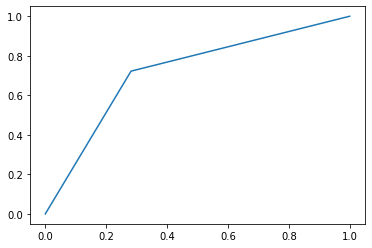

threshold =  0.7


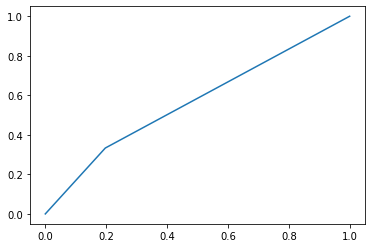

threshold =  0.8


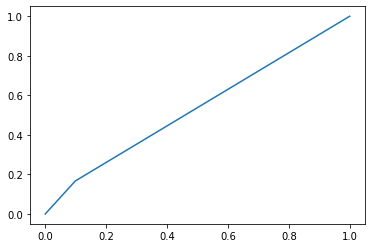

auto threshold


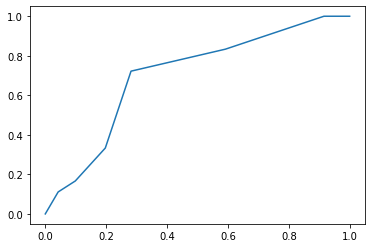

neighbours = 7 err_train = 0.046875 err_test = 0.2808988764044944
[[51 20]
 [ 5 13]]
Mera F1 Train: 0.5098039215686274
Precision Score Train:  0.7191011235955056
Recall Score Train:  0.7191011235955056
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


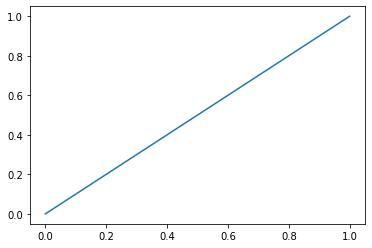

threshold =  0.2


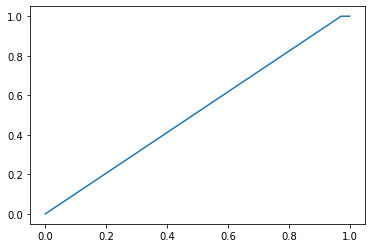

threshold =  0.4


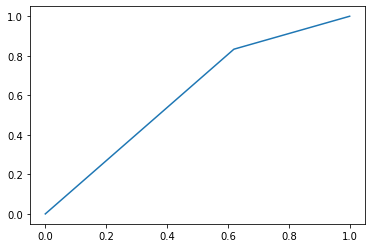

threshold =  0.5


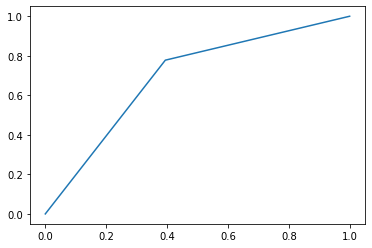

threshold =  0.7


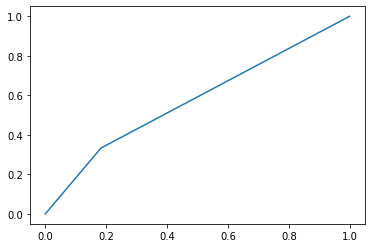

threshold =  0.8


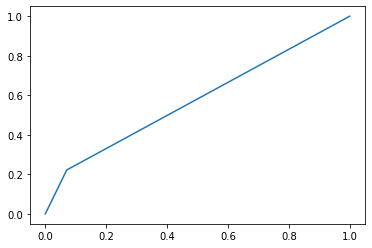

auto threshold


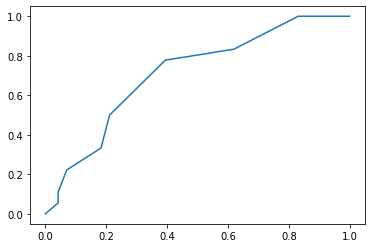

neighbours = 10 err_train = 0.09375 err_test = 0.2696629213483146
[[56 15]
 [ 9  9]]
Mera F1 Train: 0.42857142857142855
Precision Score Train:  0.7303370786516854
Recall Score Train:  0.7303370786516854
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


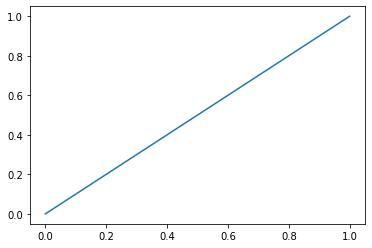

threshold =  0.2


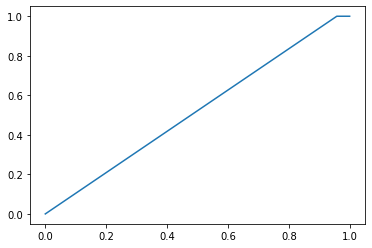

threshold =  0.4


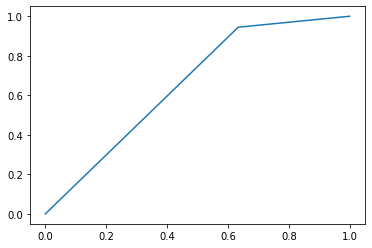

threshold =  0.5


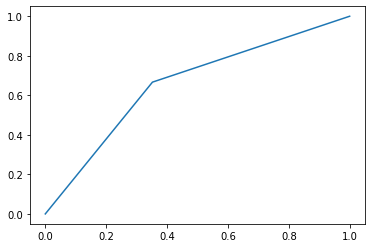

threshold =  0.7


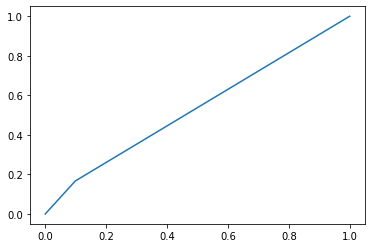

threshold =  0.8


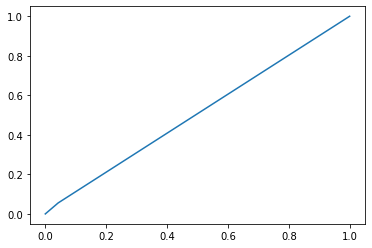

auto threshold


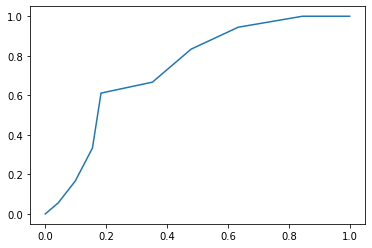

neighbours = 15 err_train = 0.09375 err_test = 0.34831460674157305
[[46 25]
 [ 6 12]]
Mera F1 Train: 0.4363636363636364
Precision Score Train:  0.651685393258427
Recall Score Train:  0.651685393258427
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


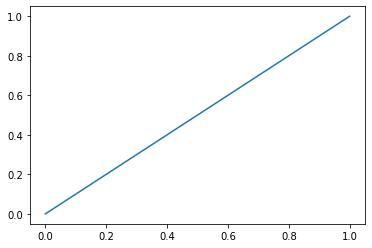

threshold =  0.2


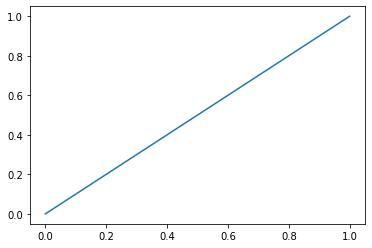

threshold =  0.4


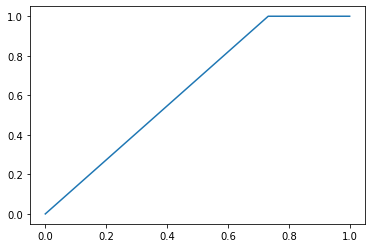

threshold =  0.5


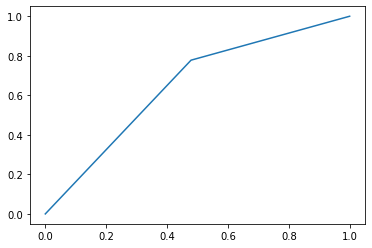

threshold =  0.7


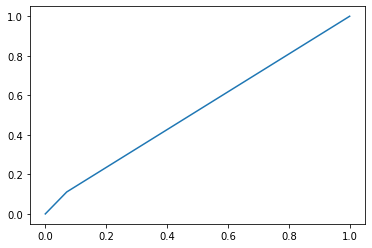

threshold =  0.8


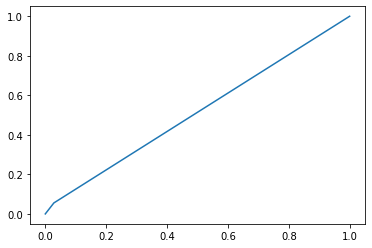

auto threshold


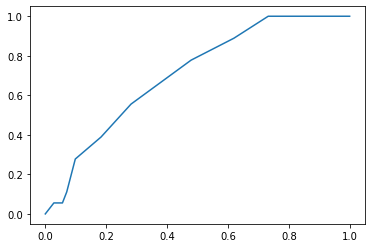

neighbours = 20 err_train = 0.109375 err_test = 0.3146067415730337
[[51 20]
 [ 8 10]]
Mera F1 Train: 0.4166666666666667
Precision Score Train:  0.6853932584269663
Recall Score Train:  0.6853932584269663
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


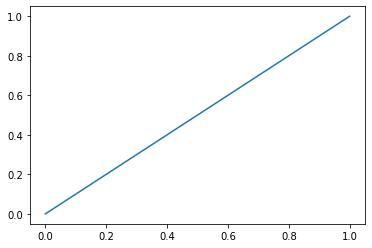

threshold =  0.2


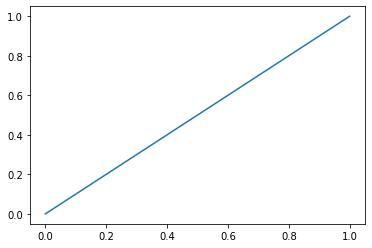

threshold =  0.4


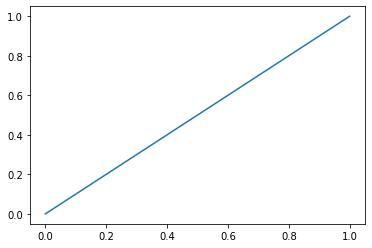

threshold =  0.5


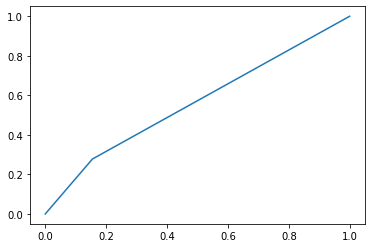

threshold =  0.7


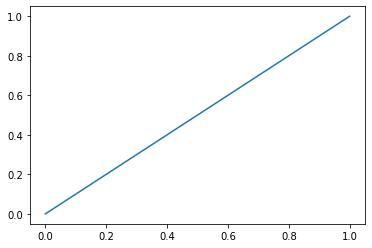

threshold =  0.8


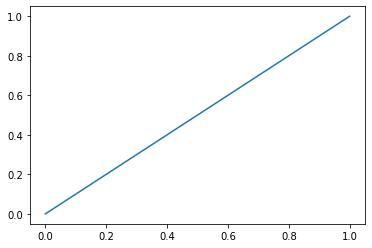

auto threshold


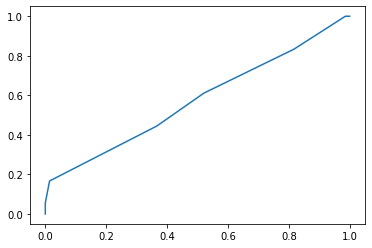

neighbours = 50 err_train = 0.296875 err_test = 0.2247191011235955
[[65  6]
 [14  4]]
Mera F1 Train: 0.2857142857142857
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [181]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[13][i]=err_test
    Knn_train[13][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [182]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[13]= err_test
SVC_train[13]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.0625 err_test_SVC = 0.29213483146067415


# Combination of over- and under-sampling

SMOTE может генерировать зашумленные выборки путем интерполяции новых точек между маргинальными выбросами и выбросами. Эту проблему можно решить, очистив пространство, возникшее из-за передозировки.

# SMOTEENN

In [183]:
from imblearn.combine import SMOTEENN
smote_enn = SMOTEENN(random_state=0)
X_resampled, y_resampled = smote_enn.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 95), (1, 171)]


## Knn

threshold =  0.0


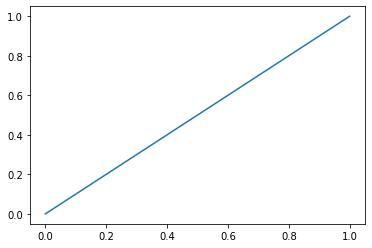

threshold =  0.2


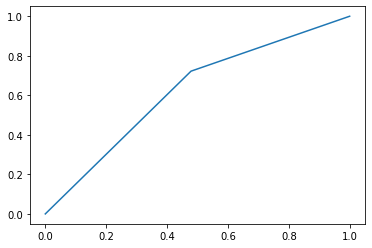

threshold =  0.4


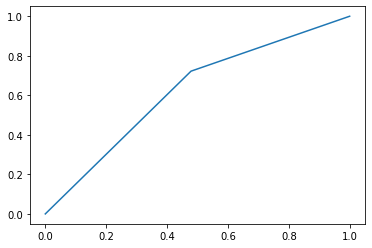

threshold =  0.5


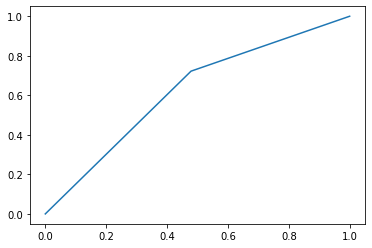

threshold =  0.7


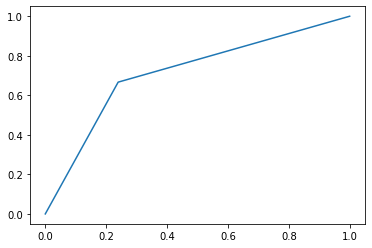

threshold =  0.8


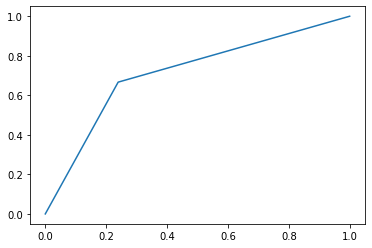

auto threshold


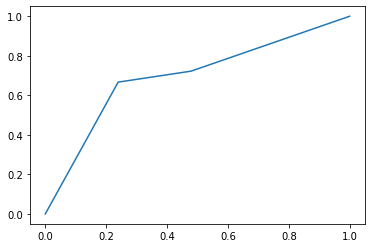

neighbours = 2 err_train = 0.0 err_test = 0.25842696629213485
[[54 17]
 [ 6 12]]
Mera F1 Train: 0.5106382978723404
Precision Score Train:  0.7415730337078652
Recall Score Train:  0.7415730337078652
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


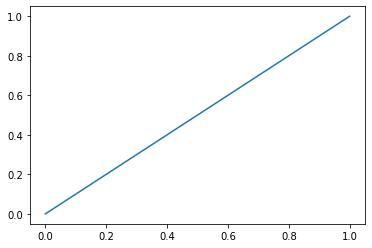

threshold =  0.2


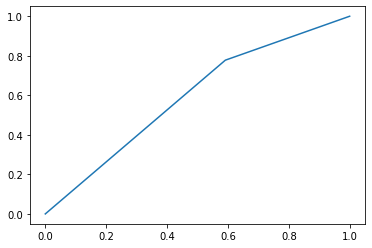

threshold =  0.4


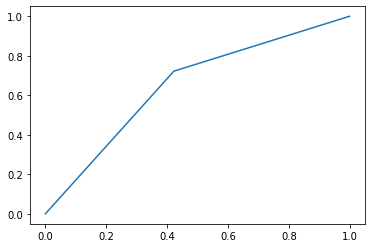

threshold =  0.5


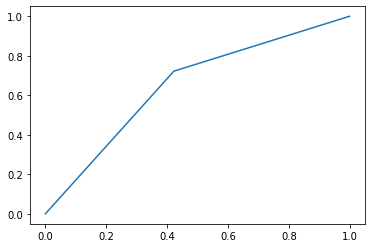

threshold =  0.7


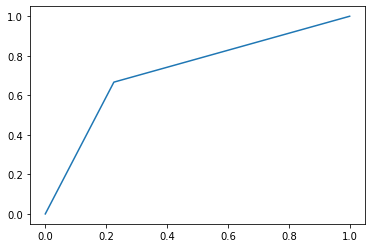

threshold =  0.8


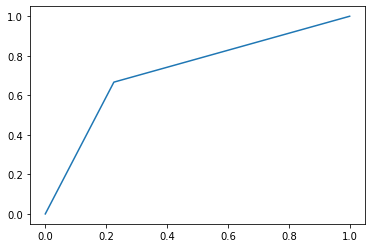

auto threshold


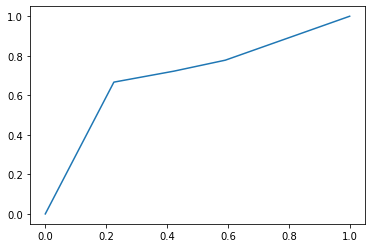

neighbours = 3 err_train = 0.0037593984962406013 err_test = 0.39325842696629215
[[41 30]
 [ 5 13]]
Mera F1 Train: 0.4262295081967213
Precision Score Train:  0.6067415730337079
Recall Score Train:  0.6067415730337079
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


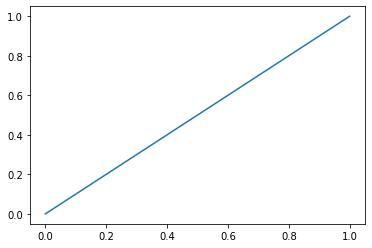

threshold =  0.2


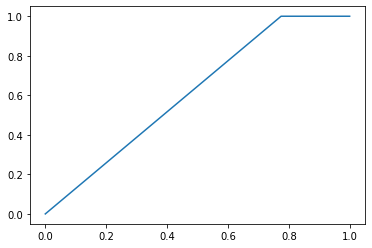

threshold =  0.4


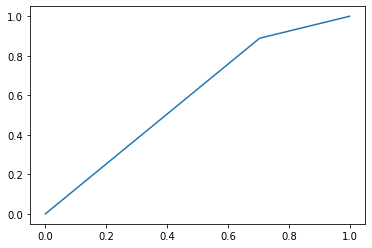

threshold =  0.5


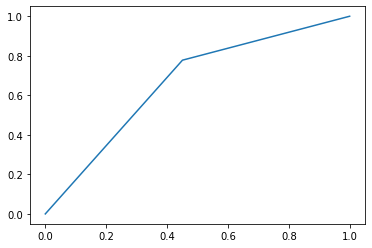

threshold =  0.7


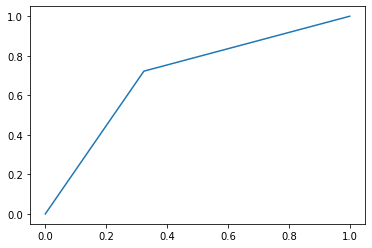

threshold =  0.8


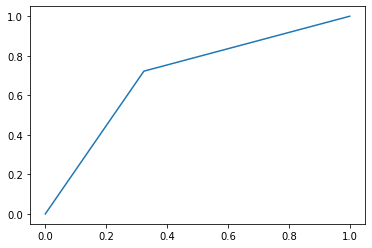

auto threshold


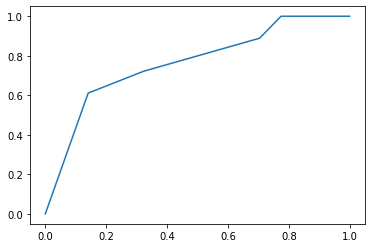

neighbours = 5 err_train = 0.02631578947368421 err_test = 0.4044943820224719
[[39 32]
 [ 4 14]]
Mera F1 Train: 0.43750000000000006
Precision Score Train:  0.5955056179775281
Recall Score Train:  0.5955056179775281
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


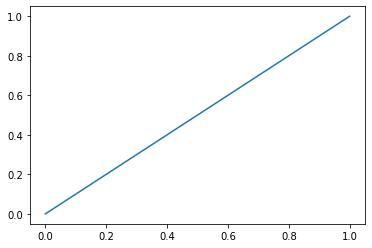

threshold =  0.2


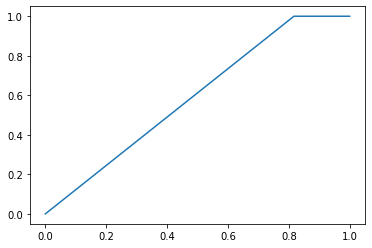

threshold =  0.4


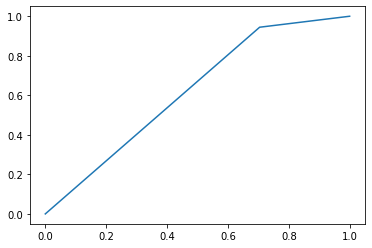

threshold =  0.5


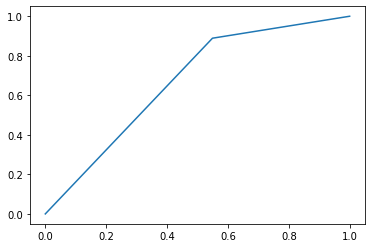

threshold =  0.7


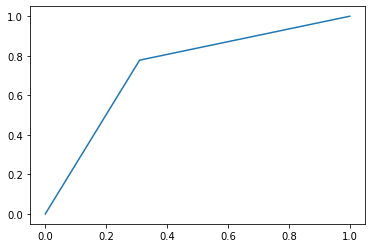

threshold =  0.8


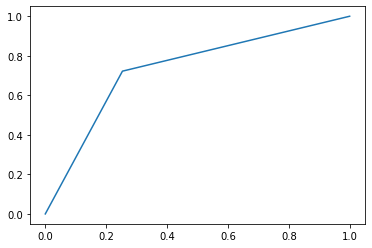

auto threshold


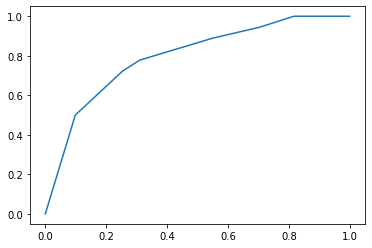

neighbours = 7 err_train = 0.06766917293233082 err_test = 0.4606741573033708
[[32 39]
 [ 2 16]]
Mera F1 Train: 0.4383561643835616
Precision Score Train:  0.5393258426966292
Recall Score Train:  0.5393258426966292
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


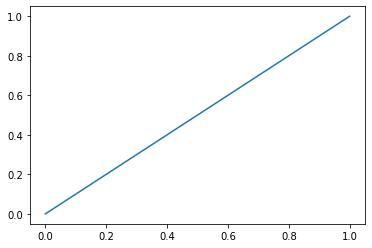

threshold =  0.2


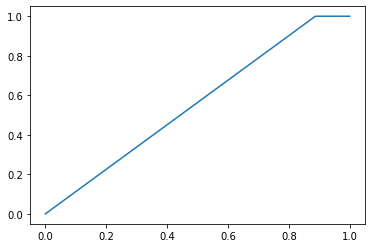

threshold =  0.4


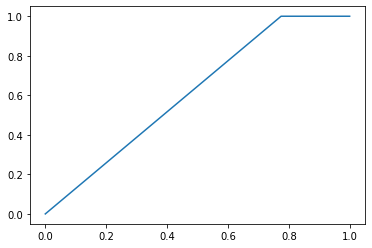

threshold =  0.5


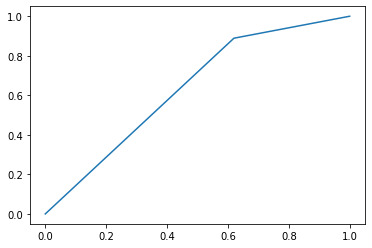

threshold =  0.7


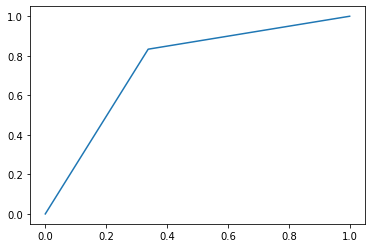

threshold =  0.8


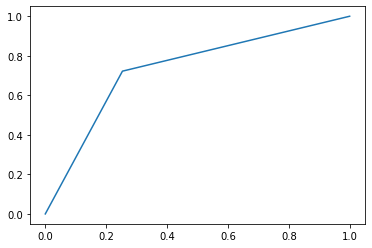

auto threshold


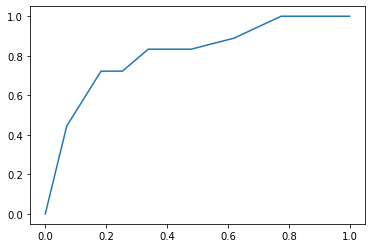

neighbours = 10 err_train = 0.07518796992481203 err_test = 0.4157303370786517
[[37 34]
 [ 3 15]]
Mera F1 Train: 0.44776119402985076
Precision Score Train:  0.5842696629213483
Recall Score Train:  0.5842696629213483
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


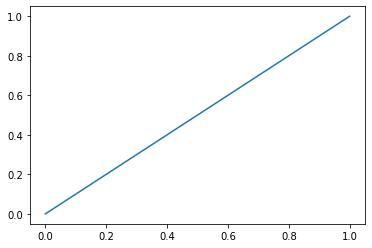

threshold =  0.2


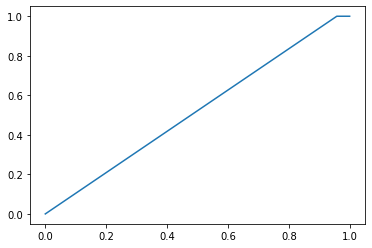

threshold =  0.4


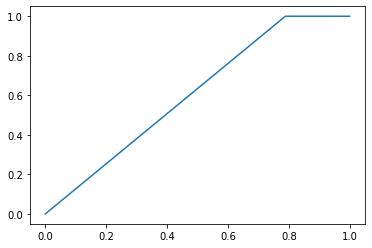

threshold =  0.5


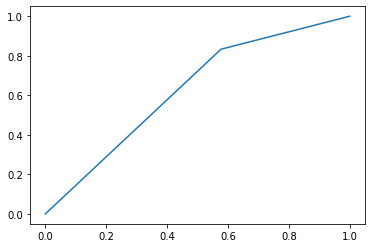

threshold =  0.7


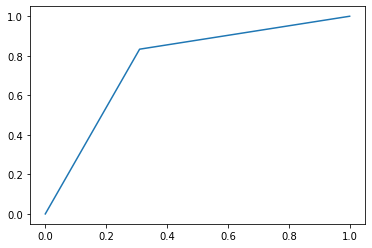

threshold =  0.8


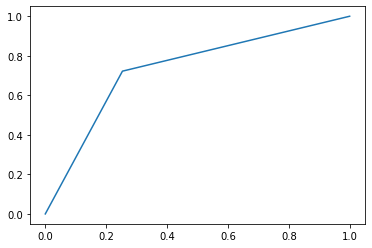

auto threshold


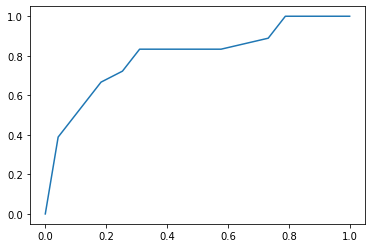

neighbours = 15 err_train = 0.13157894736842105 err_test = 0.4943820224719101
[[30 41]
 [ 3 15]]
Mera F1 Train: 0.4054054054054054
Precision Score Train:  0.5056179775280899
Recall Score Train:  0.5056179775280899
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


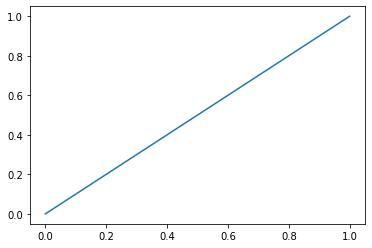

threshold =  0.2


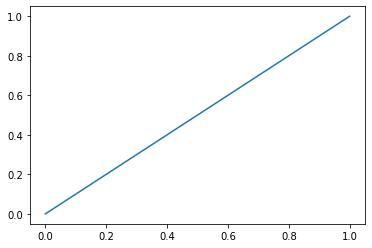

threshold =  0.4


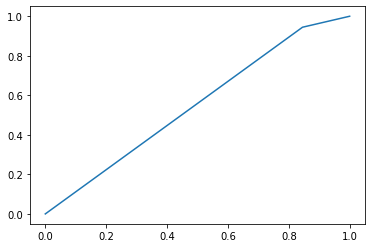

threshold =  0.5


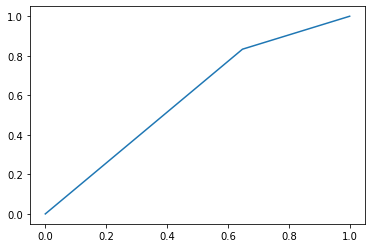

threshold =  0.7


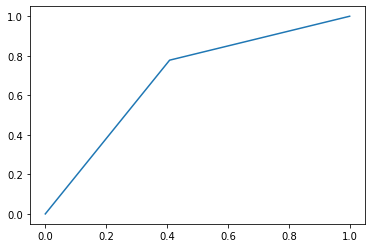

threshold =  0.8


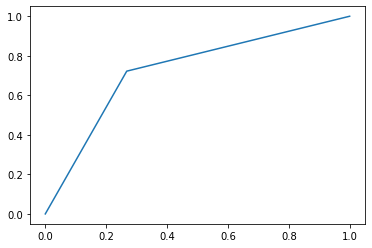

auto threshold


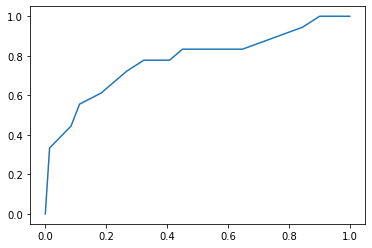

neighbours = 20 err_train = 0.12781954887218044 err_test = 0.4943820224719101
[[30 41]
 [ 3 15]]
Mera F1 Train: 0.4054054054054054
Precision Score Train:  0.5056179775280899
Recall Score Train:  0.5056179775280899
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


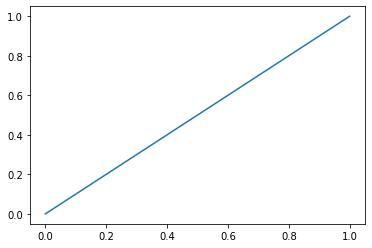

threshold =  0.2


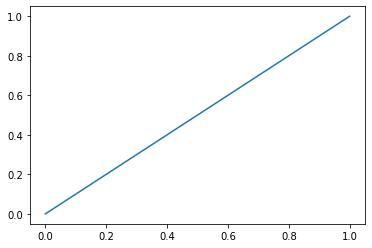

threshold =  0.4


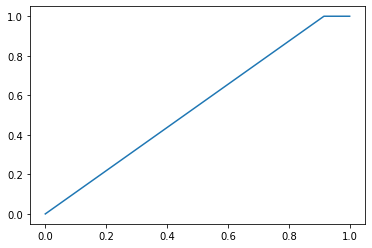

threshold =  0.5


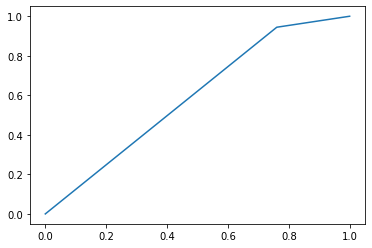

threshold =  0.7


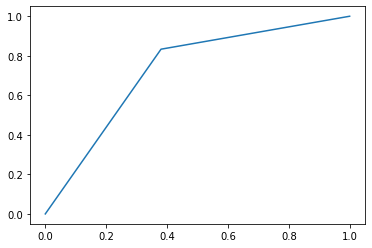

threshold =  0.8


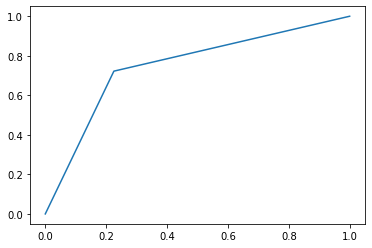

auto threshold


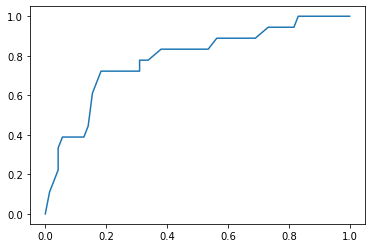

neighbours = 50 err_train = 0.19924812030075187 err_test = 0.5955056179775281
[[19 52]
 [ 1 17]]
Mera F1 Train: 0.39080459770114945
Precision Score Train:  0.4044943820224719
Recall Score Train:  0.4044943820224719


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [184]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[14][i]=err_test
    Knn_train[14][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [185]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[14]= err_test
SVC_train[14]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.06766917293233082 err_test_SVC = 0.30337078651685395


# SMOTETomek

In [186]:
from imblearn.combine import SMOTETomek
smote_tomek = SMOTETomek(random_state=0)
X_resampled, y_resampled = smote_tomek.fit_resample(X_train, y_train_binary)
print(sorted(Counter(y_resampled).items()))

[(0, 174), (1, 174)]


## Knn

threshold =  0.0


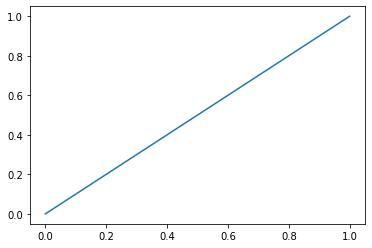

threshold =  0.2


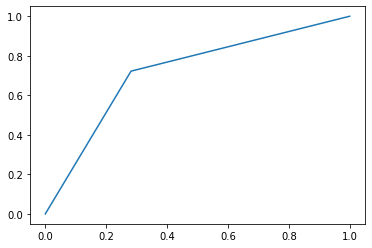

threshold =  0.4


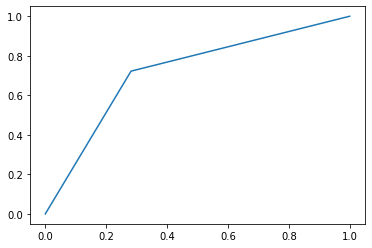

threshold =  0.5


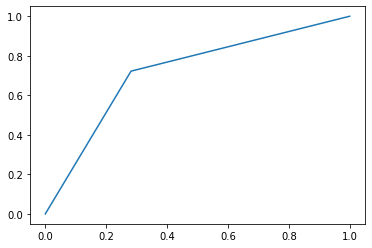

threshold =  0.7


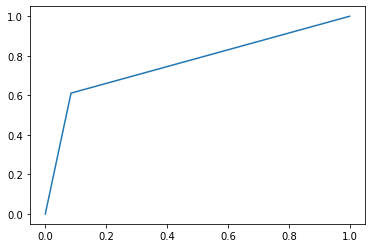

threshold =  0.8


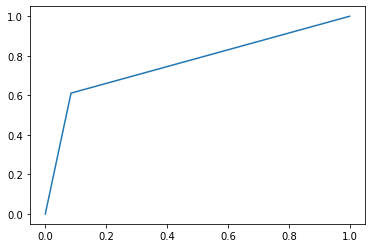

auto threshold


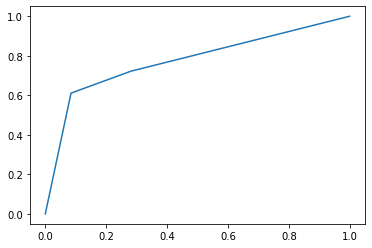

neighbours = 2 err_train = 0.0 err_test = 0.14606741573033707
[[65  6]
 [ 7 11]]
Mera F1 Train: 0.6285714285714287
Precision Score Train:  0.8539325842696629
Recall Score Train:  0.8539325842696629
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


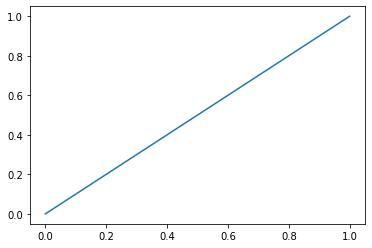

threshold =  0.2


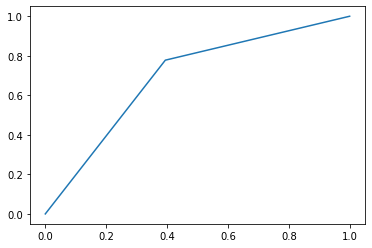

threshold =  0.4


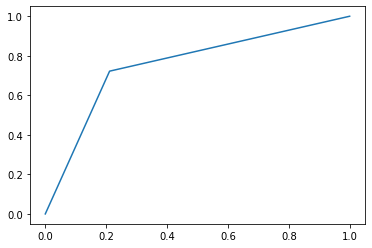

threshold =  0.5


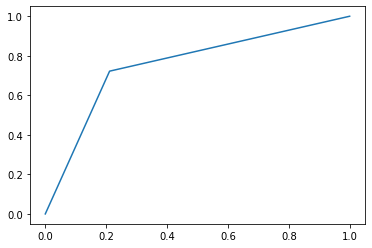

threshold =  0.7


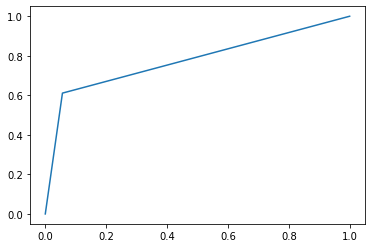

threshold =  0.8


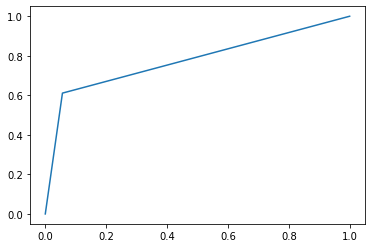

auto threshold


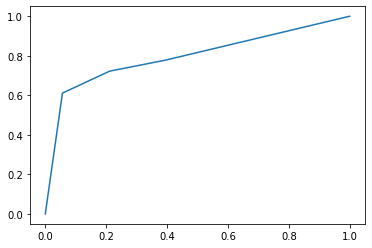

neighbours = 3 err_train = 0.08045977011494253 err_test = 0.2247191011235955
[[56 15]
 [ 5 13]]
Mera F1 Train: 0.5652173913043479
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


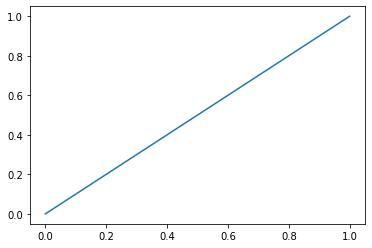

threshold =  0.2


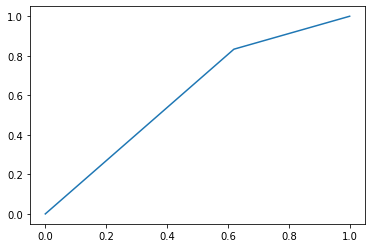

threshold =  0.4


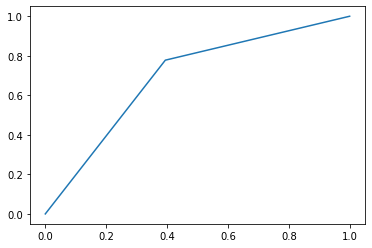

threshold =  0.5


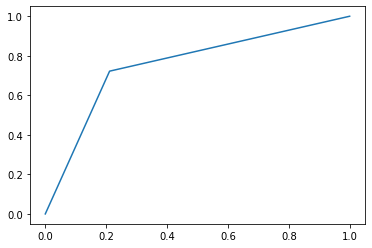

threshold =  0.7


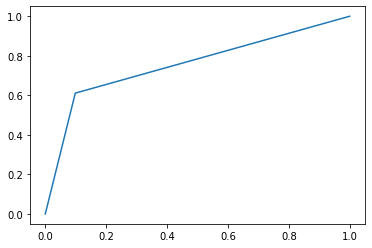

threshold =  0.8


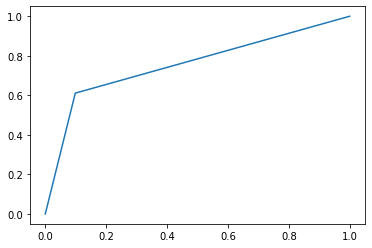

auto threshold


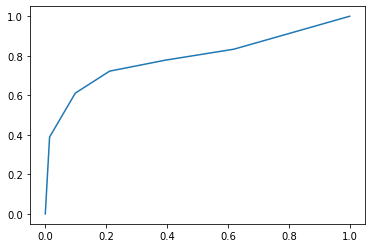

neighbours = 5 err_train = 0.10919540229885058 err_test = 0.2247191011235955
[[56 15]
 [ 5 13]]
Mera F1 Train: 0.5652173913043479
Precision Score Train:  0.7752808988764045
Recall Score Train:  0.7752808988764045
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


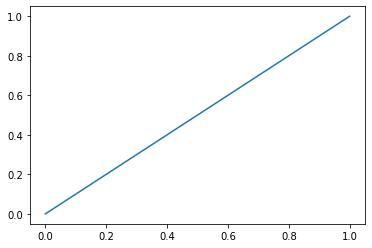

threshold =  0.2


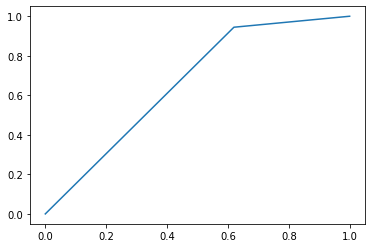

threshold =  0.4


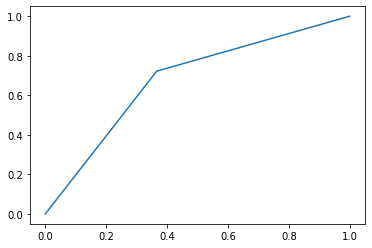

threshold =  0.5


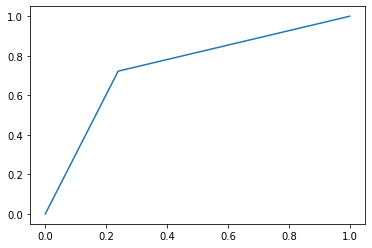

threshold =  0.7


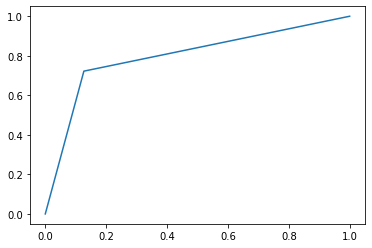

threshold =  0.8


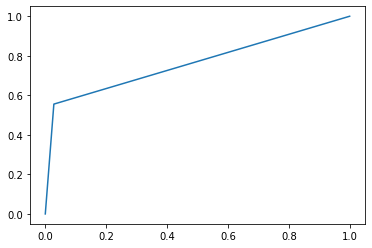

auto threshold


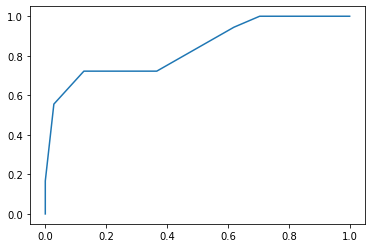

neighbours = 7 err_train = 0.13793103448275862 err_test = 0.24719101123595505
[[54 17]
 [ 5 13]]
Mera F1 Train: 0.5416666666666666
Precision Score Train:  0.7528089887640449
Recall Score Train:  0.7528089887640449
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


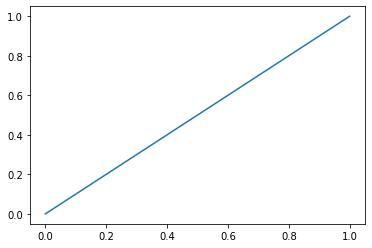

threshold =  0.2


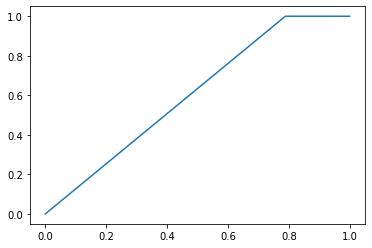

threshold =  0.4


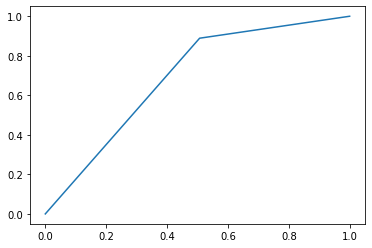

threshold =  0.5


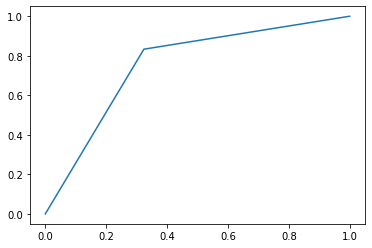

threshold =  0.7


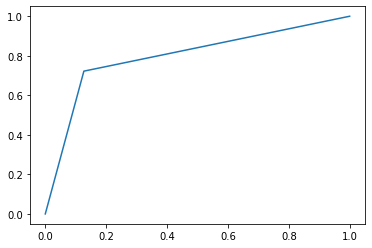

threshold =  0.8


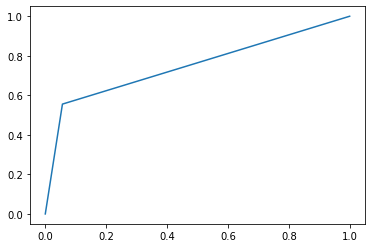

auto threshold


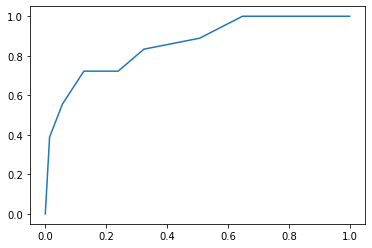

neighbours = 10 err_train = 0.11781609195402298 err_test = 0.24719101123595505
[[54 17]
 [ 5 13]]
Mera F1 Train: 0.5416666666666666
Precision Score Train:  0.7528089887640449
Recall Score Train:  0.7528089887640449
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


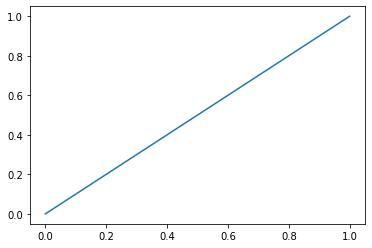

threshold =  0.2


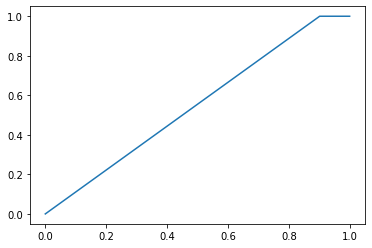

threshold =  0.4


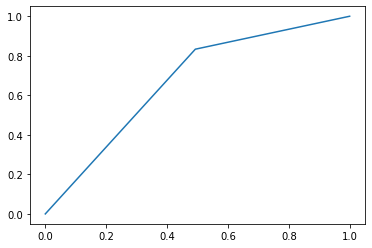

threshold =  0.5


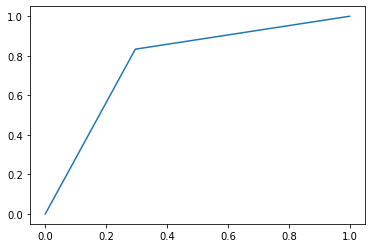

threshold =  0.7


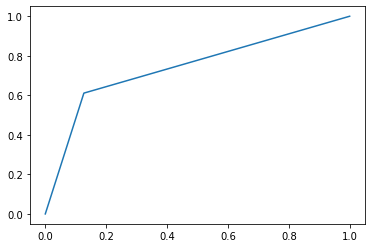

threshold =  0.8


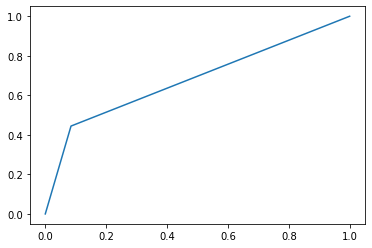

auto threshold


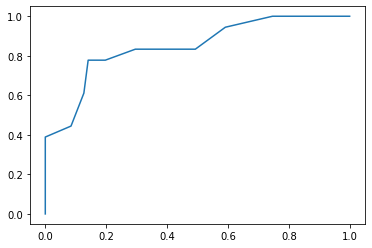

neighbours = 15 err_train = 0.14655172413793102 err_test = 0.2696629213483146
[[50 21]
 [ 3 15]]
Mera F1 Train: 0.5555555555555556
Precision Score Train:  0.7303370786516854
Recall Score Train:  0.7303370786516854
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


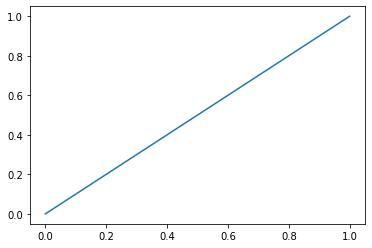

threshold =  0.2


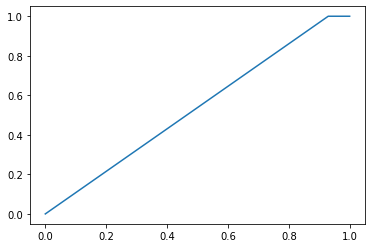

threshold =  0.4


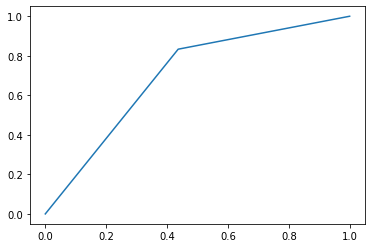

threshold =  0.5


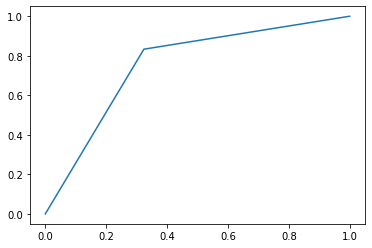

threshold =  0.7


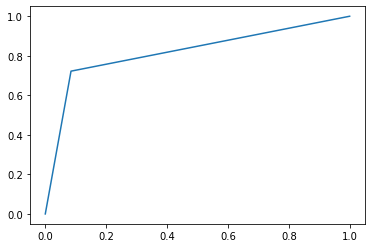

threshold =  0.8


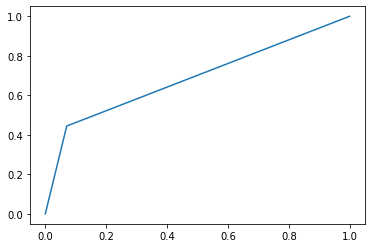

auto threshold


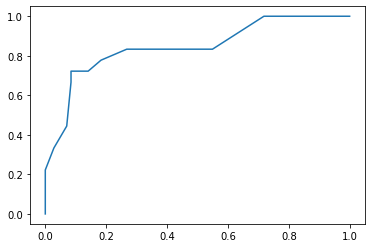

neighbours = 20 err_train = 0.14655172413793102 err_test = 0.24719101123595505
[[52 19]
 [ 3 15]]
Mera F1 Train: 0.576923076923077
Precision Score Train:  0.7528089887640449
Recall Score Train:  0.7528089887640449
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


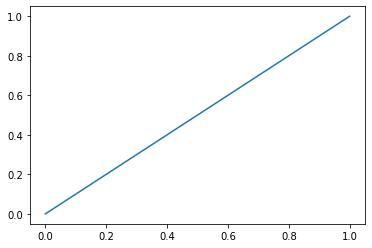

threshold =  0.2


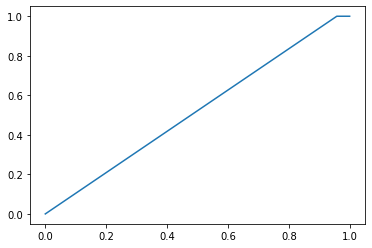

threshold =  0.4


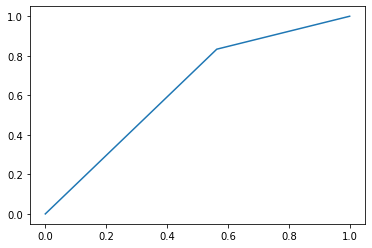

threshold =  0.5


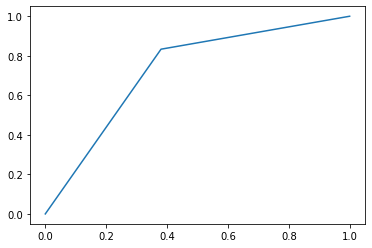

threshold =  0.7


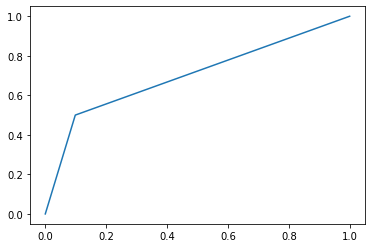

threshold =  0.8


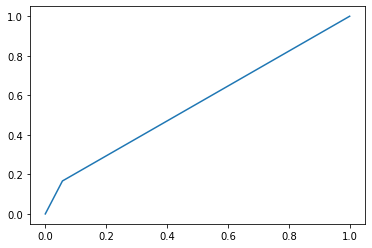

auto threshold


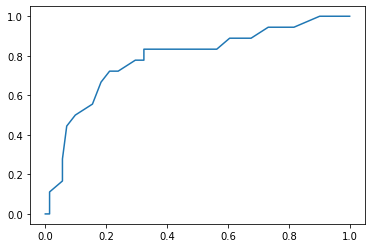

neighbours = 50 err_train = 0.20114942528735633 err_test = 0.3258426966292135
[[45 26]
 [ 3 15]]
Mera F1 Train: 0.5084745762711864
Precision Score Train:  0.6741573033707865
Recall Score Train:  0.6741573033707865


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [187]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (8):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test_binary  != y_test_predict)
    Knn_test[15][i]=err_test
    Knn_train[15][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test_binary,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test_binary,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test_binary,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test_binary, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [188]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test_binary != svc_model.predict(X_test))
SVC_test[15]= err_test
SVC_train[15]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.04310344827586207 err_test_SVC = 0.12359550561797752


In [189]:
print('Test Err in Knn')
print("%-31s"%('Method'),'|',"%-7s"%('n = 2'),'|',"%-7s"%('n = 3'),'|',"%-7s"%('n = 5'),'|',"%-7s"%('n = 7'),'|',"%-7s"%('n = 10'),'|',"%-7s"%('n = 15'),'|',"%-7s"%('n = 20'),'|',"%-7s"%('n = 50'),'|',"%-7s"%('n = 100'))
for i in range(16):
    print("%-31s"%(methods[i]),'|',"%.5f"%(Knn_test[i][0]),'|',"%.5f"%(Knn_test[i][1]),'|',"%.5f"%(Knn_test[i][2]),'|',"%.5f"%(Knn_test[i][3]),'|',"%.5f"%(Knn_test[i][4]),'|',"%.5f"%(Knn_test[i][5]),'|',"%.5f"%(Knn_test[i][6]),'|',"%.5f"%(Knn_test[i][7]),'|',"%.5f"%(Knn_test[i][8]))

Test Err in Knn
Method                          | n = 2   | n = 3   | n = 5   | n = 7   | n = 10  | n = 15  | n = 20  | n = 50  | n = 100
Naive                           | 0.17978 | 0.13483 | 0.14607 | 0.20225 | 0.21348 | 0.20225 | 0.12360 | 0.15730 | 0.13483
SMOTE                           | 0.15730 | 0.20225 | 0.21348 | 0.26966 | 0.20225 | 0.25843 | 0.25843 | 0.31461 | 0.33708
BorderlineSMOTE                 | 0.11236 | 0.15730 | 0.16854 | 0.19101 | 0.19101 | 0.22472 | 0.22472 | 0.32584 | 0.32584
ADASYN                          | 0.13483 | 0.24719 | 0.23596 | 0.31461 | 0.30337 | 0.35955 | 0.33708 | 0.44944 | 0.42697
ClusterCentroids                | 0.19101 | 0.17978 | 0.15730 | 0.17978 | 0.19101 | 0.16854 | 0.19101 | 0.22472 | 0.00000
RandomUnderSampler              | 0.16854 | 0.20225 | 0.22472 | 0.20225 | 0.19101 | 0.16854 | 0.15730 | 0.19101 | 0.00000
NearMiss                        | 0.16854 | 0.16854 | 0.17978 | 0.15730 | 0.20225 | 0.17978 | 0.20225 | 0.20225 | 0.00000
EditedNe

In [190]:
print('Train Err in Knn')
print("%-31s"%('Method'),'|',"%-7s"%('n = 2'),'|',"%-7s"%('n = 3'),'|',"%-7s"%('n = 5'),'|',"%-7s"%('n = 7'),'|',"%-7s"%('n = 10'),'|',"%-7s"%('n = 15'),'|',"%-7s"%('n = 20'),'|',"%-7s"%('n = 50'),'|',"%-7s"%('n = 100'))
for i in range(16):
    print("%-31s"%(methods[i]),'|',"%.5f"%(Knn_train[i][0]),'|',"%.5f"%(Knn_train[i][1]),'|',"%.5f"%(Knn_train[i][2]),'|',"%.5f"%(Knn_train[i][3]),'|',"%.5f"%(Knn_train[i][4]),'|',"%.5f"%(Knn_train[i][5]),'|',"%.5f"%(Knn_train[i][6]),'|',"%.5f"%(Knn_train[i][7]),'|',"%.5f"%(Knn_train[i][8]))

Train Err in Knn
Method                          | n = 2   | n = 3   | n = 5   | n = 7   | n = 10  | n = 15  | n = 20  | n = 50  | n = 100
Naive                           | 0.00287 | 0.02586 | 0.06322 | 0.09770 | 0.11782 | 0.10632 | 0.15805 | 0.15517 | 0.11782
SMOTE                           | 0.00287 | 0.06897 | 0.10345 | 0.13218 | 0.11494 | 0.15517 | 0.14368 | 0.18391 | 0.19253
BorderlineSMOTE                 | 0.00575 | 0.06034 | 0.08333 | 0.09195 | 0.09770 | 0.13218 | 0.12069 | 0.14943 | 0.18391
ADASYN                          | 0.00000 | 0.08406 | 0.12464 | 0.15942 | 0.15942 | 0.20870 | 0.18841 | 0.22609 | 0.26087
ClusterCentroids                | 0.23438 | 0.17188 | 0.23438 | 0.28125 | 0.32812 | 0.23438 | 0.28125 | 0.21875 | 0.00000
RandomUnderSampler              | 0.23438 | 0.15625 | 0.21875 | 0.23438 | 0.23438 | 0.21875 | 0.21875 | 0.40625 | 0.00000
NearMiss                        | 0.29688 | 0.17188 | 0.26562 | 0.29688 | 0.39062 | 0.37500 | 0.43750 | 0.50000 | 0.00000
EditedN

In [191]:
print('Errors in SVC')
print("%-31s"%('Method'),'|',"{:^10}".format('Train'),'|',"{:^10}".format('Test'),'|')
for i in range(16):
    print("%-31s"%(methods[i]),'|',"%.8f"%(SVC_train[i]),'|',"%.8f"%(SVC_test[i]),'|')


Errors in SVC
Method                          |   Train    |    Test    |
Naive                           | 0.03448276 | 0.08988764 |
SMOTE                           | 0.05459770 | 0.11235955 |
BorderlineSMOTE                 | 0.03735632 | 0.11235955 |
ADASYN                          | 0.06956522 | 0.12359551 |
ClusterCentroids                | 0.06250000 | 0.15730337 |
RandomUnderSampler              | 0.12500000 | 0.08988764 |
NearMiss                        | 0.17187500 | 0.12359551 |
EditedNearestNeighbours         | 0.14970060 | 0.17977528 |
RepeatedEditedNearestNeighbours | 0.14379085 | 0.19101124 |
AllKNN                          | 0.15432099 | 0.17977528 |
CondensedNearestNeighbour       | 0.25301205 | 0.17977528 |
OneSidedSelection               | 0.12903226 | 0.20224719 |
NeighbourhoodCleaningRule       | 0.14906832 | 0.17977528 |
Instance hardness threshold     | 0.06250000 | 0.29213483 |
SMOTEENN                        | 0.06766917 | 0.30337079 |
SMOTETomek                

## All Data

In [192]:
methods=['Naive',
         'SMOTE',
         'BorderlineSMOTE',
         'ADASYN',
         'ClusterCentroids',
         'RandomUnderSampler',
         'NearMiss',
         'EditedNearestNeighbours',
         'RepeatedEditedNearestNeighbours',
         'AllKNN',
         'CondensedNearestNeighbour',
         'OneSidedSelection',
         'NeighbourhoodCleaningRule',
         'Instance hardness threshold',
         'SMOTEENN',
         'SMOTETomek']
Knn_test=[[0]*9 for j in range(16)]
Knn_train=[[0]*9 for j in range(16)]
SVC_test=[0]*16
SVC_train=[0]*16

In [193]:
X = data_raw.drop('diagnosis', axis = 1)
y = data_raw['diagnosis']

In [194]:
y = np.array(y != 1, dtype='int')
X = X.to_numpy()

In [195]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

# Naive

In [196]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_resampled, y_resampled = ros.fit_resample(X_train, y_train)
from collections import Counter
print(sorted(Counter(y_resampled).items()))

[(0, 176), (1, 176)]


## Knn

threshold =  0.0


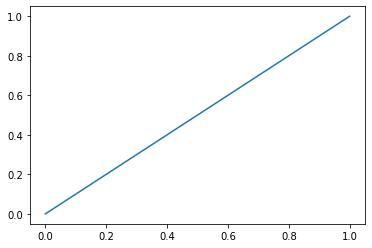

threshold =  0.2


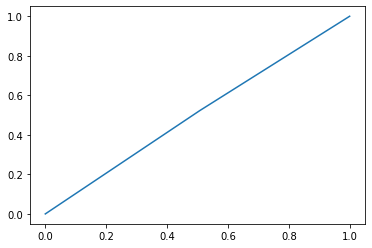

threshold =  0.4


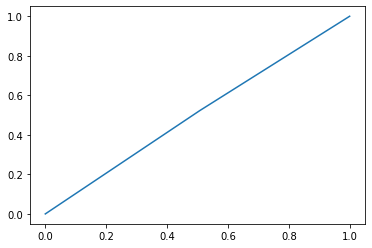

threshold =  0.5


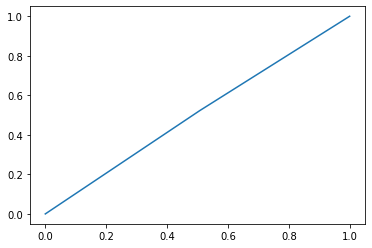

threshold =  0.7


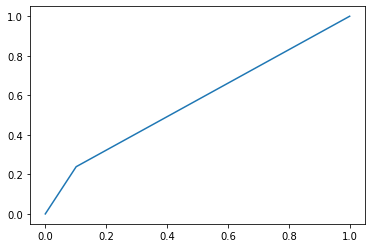

threshold =  0.8


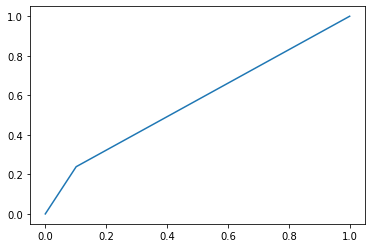

auto threshold


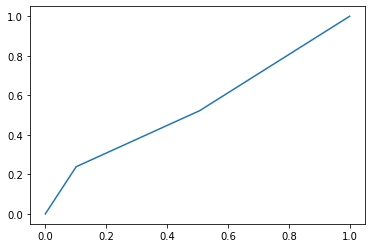

neighbours = 2 err_train = 0.1590909090909091 err_test = 0.4264705882352941
[[62  7]
 [51 16]]
Mera F1 Train: 0.3555555555555555
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


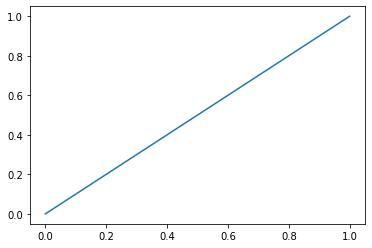

threshold =  0.2


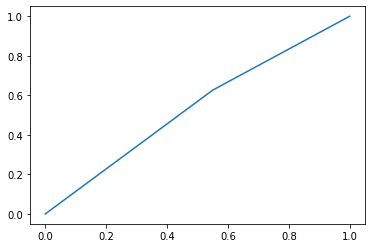

threshold =  0.4


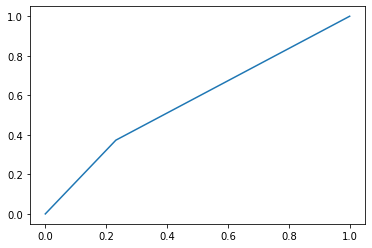

threshold =  0.5


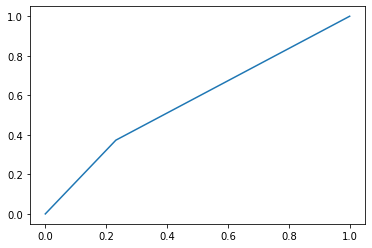

threshold =  0.7


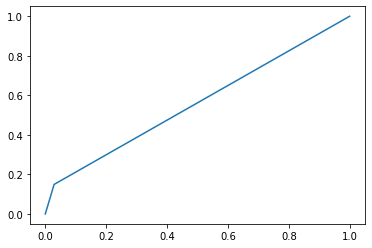

threshold =  0.8


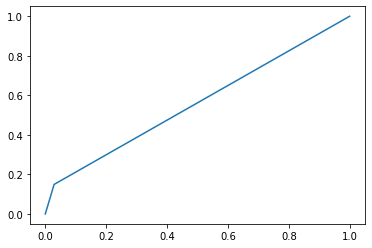

auto threshold


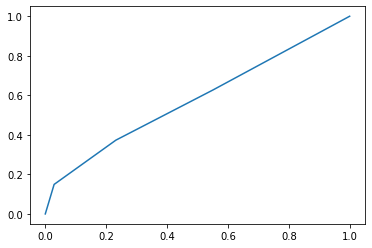

neighbours = 3 err_train = 0.15056818181818182 err_test = 0.4264705882352941
[[53 16]
 [42 25]]
Mera F1 Train: 0.4629629629629629
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


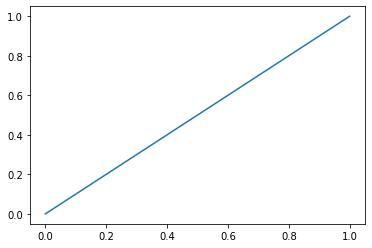

threshold =  0.2


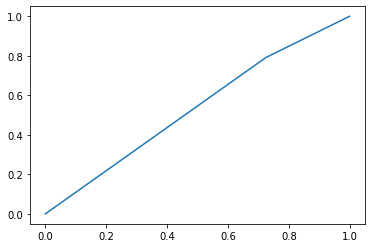

threshold =  0.4


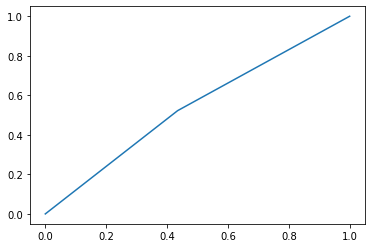

threshold =  0.5


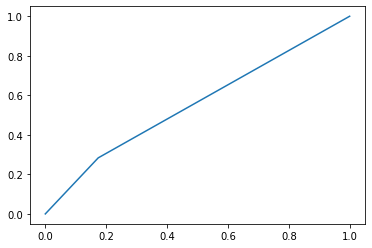

threshold =  0.7


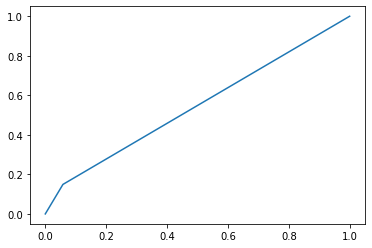

threshold =  0.8


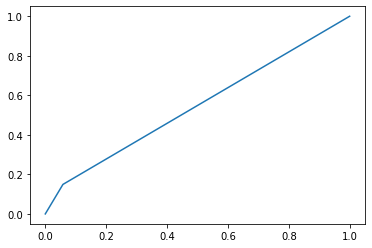

auto threshold


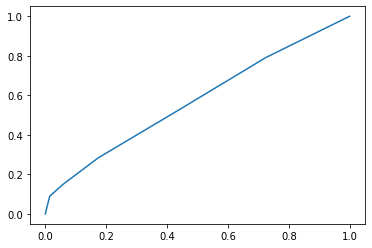

neighbours = 5 err_train = 0.1846590909090909 err_test = 0.4411764705882353
[[57 12]
 [48 19]]
Mera F1 Train: 0.38775510204081626
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


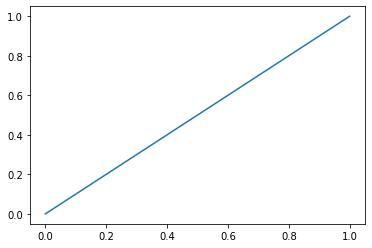

threshold =  0.2


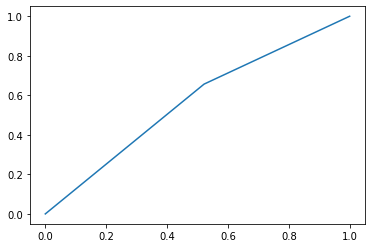

threshold =  0.4


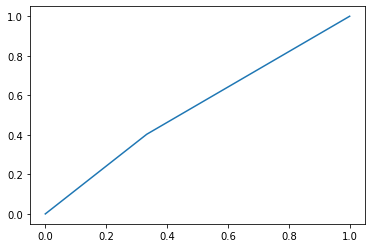

threshold =  0.5


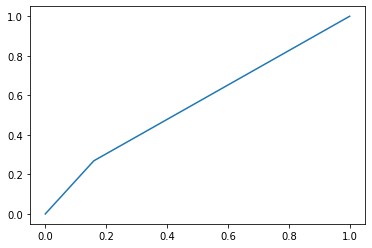

threshold =  0.7


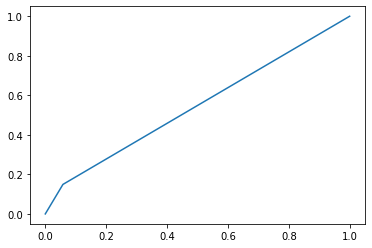

threshold =  0.8


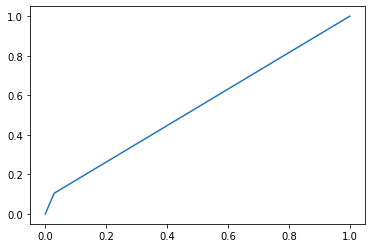

auto threshold


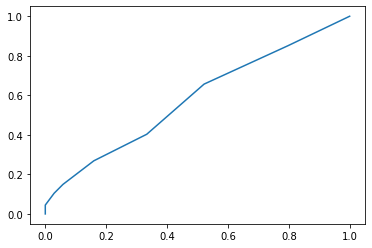

neighbours = 7 err_train = 0.2159090909090909 err_test = 0.4411764705882353
[[58 11]
 [49 18]]
Mera F1 Train: 0.37500000000000006
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


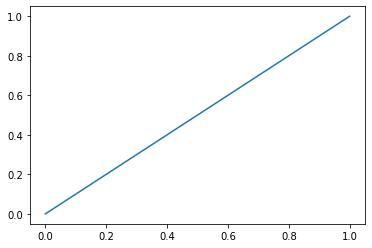

threshold =  0.2


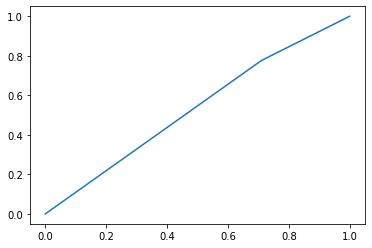

threshold =  0.4


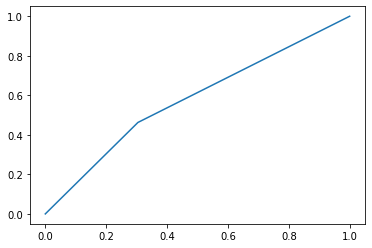

threshold =  0.5


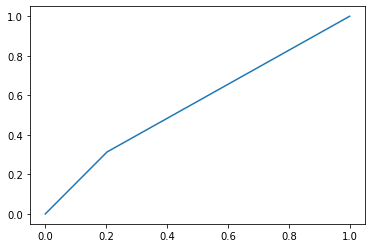

threshold =  0.7


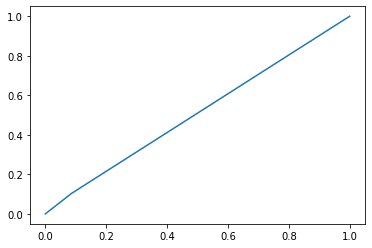

threshold =  0.8


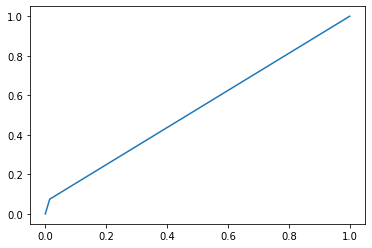

auto threshold


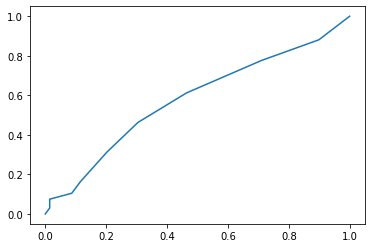

neighbours = 10 err_train = 0.2869318181818182 err_test = 0.47058823529411764
[[61  8]
 [56 11]]
Mera F1 Train: 0.2558139534883721
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


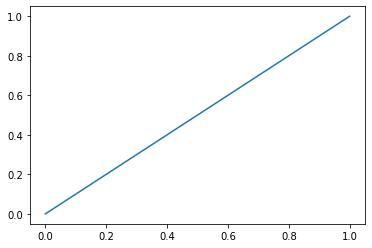

threshold =  0.2


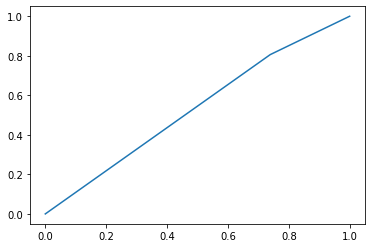

threshold =  0.4


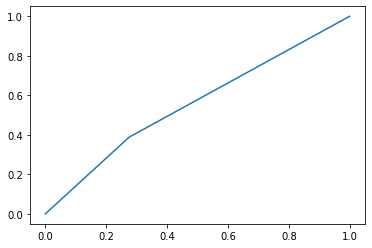

threshold =  0.5


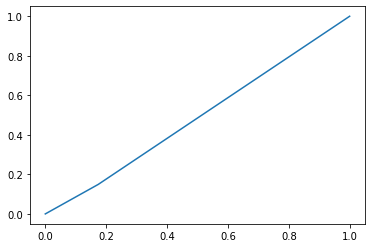

threshold =  0.7


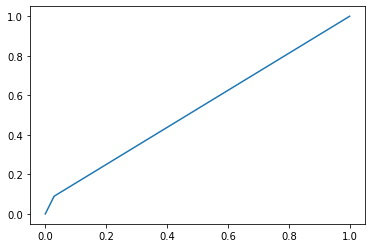

threshold =  0.8


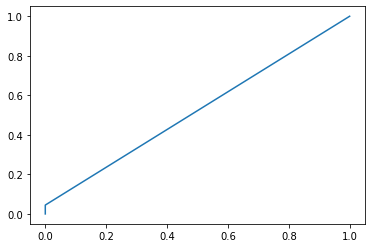

auto threshold


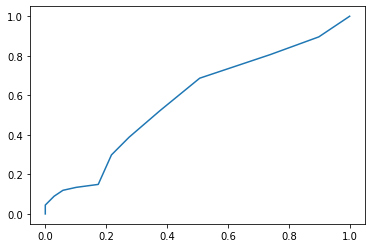

neighbours = 15 err_train = 0.29545454545454547 err_test = 0.5073529411764706
[[57 12]
 [57 10]]
Mera F1 Train: 0.22471910112359547
Precision Score Train:  0.49264705882352944
Recall Score Train:  0.49264705882352944
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


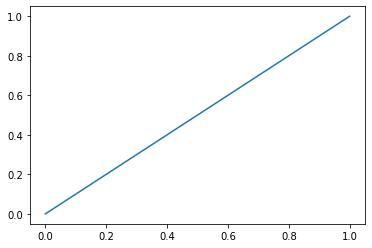

threshold =  0.2


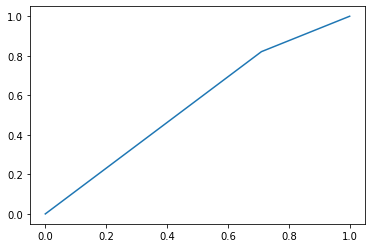

threshold =  0.4


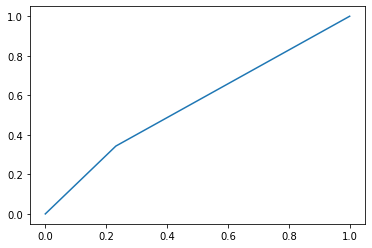

threshold =  0.5


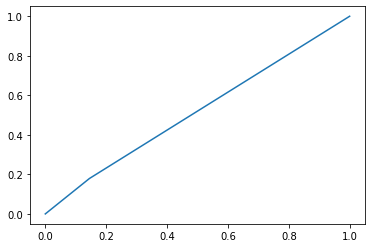

threshold =  0.7


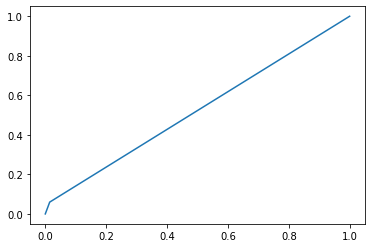

threshold =  0.8


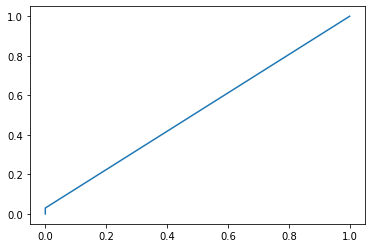

auto threshold


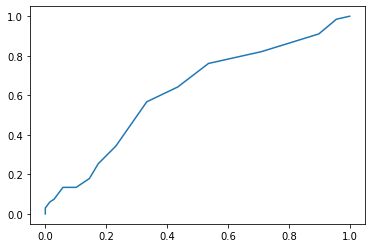

neighbours = 20 err_train = 0.3494318181818182 err_test = 0.47794117647058826
[[62  7]
 [58  9]]
Mera F1 Train: 0.21686746987951808
Precision Score Train:  0.5220588235294118
Recall Score Train:  0.5220588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


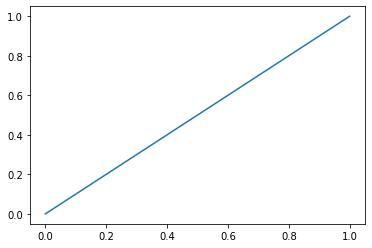

threshold =  0.2


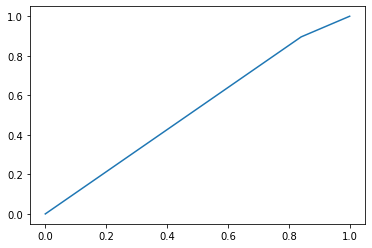

threshold =  0.4


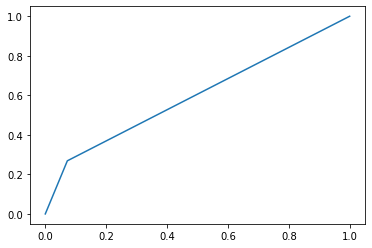

threshold =  0.5


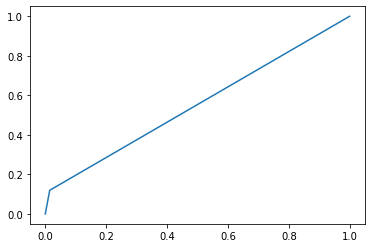

threshold =  0.7


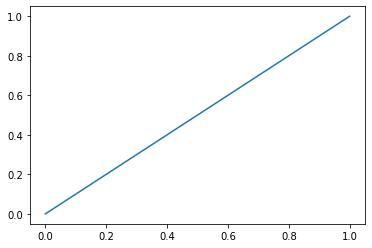

threshold =  0.8


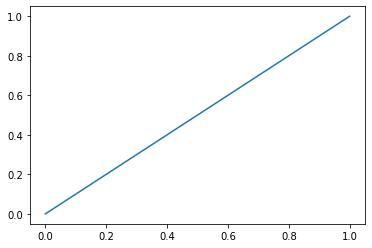

auto threshold


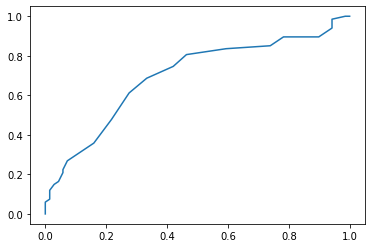

neighbours = 50 err_train = 0.4346590909090909 err_test = 0.4632352941176471
[[68  1]
 [62  5]]
Mera F1 Train: 0.136986301369863
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


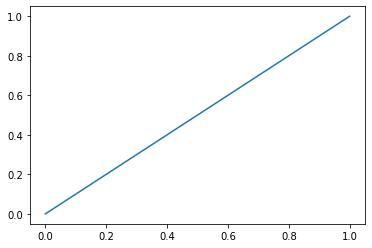

threshold =  0.2


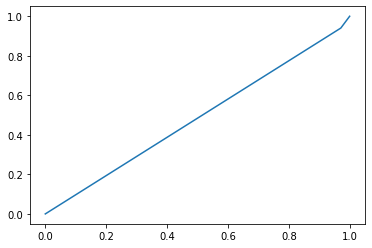

threshold =  0.4


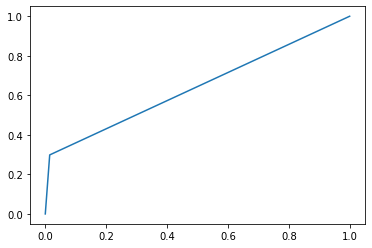

threshold =  0.5


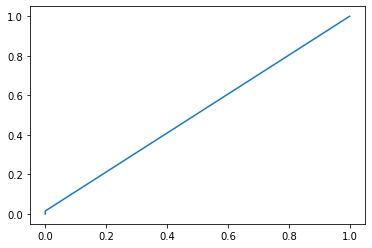

threshold =  0.7


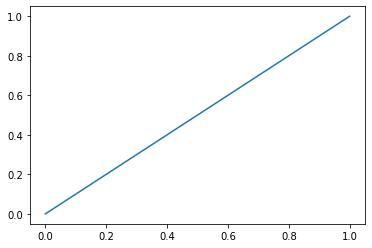

threshold =  0.8


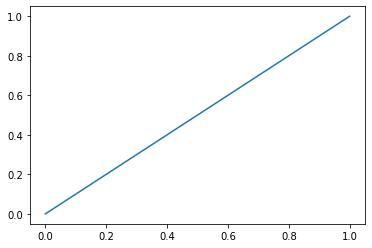

auto threshold


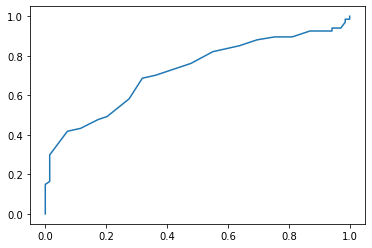

neighbours = 100 err_train = 0.48579545454545453 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [197]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[0][i]=err_test
    Knn_train[0][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [198]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[0]= err_test
SVC_train[0]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.20170454545454544 err_test_SVC = 0.3088235294117647


# SMOTE

In [199]:
from imblearn.over_sampling import SMOTE
X_resampled, y_resampled = SMOTE().fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 176), (1, 176)]


## Knn

threshold =  0.0


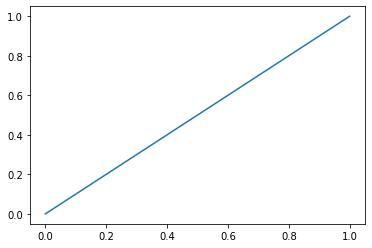

threshold =  0.2


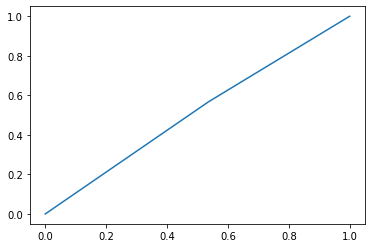

threshold =  0.4


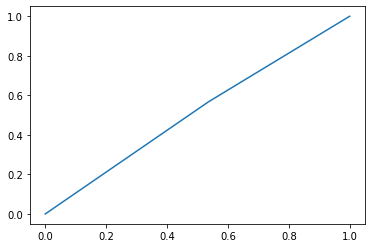

threshold =  0.5


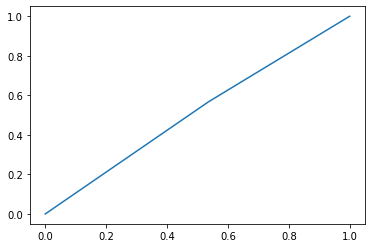

threshold =  0.7


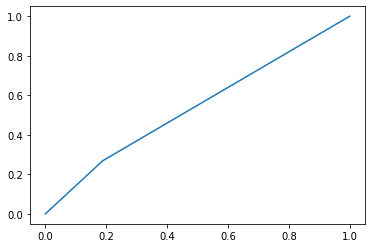

threshold =  0.8


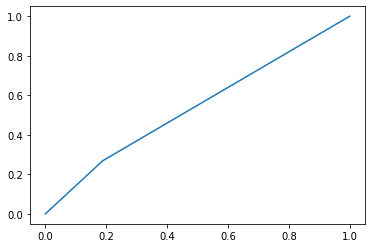

auto threshold


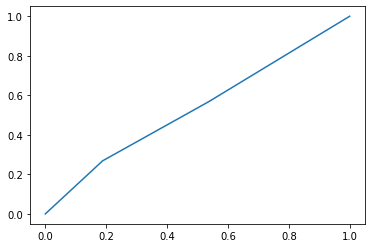

neighbours = 2 err_train = 0.12215909090909091 err_test = 0.45588235294117646
[[56 13]
 [49 18]]
Mera F1 Train: 0.3673469387755102
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


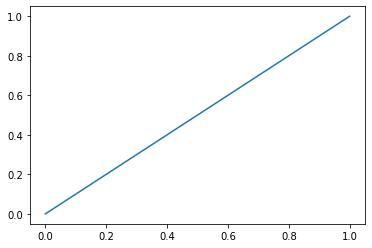

threshold =  0.2


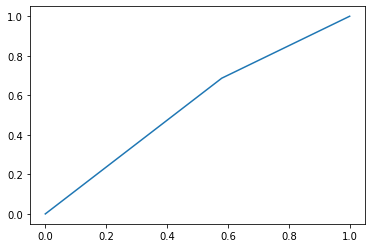

threshold =  0.4


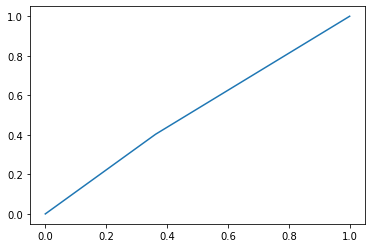

threshold =  0.5


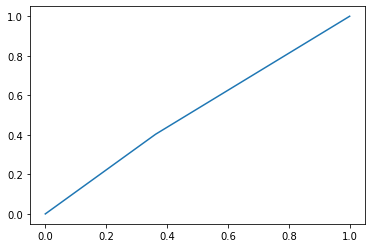

threshold =  0.7


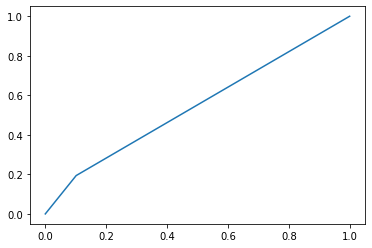

threshold =  0.8


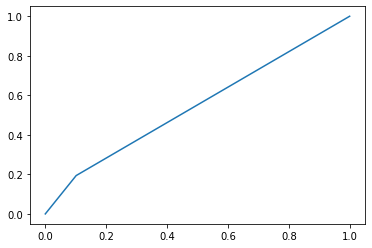

auto threshold


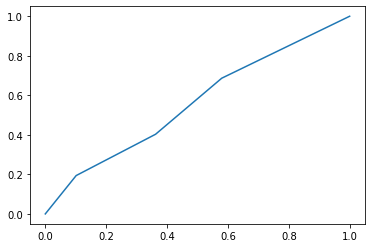

neighbours = 3 err_train = 0.13068181818181818 err_test = 0.47794117647058826
[[44 25]
 [40 27]]
Mera F1 Train: 0.45378151260504207
Precision Score Train:  0.5220588235294118
Recall Score Train:  0.5220588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


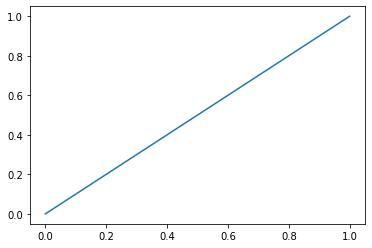

threshold =  0.2


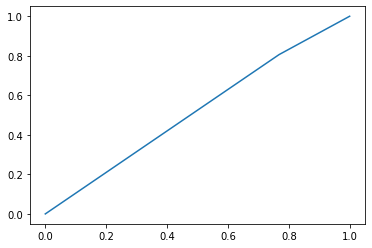

threshold =  0.4


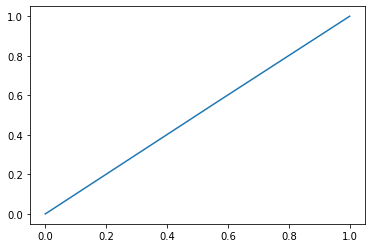

threshold =  0.5


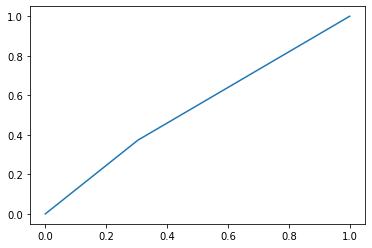

threshold =  0.7


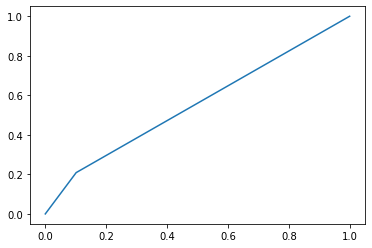

threshold =  0.8


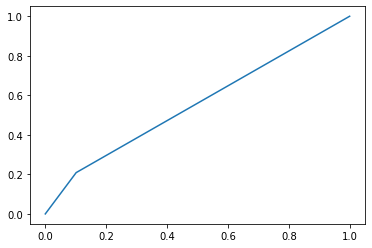

auto threshold


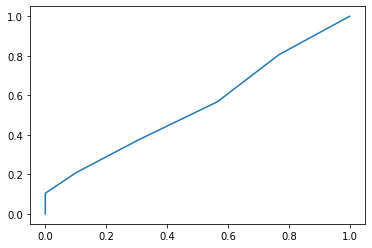

neighbours = 5 err_train = 0.17897727272727273 err_test = 0.4632352941176471
[[48 21]
 [42 25]]
Mera F1 Train: 0.4424778761061947
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


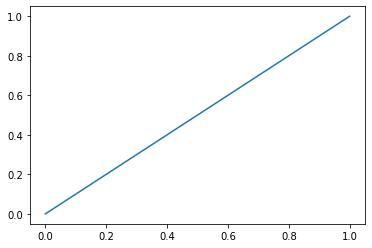

threshold =  0.2


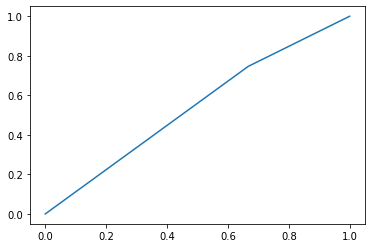

threshold =  0.4


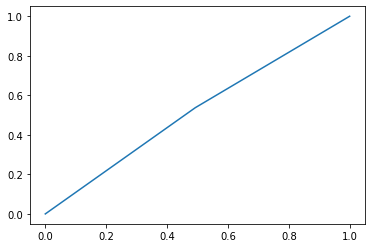

threshold =  0.5


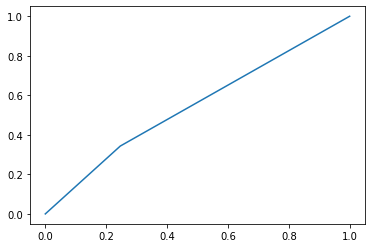

threshold =  0.7


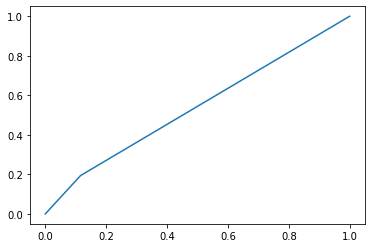

threshold =  0.8


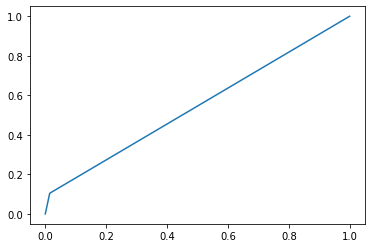

auto threshold


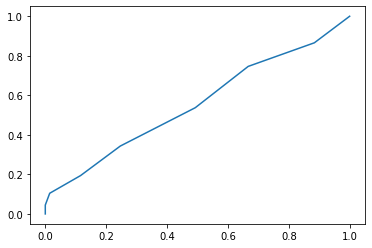

neighbours = 7 err_train = 0.21022727272727273 err_test = 0.4485294117647059
[[52 17]
 [44 23]]
Mera F1 Train: 0.4299065420560747
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


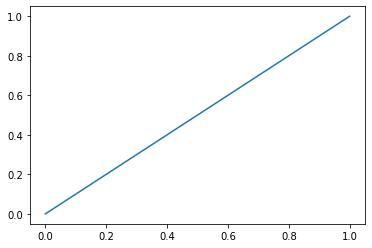

threshold =  0.2


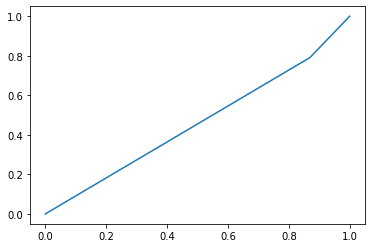

threshold =  0.4


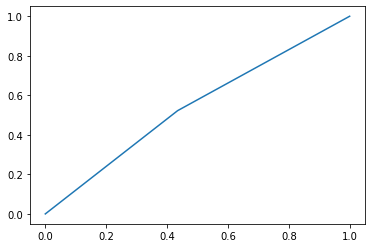

threshold =  0.5


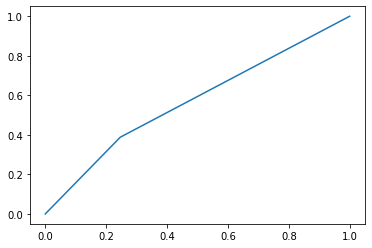

threshold =  0.7


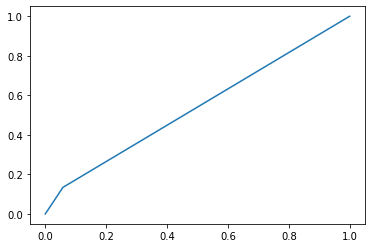

threshold =  0.8


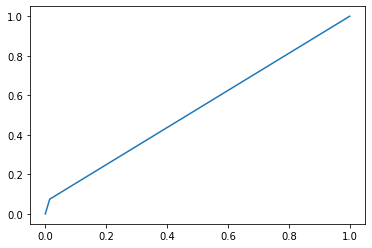

auto threshold


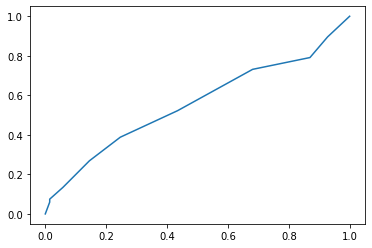

neighbours = 10 err_train = 0.29545454545454547 err_test = 0.4338235294117647
[[59 10]
 [49 18]]
Mera F1 Train: 0.37894736842105264
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


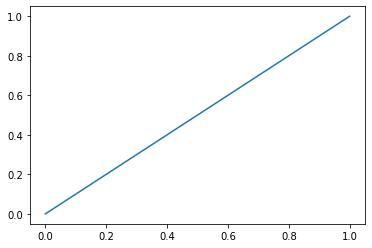

threshold =  0.2


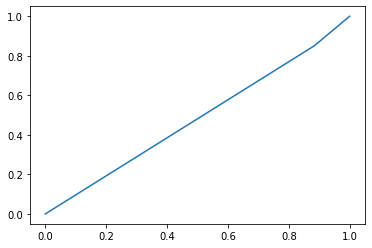

threshold =  0.4


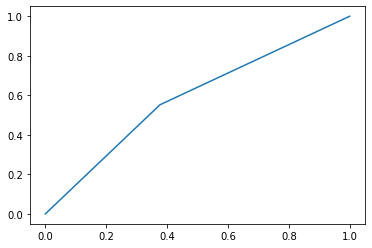

threshold =  0.5


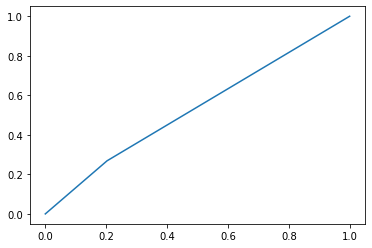

threshold =  0.7


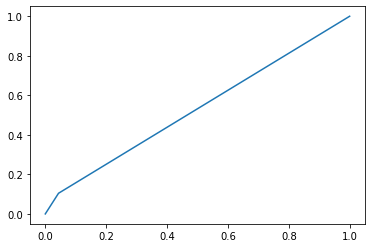

threshold =  0.8


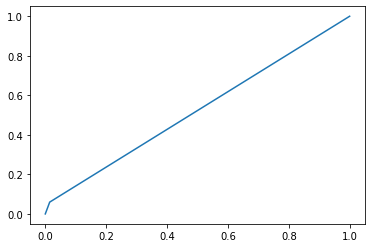

auto threshold


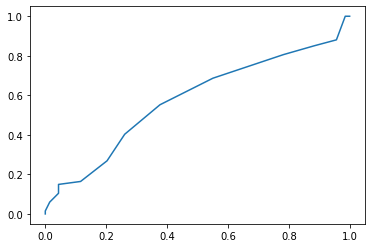

neighbours = 15 err_train = 0.29829545454545453 err_test = 0.4632352941176471
[[55 14]
 [49 18]]
Mera F1 Train: 0.3636363636363636
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


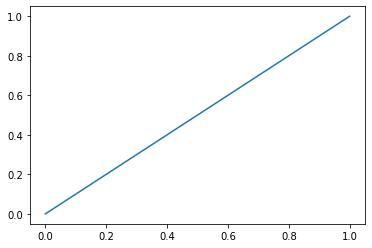

threshold =  0.2


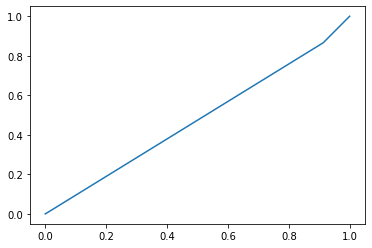

threshold =  0.4


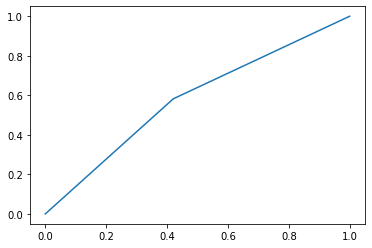

threshold =  0.5


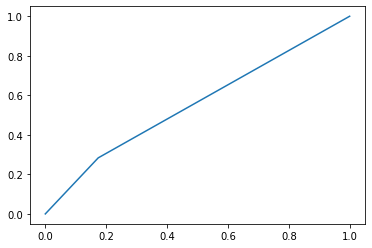

threshold =  0.7


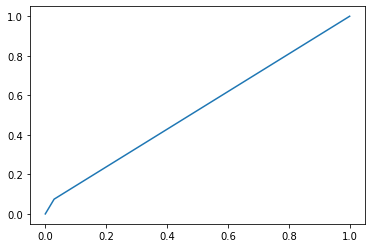

threshold =  0.8


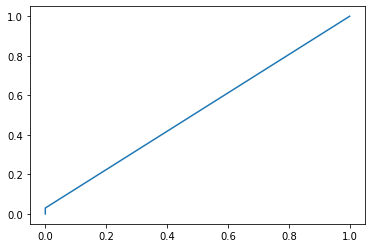

auto threshold


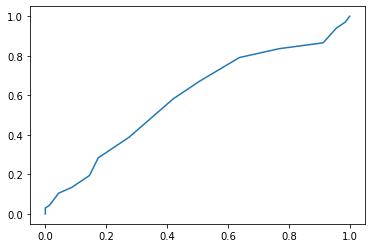

neighbours = 20 err_train = 0.3352272727272727 err_test = 0.47058823529411764
[[59 10]
 [54 13]]
Mera F1 Train: 0.28888888888888886
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


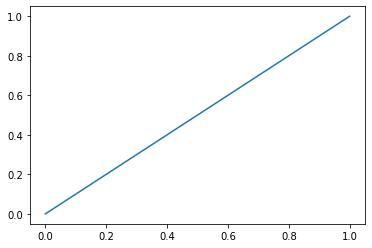

threshold =  0.2


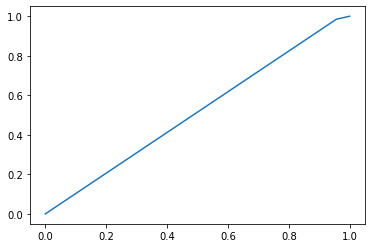

threshold =  0.4


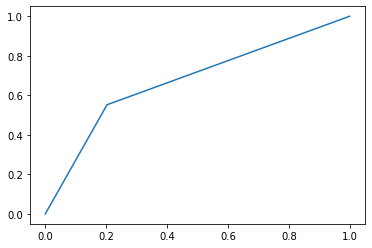

threshold =  0.5


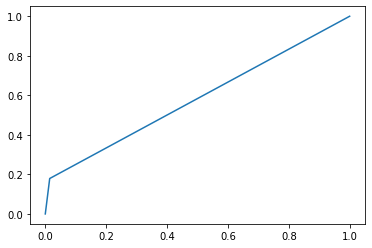

threshold =  0.7


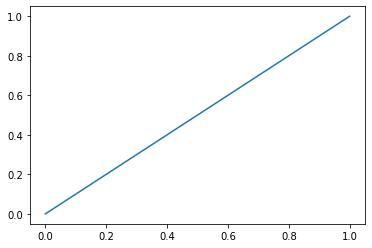

threshold =  0.8


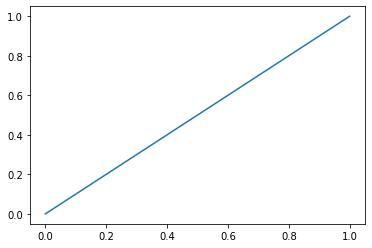

auto threshold


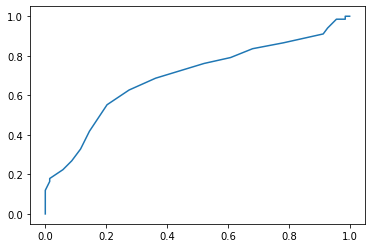

neighbours = 50 err_train = 0.4119318181818182 err_test = 0.41911764705882354
[[68  1]
 [56 11]]
Mera F1 Train: 0.2784810126582279
Precision Score Train:  0.5808823529411765
Recall Score Train:  0.5808823529411765
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


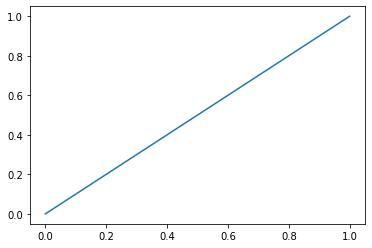

threshold =  0.2


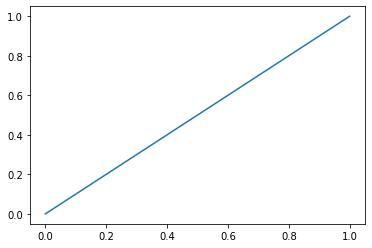

threshold =  0.4


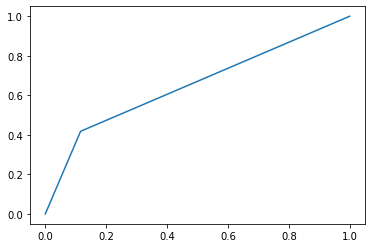

threshold =  0.5


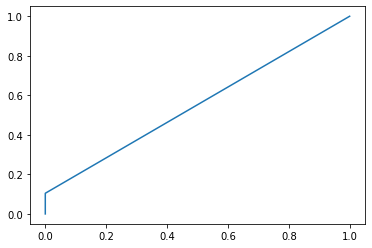

threshold =  0.7


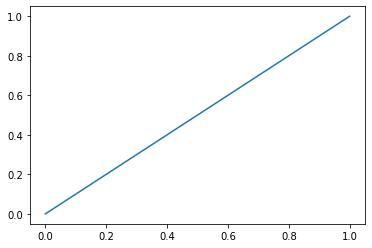

threshold =  0.8


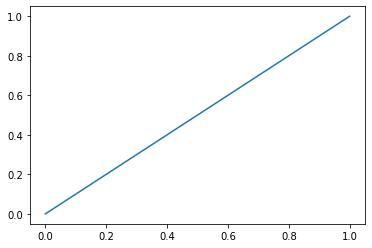

auto threshold


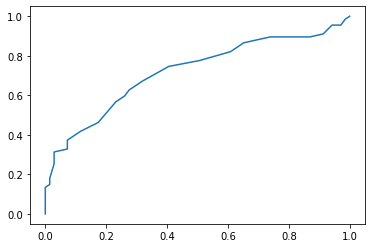

neighbours = 100 err_train = 0.45738636363636365 err_test = 0.45588235294117646
[[69  0]
 [62  5]]
Mera F1 Train: 0.13888888888888887
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [200]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[1][i]=err_test
    Knn_train[1][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [201]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[1]= err_test
SVC_train[1]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.2471590909090909 err_test_SVC = 0.29411764705882354


# BorderlineSMOTE

In [202]:
from imblearn.over_sampling import BorderlineSMOTE
X_resampled, y_resampled = BorderlineSMOTE().fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 176), (1, 176)]


## Knn

threshold =  0.0


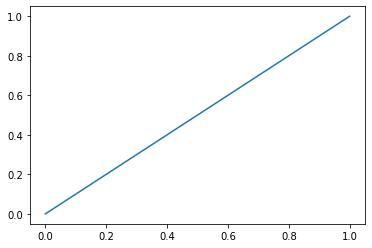

threshold =  0.2


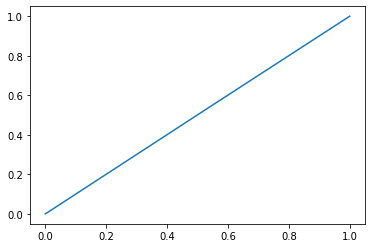

threshold =  0.4


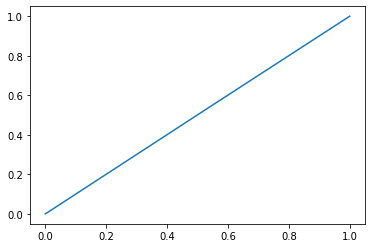

threshold =  0.5


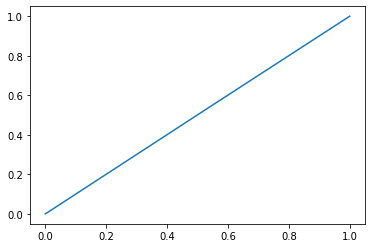

threshold =  0.7


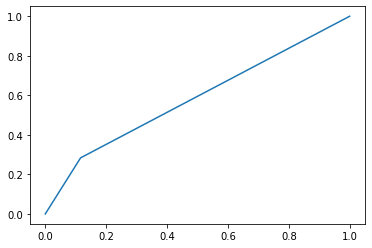

threshold =  0.8


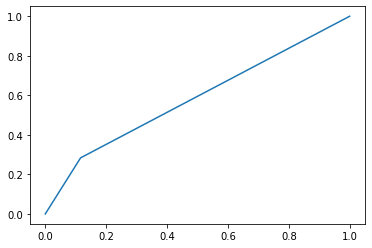

auto threshold


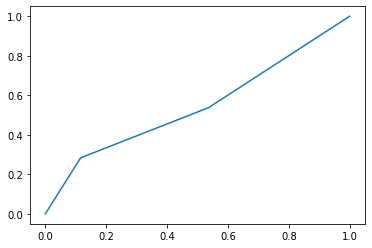

neighbours = 2 err_train = 0.11931818181818182 err_test = 0.4117647058823529
[[61  8]
 [48 19]]
Mera F1 Train: 0.4042553191489362
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


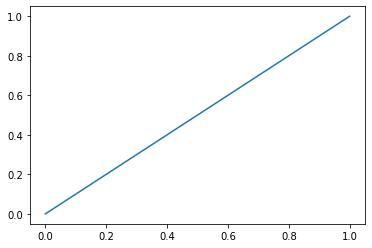

threshold =  0.2


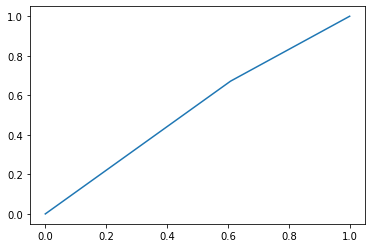

threshold =  0.4


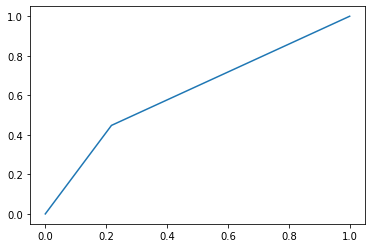

threshold =  0.5


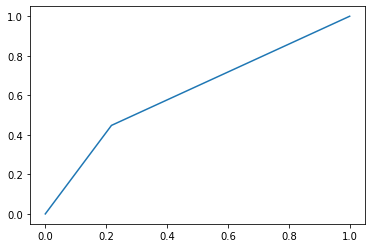

threshold =  0.7


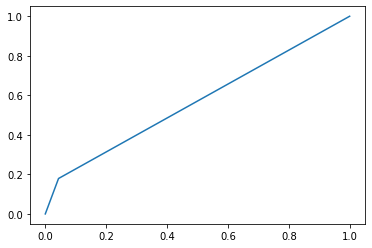

threshold =  0.8


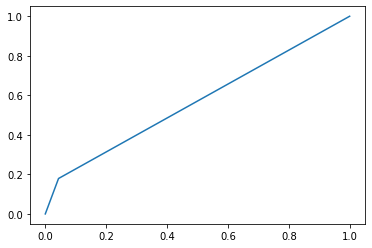

auto threshold


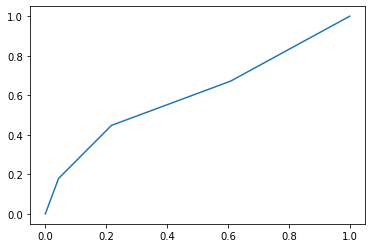

neighbours = 3 err_train = 0.13636363636363635 err_test = 0.38235294117647056
[[54 15]
 [37 30]]
Mera F1 Train: 0.5357142857142857
Precision Score Train:  0.6176470588235294
Recall Score Train:  0.6176470588235294
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


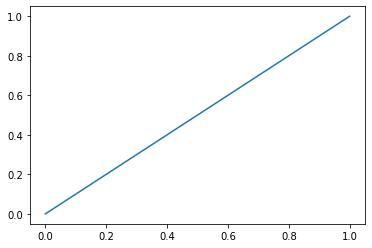

threshold =  0.2


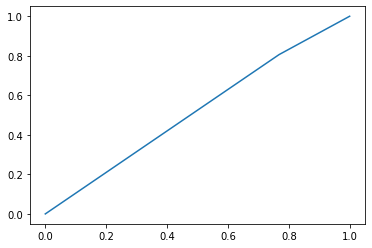

threshold =  0.4


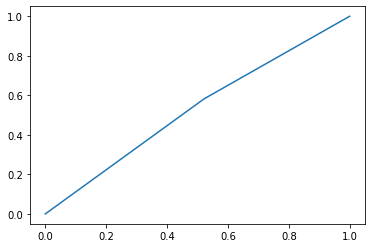

threshold =  0.5


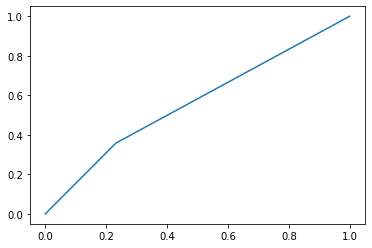

threshold =  0.7


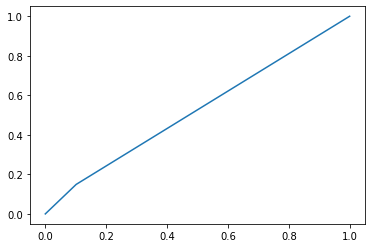

threshold =  0.8


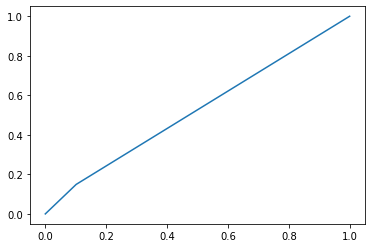

auto threshold


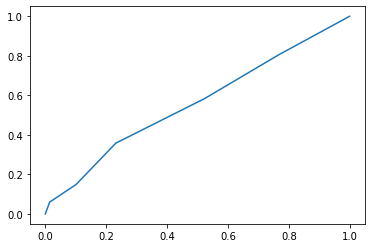

neighbours = 5 err_train = 0.1590909090909091 err_test = 0.4338235294117647
[[53 16]
 [43 24]]
Mera F1 Train: 0.44859813084112143
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


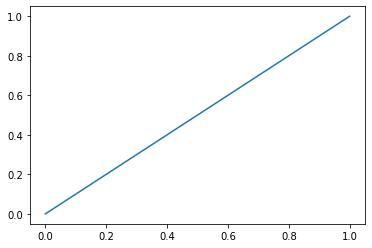

threshold =  0.2


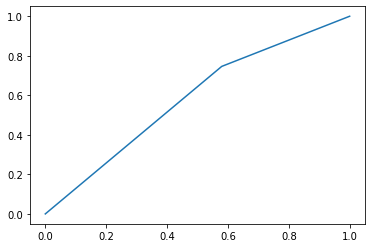

threshold =  0.4


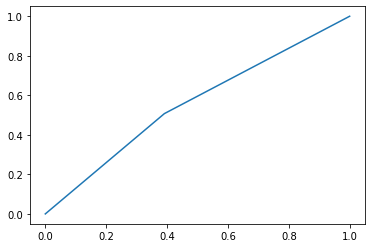

threshold =  0.5


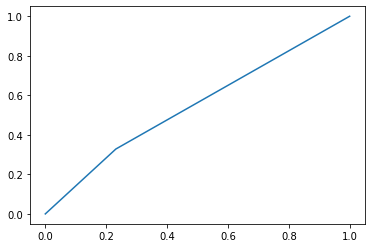

threshold =  0.7


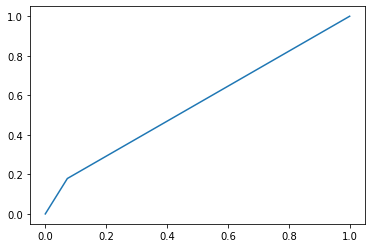

threshold =  0.8


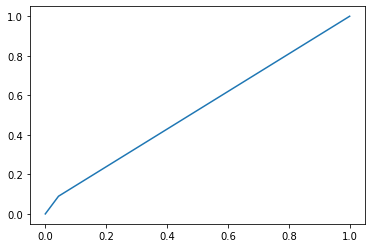

auto threshold


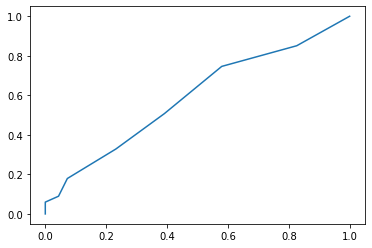

neighbours = 7 err_train = 0.17897727272727273 err_test = 0.4485294117647059
[[53 16]
 [45 22]]
Mera F1 Train: 0.41904761904761906
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


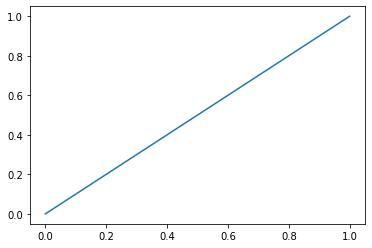

threshold =  0.2


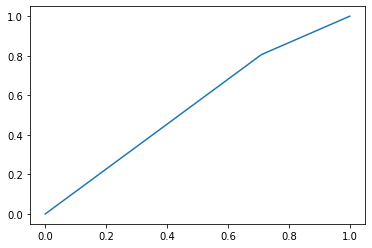

threshold =  0.4


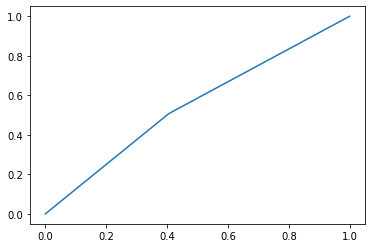

threshold =  0.5


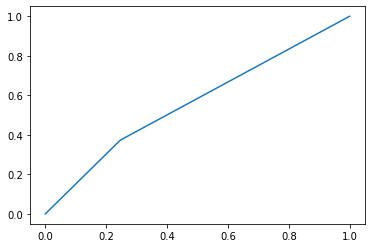

threshold =  0.7


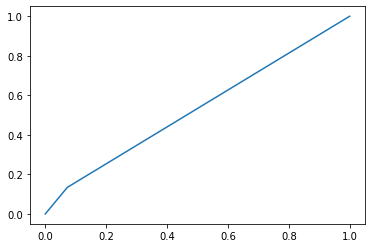

threshold =  0.8


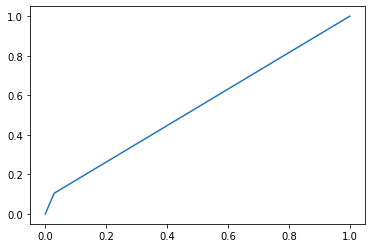

auto threshold


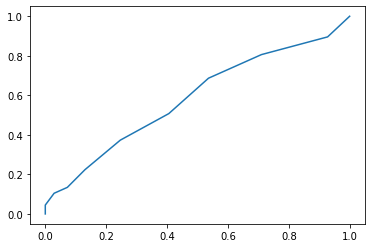

neighbours = 10 err_train = 0.26704545454545453 err_test = 0.4485294117647059
[[60  9]
 [52 15]]
Mera F1 Train: 0.3296703296703297
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


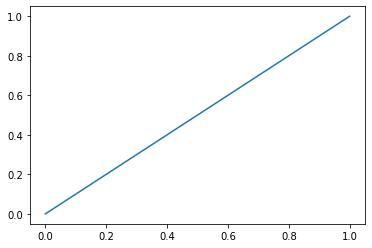

threshold =  0.2


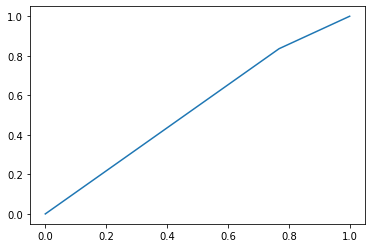

threshold =  0.4


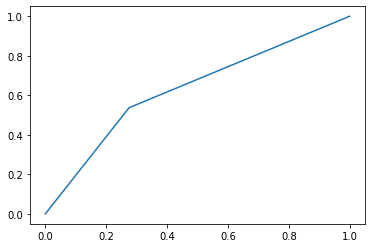

threshold =  0.5


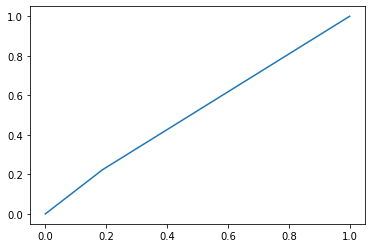

threshold =  0.7


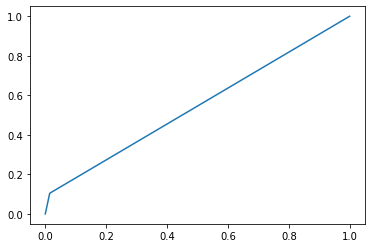

threshold =  0.8


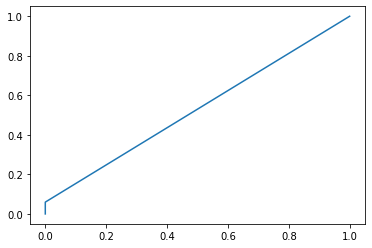

auto threshold


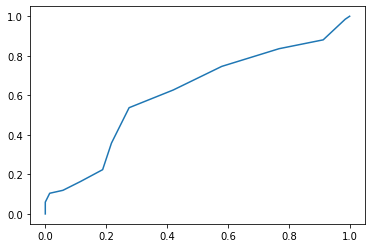

neighbours = 15 err_train = 0.26420454545454547 err_test = 0.47794117647058826
[[56 13]
 [52 15]]
Mera F1 Train: 0.3157894736842105
Precision Score Train:  0.5220588235294118
Recall Score Train:  0.5220588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


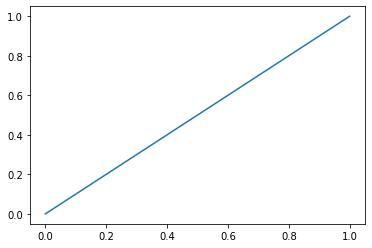

threshold =  0.2


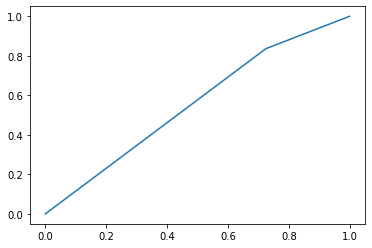

threshold =  0.4


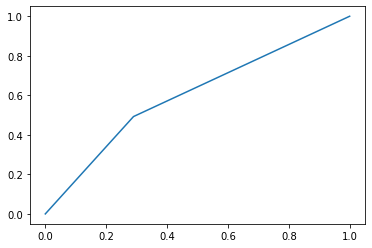

threshold =  0.5


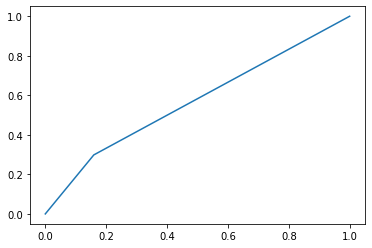

threshold =  0.7


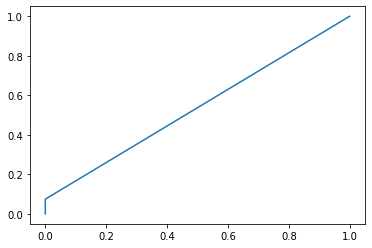

threshold =  0.8


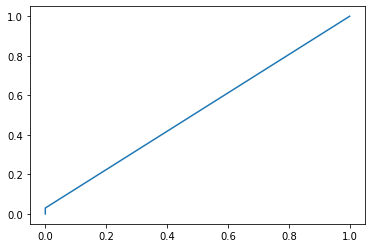

auto threshold


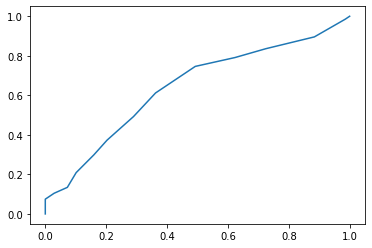

neighbours = 20 err_train = 0.34375 err_test = 0.4411764705882353
[[62  7]
 [53 14]]
Mera F1 Train: 0.3181818181818181
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


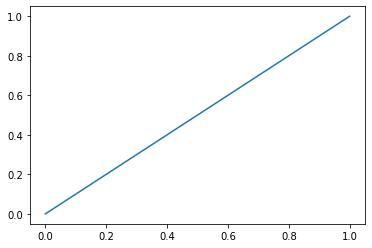

threshold =  0.2


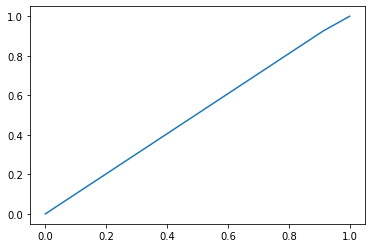

threshold =  0.4


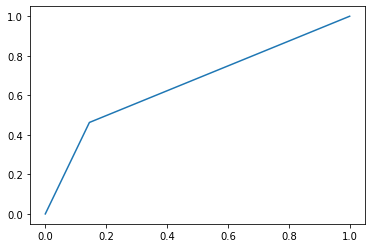

threshold =  0.5


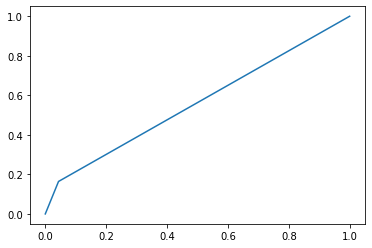

threshold =  0.7


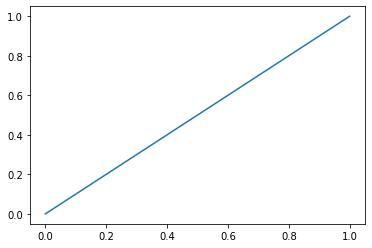

threshold =  0.8


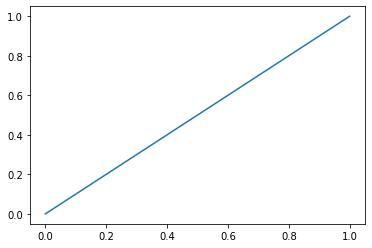

auto threshold


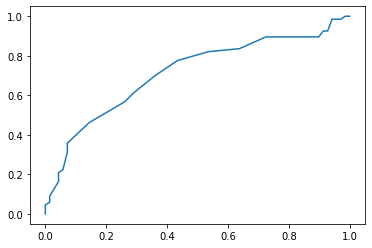

neighbours = 50 err_train = 0.41761363636363635 err_test = 0.45588235294117646
[[68  1]
 [61  6]]
Mera F1 Train: 0.16216216216216214
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


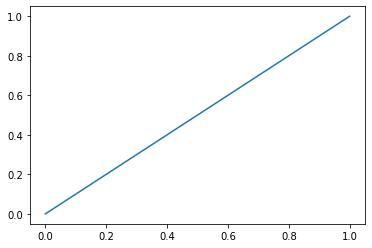

threshold =  0.2


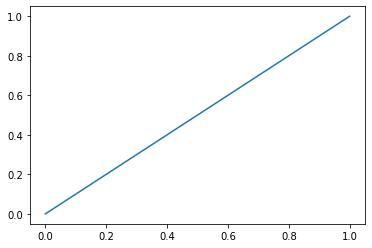

threshold =  0.4


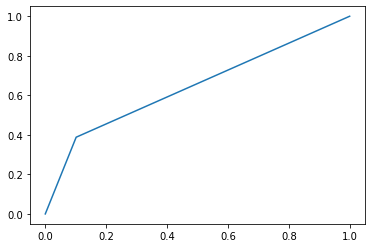

threshold =  0.5


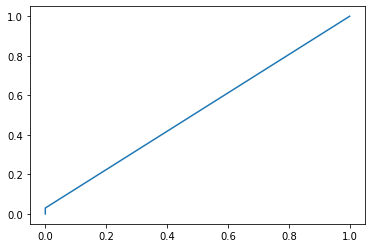

threshold =  0.7


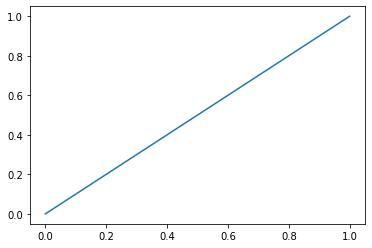

threshold =  0.8


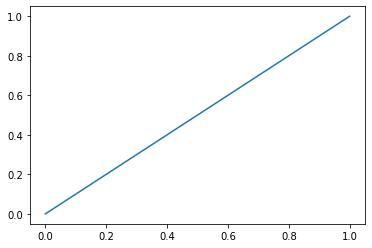

auto threshold


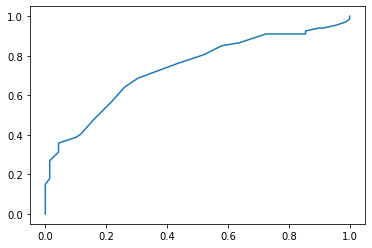

neighbours = 100 err_train = 0.4744318181818182 err_test = 0.4852941176470588
[[69  0]
 [66  1]]
Mera F1 Train: 0.029411764705882353
Precision Score Train:  0.5147058823529411
Recall Score Train:  0.5147058823529411


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [203]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[2][i]=err_test
    Knn_train[2][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [204]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[2]= err_test
SVC_train[2]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.22443181818181818 err_test_SVC = 0.27941176470588236


In [205]:
X_train

array([[ 64. ,   0. , 160. , ...,   1.1,  16.4,  26.3],
       [ 17. ,   0. , 170. , ...,  -1.7,  29.6,   9.6],
       [ 80. ,   0. , 173. , ...,  -0.4,  24.1,  19.7],
       ...,
       [ 34. ,   1. , 165. , ...,   0.8,   1.9,   8.1],
       [ 39. ,   1. , 164. , ...,   1.3,  24.1,  33.7],
       [ 19. ,   1. , 157. , ...,   1.3,   9.4,  17.9]])

In [206]:
y_train

array([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1,
       0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0,
       1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1,
       0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1,
       0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1,

# ADASYN

In [207]:
from imblearn.over_sampling import ADASYN
X_resampled, y_resampled = ADASYN().fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

ValueError: No samples will be generated with the provided ratio settings.

## Knn

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[3][i]=err_test
    Knn_train[3][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [ ]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[3]= err_test
SVC_train[3]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

# Prototype generation

# ClusterCentroids

In [431]:
from imblearn.under_sampling import ClusterCentroids
cc = ClusterCentroids(random_state=0)
X_resampled, y_resampled = cc.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 140), (1, 140)]


## Knn

threshold =  0.0


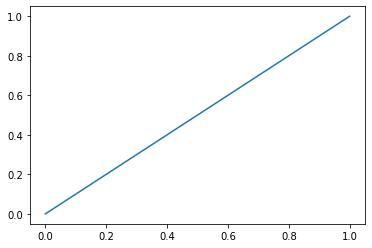

threshold =  0.2


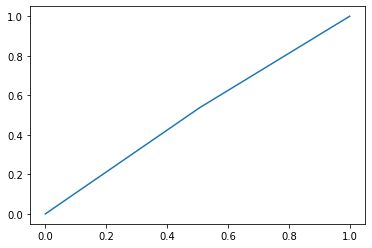

threshold =  0.4


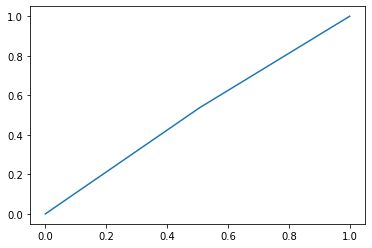

threshold =  0.5


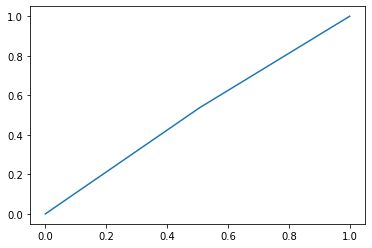

threshold =  0.7


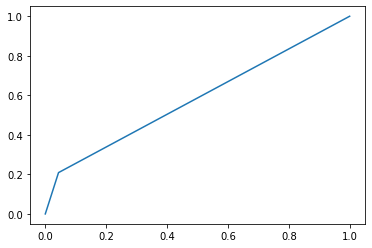

threshold =  0.8


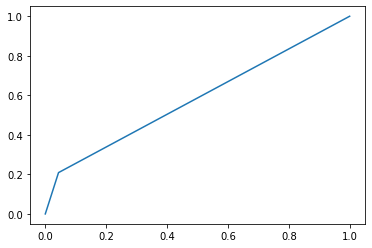

auto threshold


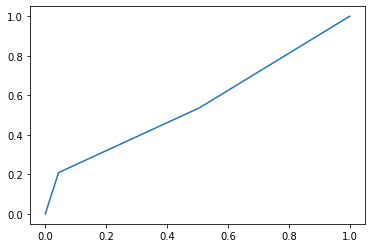

neighbours = 2 err_train = 0.24285714285714285 err_test = 0.4117647058823529
[[66  3]
 [53 14]]
Mera F1 Train: 0.33333333333333337
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


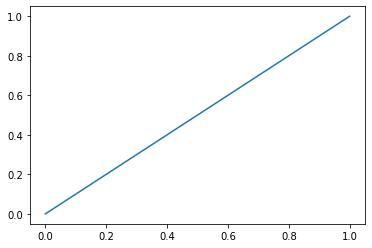

threshold =  0.2


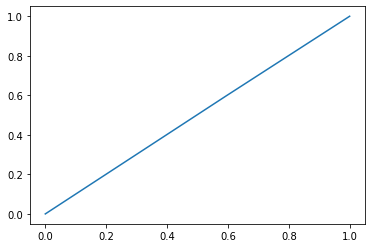

threshold =  0.4


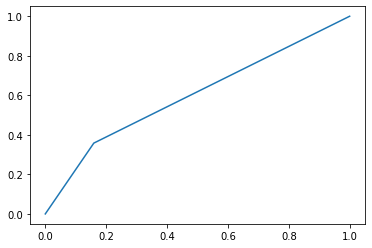

threshold =  0.5


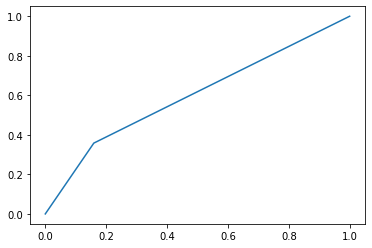

threshold =  0.7


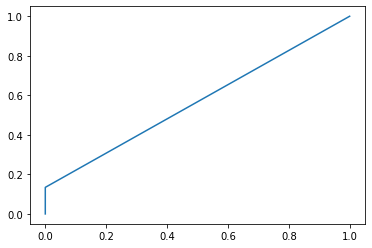

threshold =  0.8


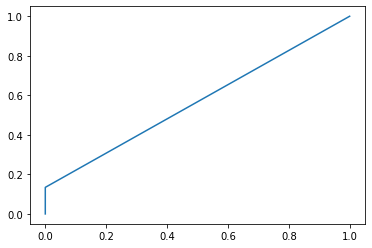

auto threshold


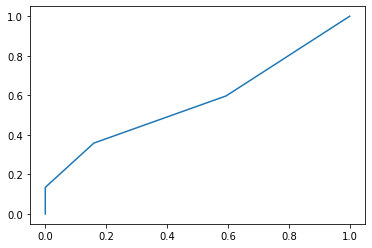

neighbours = 3 err_train = 0.18571428571428572 err_test = 0.39705882352941174
[[58 11]
 [43 24]]
Mera F1 Train: 0.47058823529411764
Precision Score Train:  0.6029411764705882
Recall Score Train:  0.6029411764705882
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


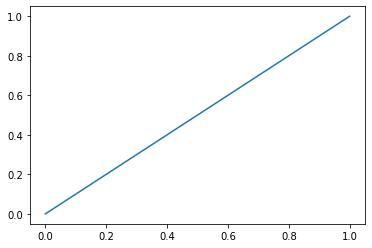

threshold =  0.2


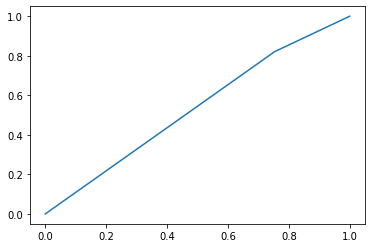

threshold =  0.4


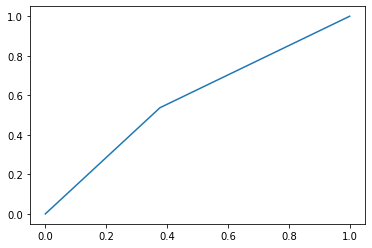

threshold =  0.5


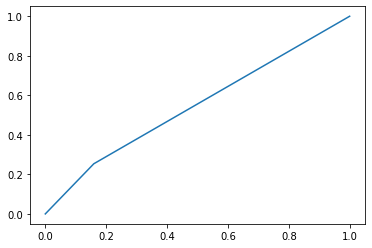

threshold =  0.7


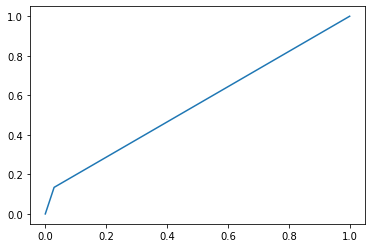

threshold =  0.8


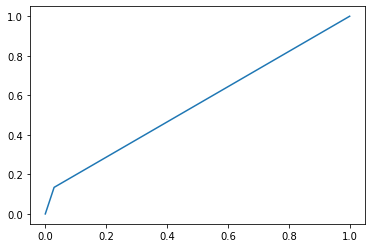

auto threshold


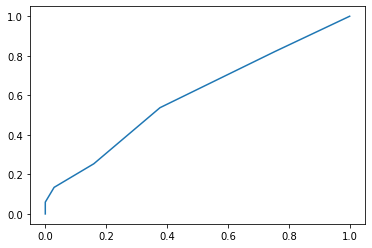

neighbours = 5 err_train = 0.25 err_test = 0.4485294117647059
[[58 11]
 [50 17]]
Mera F1 Train: 0.3578947368421053
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


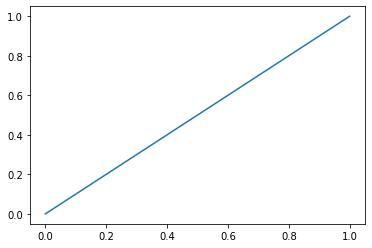

threshold =  0.2


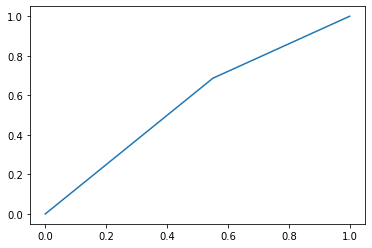

threshold =  0.4


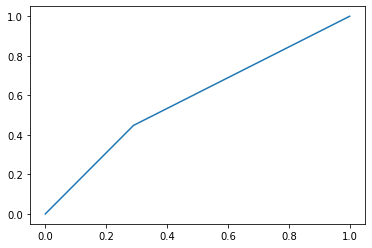

threshold =  0.5


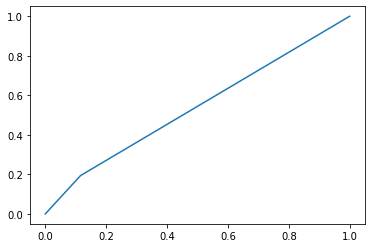

threshold =  0.7


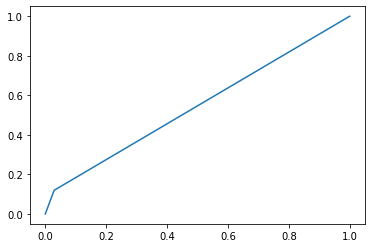

threshold =  0.8


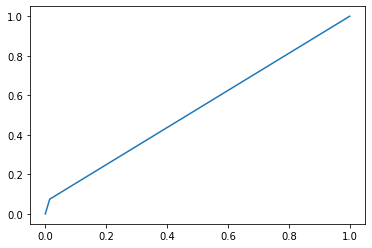

auto threshold


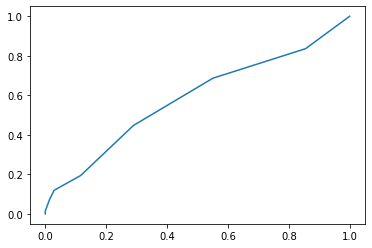

neighbours = 7 err_train = 0.3 err_test = 0.45588235294117646
[[61  8]
 [54 13]]
Mera F1 Train: 0.29545454545454547
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


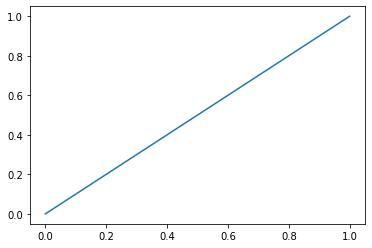

threshold =  0.2


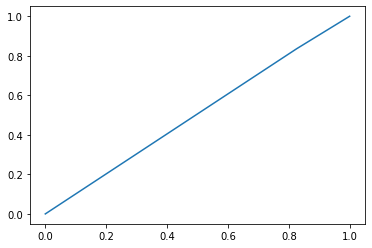

threshold =  0.4


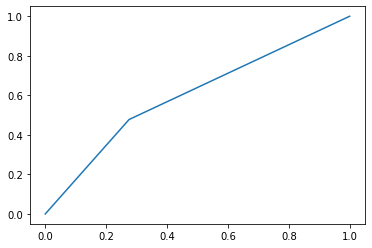

threshold =  0.5


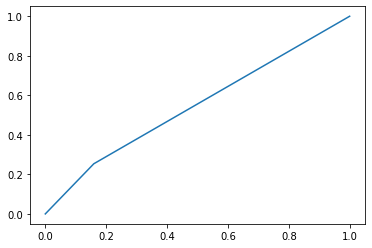

threshold =  0.7


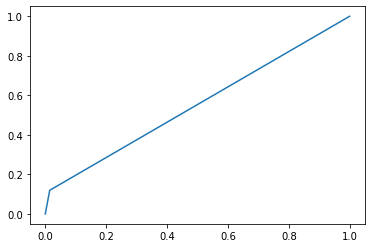

threshold =  0.8


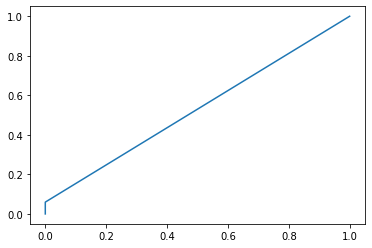

auto threshold


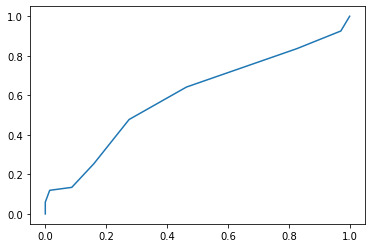

neighbours = 10 err_train = 0.3357142857142857 err_test = 0.47058823529411764
[[63  6]
 [58  9]]
Mera F1 Train: 0.21951219512195122
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


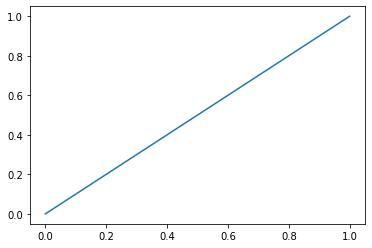

threshold =  0.2


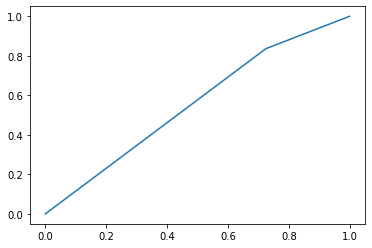

threshold =  0.4


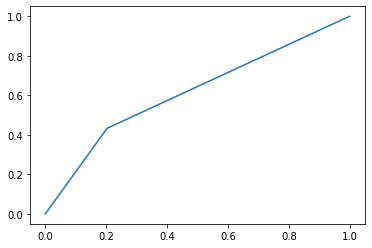

threshold =  0.5


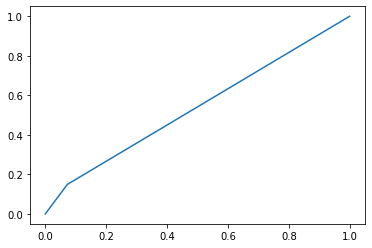

threshold =  0.7


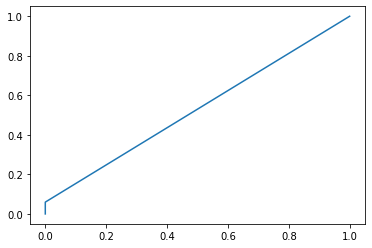

threshold =  0.8


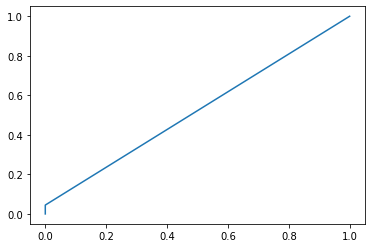

auto threshold


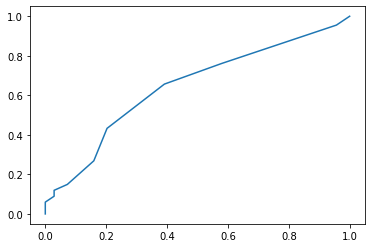

neighbours = 15 err_train = 0.3357142857142857 err_test = 0.45588235294117646
[[64  5]
 [57 10]]
Mera F1 Train: 0.24390243902439024
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


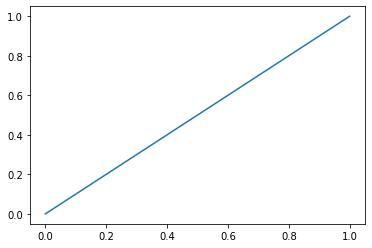

threshold =  0.2


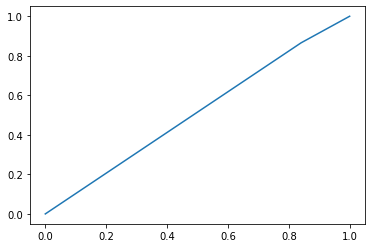

threshold =  0.4


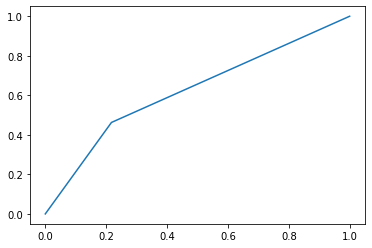

threshold =  0.5


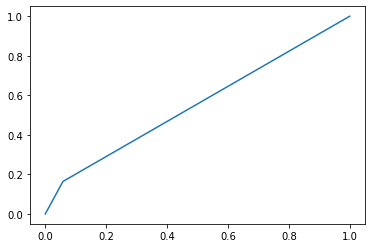

threshold =  0.7


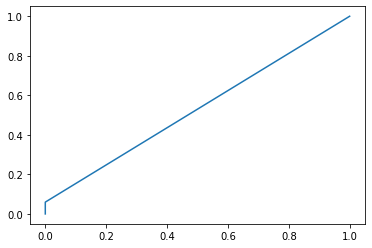

threshold =  0.8


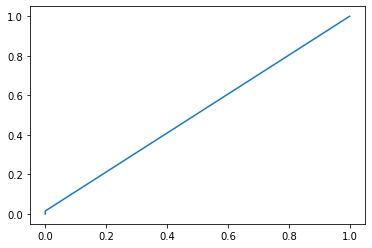

auto threshold


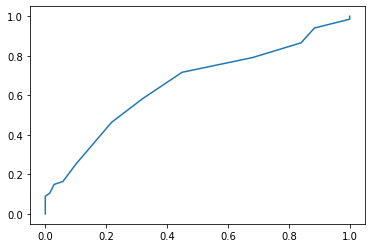

neighbours = 20 err_train = 0.37142857142857144 err_test = 0.4338235294117647
[[67  2]
 [57 10]]
Mera F1 Train: 0.2531645569620253
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


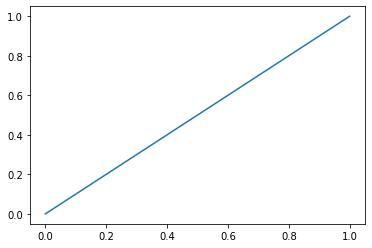

threshold =  0.2


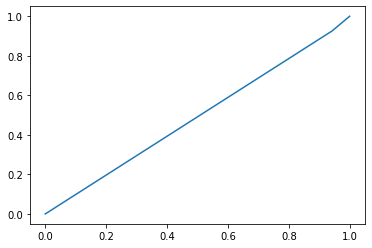

threshold =  0.4


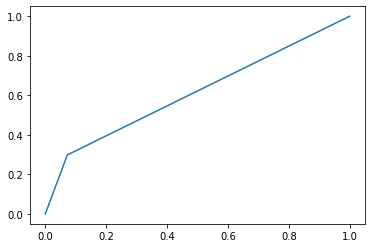

threshold =  0.5


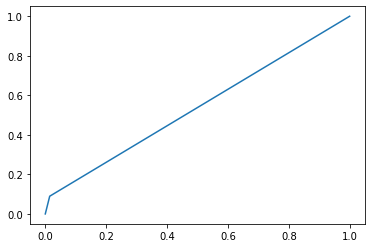

threshold =  0.7


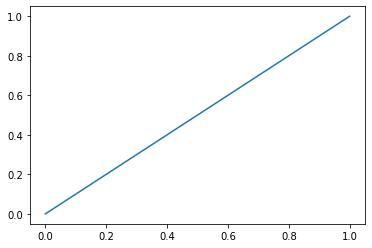

threshold =  0.8


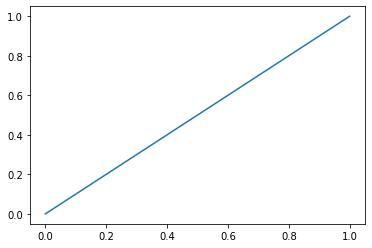

auto threshold


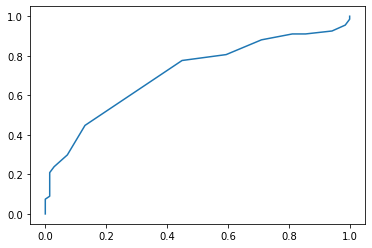

neighbours = 50 err_train = 0.4607142857142857 err_test = 0.45588235294117646
[[69  0]
 [62  5]]
Mera F1 Train: 0.13888888888888887
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


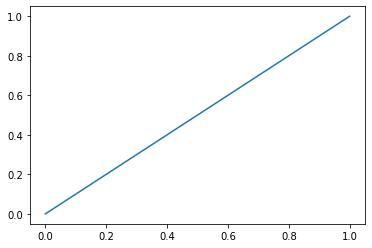

threshold =  0.2


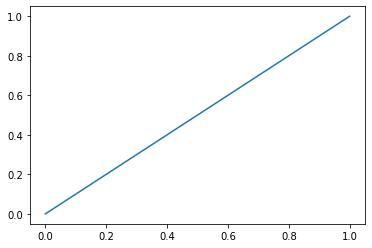

threshold =  0.4


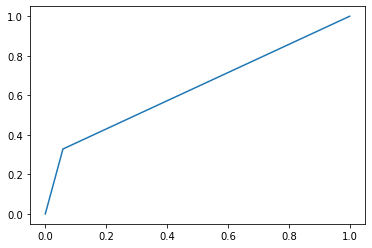

threshold =  0.5


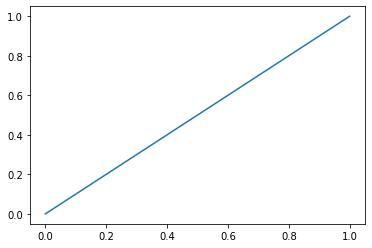

threshold =  0.7


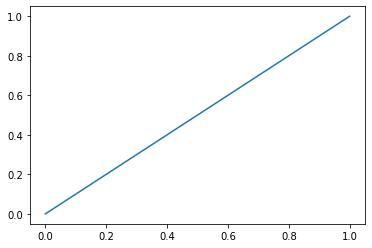

threshold =  0.8


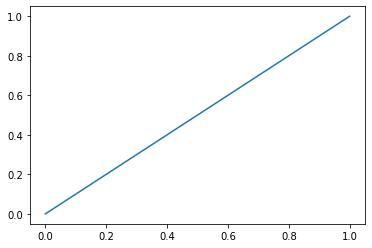

auto threshold


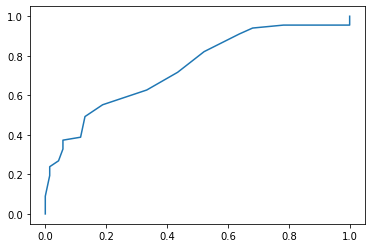

neighbours = 100 err_train = 0.49642857142857144 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [432]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[4][i]=err_test
    Knn_train[4][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [434]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[4]= err_test
SVC_train[4]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.2357142857142857 err_test_SVC = 0.3235294117647059


# Controlled under-sampling techniques

# RandomUnderSampler

In [435]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=0)
X_resampled, y_resampled = rus.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 140), (1, 140)]


## Knn

threshold =  0.0


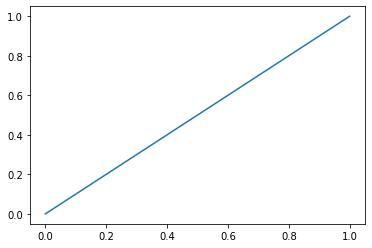

threshold =  0.2


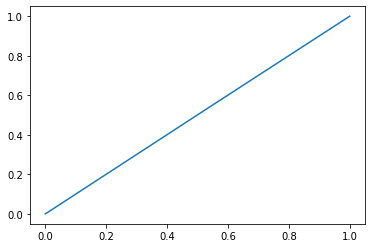

threshold =  0.4


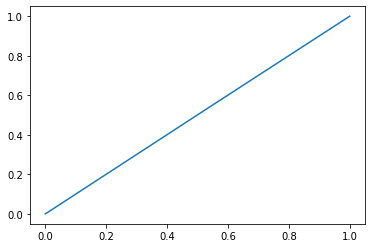

threshold =  0.5


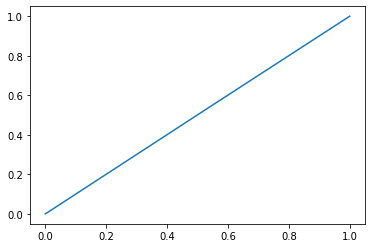

threshold =  0.7


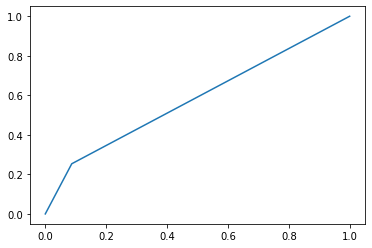

threshold =  0.8


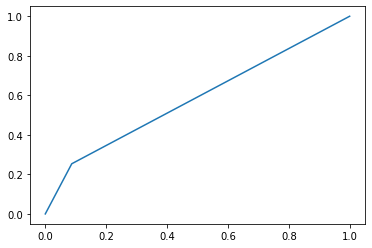

auto threshold


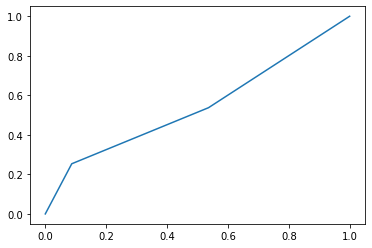

neighbours = 2 err_train = 0.225 err_test = 0.4117647058823529
[[63  6]
 [50 17]]
Mera F1 Train: 0.37777777777777777
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


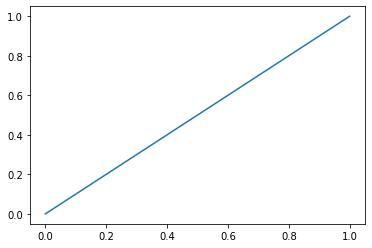

threshold =  0.2


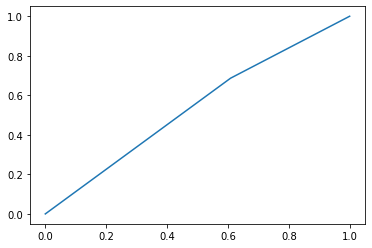

threshold =  0.4


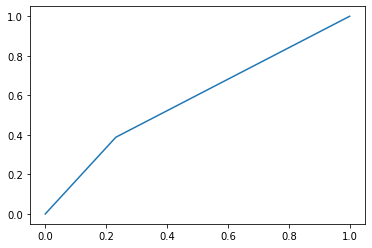

threshold =  0.5


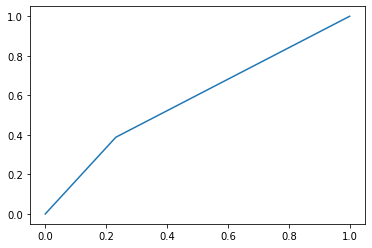

threshold =  0.7


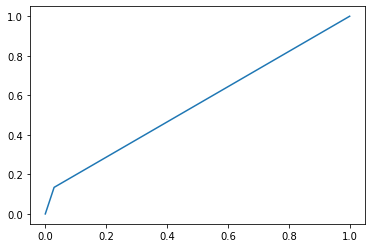

threshold =  0.8


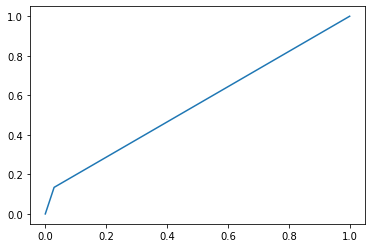

auto threshold


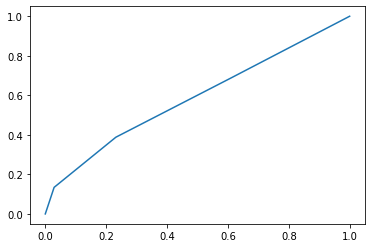

neighbours = 3 err_train = 0.15 err_test = 0.41911764705882354
[[53 16]
 [41 26]]
Mera F1 Train: 0.47706422018348627
Precision Score Train:  0.5808823529411765
Recall Score Train:  0.5808823529411765
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


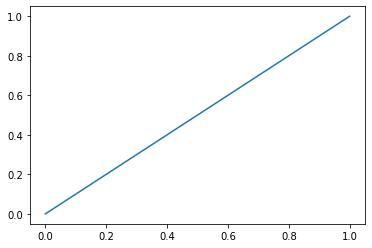

threshold =  0.2


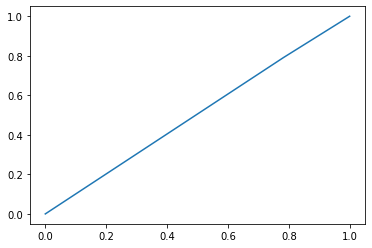

threshold =  0.4


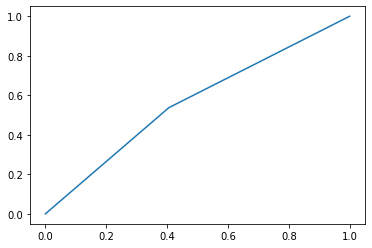

threshold =  0.5


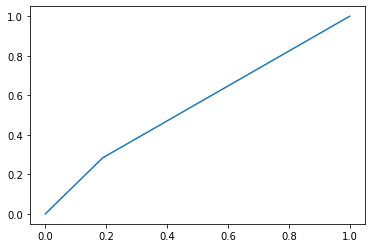

threshold =  0.7


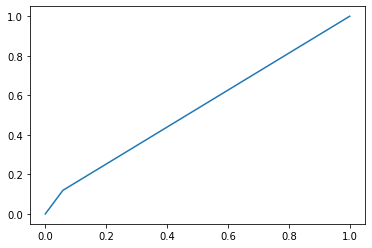

threshold =  0.8


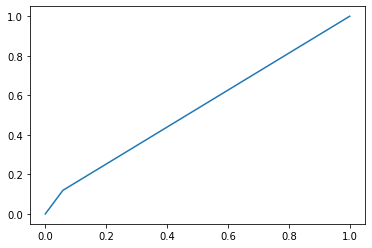

auto threshold


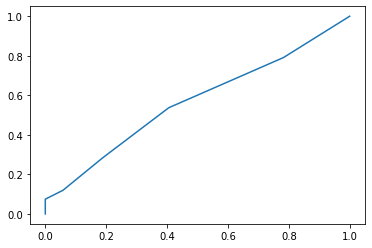

neighbours = 5 err_train = 0.2392857142857143 err_test = 0.4485294117647059
[[56 13]
 [48 19]]
Mera F1 Train: 0.38383838383838387
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


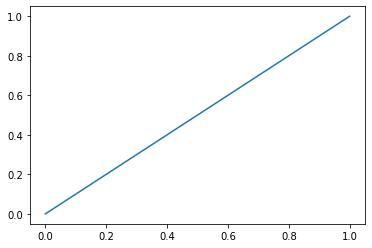

threshold =  0.2


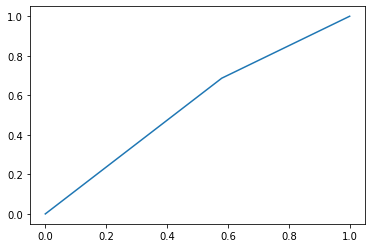

threshold =  0.4


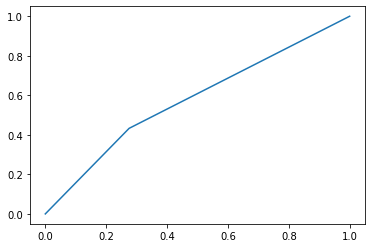

threshold =  0.5


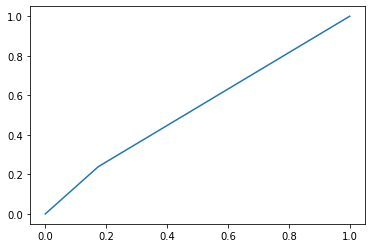

threshold =  0.7


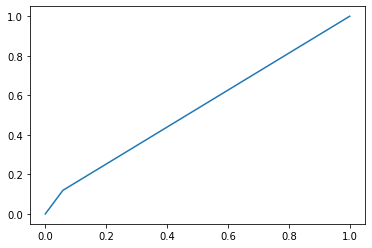

threshold =  0.8


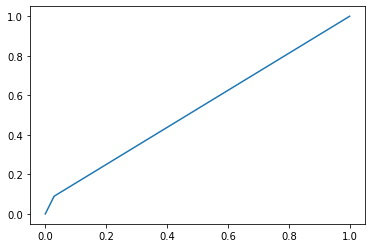

auto threshold


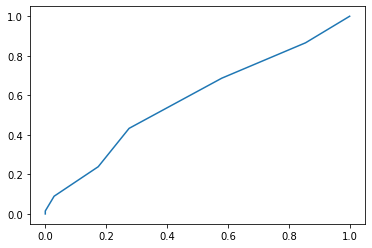

neighbours = 7 err_train = 0.2892857142857143 err_test = 0.4632352941176471
[[57 12]
 [51 16]]
Mera F1 Train: 0.3368421052631579
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


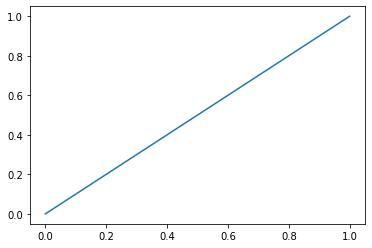

threshold =  0.2


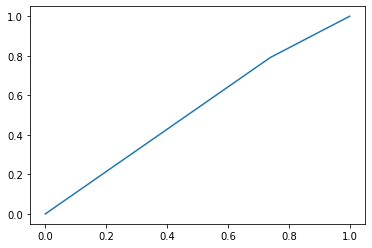

threshold =  0.4


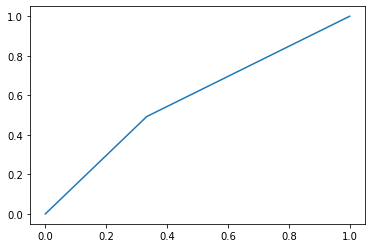

threshold =  0.5


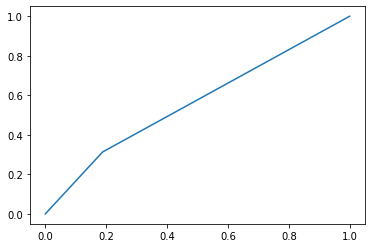

threshold =  0.7


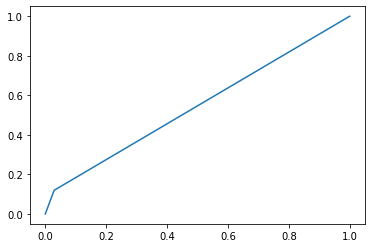

threshold =  0.8


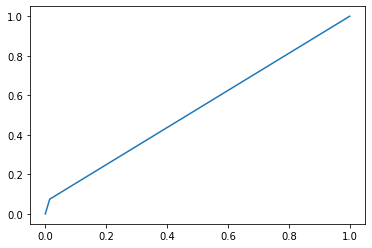

auto threshold


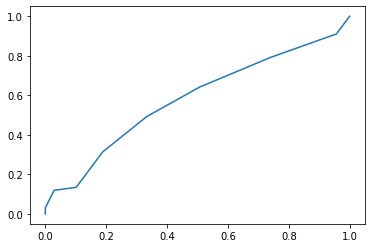

neighbours = 10 err_train = 0.3357142857142857 err_test = 0.47794117647058826
[[62  7]
 [58  9]]
Mera F1 Train: 0.21686746987951808
Precision Score Train:  0.5220588235294118
Recall Score Train:  0.5220588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


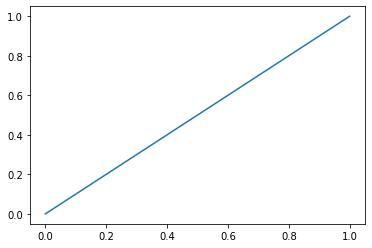

threshold =  0.2


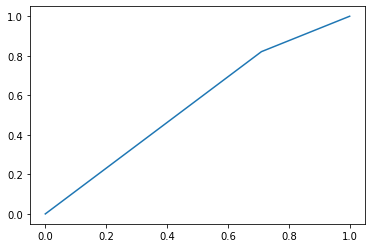

threshold =  0.4


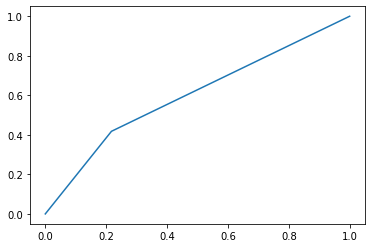

threshold =  0.5


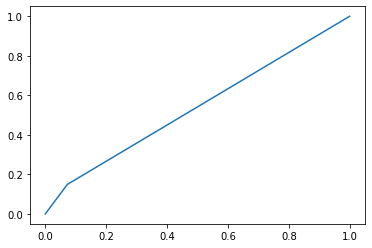

threshold =  0.7


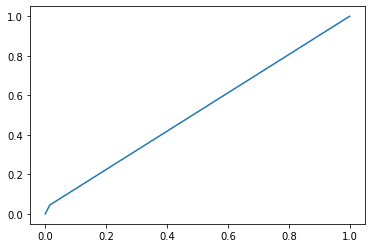

threshold =  0.8


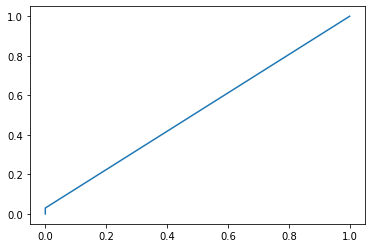

auto threshold


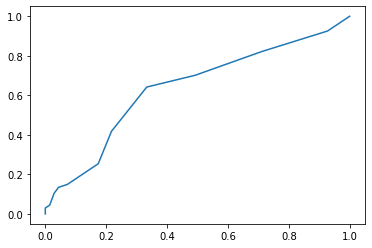

neighbours = 15 err_train = 0.325 err_test = 0.45588235294117646
[[64  5]
 [57 10]]
Mera F1 Train: 0.24390243902439024
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


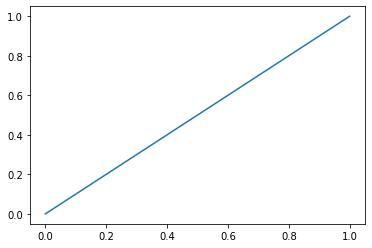

threshold =  0.2


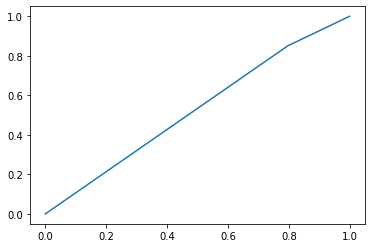

threshold =  0.4


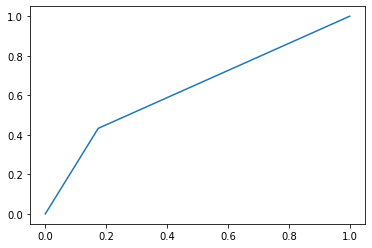

threshold =  0.5


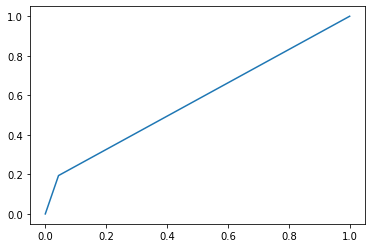

threshold =  0.7


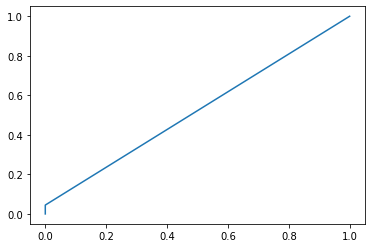

threshold =  0.8


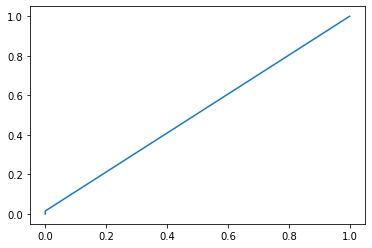

auto threshold


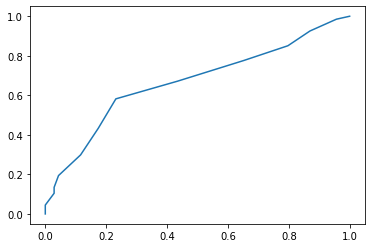

neighbours = 20 err_train = 0.38571428571428573 err_test = 0.4411764705882353
[[67  2]
 [58  9]]
Mera F1 Train: 0.23076923076923075
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


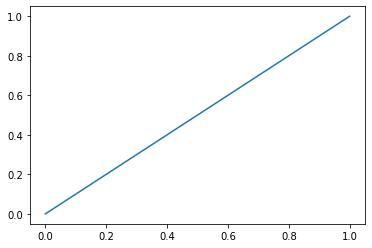

threshold =  0.2


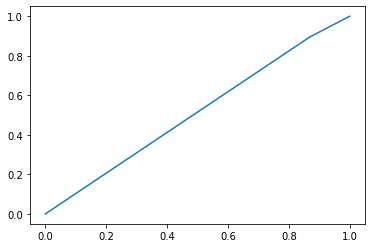

threshold =  0.4


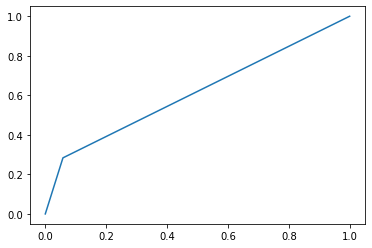

threshold =  0.5


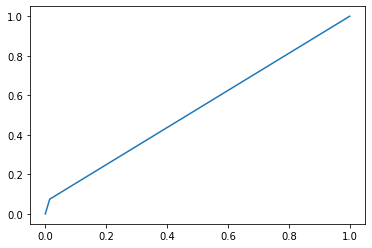

threshold =  0.7


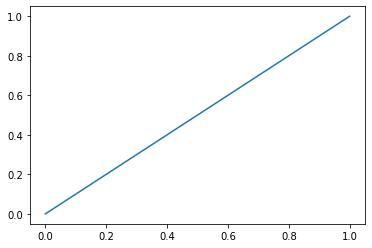

threshold =  0.8


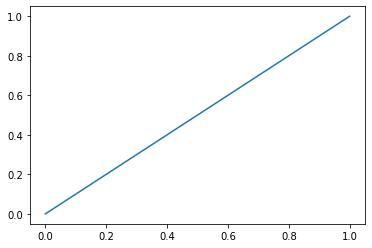

auto threshold


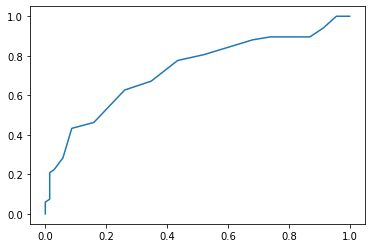

neighbours = 50 err_train = 0.45357142857142857 err_test = 0.4632352941176471
[[69  0]
 [63  4]]
Mera F1 Train: 0.11267605633802817
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


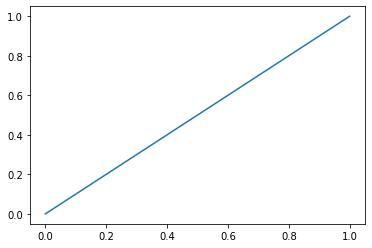

threshold =  0.2


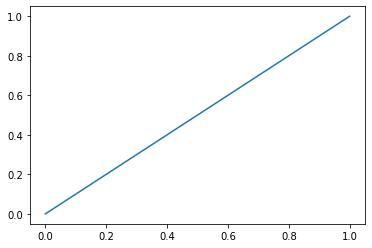

threshold =  0.4


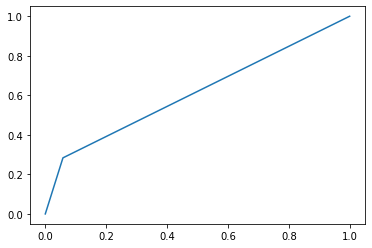

threshold =  0.5


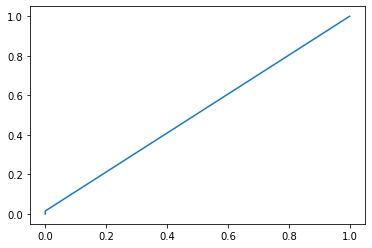

threshold =  0.7


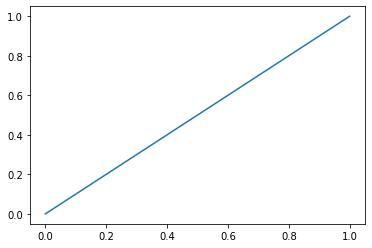

threshold =  0.8


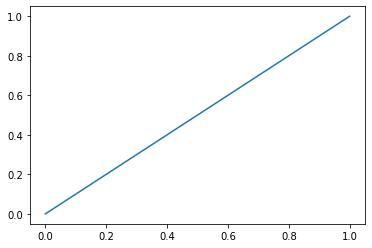

auto threshold


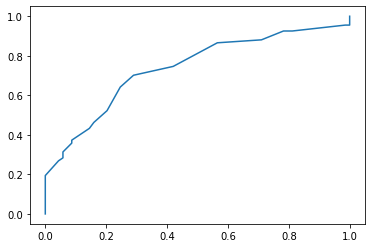

neighbours = 100 err_train = 0.49642857142857144 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [436]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[5][i]=err_test
    Knn_train[5][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [438]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[5]= err_test
SVC_train[5]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.22857142857142856 err_test_SVC = 0.3161764705882353


# NearMiss

In [439]:
from imblearn.under_sampling import NearMiss
nm1 = NearMiss(version=1)
X_resampled_nm1, y_resampled = nm1.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 140), (1, 140)]


## Knn

threshold =  0.0


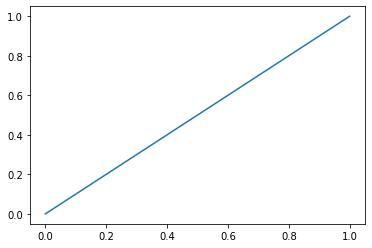

threshold =  0.2


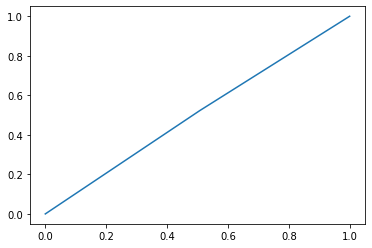

threshold =  0.4


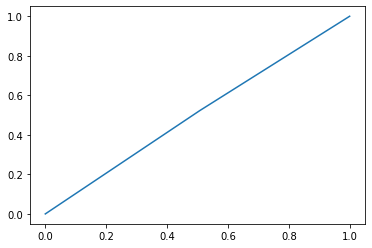

threshold =  0.5


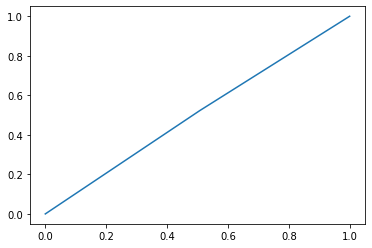

threshold =  0.7


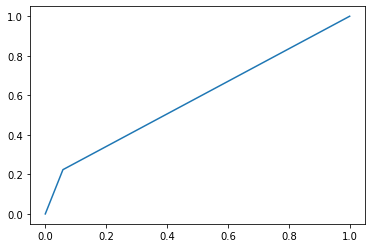

threshold =  0.8


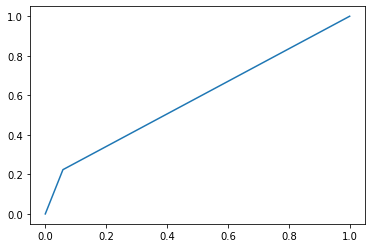

auto threshold


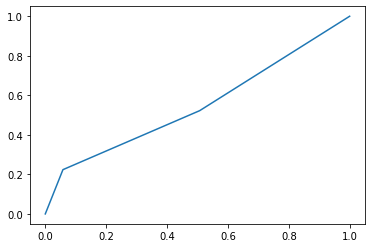

neighbours = 2 err_train = 0.22857142857142856 err_test = 0.4117647058823529
[[65  4]
 [52 15]]
Mera F1 Train: 0.3488372093023256
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


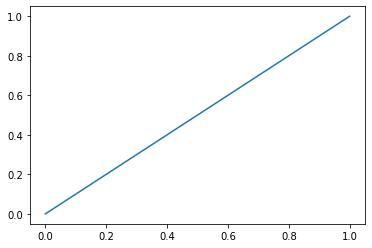

threshold =  0.2


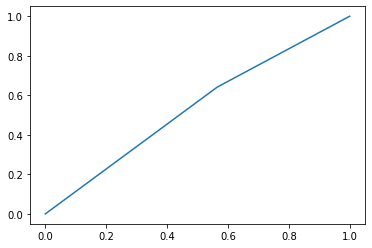

threshold =  0.4


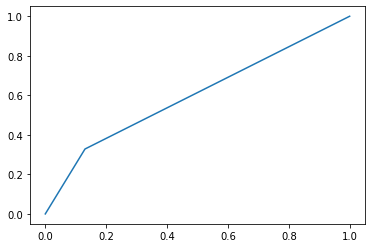

threshold =  0.5


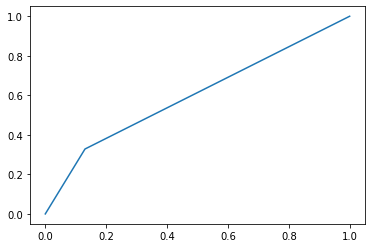

threshold =  0.7


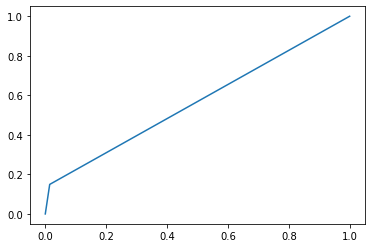

threshold =  0.8


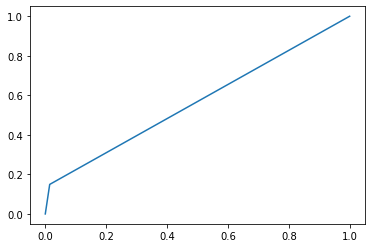

auto threshold


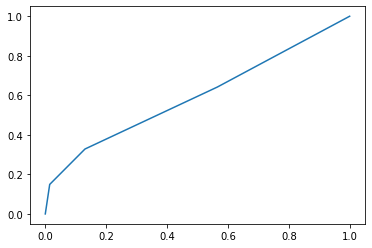

neighbours = 3 err_train = 0.17142857142857143 err_test = 0.39705882352941174
[[60  9]
 [45 22]]
Mera F1 Train: 0.4489795918367347
Precision Score Train:  0.6029411764705882
Recall Score Train:  0.6029411764705882
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


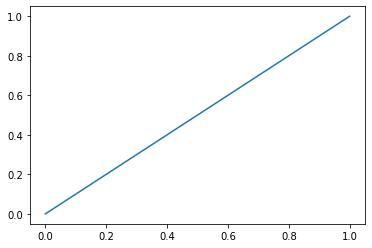

threshold =  0.2


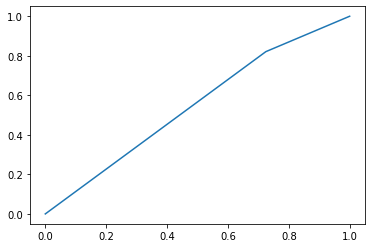

threshold =  0.4


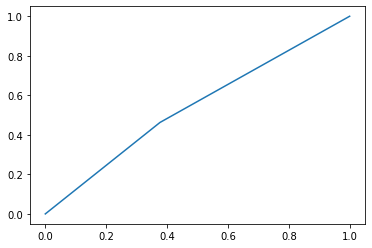

threshold =  0.5


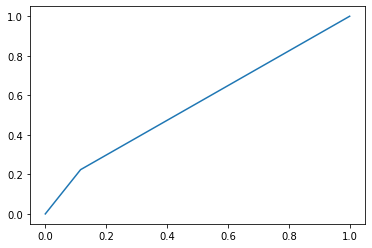

threshold =  0.7


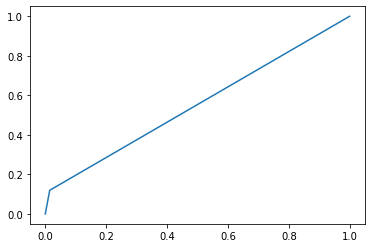

threshold =  0.8


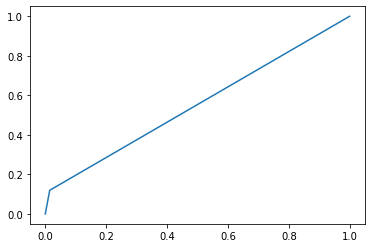

auto threshold


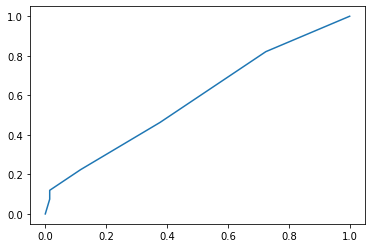

neighbours = 5 err_train = 0.2392857142857143 err_test = 0.4411764705882353
[[61  8]
 [52 15]]
Mera F1 Train: 0.33333333333333337
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


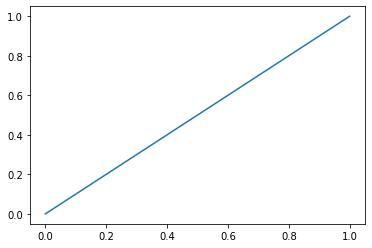

threshold =  0.2


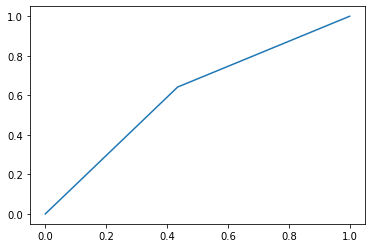

threshold =  0.4


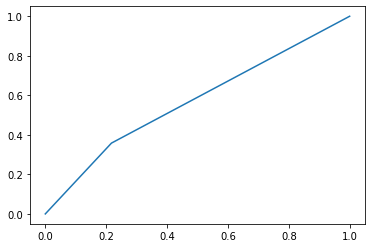

threshold =  0.5


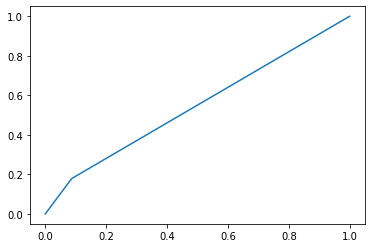

threshold =  0.7


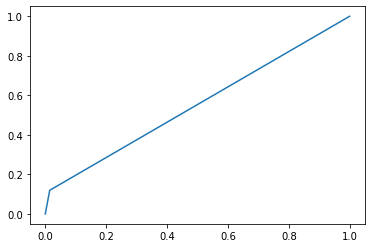

threshold =  0.8


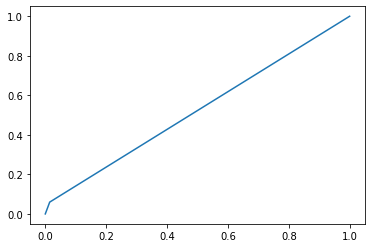

auto threshold


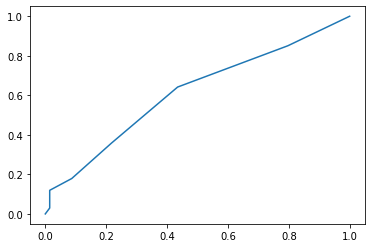

neighbours = 7 err_train = 0.2714285714285714 err_test = 0.4485294117647059
[[63  6]
 [55 12]]
Mera F1 Train: 0.2823529411764706
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


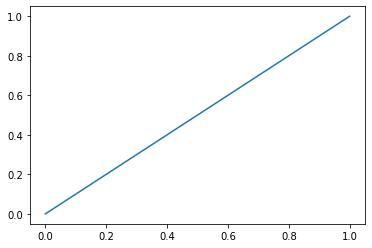

threshold =  0.2


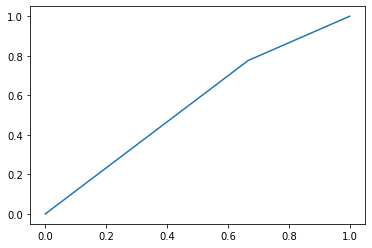

threshold =  0.4


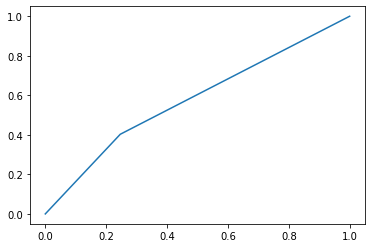

threshold =  0.5


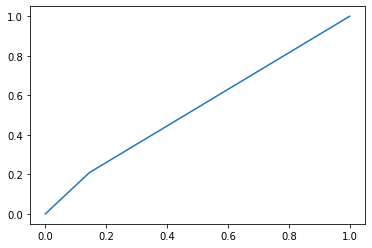

threshold =  0.7


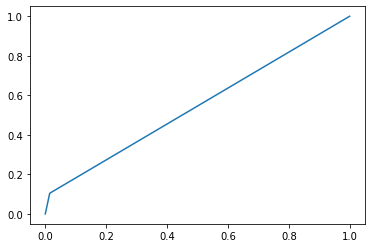

threshold =  0.8


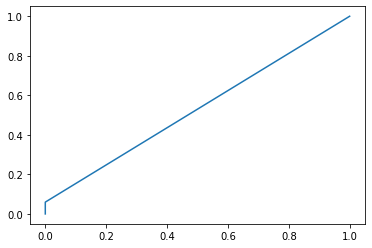

auto threshold


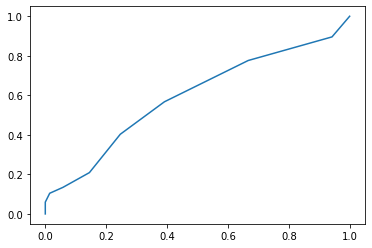

neighbours = 10 err_train = 0.3535714285714286 err_test = 0.45588235294117646
[[65  4]
 [58  9]]
Mera F1 Train: 0.225
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


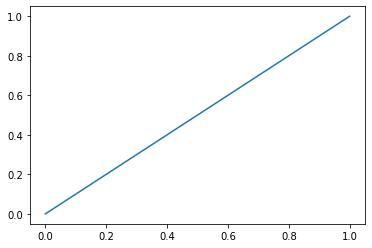

threshold =  0.2


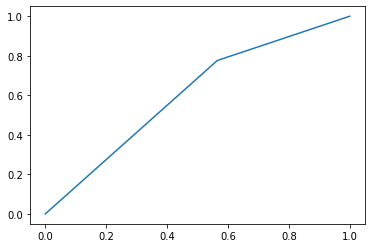

threshold =  0.4


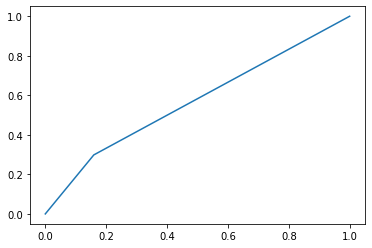

threshold =  0.5


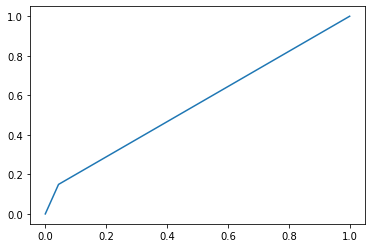

threshold =  0.7


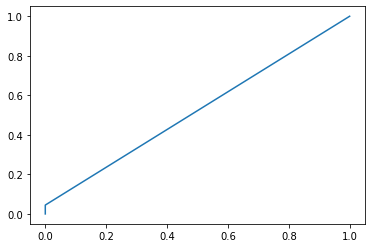

threshold =  0.8


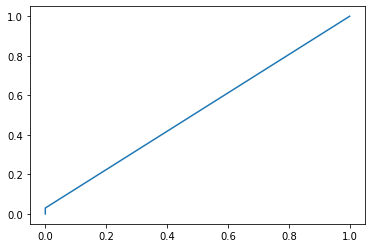

auto threshold


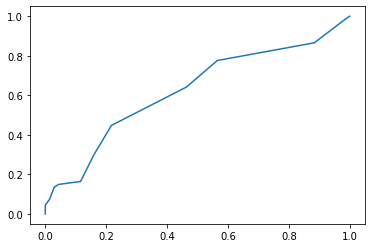

neighbours = 15 err_train = 0.3535714285714286 err_test = 0.4411764705882353
[[66  3]
 [57 10]]
Mera F1 Train: 0.24999999999999997
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


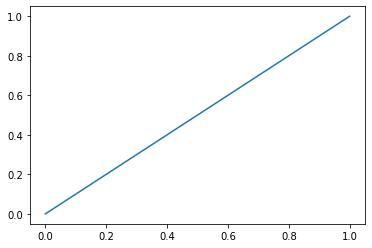

threshold =  0.2


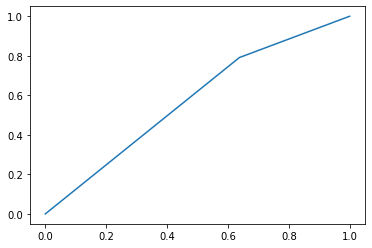

threshold =  0.4


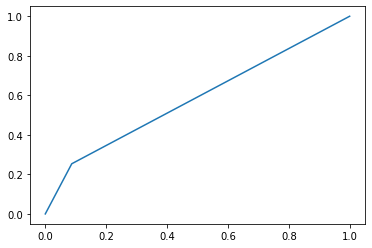

threshold =  0.5


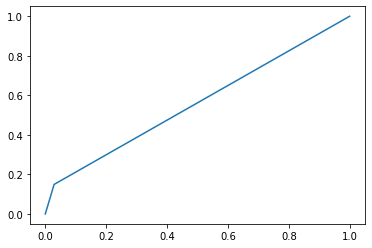

threshold =  0.7


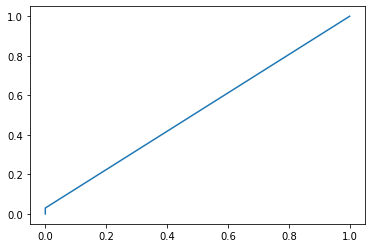

threshold =  0.8


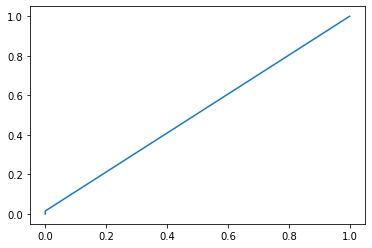

auto threshold


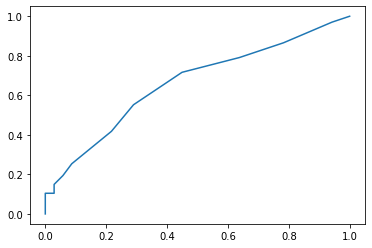

neighbours = 20 err_train = 0.3821428571428571 err_test = 0.45588235294117646
[[67  2]
 [60  7]]
Mera F1 Train: 0.1842105263157895
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


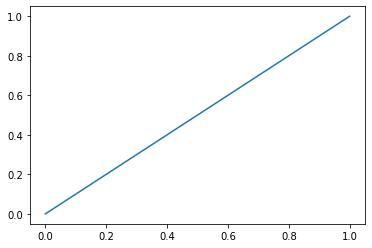

threshold =  0.2


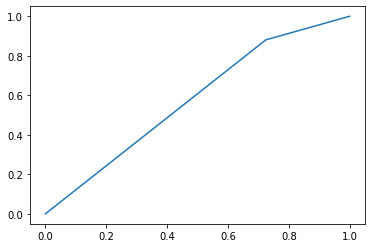

threshold =  0.4


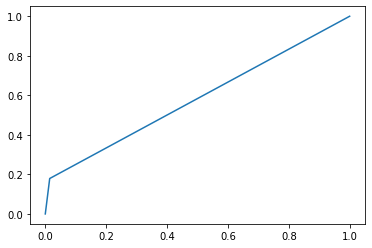

threshold =  0.5


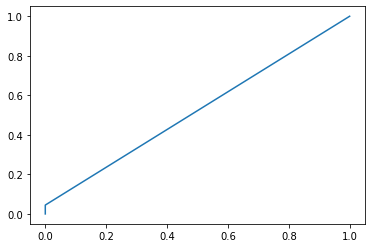

threshold =  0.7


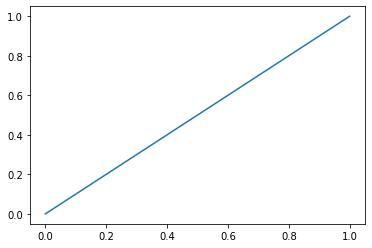

threshold =  0.8


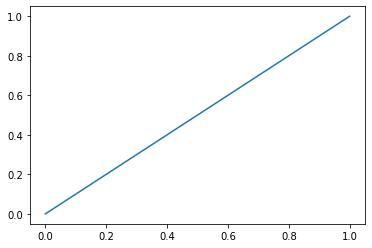

auto threshold


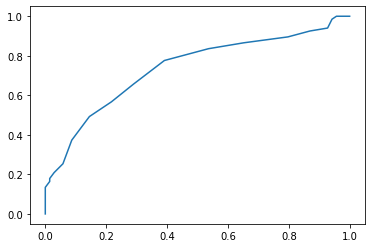

neighbours = 50 err_train = 0.4607142857142857 err_test = 0.47058823529411764
[[69  0]
 [64  3]]
Mera F1 Train: 0.08571428571428572
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


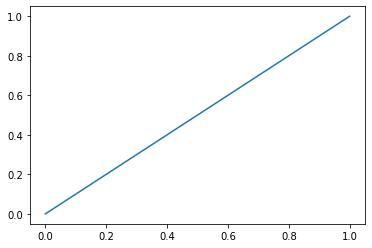

threshold =  0.2


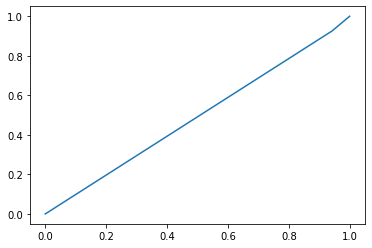

threshold =  0.4


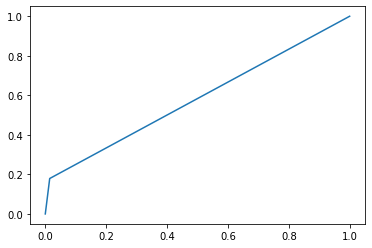

threshold =  0.5


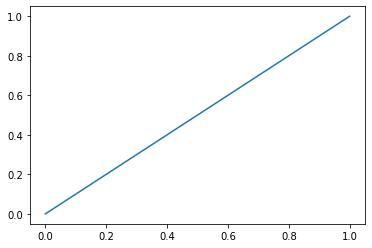

threshold =  0.7


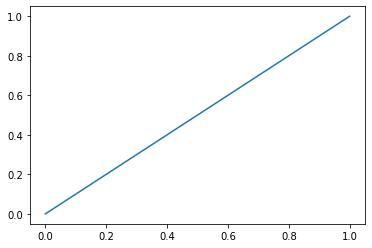

threshold =  0.8


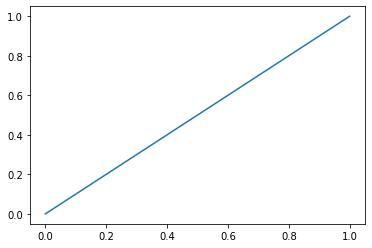

auto threshold


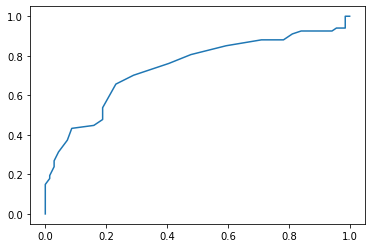

neighbours = 100 err_train = 0.5 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [440]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled_nm1, y_resampled)
    
    y_train_predict = knn.predict(X_resampled_nm1)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[6][i]=err_test
    Knn_train[6][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [441]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled_nm1, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled_nm1))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[6]= err_test
SVC_train[6]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.21428571428571427 err_test_SVC = 0.3088235294117647


# Edited data set using nearest neighbours

# EditedNearestNeighbours

In [442]:
from imblearn.under_sampling import EditedNearestNeighbours
enn = EditedNearestNeighbours()
X_resampled, y_resampled = enn.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 85), (1, 140)]


## Knn

threshold =  0.0


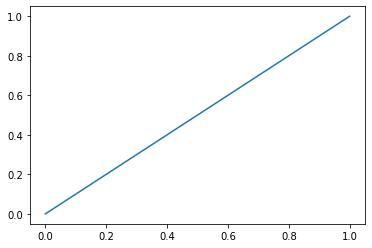

threshold =  0.2


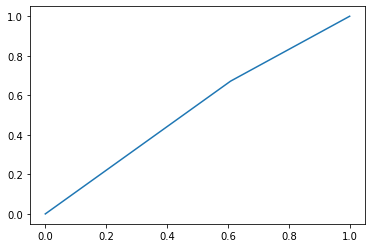

threshold =  0.4


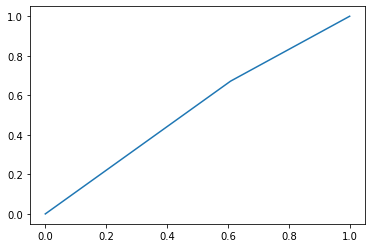

threshold =  0.5


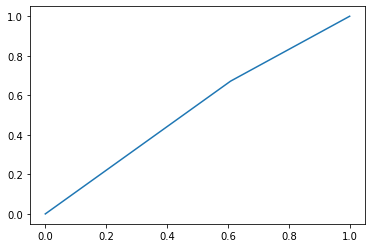

threshold =  0.7


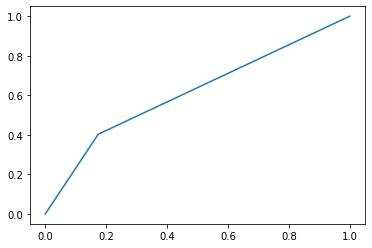

threshold =  0.8


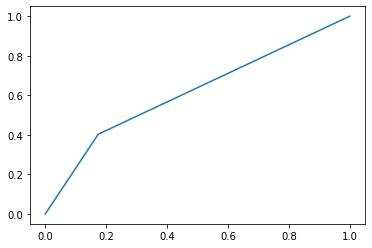

auto threshold


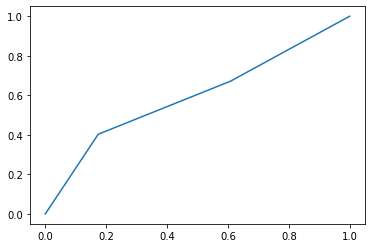

neighbours = 2 err_train = 0.16444444444444445 err_test = 0.38235294117647056
[[57 12]
 [40 27]]
Mera F1 Train: 0.5094339622641508
Precision Score Train:  0.6176470588235294
Recall Score Train:  0.6176470588235294
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


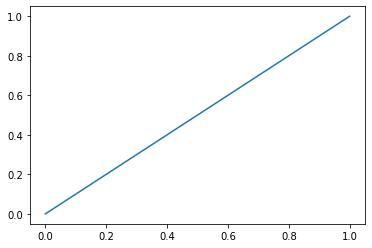

threshold =  0.2


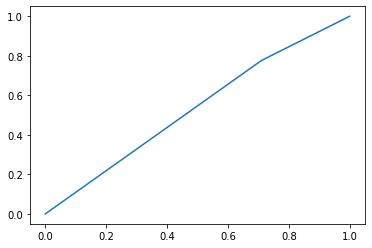

threshold =  0.4


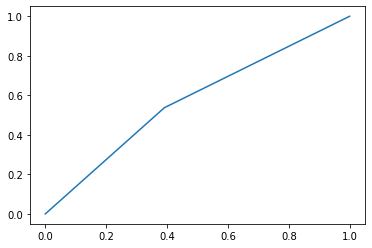

threshold =  0.5


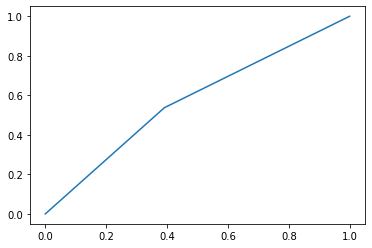

threshold =  0.7


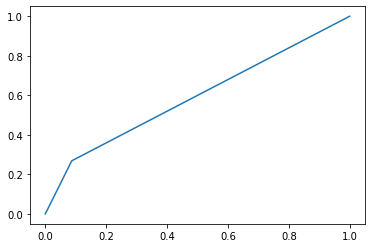

threshold =  0.8


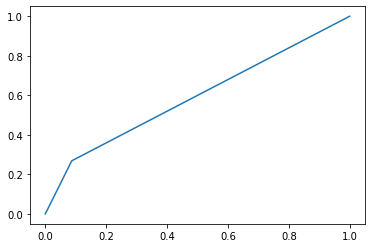

auto threshold


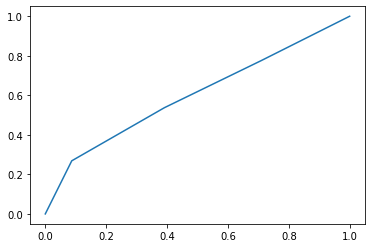

neighbours = 3 err_train = 0.08444444444444445 err_test = 0.4264705882352941
[[42 27]
 [31 36]]
Mera F1 Train: 0.5538461538461538
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


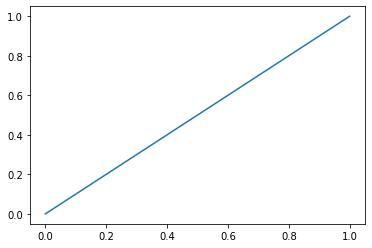

threshold =  0.2


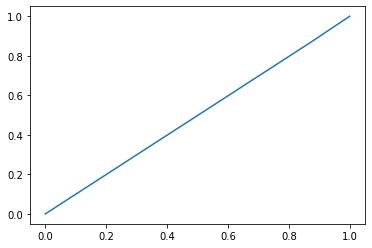

threshold =  0.4


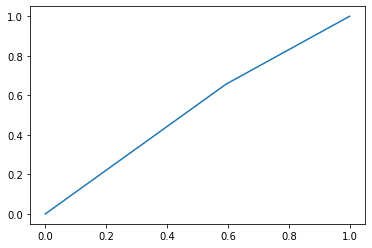

threshold =  0.5


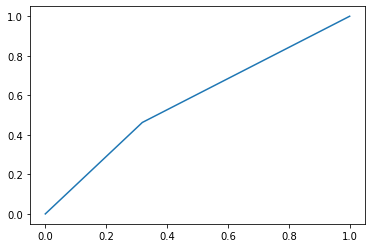

threshold =  0.7


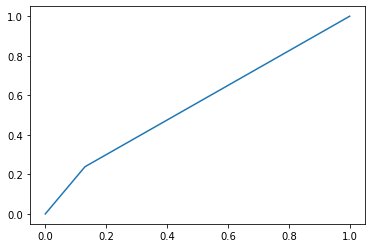

threshold =  0.8


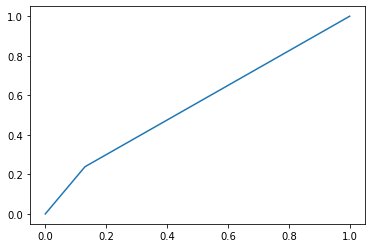

auto threshold


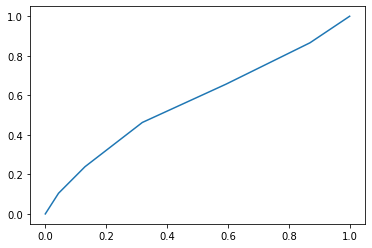

neighbours = 5 err_train = 0.11555555555555555 err_test = 0.4264705882352941
[[47 22]
 [36 31]]
Mera F1 Train: 0.5166666666666667
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


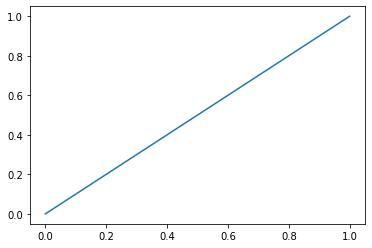

threshold =  0.2


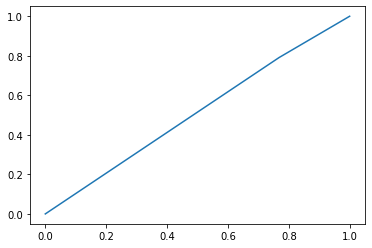

threshold =  0.4


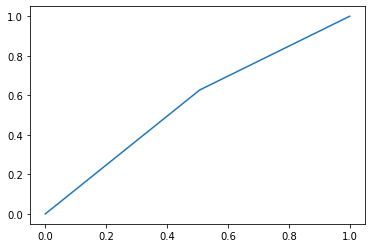

threshold =  0.5


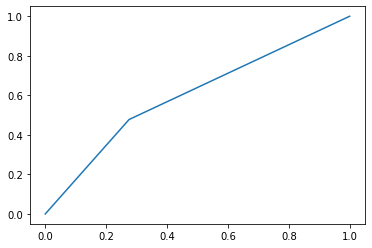

threshold =  0.7


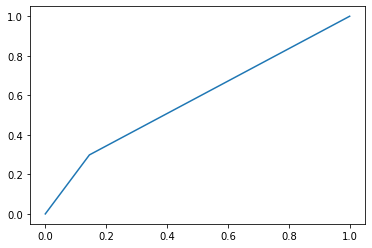

threshold =  0.8


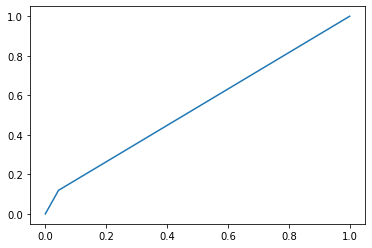

auto threshold


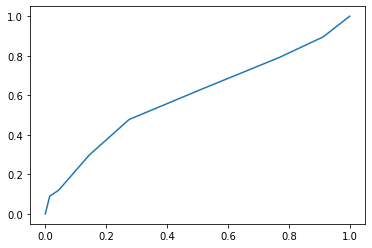

neighbours = 7 err_train = 0.15555555555555556 err_test = 0.39705882352941174
[[50 19]
 [35 32]]
Mera F1 Train: 0.5423728813559322
Precision Score Train:  0.6029411764705882
Recall Score Train:  0.6029411764705882
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


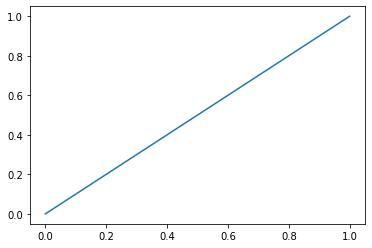

threshold =  0.2


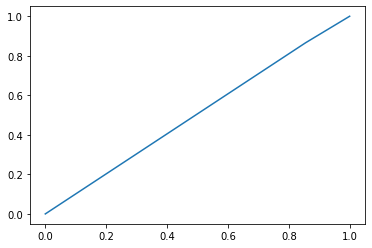

threshold =  0.4


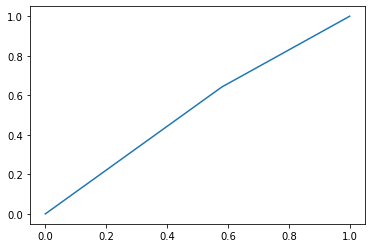

threshold =  0.5


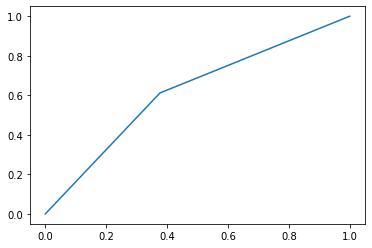

threshold =  0.7


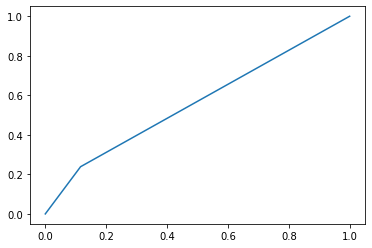

threshold =  0.8


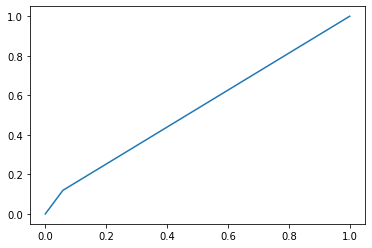

auto threshold


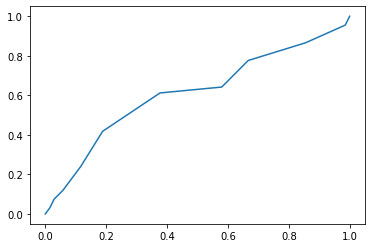

neighbours = 10 err_train = 0.21777777777777776 err_test = 0.38235294117647056
[[56 13]
 [39 28]]
Mera F1 Train: 0.5185185185185185
Precision Score Train:  0.6176470588235294
Recall Score Train:  0.6176470588235294
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


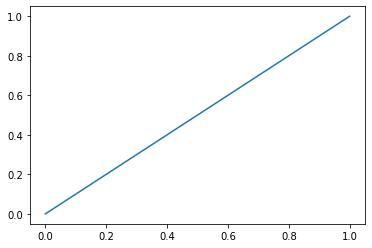

threshold =  0.2


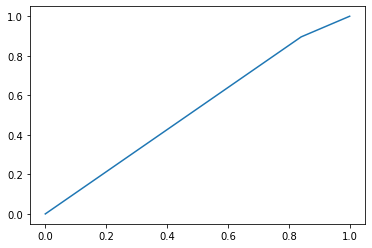

threshold =  0.4


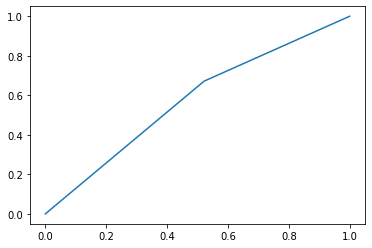

threshold =  0.5


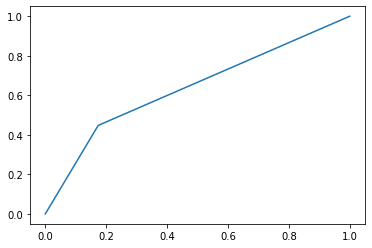

threshold =  0.7


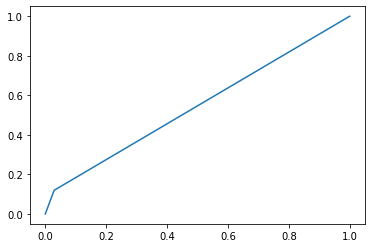

threshold =  0.8


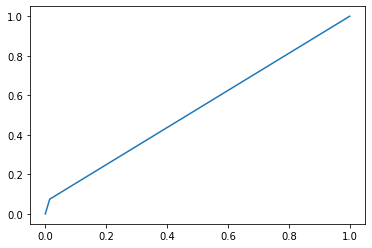

auto threshold


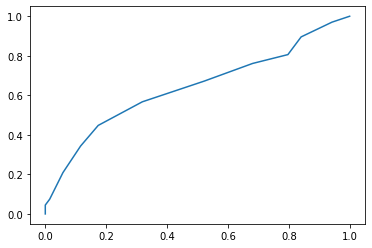

neighbours = 15 err_train = 0.2088888888888889 err_test = 0.3602941176470588
[[57 12]
 [37 30]]
Mera F1 Train: 0.5504587155963303
Precision Score Train:  0.6397058823529411
Recall Score Train:  0.6397058823529411
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


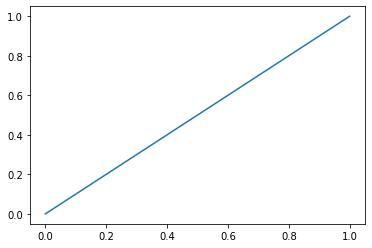

threshold =  0.2


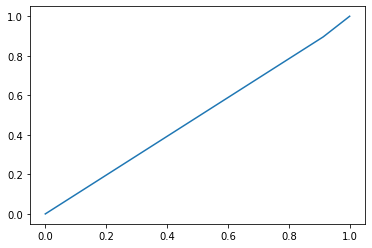

threshold =  0.4


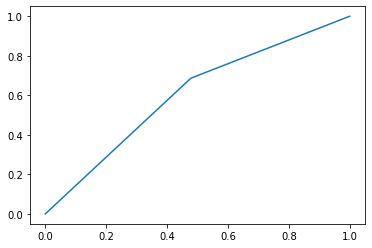

threshold =  0.5


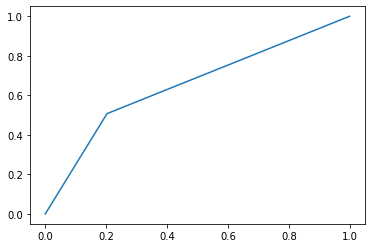

threshold =  0.7


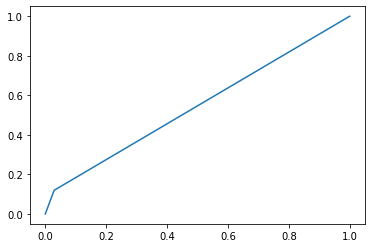

threshold =  0.8


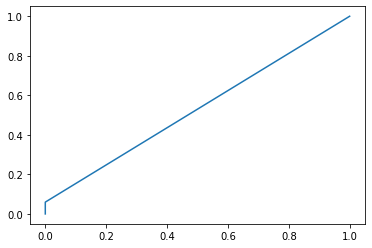

auto threshold


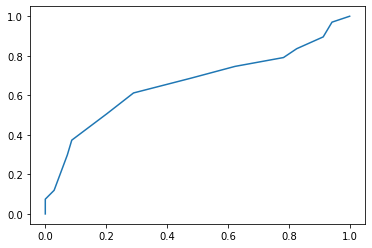

neighbours = 20 err_train = 0.28 err_test = 0.35294117647058826
[[63  6]
 [42 25]]
Mera F1 Train: 0.5102040816326532
Precision Score Train:  0.6470588235294118
Recall Score Train:  0.6470588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


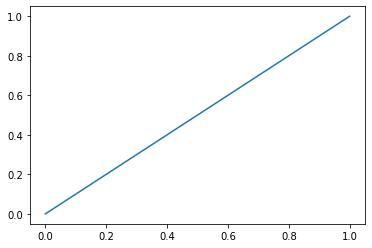

threshold =  0.2


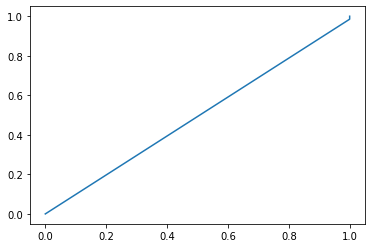

threshold =  0.4


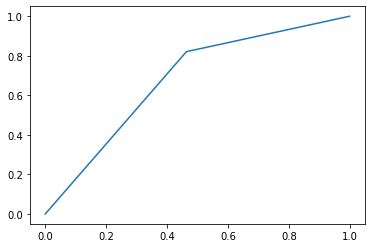

threshold =  0.5


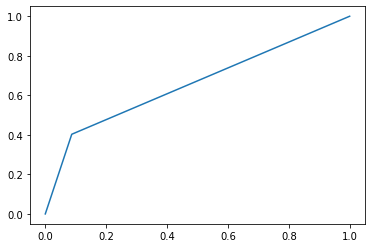

threshold =  0.7


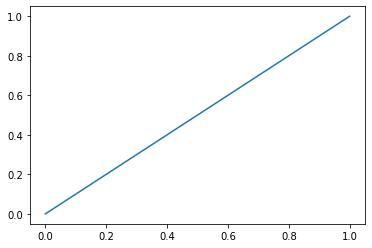

threshold =  0.8


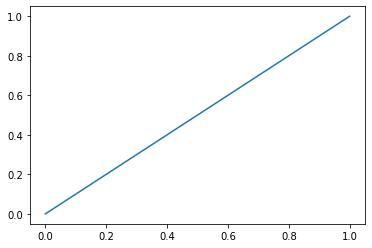

auto threshold


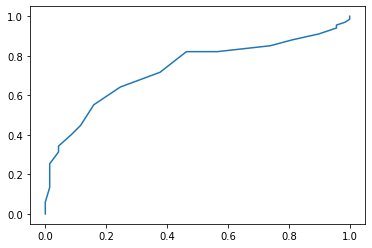

neighbours = 50 err_train = 0.39555555555555555 err_test = 0.34558823529411764
[[66  3]
 [44 23]]
Mera F1 Train: 0.49462365591397855
Precision Score Train:  0.6544117647058824
Recall Score Train:  0.6544117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


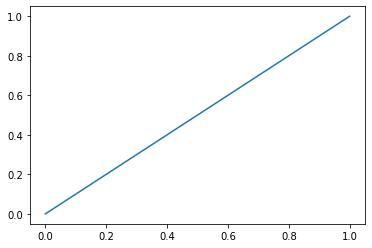

threshold =  0.2


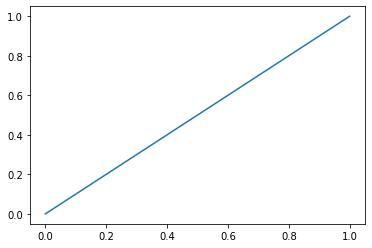

threshold =  0.4


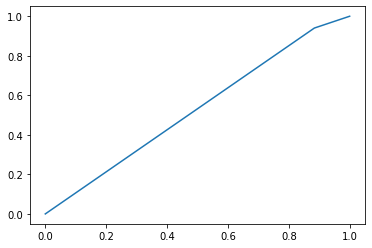

threshold =  0.5


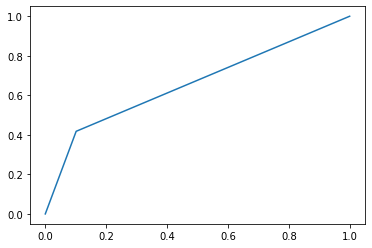

threshold =  0.7


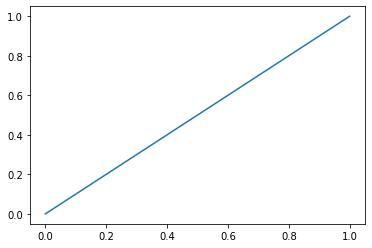

threshold =  0.8


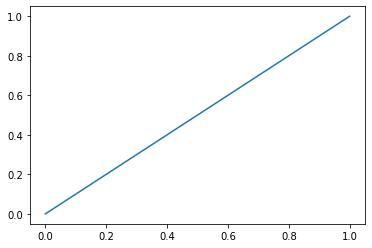

auto threshold


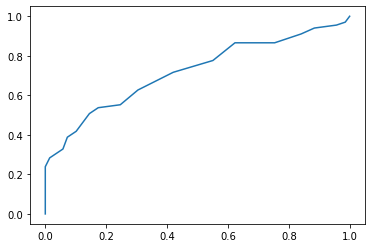

neighbours = 100 err_train = 0.4177777777777778 err_test = 0.3382352941176471
[[64  5]
 [41 26]]
Mera F1 Train: 0.5306122448979592
Precision Score Train:  0.6617647058823529
Recall Score Train:  0.6617647058823529


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [443]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[7][i]=err_test
    Knn_train[7][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [444]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[7]= err_test
SVC_train[7]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.16 err_test_SVC = 0.3897058823529412


# RepeatedEditedNearestNeighbours

In [445]:
from imblearn.under_sampling import RepeatedEditedNearestNeighbours
renn = RepeatedEditedNearestNeighbours()
X_resampled, y_resampled = renn.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 85), (1, 140)]


## Knn

threshold =  0.0


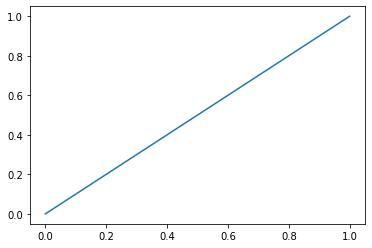

threshold =  0.2


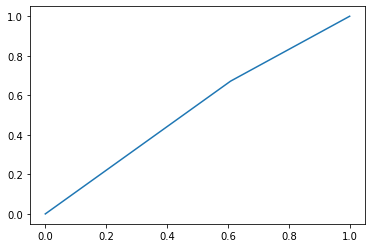

threshold =  0.4


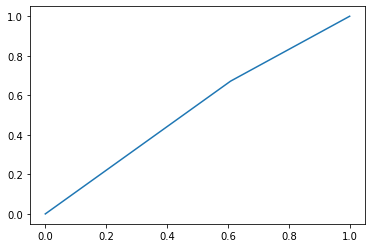

threshold =  0.5


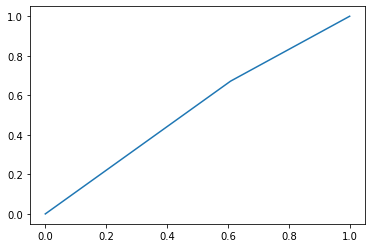

threshold =  0.7


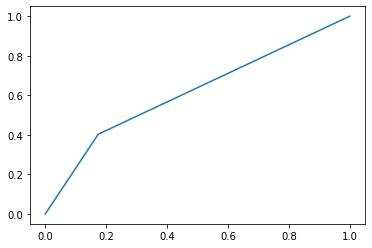

threshold =  0.8


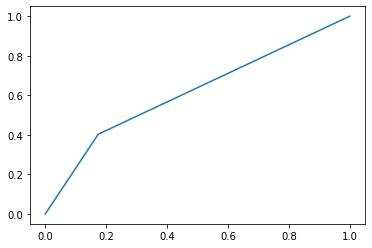

auto threshold


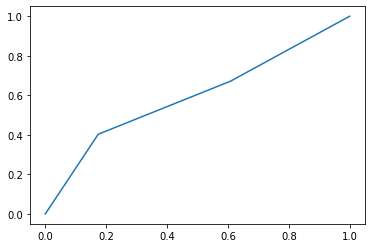

neighbours = 2 err_train = 0.16444444444444445 err_test = 0.38235294117647056
[[57 12]
 [40 27]]
Mera F1 Train: 0.5094339622641508
Precision Score Train:  0.6176470588235294
Recall Score Train:  0.6176470588235294
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


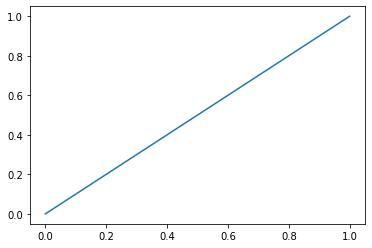

threshold =  0.2


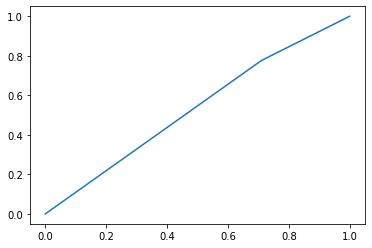

threshold =  0.4


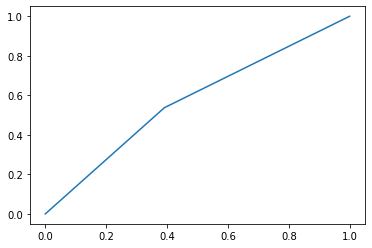

threshold =  0.5


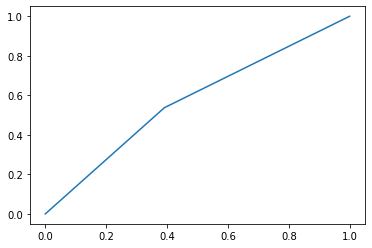

threshold =  0.7


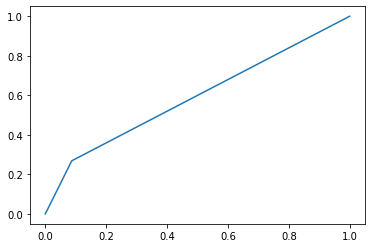

threshold =  0.8


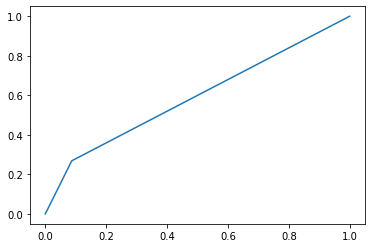

auto threshold


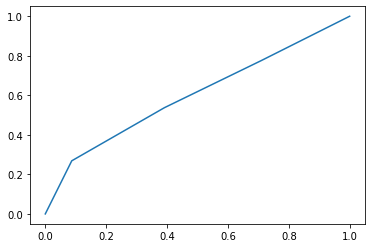

neighbours = 3 err_train = 0.08444444444444445 err_test = 0.4264705882352941
[[42 27]
 [31 36]]
Mera F1 Train: 0.5538461538461538
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


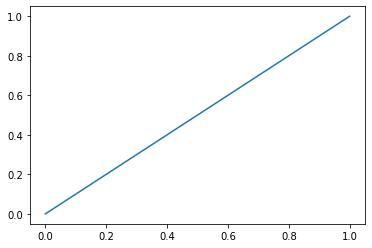

threshold =  0.2


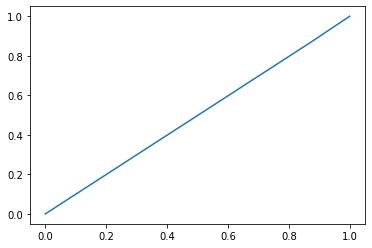

threshold =  0.4


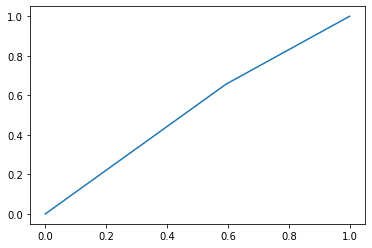

threshold =  0.5


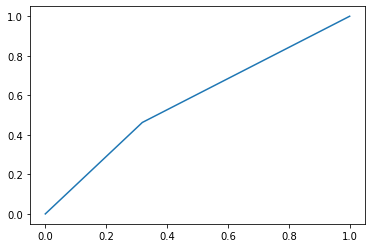

threshold =  0.7


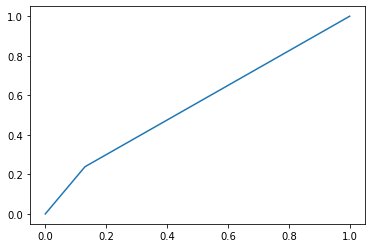

threshold =  0.8


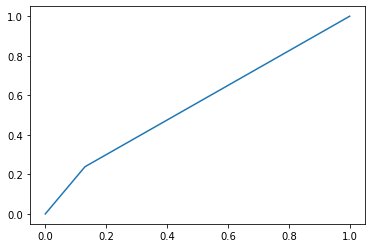

auto threshold


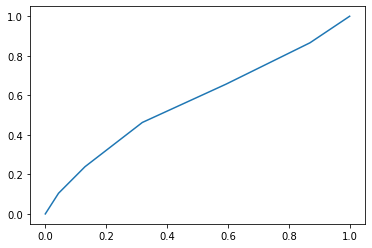

neighbours = 5 err_train = 0.11555555555555555 err_test = 0.4264705882352941
[[47 22]
 [36 31]]
Mera F1 Train: 0.5166666666666667
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


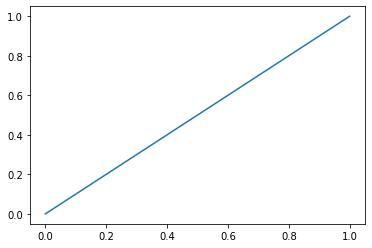

threshold =  0.2


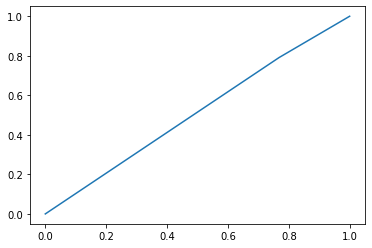

threshold =  0.4


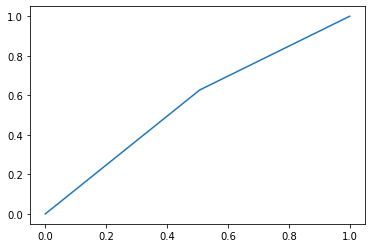

threshold =  0.5


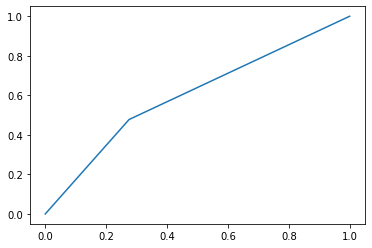

threshold =  0.7


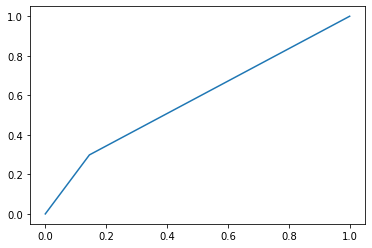

threshold =  0.8


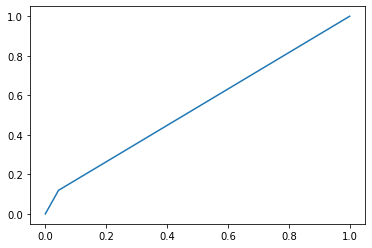

auto threshold


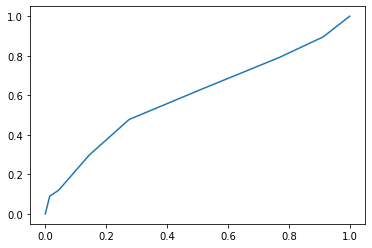

neighbours = 7 err_train = 0.15555555555555556 err_test = 0.39705882352941174
[[50 19]
 [35 32]]
Mera F1 Train: 0.5423728813559322
Precision Score Train:  0.6029411764705882
Recall Score Train:  0.6029411764705882
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


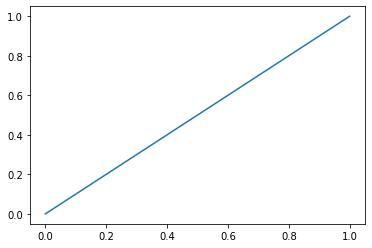

threshold =  0.2


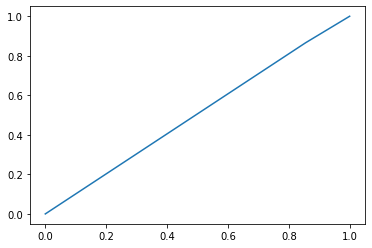

threshold =  0.4


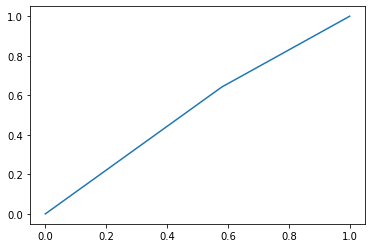

threshold =  0.5


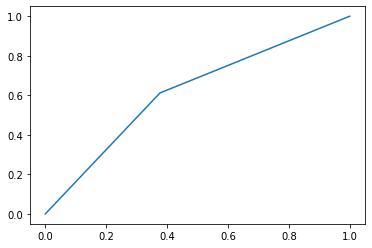

threshold =  0.7


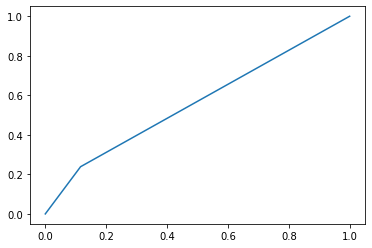

threshold =  0.8


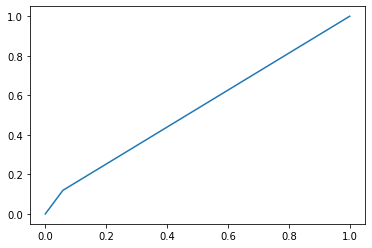

auto threshold


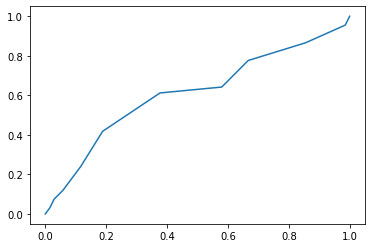

neighbours = 10 err_train = 0.21777777777777776 err_test = 0.38235294117647056
[[56 13]
 [39 28]]
Mera F1 Train: 0.5185185185185185
Precision Score Train:  0.6176470588235294
Recall Score Train:  0.6176470588235294
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


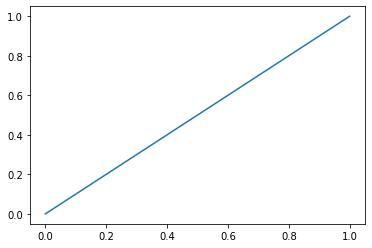

threshold =  0.2


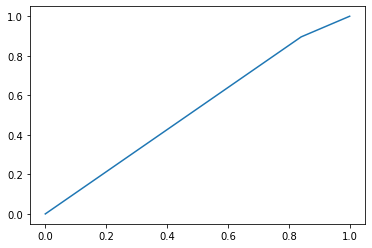

threshold =  0.4


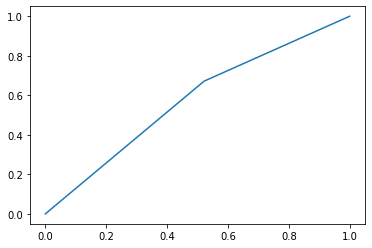

threshold =  0.5


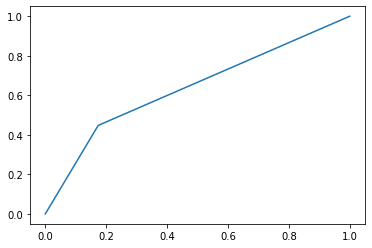

threshold =  0.7


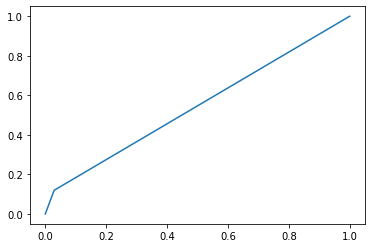

threshold =  0.8


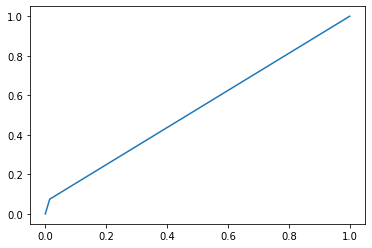

auto threshold


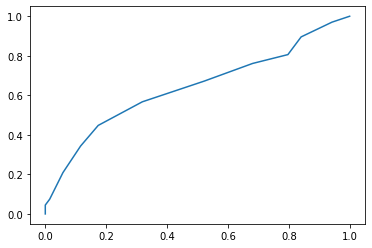

neighbours = 15 err_train = 0.2088888888888889 err_test = 0.3602941176470588
[[57 12]
 [37 30]]
Mera F1 Train: 0.5504587155963303
Precision Score Train:  0.6397058823529411
Recall Score Train:  0.6397058823529411
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


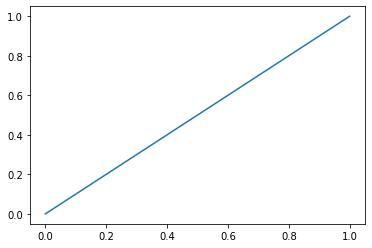

threshold =  0.2


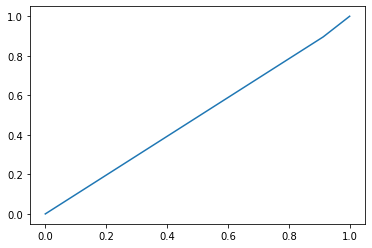

threshold =  0.4


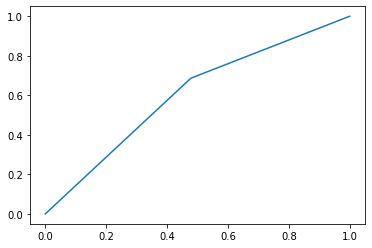

threshold =  0.5


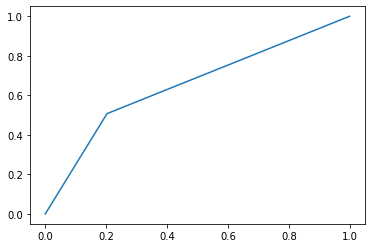

threshold =  0.7


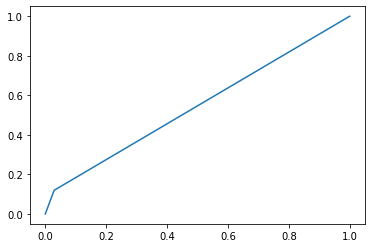

threshold =  0.8


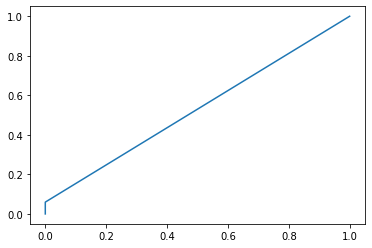

auto threshold


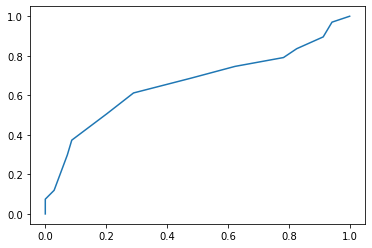

neighbours = 20 err_train = 0.28 err_test = 0.35294117647058826
[[63  6]
 [42 25]]
Mera F1 Train: 0.5102040816326532
Precision Score Train:  0.6470588235294118
Recall Score Train:  0.6470588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


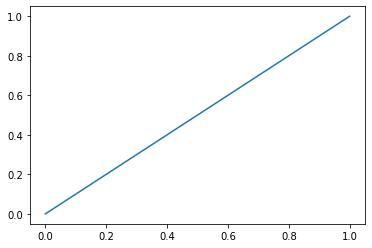

threshold =  0.2


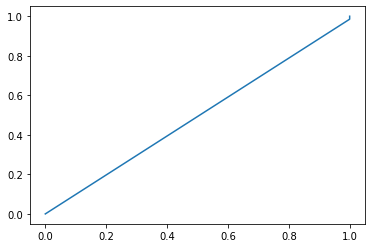

threshold =  0.4


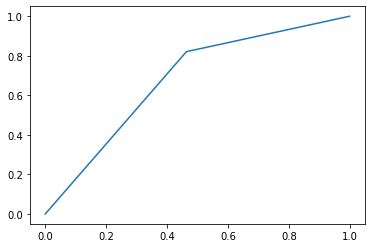

threshold =  0.5


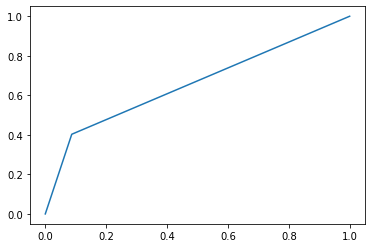

threshold =  0.7


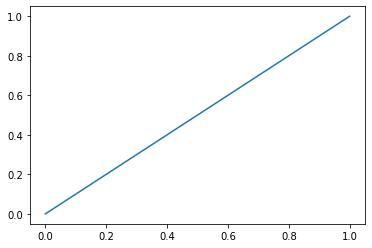

threshold =  0.8


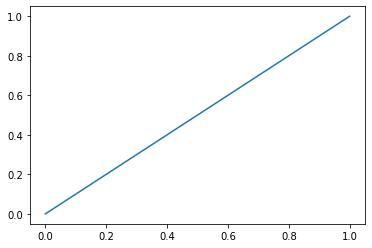

auto threshold


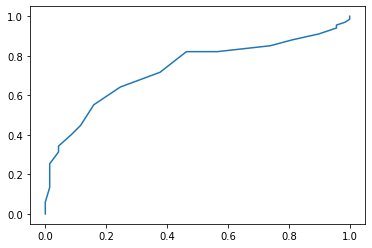

neighbours = 50 err_train = 0.39555555555555555 err_test = 0.34558823529411764
[[66  3]
 [44 23]]
Mera F1 Train: 0.49462365591397855
Precision Score Train:  0.6544117647058824
Recall Score Train:  0.6544117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


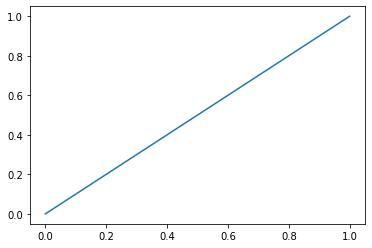

threshold =  0.2


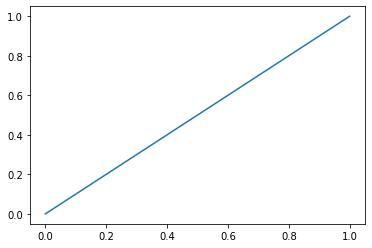

threshold =  0.4


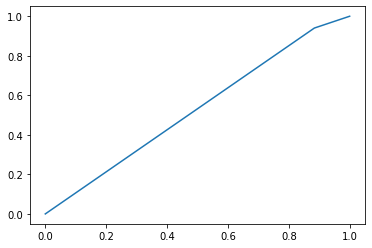

threshold =  0.5


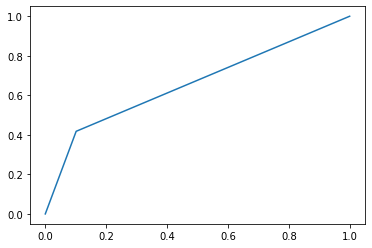

threshold =  0.7


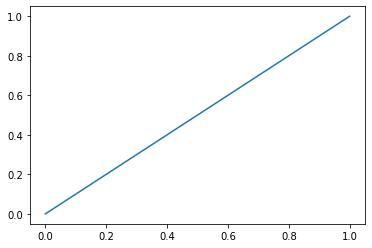

threshold =  0.8


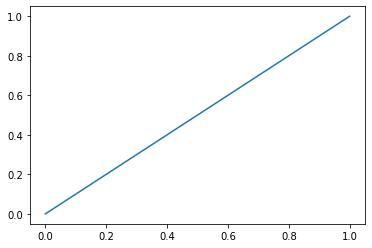

auto threshold


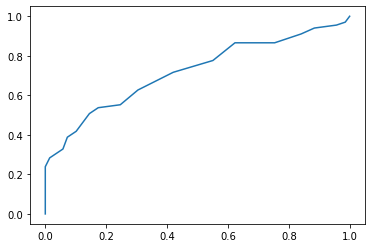

neighbours = 100 err_train = 0.4177777777777778 err_test = 0.3382352941176471
[[64  5]
 [41 26]]
Mera F1 Train: 0.5306122448979592
Precision Score Train:  0.6617647058823529
Recall Score Train:  0.6617647058823529


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [446]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[8][i]=err_test
    Knn_train[8][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [447]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[8]= err_test
SVC_train[8]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.16 err_test_SVC = 0.3897058823529412


# AllKNN

In [448]:
from imblearn.under_sampling import AllKNN
allknn = AllKNN()
X_resampled, y_resampled = allknn.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 132), (1, 52)]


## Knn

threshold =  0.0


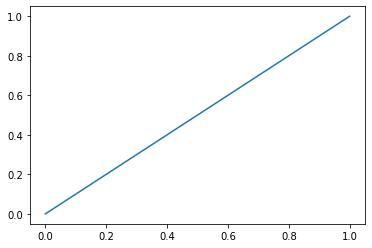

threshold =  0.2


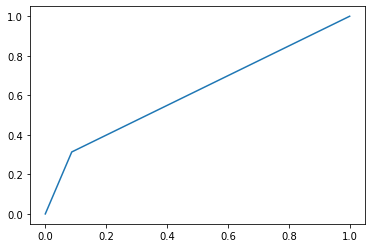

threshold =  0.4


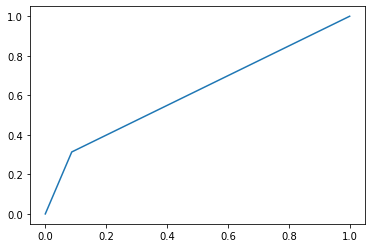

threshold =  0.5


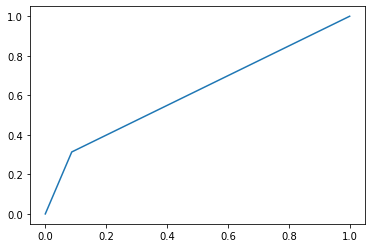

threshold =  0.7


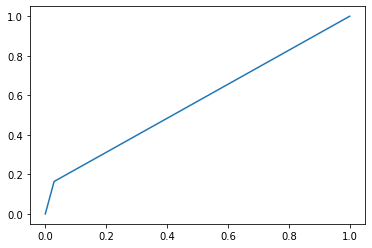

threshold =  0.8


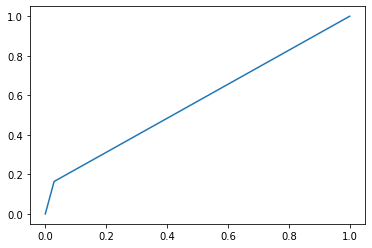

auto threshold


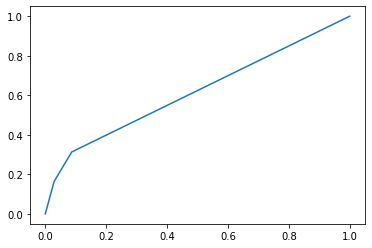

neighbours = 2 err_train = 0.06521739130434782 err_test = 0.4264705882352941
[[67  2]
 [56 11]]
Mera F1 Train: 0.275
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


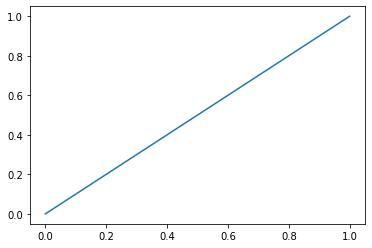

threshold =  0.2


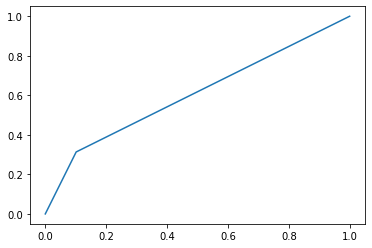

threshold =  0.4


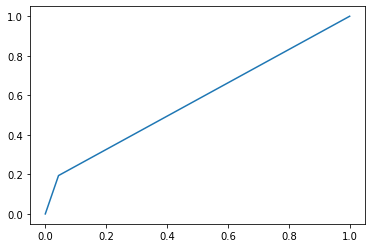

threshold =  0.5


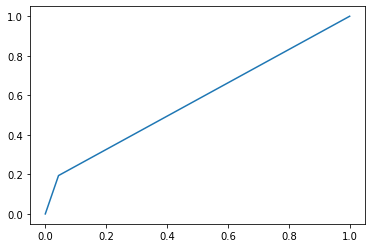

threshold =  0.7


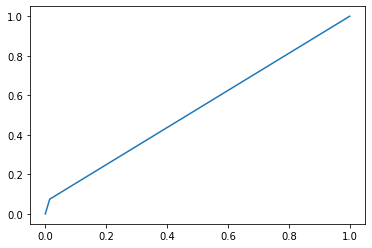

threshold =  0.8


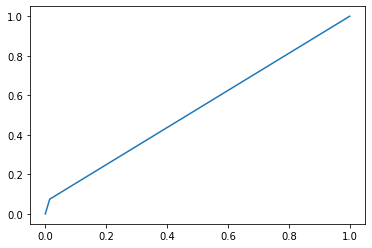

auto threshold


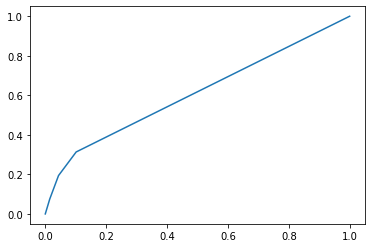

neighbours = 3 err_train = 0.05434782608695652 err_test = 0.41911764705882354
[[66  3]
 [54 13]]
Mera F1 Train: 0.3132530120481928
Precision Score Train:  0.5808823529411765
Recall Score Train:  0.5808823529411765
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


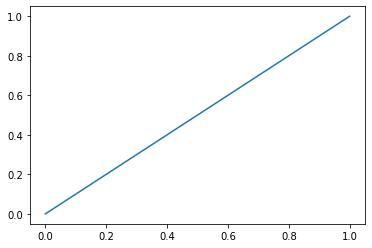

threshold =  0.2


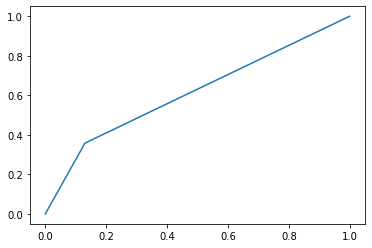

threshold =  0.4


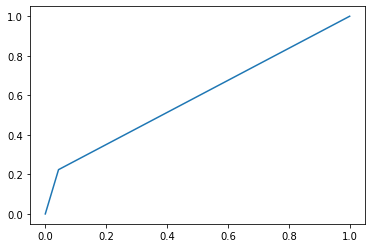

threshold =  0.5


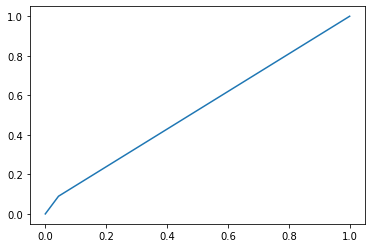

threshold =  0.7


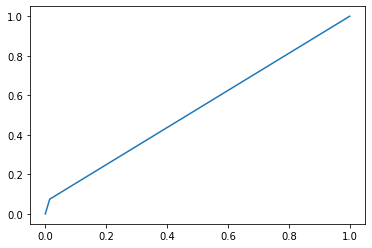

threshold =  0.8


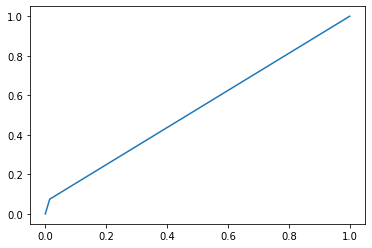

auto threshold


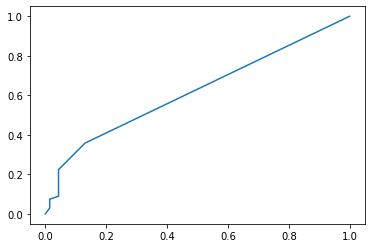

neighbours = 5 err_train = 0.09782608695652174 err_test = 0.47058823529411764
[[66  3]
 [61  6]]
Mera F1 Train: 0.15789473684210525
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


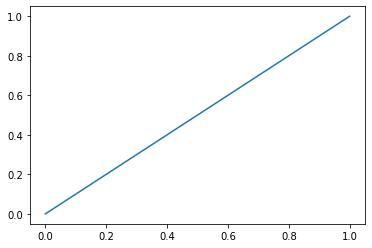

threshold =  0.2


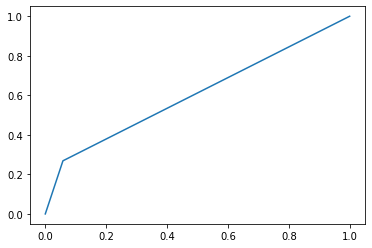

threshold =  0.4


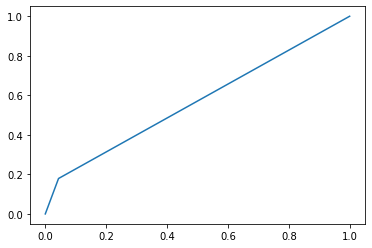

threshold =  0.5


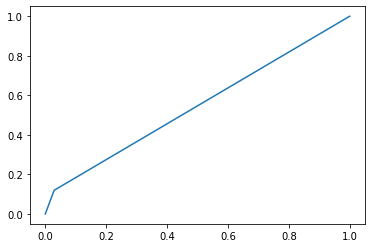

threshold =  0.7


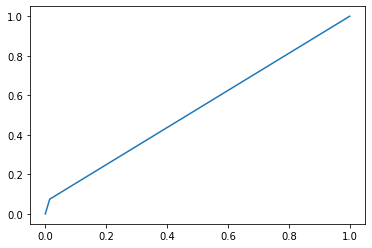

threshold =  0.8


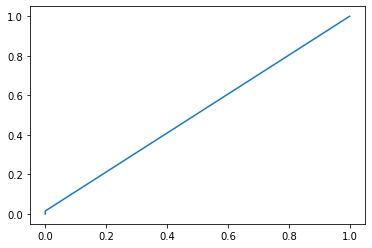

auto threshold


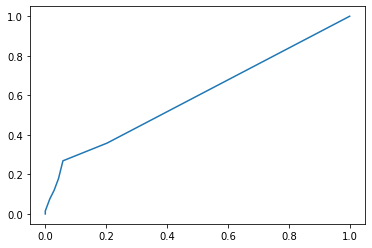

neighbours = 7 err_train = 0.11956521739130435 err_test = 0.4485294117647059
[[67  2]
 [59  8]]
Mera F1 Train: 0.20779220779220778
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


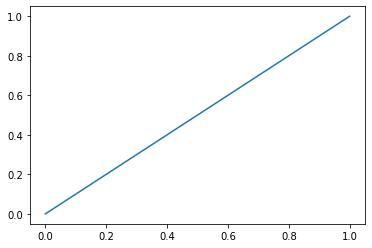

threshold =  0.2


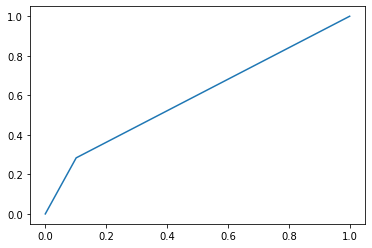

threshold =  0.4


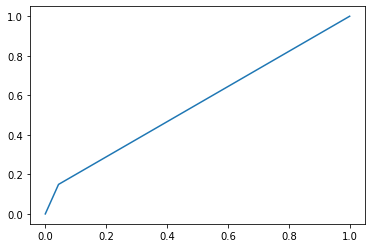

threshold =  0.5


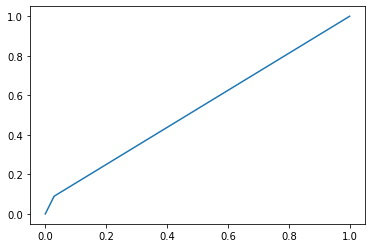

threshold =  0.7


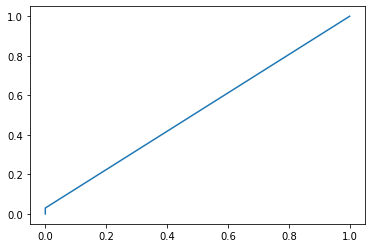

threshold =  0.8


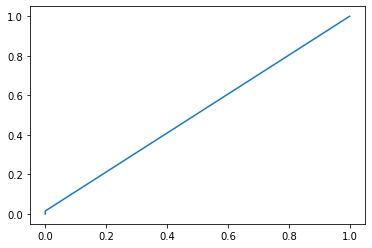

auto threshold


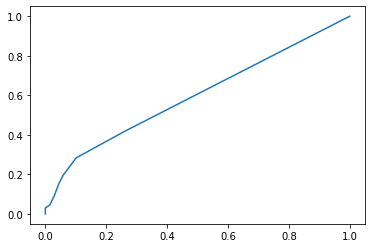

neighbours = 10 err_train = 0.21195652173913043 err_test = 0.47794117647058826
[[68  1]
 [64  3]]
Mera F1 Train: 0.08450704225352113
Precision Score Train:  0.5220588235294118
Recall Score Train:  0.5220588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


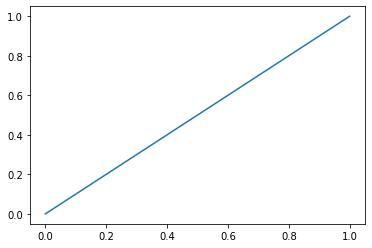

threshold =  0.2


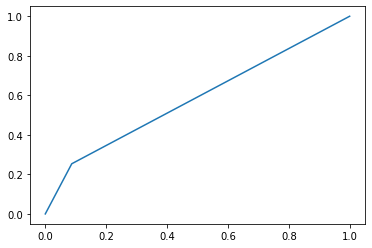

threshold =  0.4


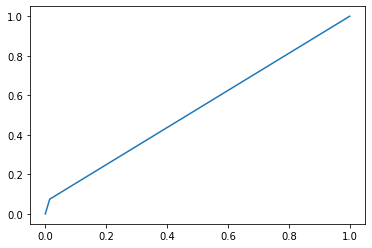

threshold =  0.5


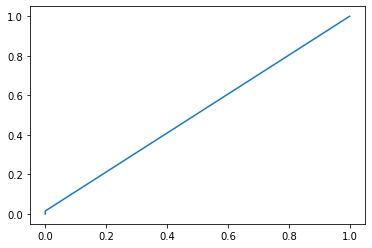

threshold =  0.7


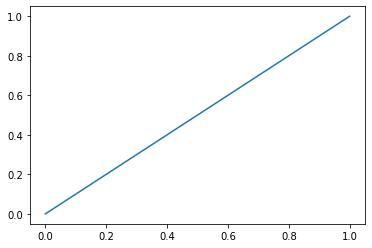

threshold =  0.8


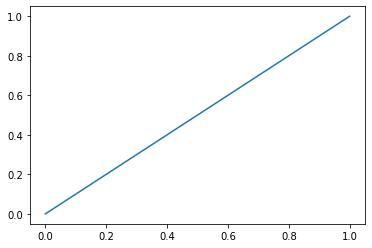

auto threshold


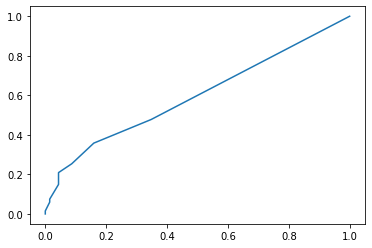

neighbours = 15 err_train = 0.25 err_test = 0.4852941176470588
[[69  0]
 [66  1]]
Mera F1 Train: 0.029411764705882353
Precision Score Train:  0.5147058823529411
Recall Score Train:  0.5147058823529411
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


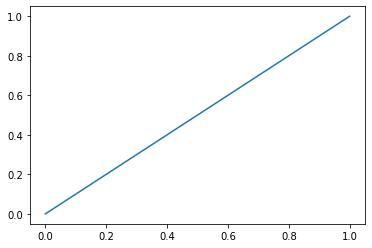

threshold =  0.2


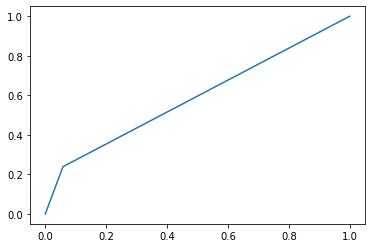

threshold =  0.4


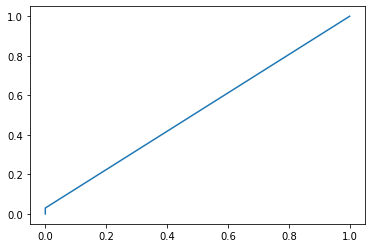

threshold =  0.5


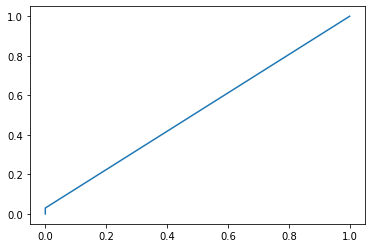

threshold =  0.7


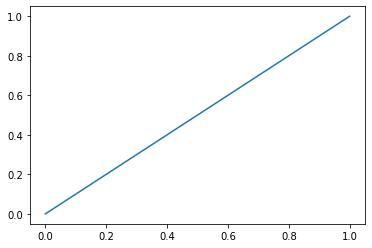

threshold =  0.8


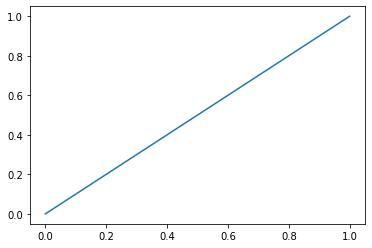

auto threshold


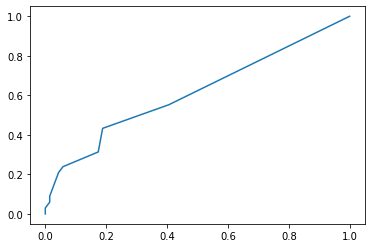

neighbours = 20 err_train = 0.27717391304347827 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


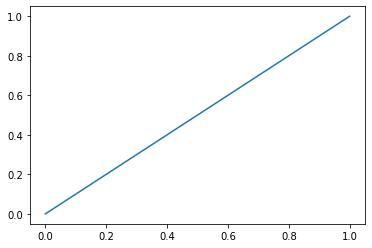

threshold =  0.2


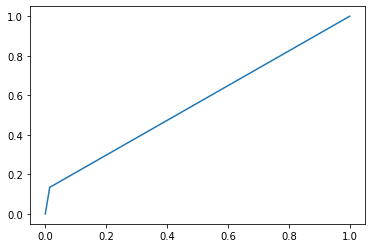

threshold =  0.4


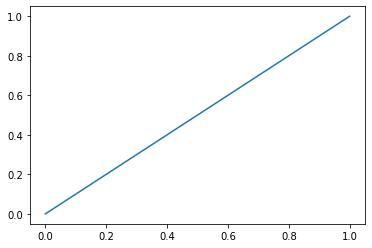

threshold =  0.5


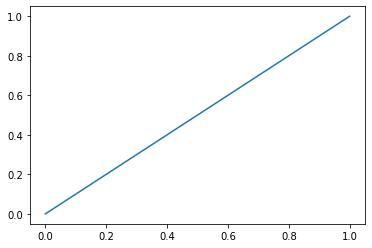

threshold =  0.7


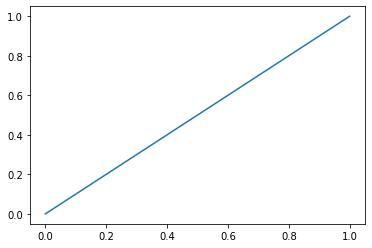

threshold =  0.8


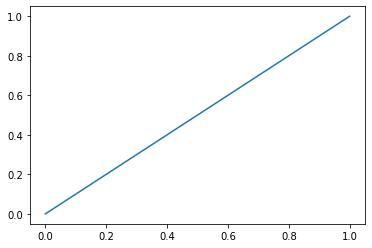

auto threshold


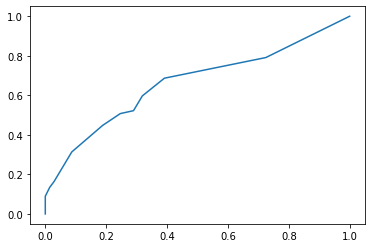

neighbours = 50 err_train = 0.2826086956521739 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


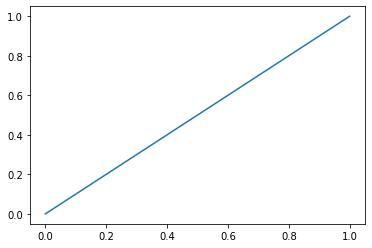

threshold =  0.2


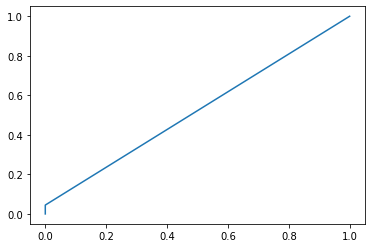

threshold =  0.4


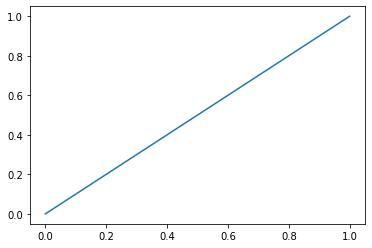

threshold =  0.5


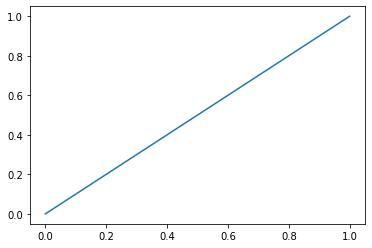

threshold =  0.7


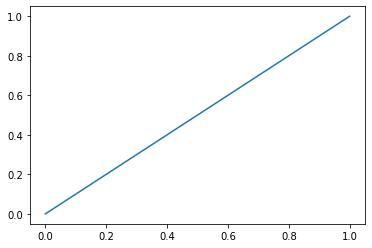

threshold =  0.8


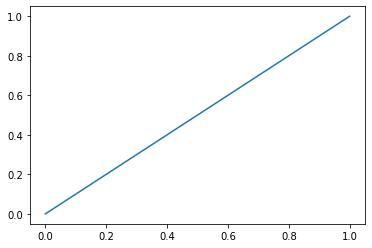

auto threshold


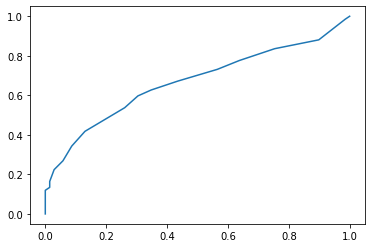

neighbours = 100 err_train = 0.2826086956521739 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [449]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[9][i]=err_test
    Knn_train[9][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [450]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[9]= err_test
SVC_train[9]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.07065217391304347 err_test_SVC = 0.375


# Condensed nearest neighbors and derived algorithms

# CondensedNearestNeighbour

In [451]:
from imblearn.under_sampling import CondensedNearestNeighbour
cnn = CondensedNearestNeighbour(random_state=0)
X_resampled, y_resampled = cnn.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 69), (1, 140)]


## Knn

threshold =  0.0


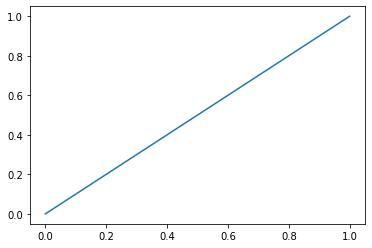

threshold =  0.2


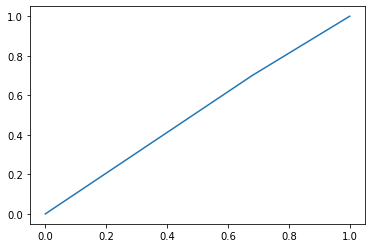

threshold =  0.4


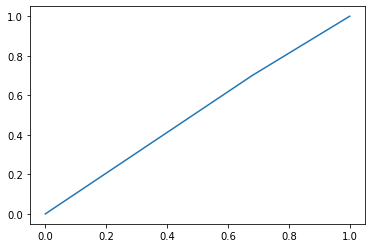

threshold =  0.5


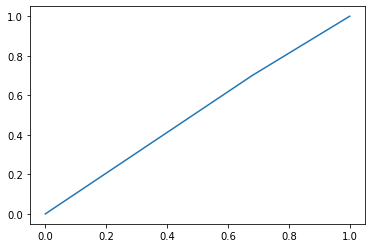

threshold =  0.7


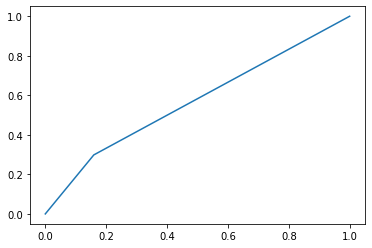

threshold =  0.8


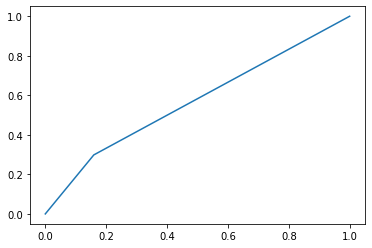

auto threshold


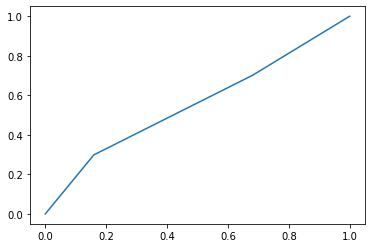

neighbours = 2 err_train = 0.24401913875598086 err_test = 0.4264705882352941
[[58 11]
 [47 20]]
Mera F1 Train: 0.4081632653061224
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


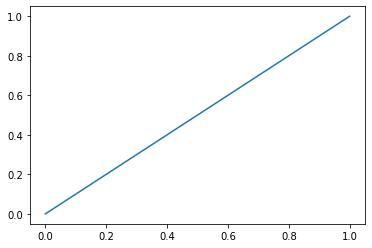

threshold =  0.2


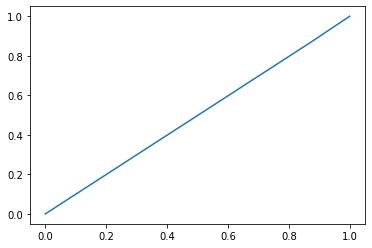

threshold =  0.4


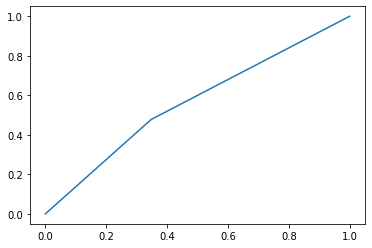

threshold =  0.5


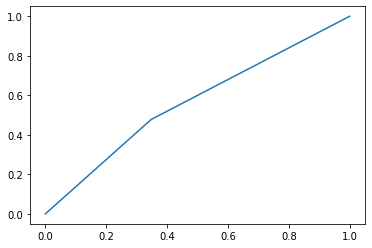

threshold =  0.7


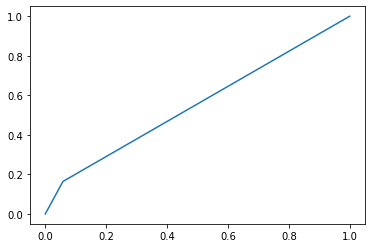

threshold =  0.8


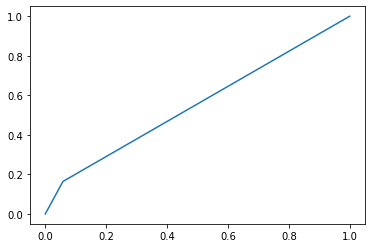

auto threshold


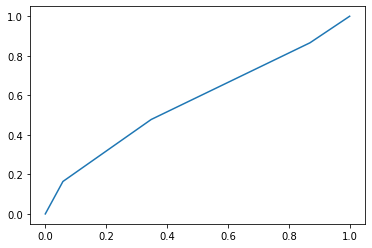

neighbours = 3 err_train = 0.19617224880382775 err_test = 0.4338235294117647
[[45 24]
 [35 32]]
Mera F1 Train: 0.5203252032520325
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


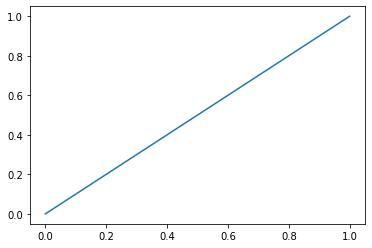

threshold =  0.2


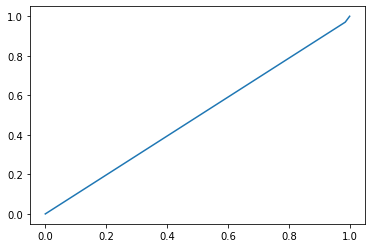

threshold =  0.4


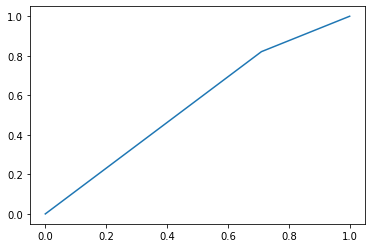

threshold =  0.5


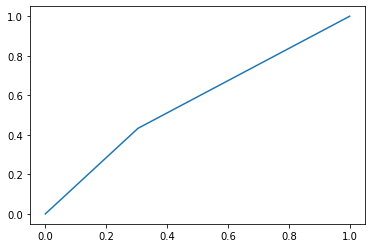

threshold =  0.7


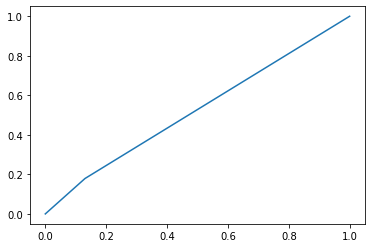

threshold =  0.8


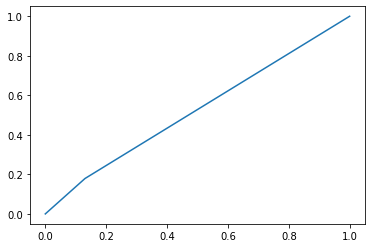

auto threshold


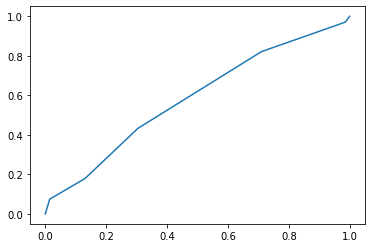

neighbours = 5 err_train = 0.23444976076555024 err_test = 0.4338235294117647
[[48 21]
 [38 29]]
Mera F1 Train: 0.4957264957264957
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


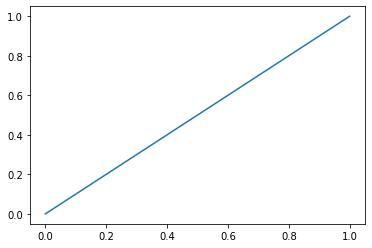

threshold =  0.2


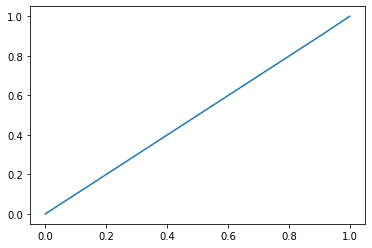

threshold =  0.4


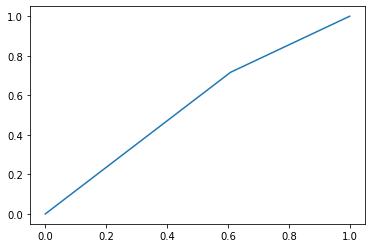

threshold =  0.5


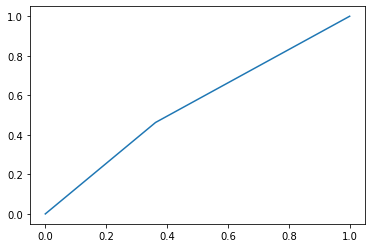

threshold =  0.7


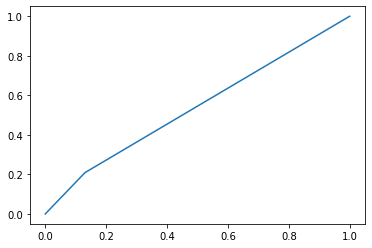

threshold =  0.8


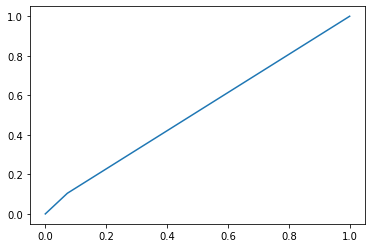

auto threshold


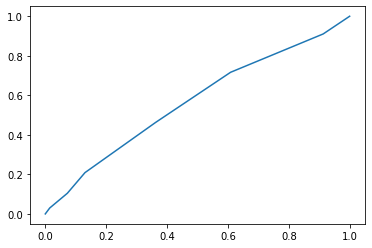

neighbours = 7 err_train = 0.291866028708134 err_test = 0.4485294117647059
[[44 25]
 [36 31]]
Mera F1 Train: 0.5040650406504066
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


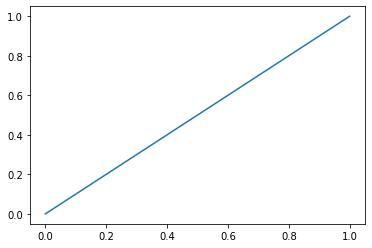

threshold =  0.2


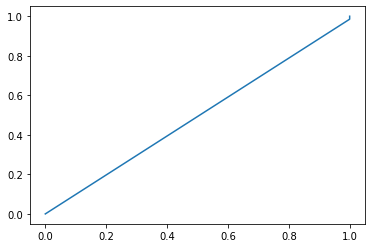

threshold =  0.4


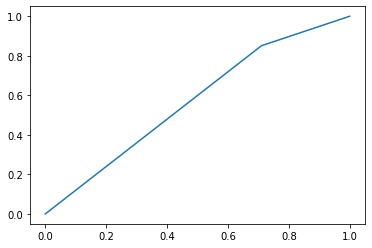

threshold =  0.5


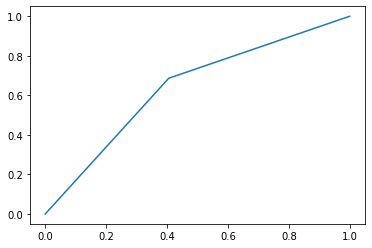

threshold =  0.7


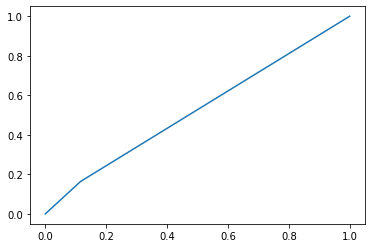

threshold =  0.8


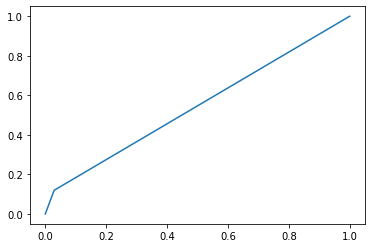

auto threshold


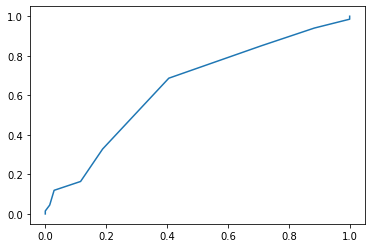

neighbours = 10 err_train = 0.3062200956937799 err_test = 0.4264705882352941
[[56 13]
 [45 22]]
Mera F1 Train: 0.4313725490196078
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


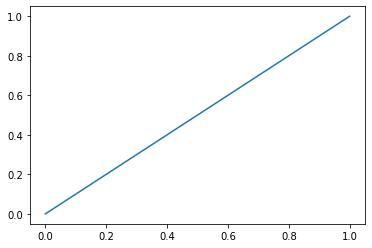

threshold =  0.2


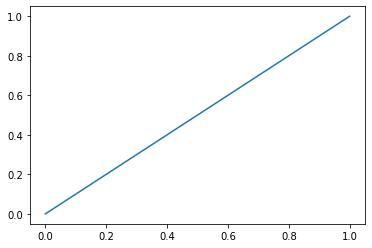

threshold =  0.4


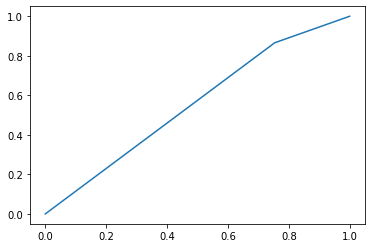

threshold =  0.5


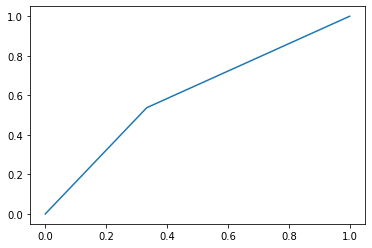

threshold =  0.7


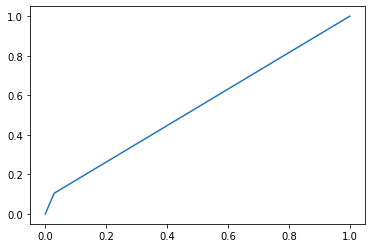

threshold =  0.8


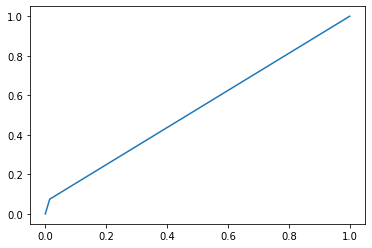

auto threshold


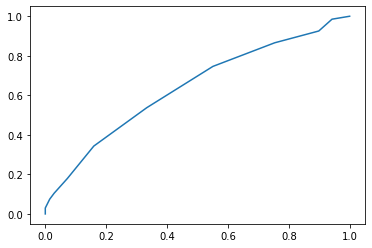

neighbours = 15 err_train = 0.2631578947368421 err_test = 0.39705882352941174
[[46 23]
 [31 36]]
Mera F1 Train: 0.5714285714285715
Precision Score Train:  0.6029411764705882
Recall Score Train:  0.6029411764705882
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


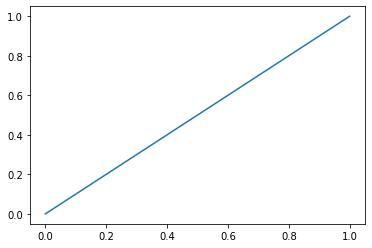

threshold =  0.2


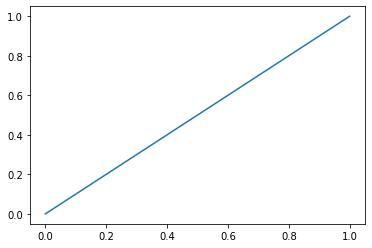

threshold =  0.4


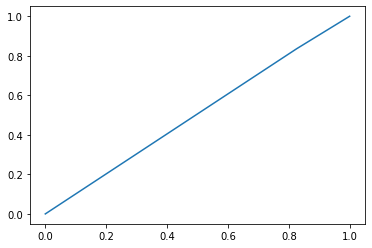

threshold =  0.5


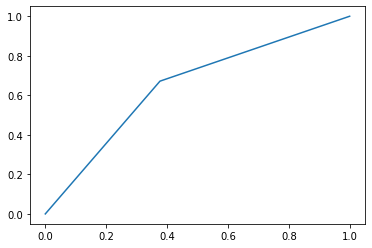

threshold =  0.7


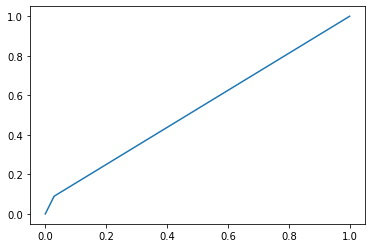

threshold =  0.8


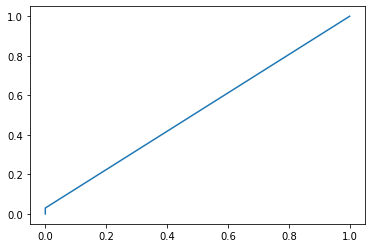

auto threshold


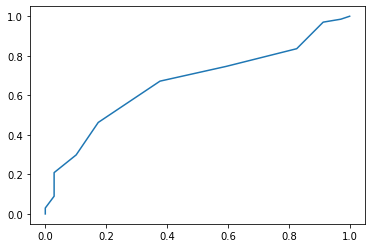

neighbours = 20 err_train = 0.3492822966507177 err_test = 0.35294117647058826
[[57 12]
 [36 31]]
Mera F1 Train: 0.5636363636363636
Precision Score Train:  0.6470588235294118
Recall Score Train:  0.6470588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


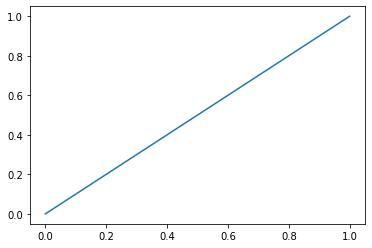

threshold =  0.2


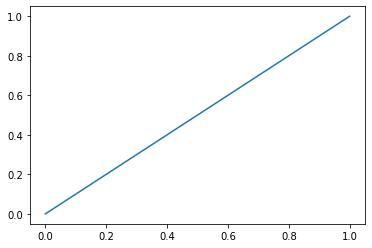

threshold =  0.4


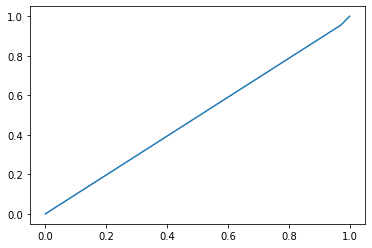

threshold =  0.5


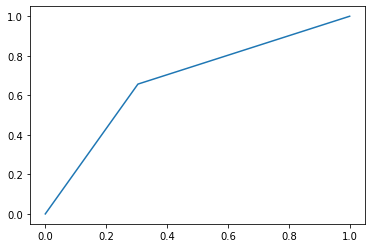

threshold =  0.7


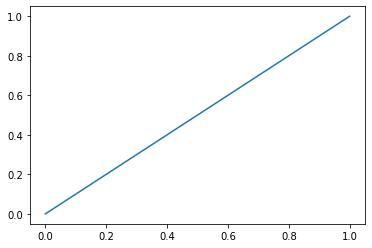

threshold =  0.8


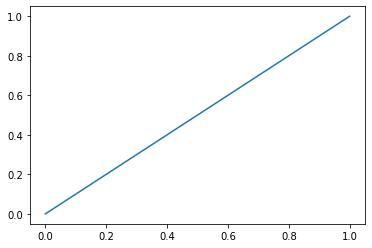

auto threshold


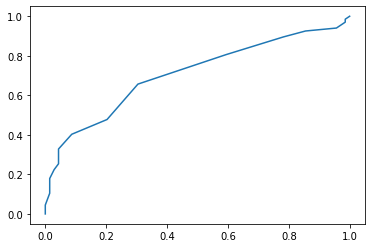

neighbours = 50 err_train = 0.3827751196172249 err_test = 0.3602941176470588
[[55 14]
 [35 32]]
Mera F1 Train: 0.5663716814159292
Precision Score Train:  0.6397058823529411
Recall Score Train:  0.6397058823529411
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


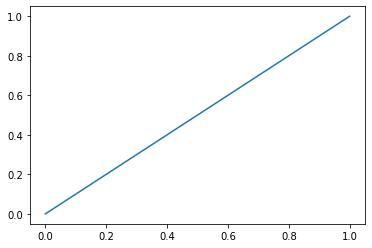

threshold =  0.2


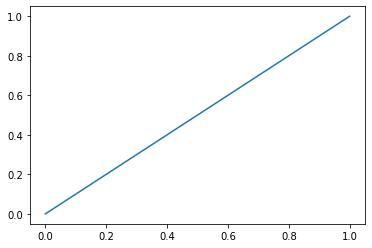

threshold =  0.4


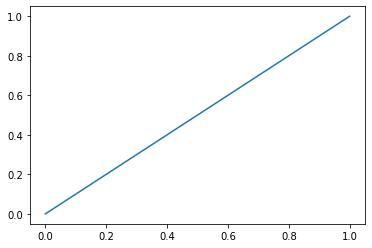

threshold =  0.5


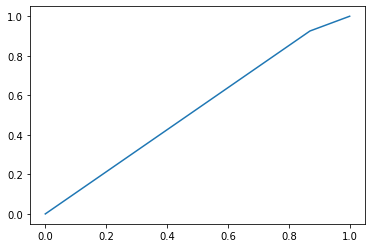

threshold =  0.7


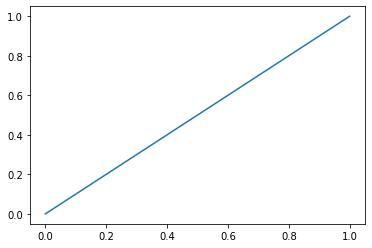

threshold =  0.8


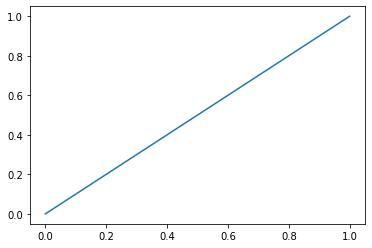

auto threshold


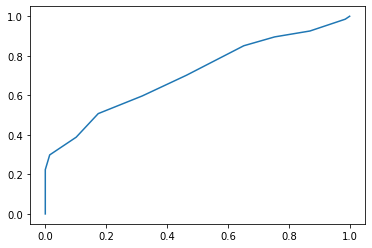

neighbours = 100 err_train = 0.33014354066985646 err_test = 0.4338235294117647
[[17 52]
 [ 7 60]]
Mera F1 Train: 0.6703910614525139
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [452]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[10][i]=err_test
    Knn_train[10][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [453]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[10]= err_test
SVC_train[10]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.33014354066985646 err_test_SVC = 0.5073529411764706


# OneSidedSelection

In [454]:
from imblearn.under_sampling import OneSidedSelection
oss = OneSidedSelection(random_state=0)
X_resampled, y_resampled = oss.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 160), (1, 140)]


## Knn

threshold =  0.0


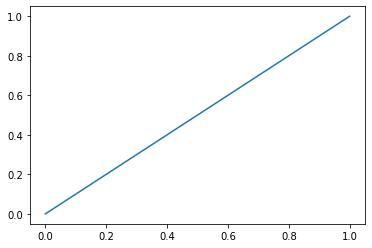

threshold =  0.2


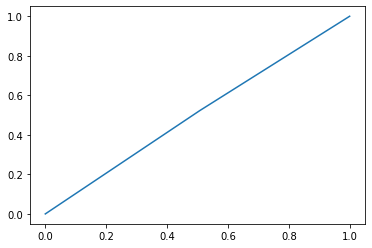

threshold =  0.4


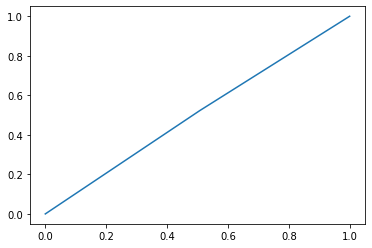

threshold =  0.5


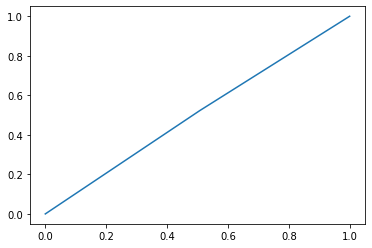

threshold =  0.7


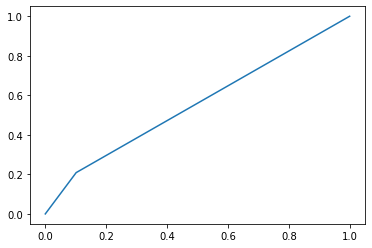

threshold =  0.8


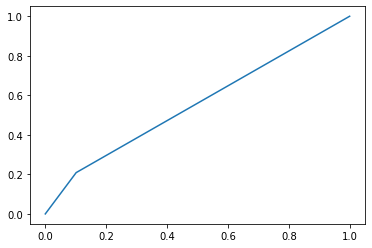

auto threshold


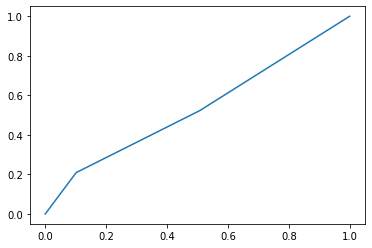

neighbours = 2 err_train = 0.2 err_test = 0.4411764705882353
[[62  7]
 [53 14]]
Mera F1 Train: 0.3181818181818181
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


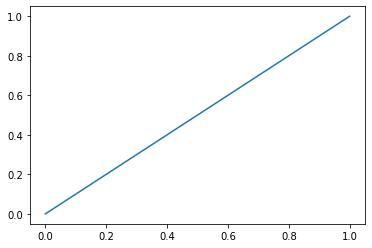

threshold =  0.2


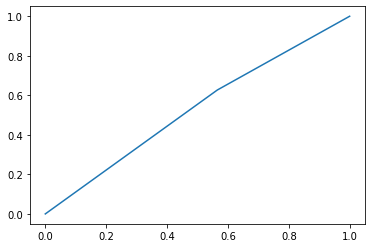

threshold =  0.4


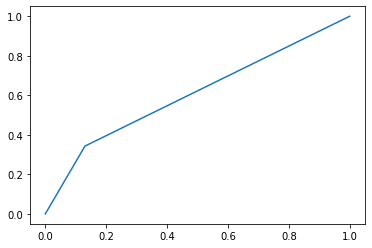

threshold =  0.5


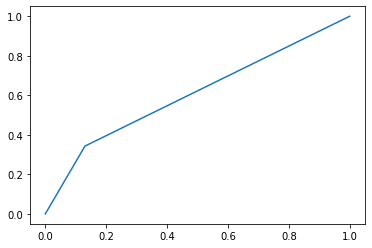

threshold =  0.7


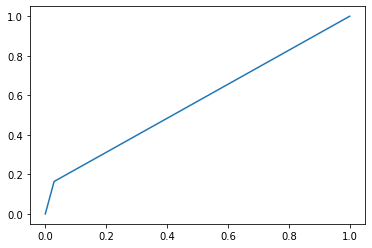

threshold =  0.8


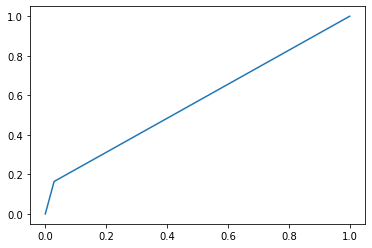

auto threshold


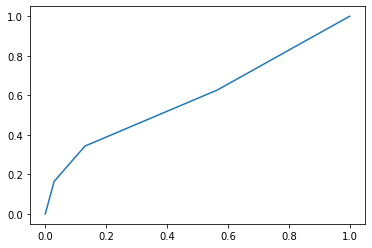

neighbours = 3 err_train = 0.15333333333333332 err_test = 0.3897058823529412
[[60  9]
 [44 23]]
Mera F1 Train: 0.4646464646464647
Precision Score Train:  0.6102941176470589
Recall Score Train:  0.6102941176470589
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


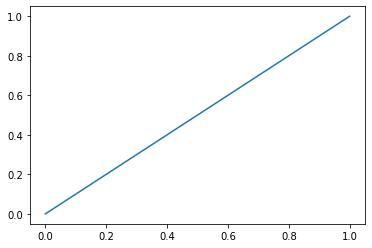

threshold =  0.2


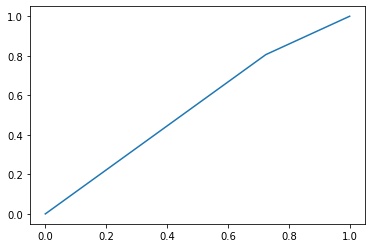

threshold =  0.4


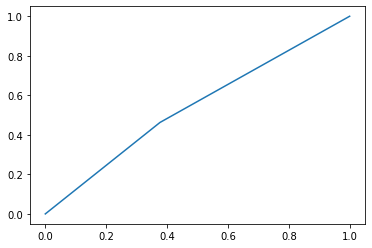

threshold =  0.5


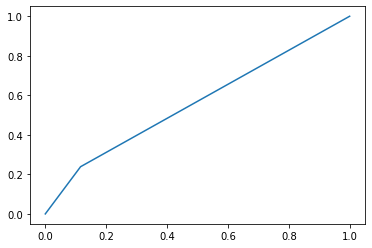

threshold =  0.7


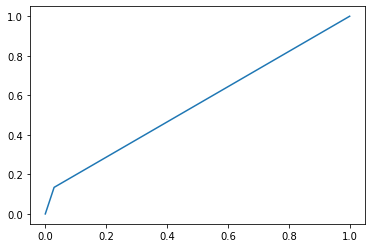

threshold =  0.8


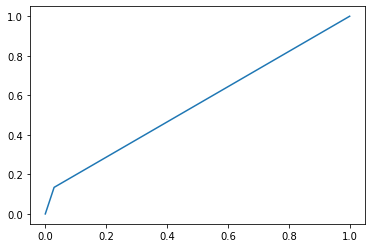

auto threshold


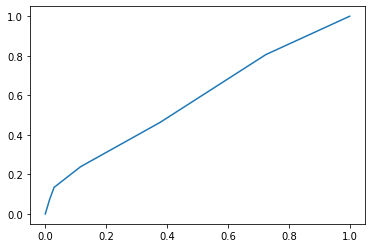

neighbours = 5 err_train = 0.22 err_test = 0.4338235294117647
[[61  8]
 [51 16]]
Mera F1 Train: 0.3516483516483516
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


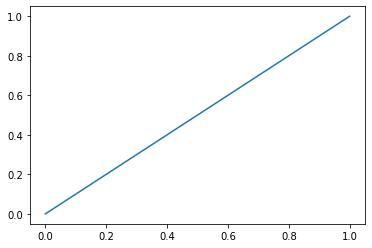

threshold =  0.2


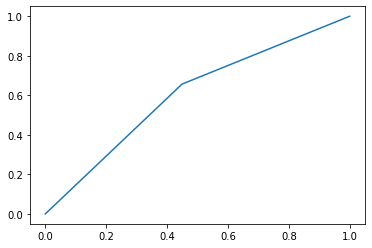

threshold =  0.4


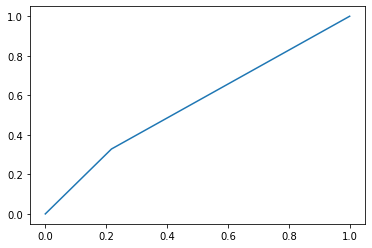

threshold =  0.5


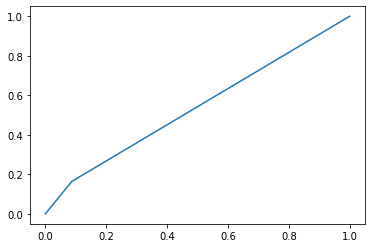

threshold =  0.7


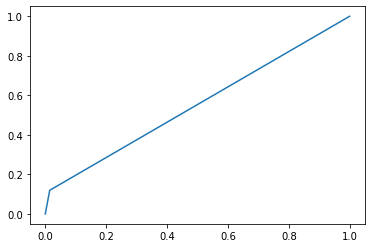

threshold =  0.8


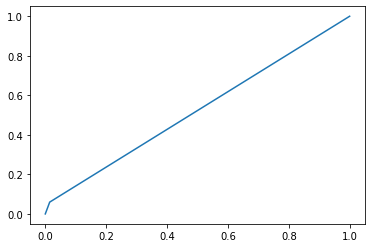

auto threshold


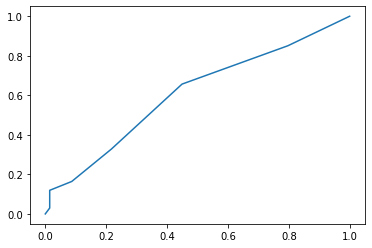

neighbours = 7 err_train = 0.25333333333333335 err_test = 0.45588235294117646
[[63  6]
 [56 11]]
Mera F1 Train: 0.2619047619047619
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


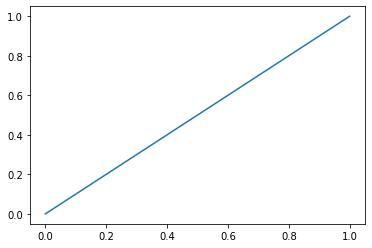

threshold =  0.2


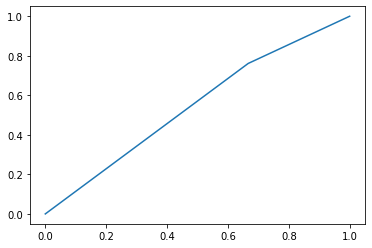

threshold =  0.4


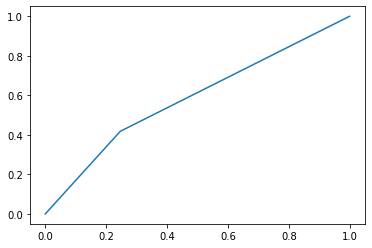

threshold =  0.5


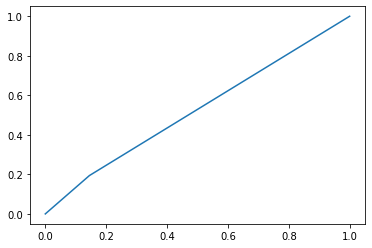

threshold =  0.7


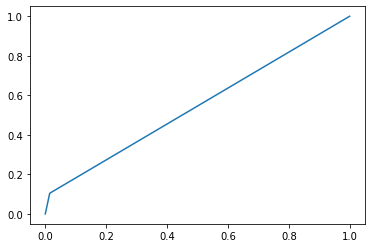

threshold =  0.8


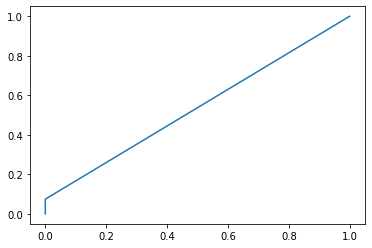

auto threshold


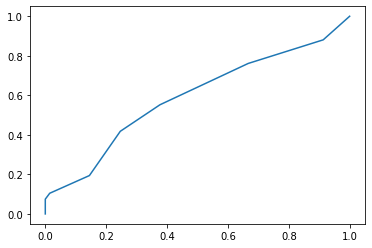

neighbours = 10 err_train = 0.3233333333333333 err_test = 0.45588235294117646
[[65  4]
 [58  9]]
Mera F1 Train: 0.225
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


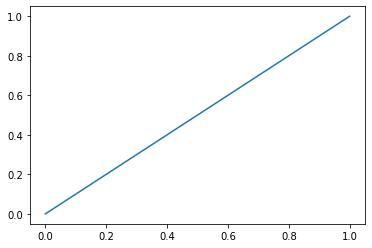

threshold =  0.2


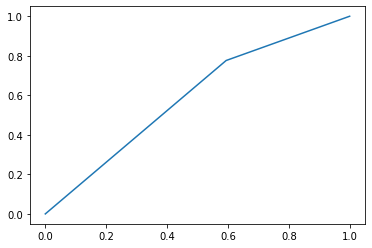

threshold =  0.4


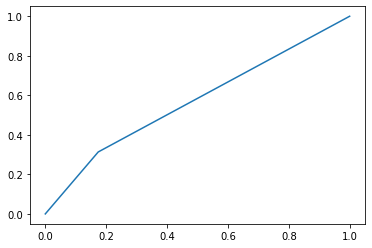

threshold =  0.5


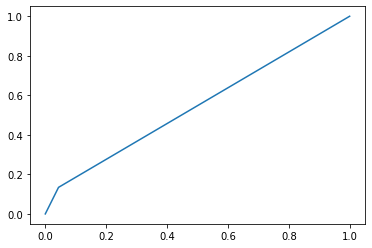

threshold =  0.7


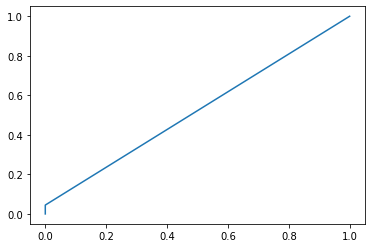

threshold =  0.8


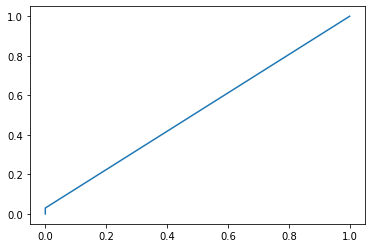

auto threshold


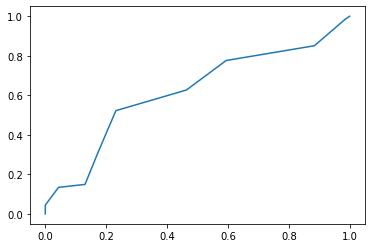

neighbours = 15 err_train = 0.32666666666666666 err_test = 0.4485294117647059
[[66  3]
 [58  9]]
Mera F1 Train: 0.2278481012658228
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


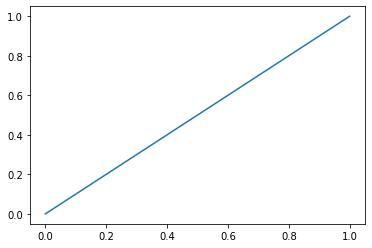

threshold =  0.2


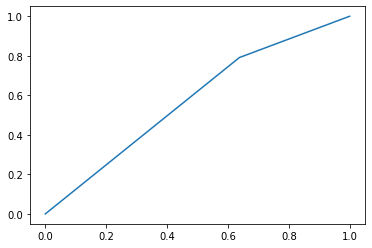

threshold =  0.4


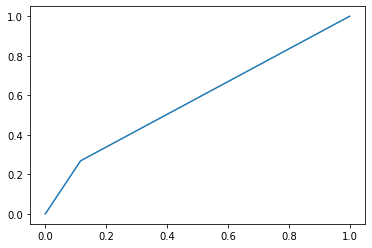

threshold =  0.5


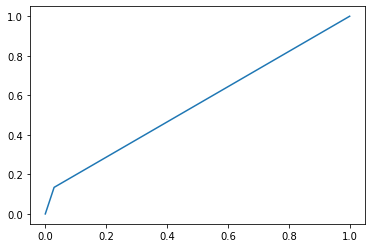

threshold =  0.7


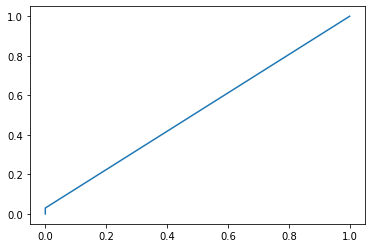

threshold =  0.8


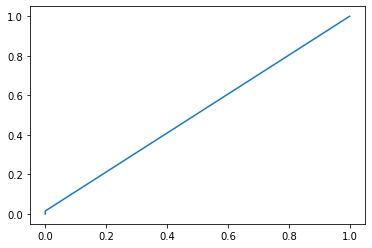

auto threshold


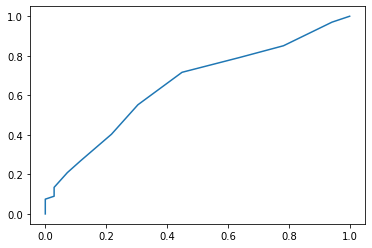

neighbours = 20 err_train = 0.37 err_test = 0.4632352941176471
[[67  2]
 [61  6]]
Mera F1 Train: 0.16
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


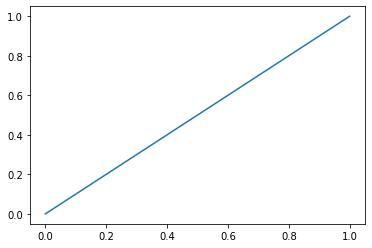

threshold =  0.2


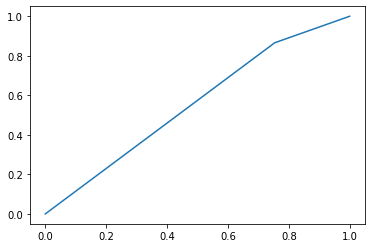

threshold =  0.4


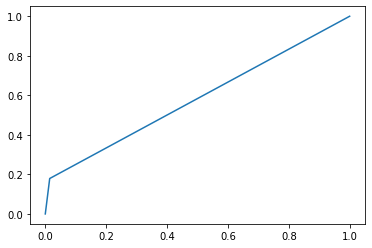

threshold =  0.5


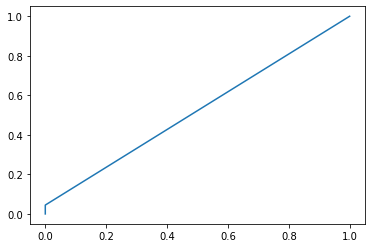

threshold =  0.7


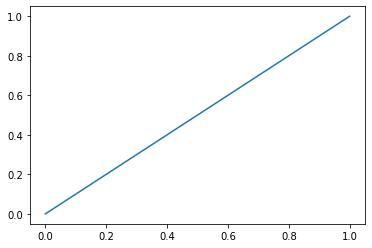

threshold =  0.8


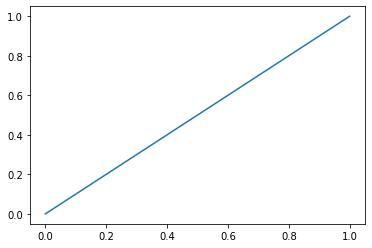

auto threshold


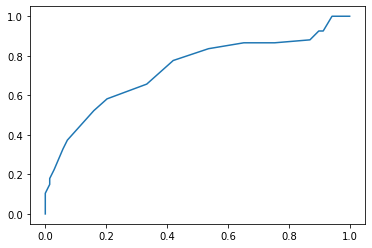

neighbours = 50 err_train = 0.44666666666666666 err_test = 0.47058823529411764
[[69  0]
 [64  3]]
Mera F1 Train: 0.08571428571428572
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


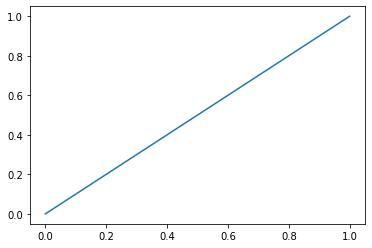

threshold =  0.2


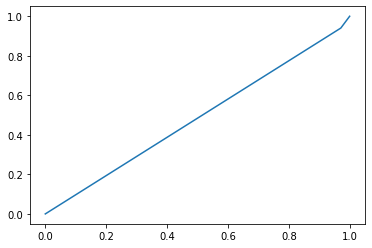

threshold =  0.4


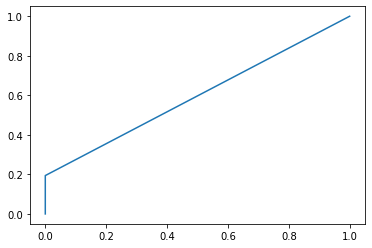

threshold =  0.5


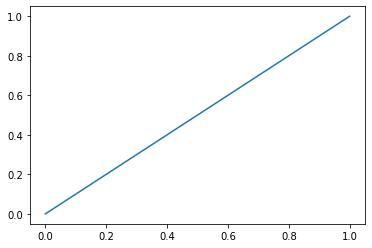

threshold =  0.7


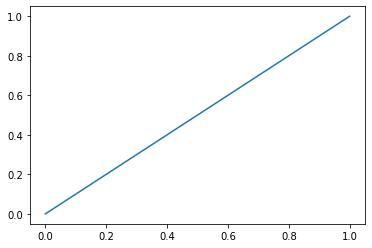

threshold =  0.8


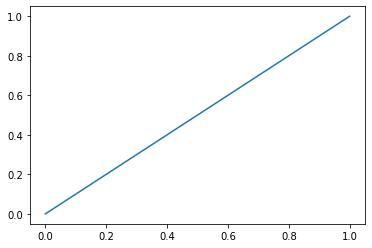

auto threshold


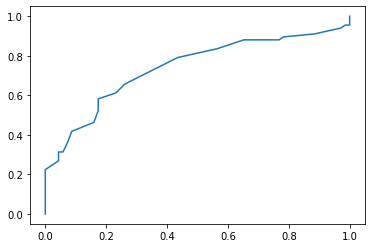

neighbours = 100 err_train = 0.4666666666666667 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [455]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[11][i]=err_test
    Knn_train[11][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [456]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[11]= err_test
SVC_train[11]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.20333333333333334 err_test_SVC = 0.3161764705882353


# NeighbourhoodCleaningRule

In [457]:
from imblearn.under_sampling import NeighbourhoodCleaningRule
ncr = NeighbourhoodCleaningRule()
X_resampled, y_resampled = ncr.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 67), (1, 140)]


## Knn

threshold =  0.0


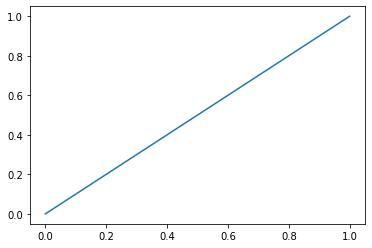

threshold =  0.2


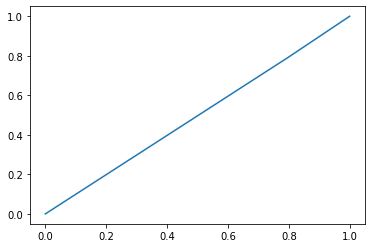

threshold =  0.4


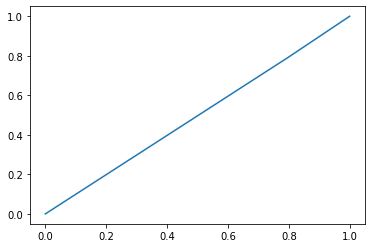

threshold =  0.5


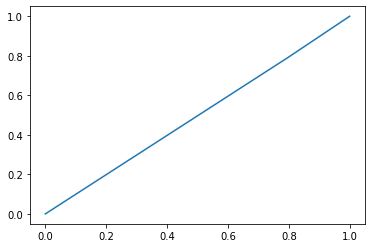

threshold =  0.7


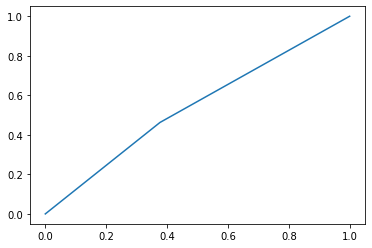

threshold =  0.8


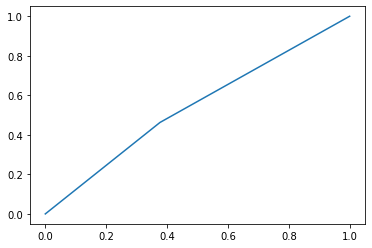

auto threshold


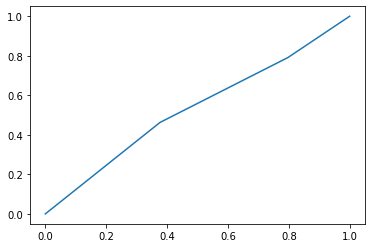

neighbours = 2 err_train = 0.06763285024154589 err_test = 0.45588235294117646
[[43 26]
 [36 31]]
Mera F1 Train: 0.5
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


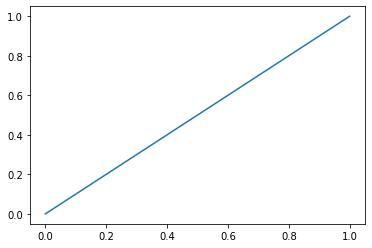

threshold =  0.2


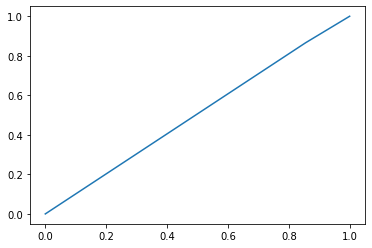

threshold =  0.4


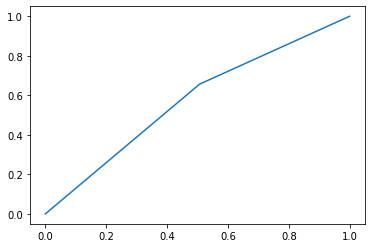

threshold =  0.5


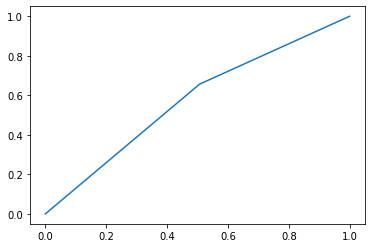

threshold =  0.7


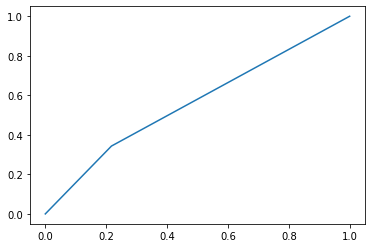

threshold =  0.8


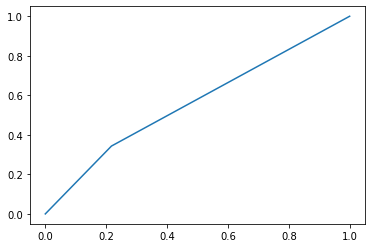

auto threshold


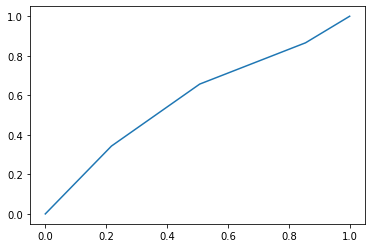

neighbours = 3 err_train = 0.06763285024154589 err_test = 0.4264705882352941
[[34 35]
 [23 44]]
Mera F1 Train: 0.6027397260273972
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


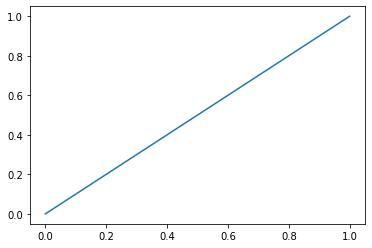

threshold =  0.2


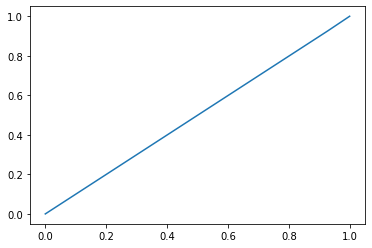

threshold =  0.4


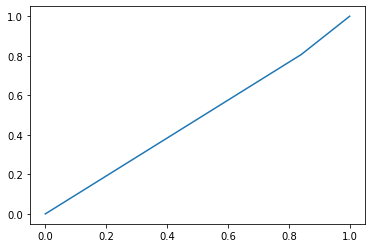

threshold =  0.5


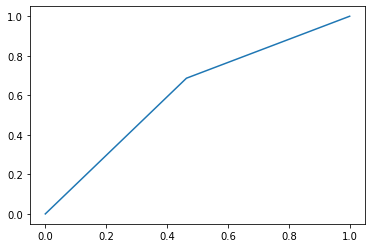

threshold =  0.7


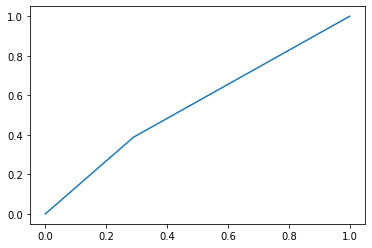

threshold =  0.8


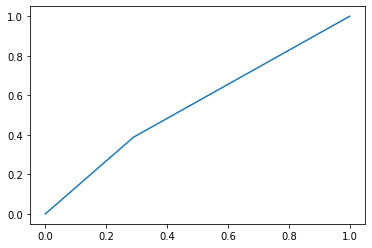

auto threshold


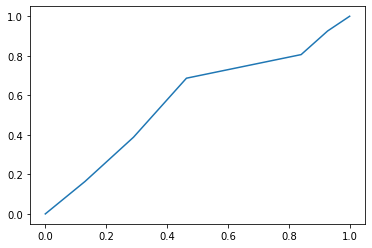

neighbours = 5 err_train = 0.12077294685990338 err_test = 0.3897058823529412
[[37 32]
 [21 46]]
Mera F1 Train: 0.6344827586206897
Precision Score Train:  0.6102941176470589
Recall Score Train:  0.6102941176470589
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


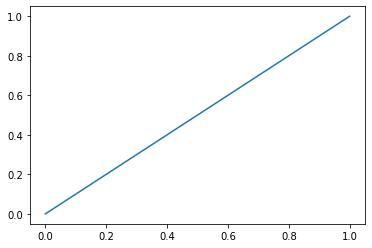

threshold =  0.2


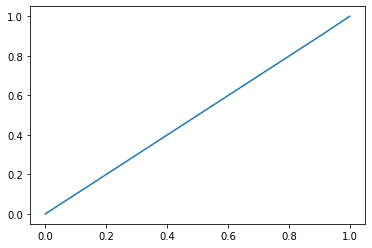

threshold =  0.4


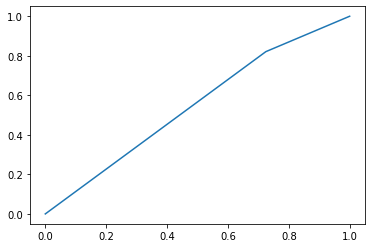

threshold =  0.5


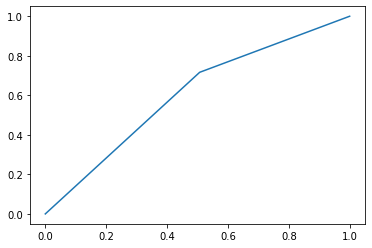

threshold =  0.7


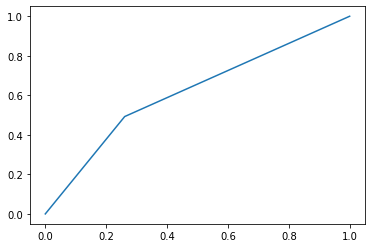

threshold =  0.8


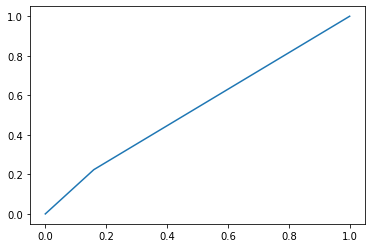

auto threshold


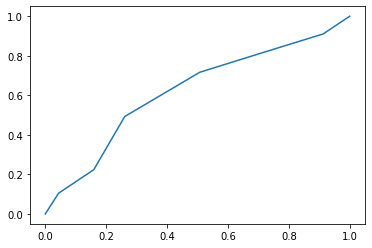

neighbours = 7 err_train = 0.14492753623188406 err_test = 0.39705882352941174
[[34 35]
 [19 48]]
Mera F1 Train: 0.64
Precision Score Train:  0.6029411764705882
Recall Score Train:  0.6029411764705882
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


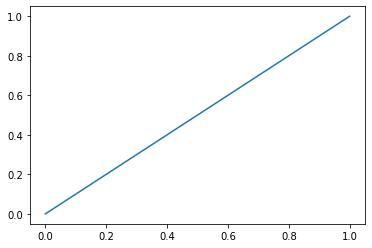

threshold =  0.2


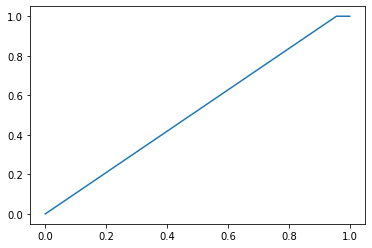

threshold =  0.4


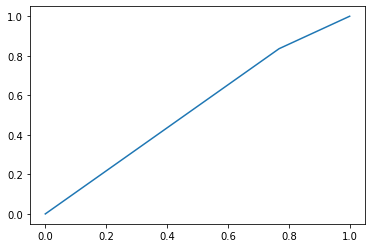

threshold =  0.5


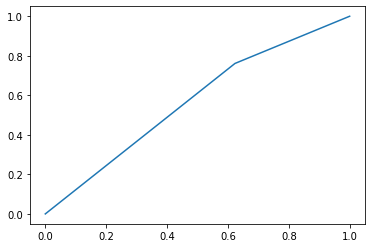

threshold =  0.7


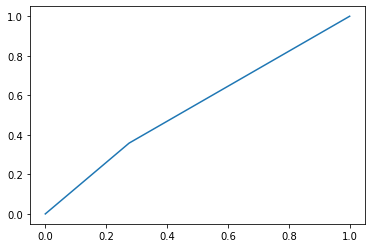

threshold =  0.8


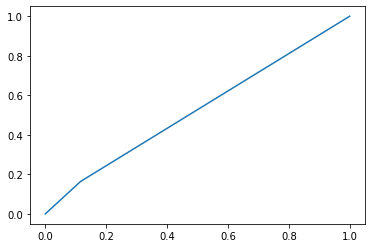

auto threshold


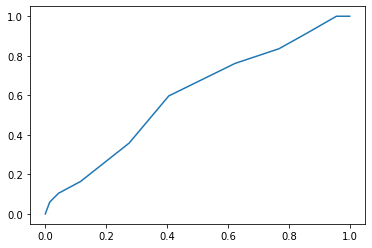

neighbours = 10 err_train = 0.15942028985507245 err_test = 0.40441176470588236
[[41 28]
 [27 40]]
Mera F1 Train: 0.5925925925925926
Precision Score Train:  0.5955882352941176
Recall Score Train:  0.5955882352941176
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


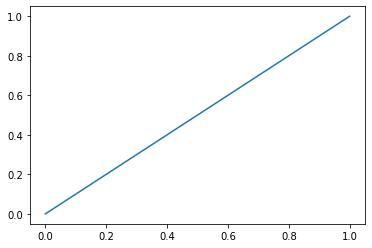

threshold =  0.2


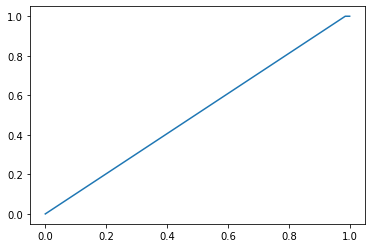

threshold =  0.4


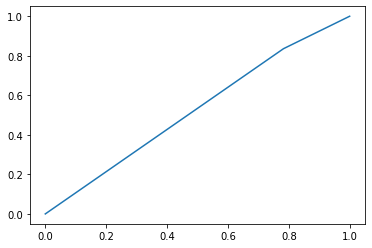

threshold =  0.5


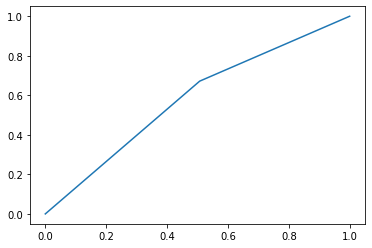

threshold =  0.7


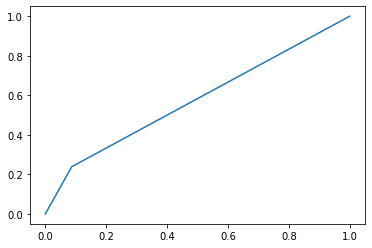

threshold =  0.8


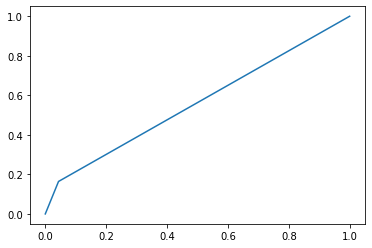

auto threshold


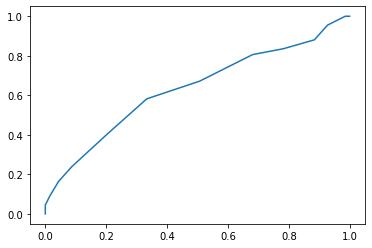

neighbours = 15 err_train = 0.19806763285024154 err_test = 0.41911764705882354
[[34 35]
 [22 45]]
Mera F1 Train: 0.6122448979591838
Precision Score Train:  0.5808823529411765
Recall Score Train:  0.5808823529411765
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


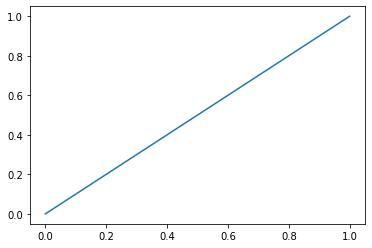

threshold =  0.2


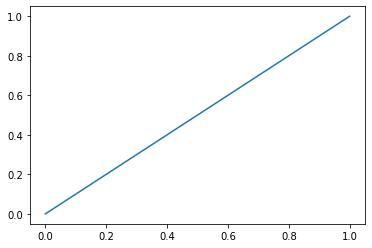

threshold =  0.4


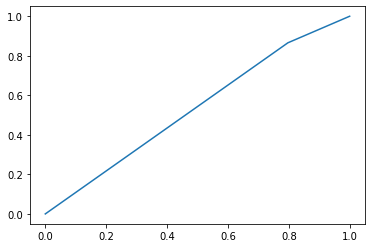

threshold =  0.5


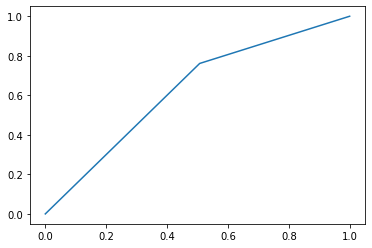

threshold =  0.7


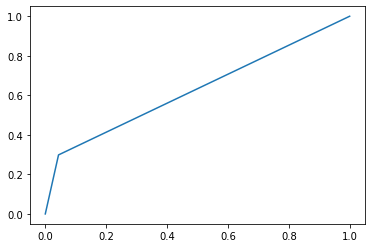

threshold =  0.8


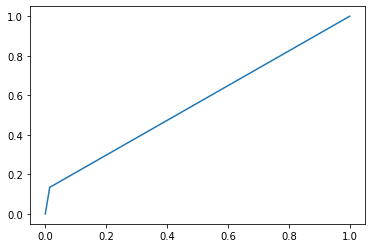

auto threshold


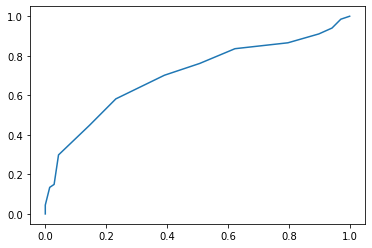

neighbours = 20 err_train = 0.2463768115942029 err_test = 0.34558823529411764
[[42 27]
 [20 47]]
Mera F1 Train: 0.6666666666666666
Precision Score Train:  0.6544117647058824
Recall Score Train:  0.6544117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


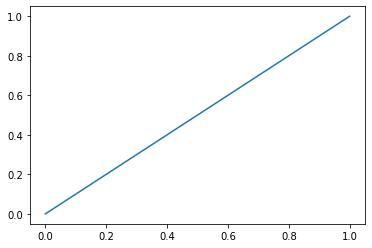

threshold =  0.2


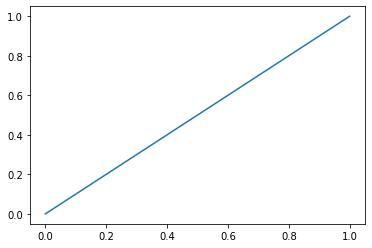

threshold =  0.4


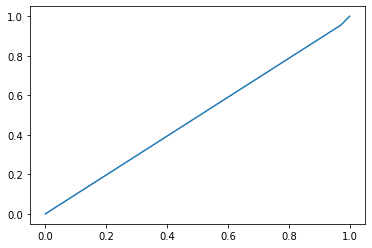

threshold =  0.5


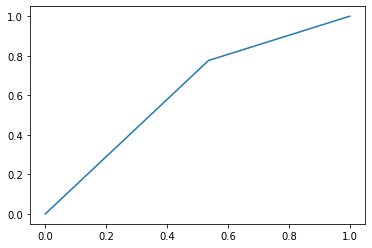

threshold =  0.7


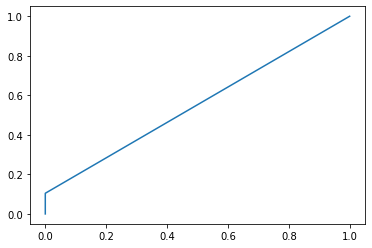

threshold =  0.8


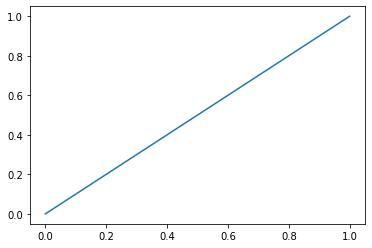

auto threshold


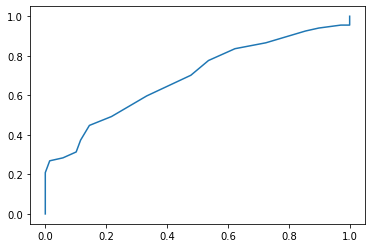

neighbours = 50 err_train = 0.2222222222222222 err_test = 0.3897058823529412
[[36 33]
 [20 47]]
Mera F1 Train: 0.6394557823129252
Precision Score Train:  0.6102941176470589
Recall Score Train:  0.6102941176470589
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


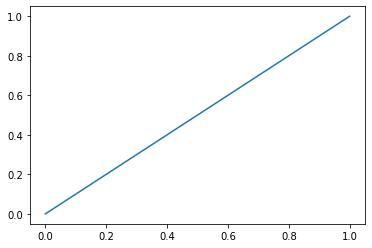

threshold =  0.2


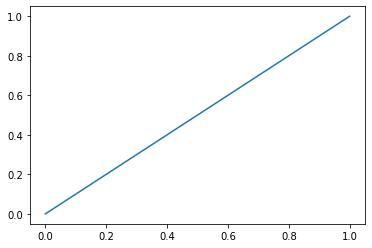

threshold =  0.4


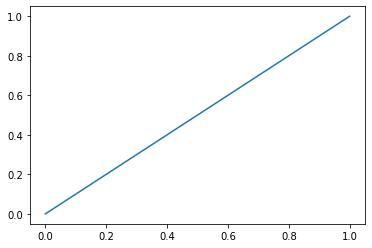

threshold =  0.5


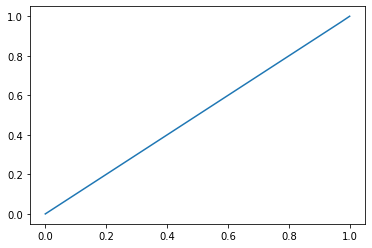

threshold =  0.7


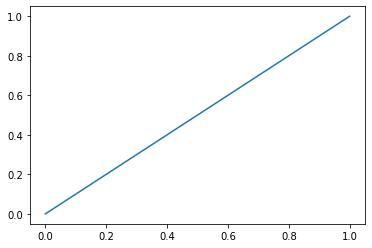

threshold =  0.8


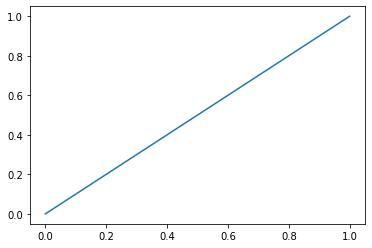

auto threshold


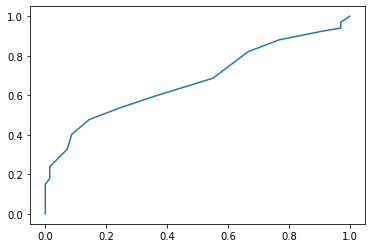

neighbours = 100 err_train = 0.2898550724637681 err_test = 0.5220588235294118
[[ 2 67]
 [ 4 63]]
Mera F1 Train: 0.6395939086294417
Precision Score Train:  0.47794117647058826
Recall Score Train:  0.47794117647058826


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [458]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[12][i]=err_test
    Knn_train[12][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [459]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[12]= err_test
SVC_train[12]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.25120772946859904 err_test_SVC = 0.5073529411764706


# Instance hardness threshold

In [460]:
from sklearn.linear_model import LogisticRegression
from imblearn.under_sampling import InstanceHardnessThreshold
iht = InstanceHardnessThreshold(random_state=0,
                                estimator=LogisticRegression(
                                    solver='lbfgs', multi_class='auto'))
X_resampled, y_resampled = iht.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 140), (1, 140)]


H:\Anaconda\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
H:\Anaconda\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_ms

## Knn

threshold =  0.0


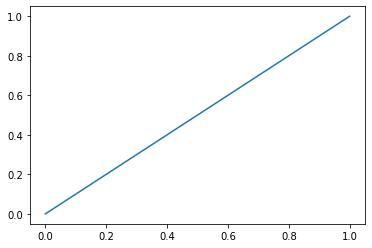

threshold =  0.2


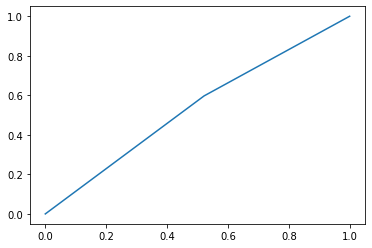

threshold =  0.4


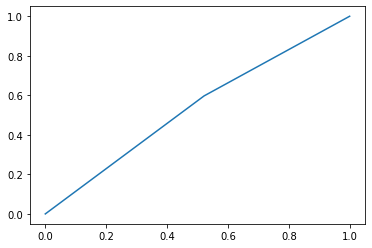

threshold =  0.5


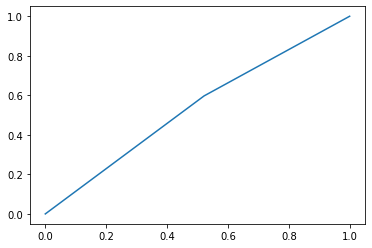

threshold =  0.7


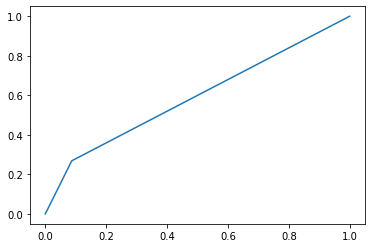

threshold =  0.8


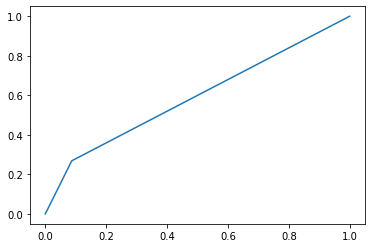

auto threshold


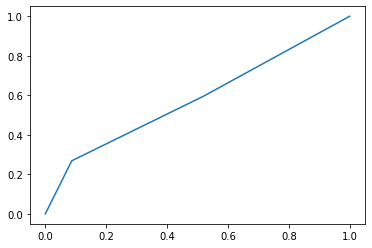

neighbours = 2 err_train = 0.21071428571428572 err_test = 0.40441176470588236
[[63  6]
 [49 18]]
Mera F1 Train: 0.39560439560439564
Precision Score Train:  0.5955882352941176
Recall Score Train:  0.5955882352941176
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


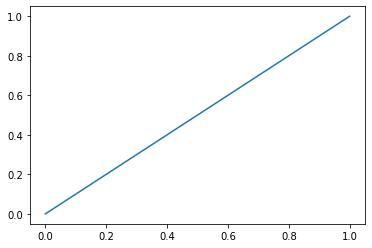

threshold =  0.2


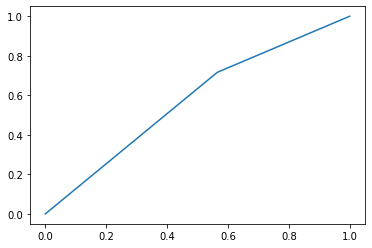

threshold =  0.4


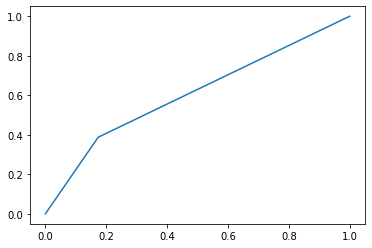

threshold =  0.5


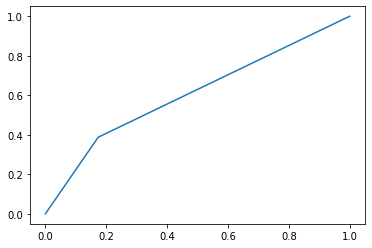

threshold =  0.7


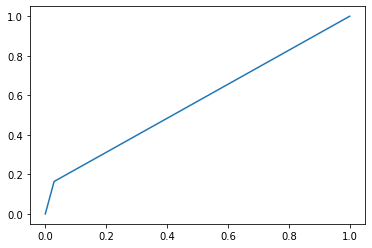

threshold =  0.8


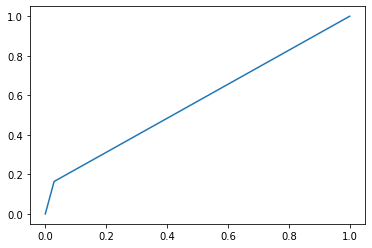

auto threshold


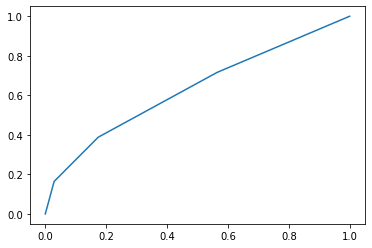

neighbours = 3 err_train = 0.14642857142857144 err_test = 0.3897058823529412
[[57 12]
 [41 26]]
Mera F1 Train: 0.4952380952380952
Precision Score Train:  0.6102941176470589
Recall Score Train:  0.6102941176470589
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


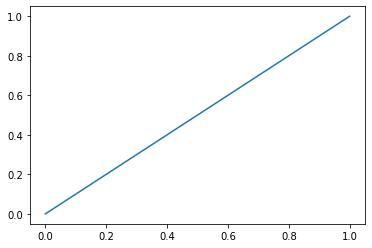

threshold =  0.2


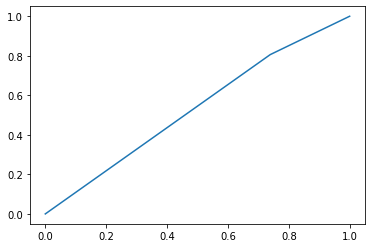

threshold =  0.4


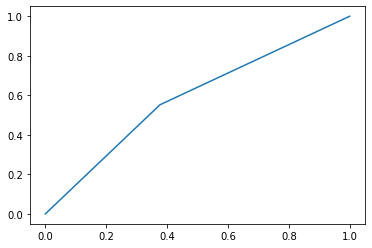

threshold =  0.5


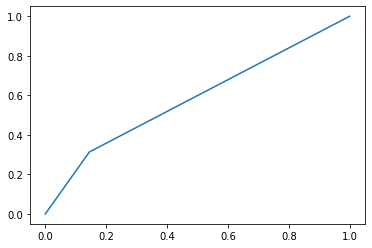

threshold =  0.7


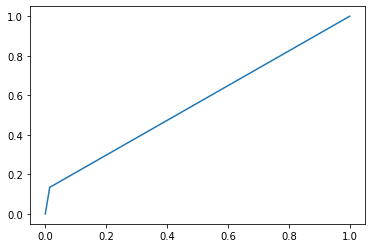

threshold =  0.8


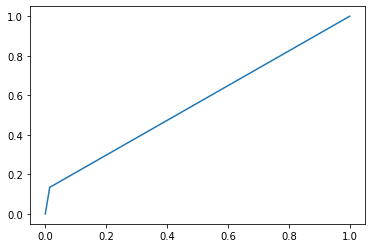

auto threshold


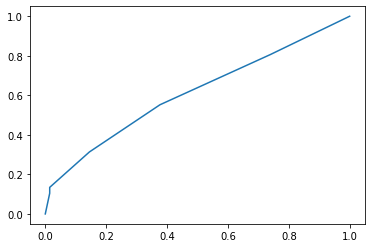

neighbours = 5 err_train = 0.20714285714285716 err_test = 0.4117647058823529
[[59 10]
 [46 21]]
Mera F1 Train: 0.4285714285714286
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


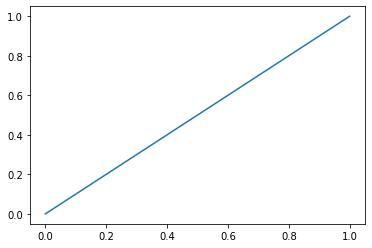

threshold =  0.2


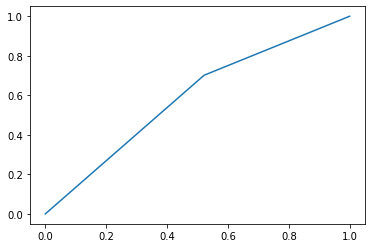

threshold =  0.4


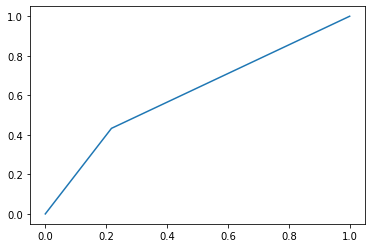

threshold =  0.5


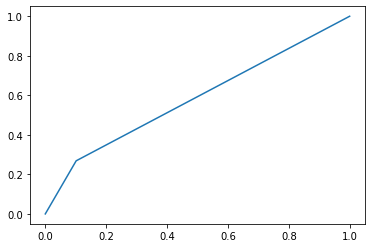

threshold =  0.7


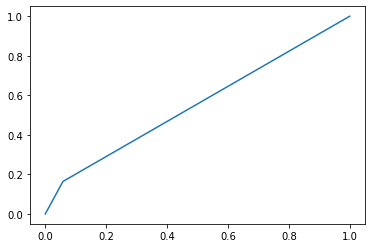

threshold =  0.8


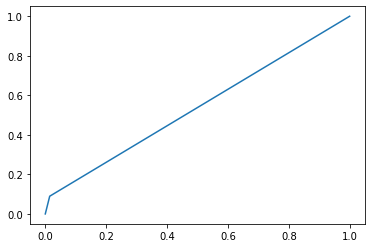

auto threshold


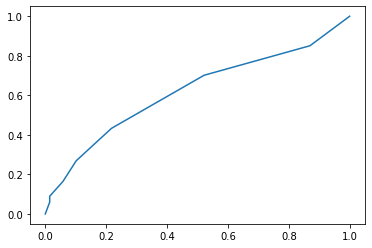

neighbours = 7 err_train = 0.26071428571428573 err_test = 0.4117647058823529
[[62  7]
 [49 18]]
Mera F1 Train: 0.391304347826087
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


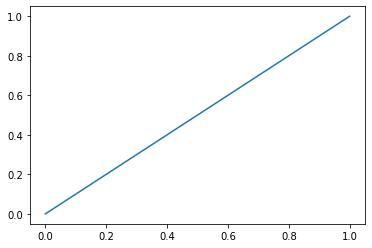

threshold =  0.2


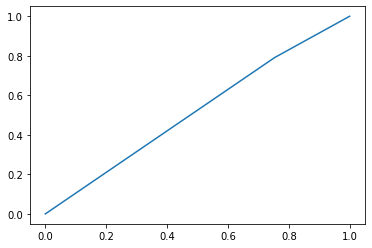

threshold =  0.4


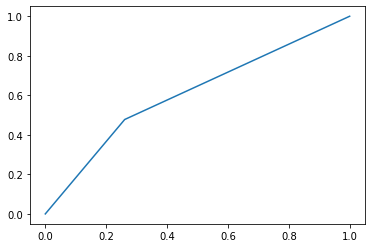

threshold =  0.5


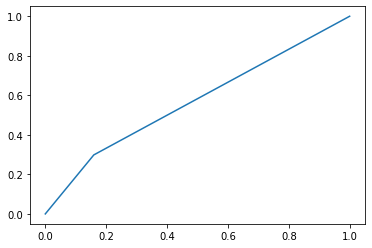

threshold =  0.7


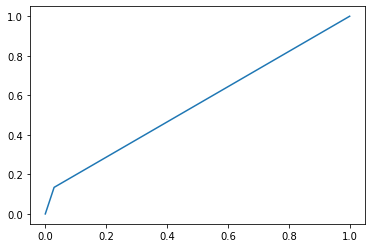

threshold =  0.8


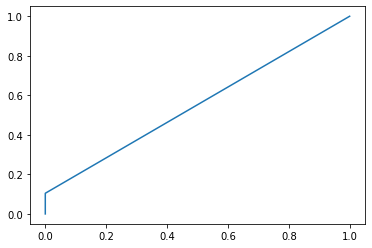

auto threshold


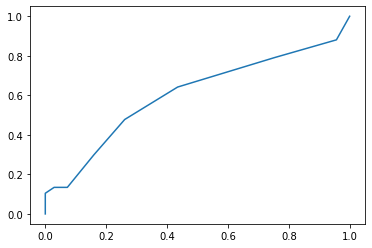

neighbours = 10 err_train = 0.32857142857142857 err_test = 0.4632352941176471
[[64  5]
 [58  9]]
Mera F1 Train: 0.2222222222222222
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


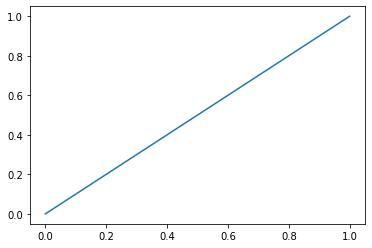

threshold =  0.2


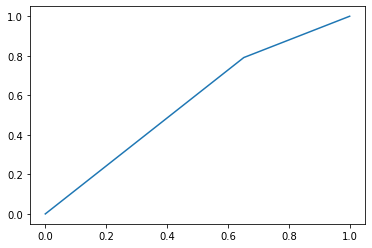

threshold =  0.4


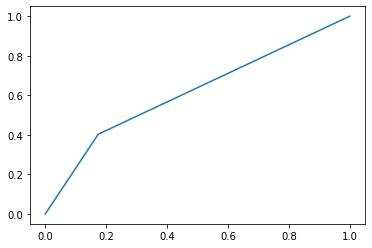

threshold =  0.5


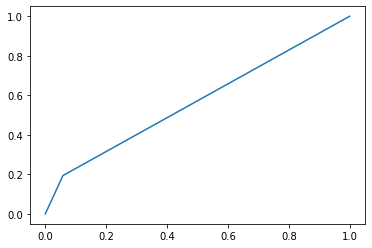

threshold =  0.7


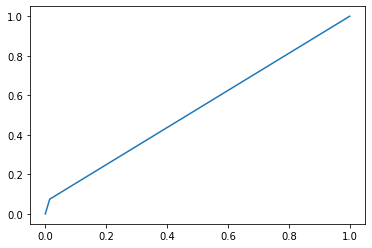

threshold =  0.8


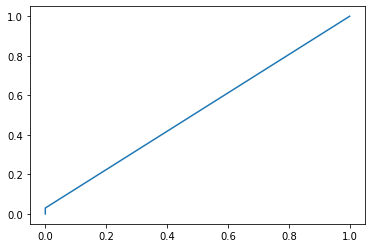

auto threshold


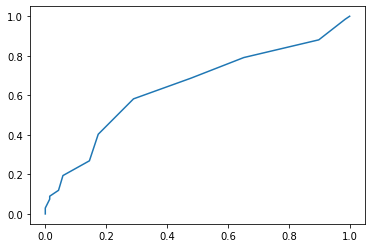

neighbours = 15 err_train = 0.3142857142857143 err_test = 0.4264705882352941
[[65  4]
 [54 13]]
Mera F1 Train: 0.30952380952380953
Precision Score Train:  0.5735294117647058
Recall Score Train:  0.5735294117647058
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


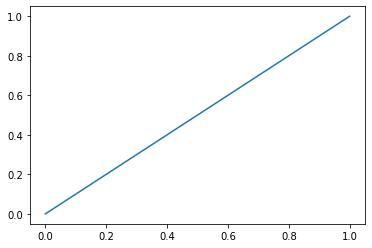

threshold =  0.2


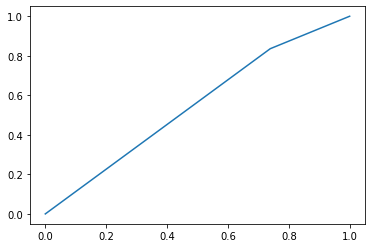

threshold =  0.4


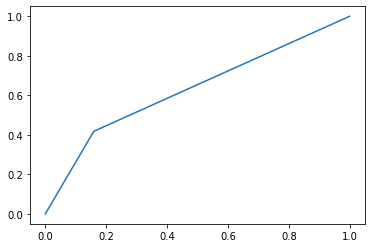

threshold =  0.5


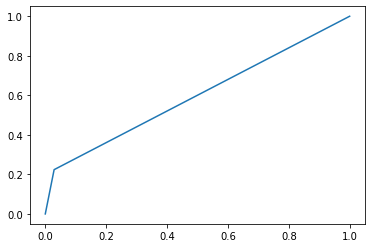

threshold =  0.7


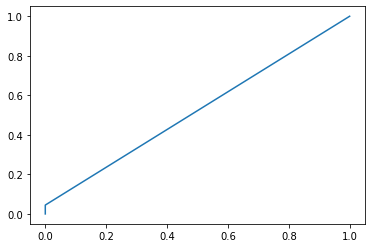

threshold =  0.8


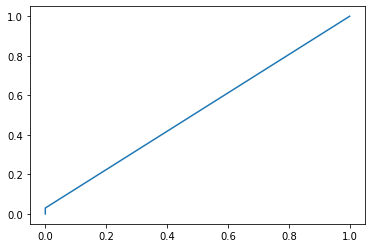

auto threshold


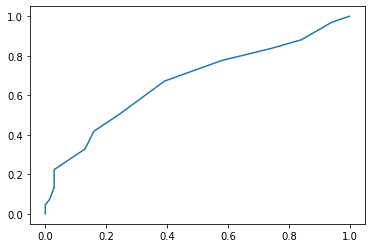

neighbours = 20 err_train = 0.37142857142857144 err_test = 0.4338235294117647
[[67  2]
 [57 10]]
Mera F1 Train: 0.2531645569620253
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


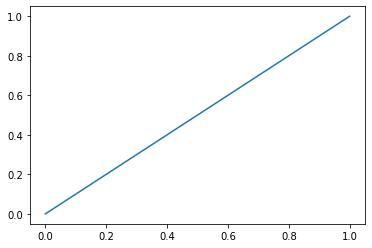

threshold =  0.2


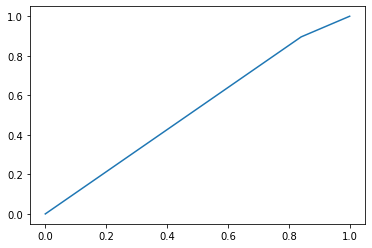

threshold =  0.4


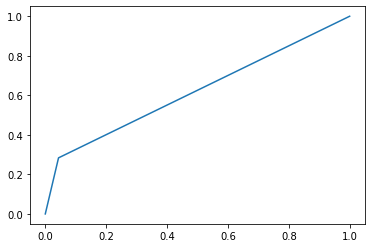

threshold =  0.5


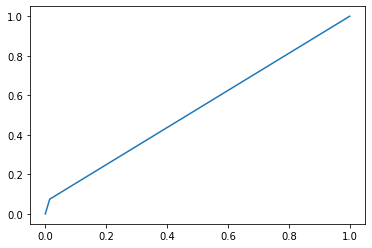

threshold =  0.7


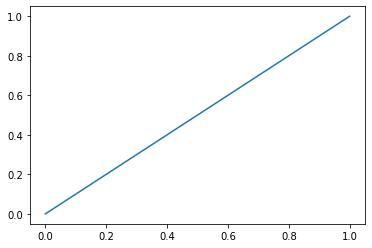

threshold =  0.8


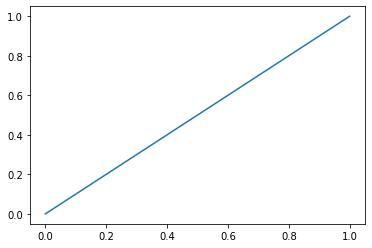

auto threshold


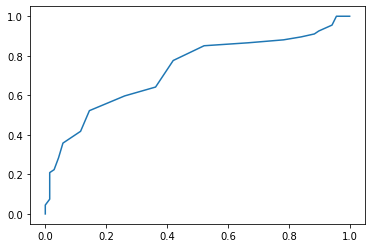

neighbours = 50 err_train = 0.45714285714285713 err_test = 0.47058823529411764
[[69  0]
 [64  3]]
Mera F1 Train: 0.08571428571428572
Precision Score Train:  0.5294117647058824
Recall Score Train:  0.5294117647058824
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


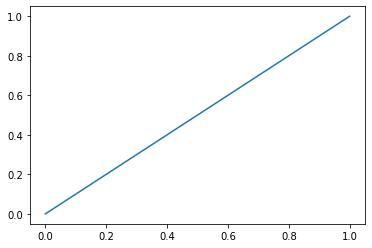

threshold =  0.2


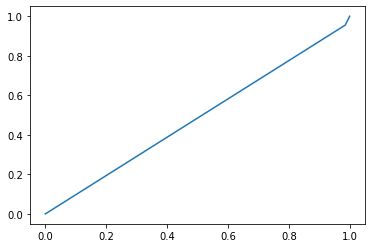

threshold =  0.4


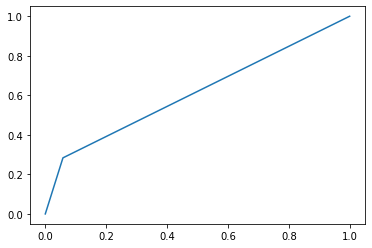

threshold =  0.5


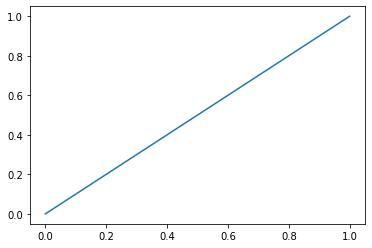

threshold =  0.7


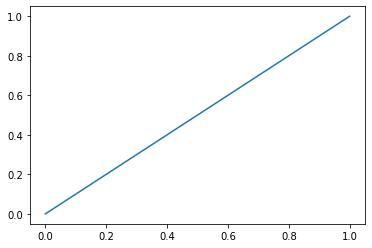

threshold =  0.8


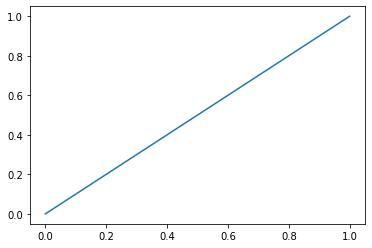

auto threshold


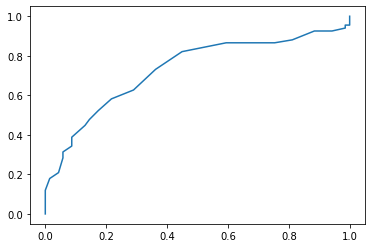

neighbours = 100 err_train = 0.49642857142857144 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [461]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[13][i]=err_test
    Knn_train[13][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [462]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[13]= err_test
SVC_train[13]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.21071428571428572 err_test_SVC = 0.3014705882352941


# Combination of over- and under-sampling

# SMOTEENN

In [463]:
from imblearn.combine import SMOTEENN
smote_enn = SMOTEENN(random_state=0)
X_resampled, y_resampled = smote_enn.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 75), (1, 56)]


## Knn

threshold =  0.0


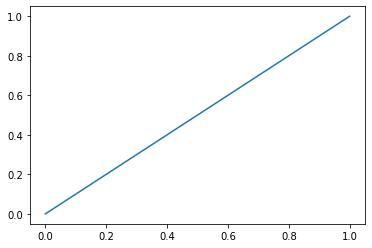

threshold =  0.2


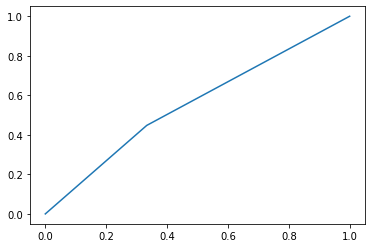

threshold =  0.4


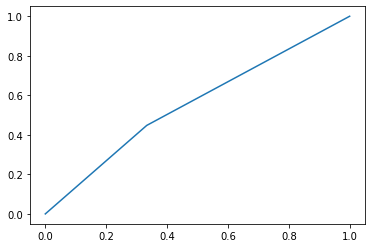

threshold =  0.5


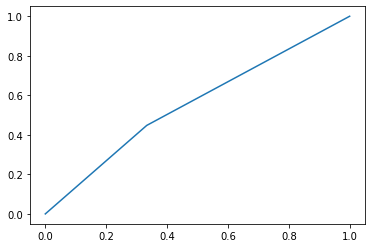

threshold =  0.7


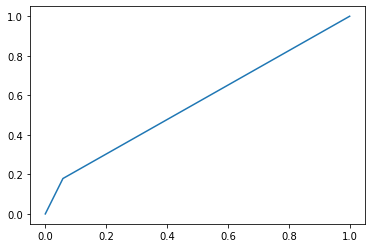

threshold =  0.8


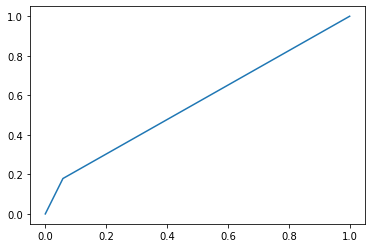

auto threshold


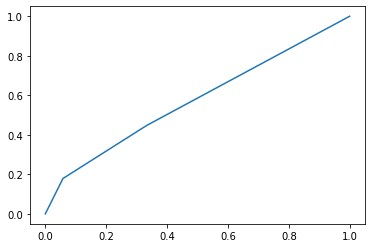

neighbours = 2 err_train = 0.061068702290076333 err_test = 0.4338235294117647
[[65  4]
 [55 12]]
Mera F1 Train: 0.2891566265060241
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


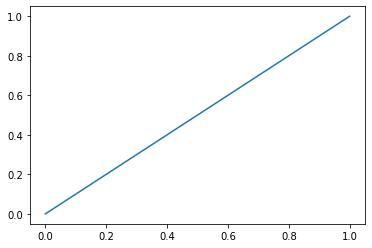

threshold =  0.2


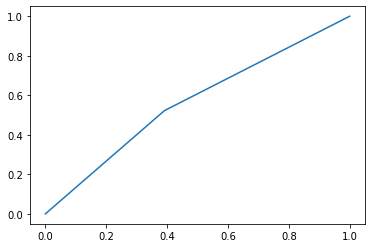

threshold =  0.4


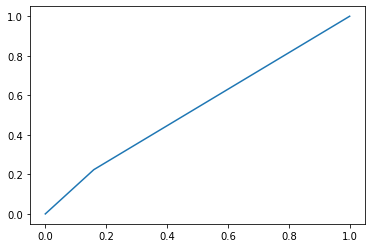

threshold =  0.5


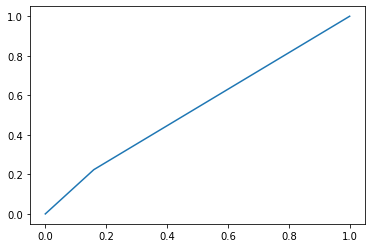

threshold =  0.7


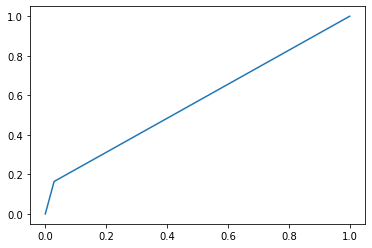

threshold =  0.8


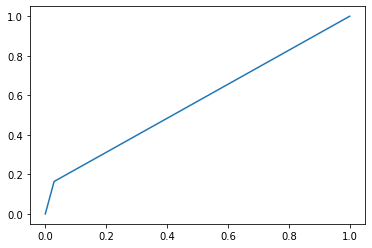

auto threshold


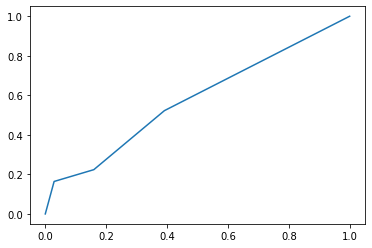

neighbours = 3 err_train = 0.03816793893129771 err_test = 0.4632352941176471
[[58 11]
 [52 15]]
Mera F1 Train: 0.3225806451612903
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


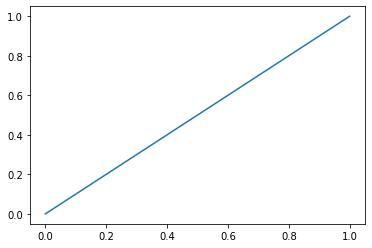

threshold =  0.2


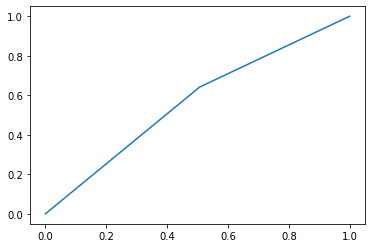

threshold =  0.4


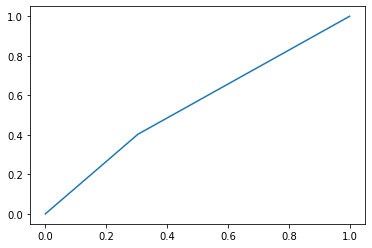

threshold =  0.5


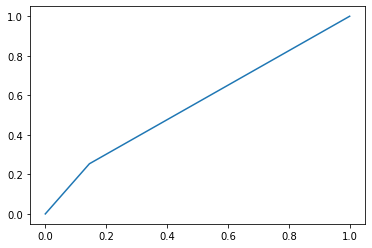

threshold =  0.7


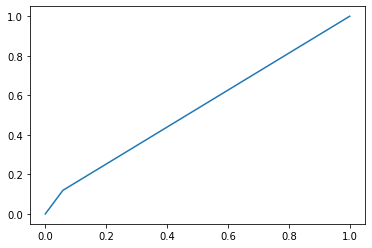

threshold =  0.8


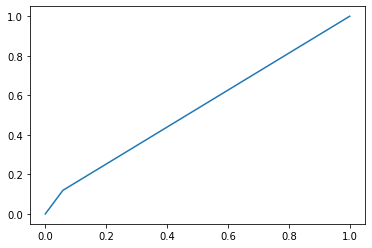

auto threshold


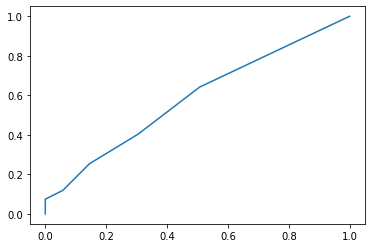

neighbours = 5 err_train = 0.061068702290076333 err_test = 0.4411764705882353
[[59 10]
 [50 17]]
Mera F1 Train: 0.36170212765957455
Precision Score Train:  0.5588235294117647
Recall Score Train:  0.5588235294117647
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


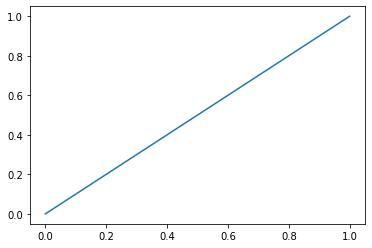

threshold =  0.2


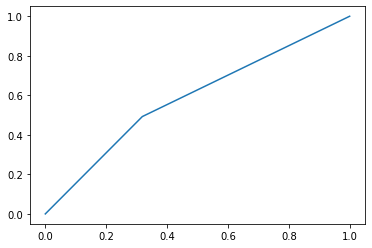

threshold =  0.4


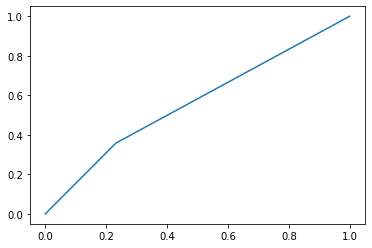

threshold =  0.5


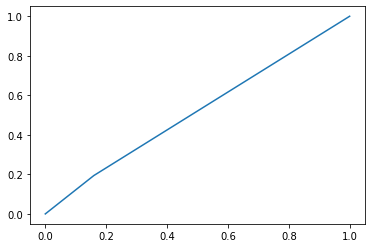

threshold =  0.7


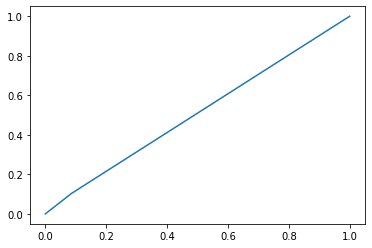

threshold =  0.8


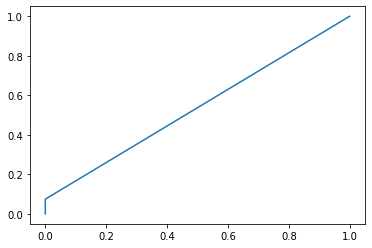

auto threshold


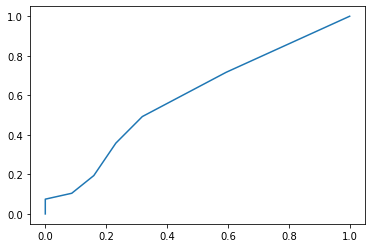

neighbours = 7 err_train = 0.12213740458015267 err_test = 0.47794117647058826
[[58 11]
 [54 13]]
Mera F1 Train: 0.2857142857142857
Precision Score Train:  0.5220588235294118
Recall Score Train:  0.5220588235294118
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


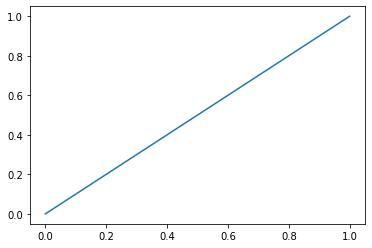

threshold =  0.2


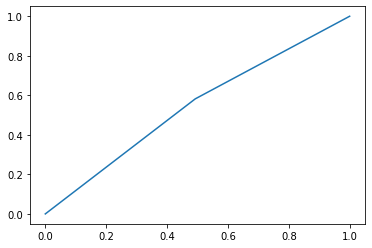

threshold =  0.4


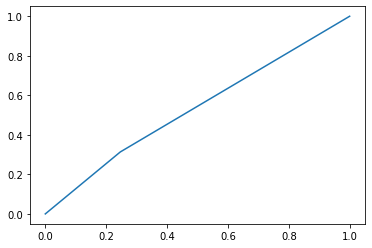

threshold =  0.5


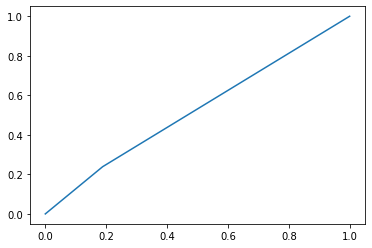

threshold =  0.7


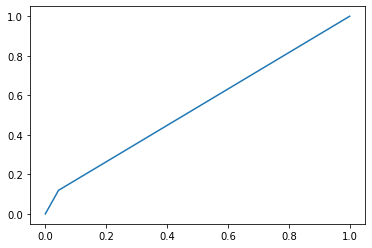

threshold =  0.8


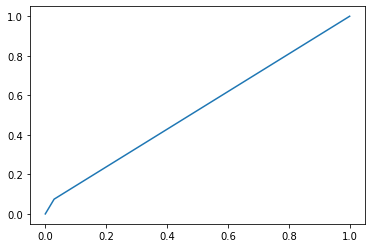

auto threshold


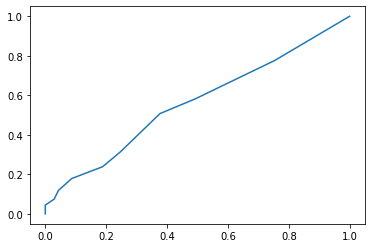

neighbours = 10 err_train = 0.183206106870229 err_test = 0.4485294117647059
[[63  6]
 [55 12]]
Mera F1 Train: 0.2823529411764706
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


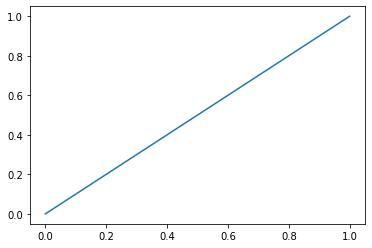

threshold =  0.2


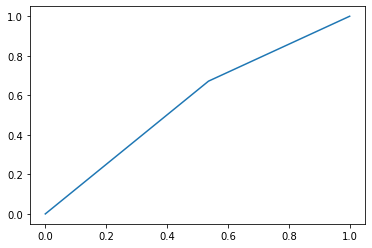

threshold =  0.4


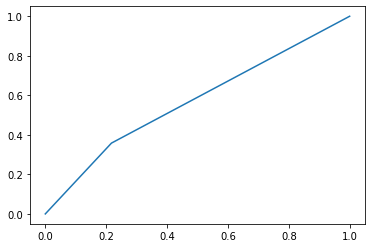

threshold =  0.5


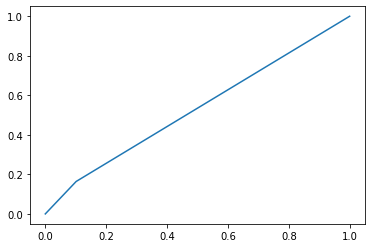

threshold =  0.7


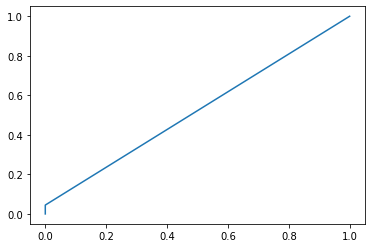

threshold =  0.8


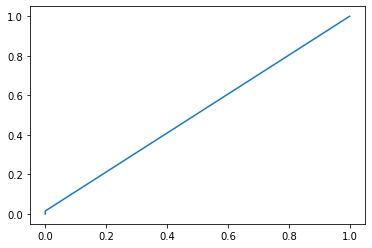

auto threshold


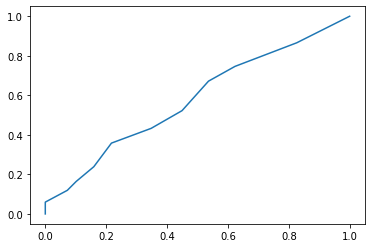

neighbours = 15 err_train = 0.22137404580152673 err_test = 0.4632352941176471
[[62  7]
 [56 11]]
Mera F1 Train: 0.25882352941176473
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


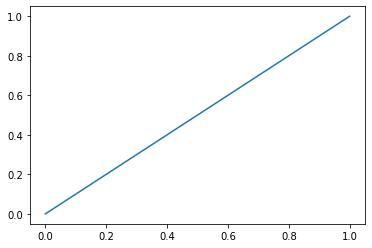

threshold =  0.2


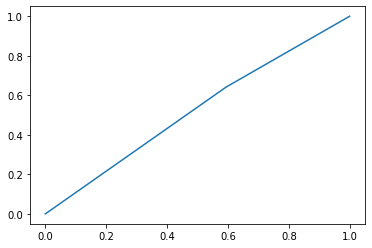

threshold =  0.4


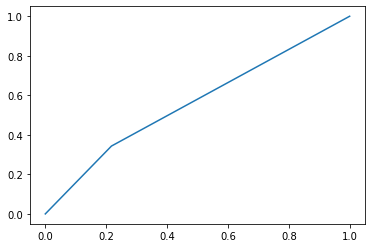

threshold =  0.5


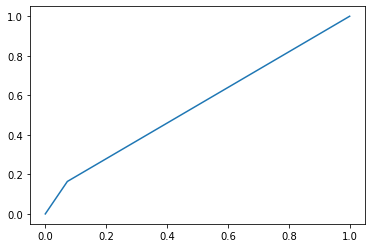

threshold =  0.7


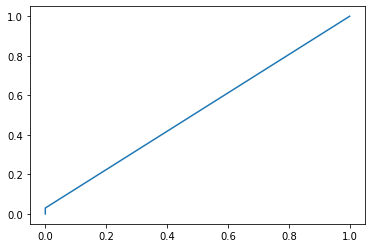

threshold =  0.8


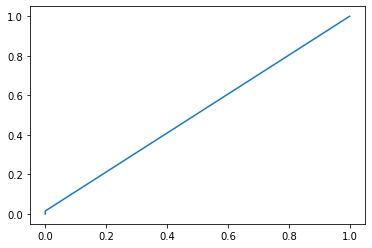

auto threshold


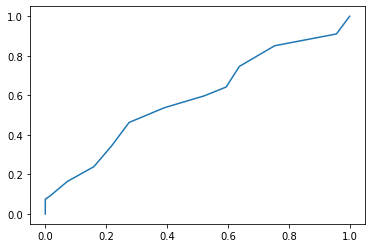

neighbours = 20 err_train = 0.2900763358778626 err_test = 0.45588235294117646
[[68  1]
 [61  6]]
Mera F1 Train: 0.16216216216216214
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


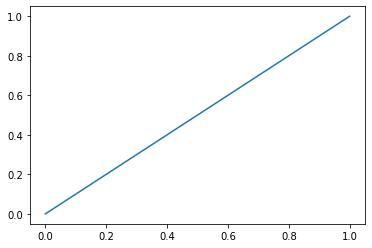

threshold =  0.2


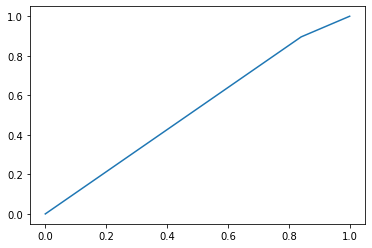

threshold =  0.4


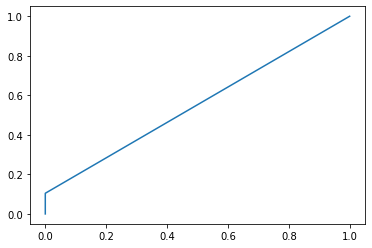

threshold =  0.5


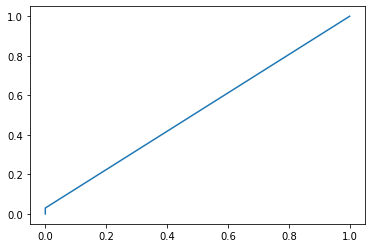

threshold =  0.7


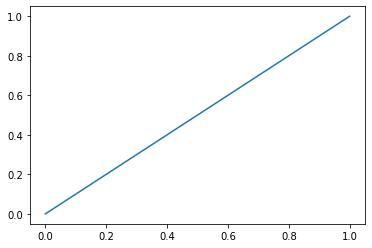

threshold =  0.8


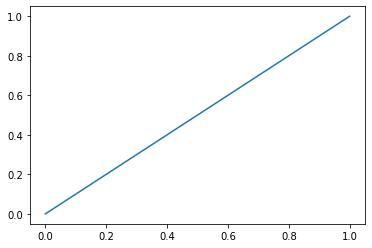

auto threshold


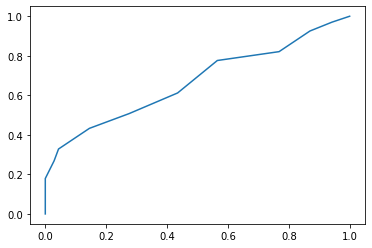

neighbours = 50 err_train = 0.4198473282442748 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


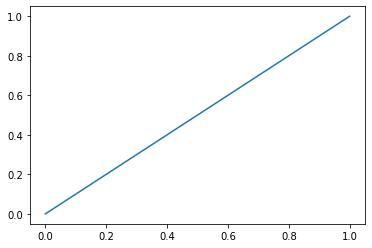

threshold =  0.2


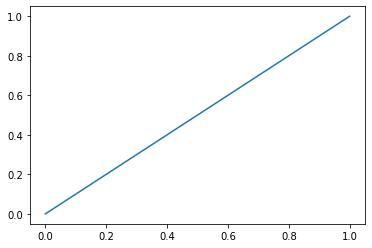

threshold =  0.4


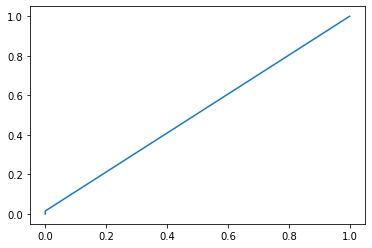

threshold =  0.5


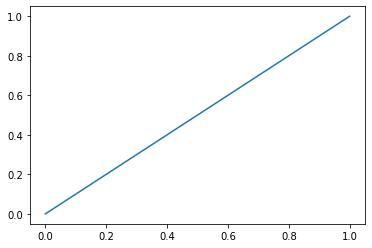

threshold =  0.7


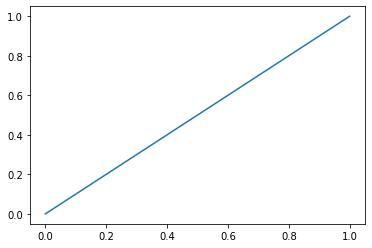

threshold =  0.8


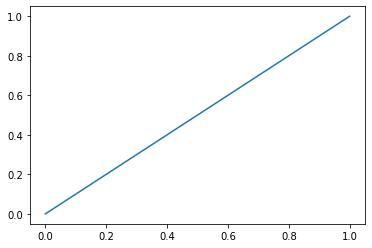

auto threshold


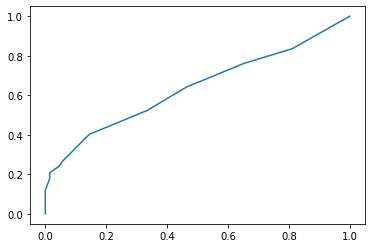

neighbours = 100 err_train = 0.42748091603053434 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [464]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[14][i]=err_test
    Knn_train[14][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [465]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[14]= err_test
SVC_train[14]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.1450381679389313 err_test_SVC = 0.34558823529411764


# SMOTETomek

In [466]:
from imblearn.combine import SMOTETomek
smote_tomek = SMOTETomek(random_state=0)
X_resampled, y_resampled = smote_tomek.fit_resample(X_train, y_train)
print(sorted(Counter(y_resampled).items()))

[(0, 166), (1, 166)]


## Knn

threshold =  0.0


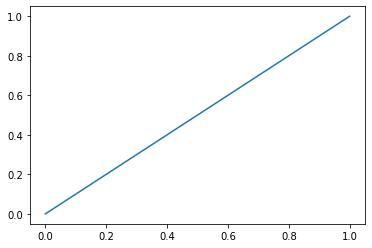

threshold =  0.2


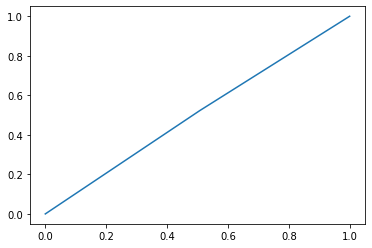

threshold =  0.4


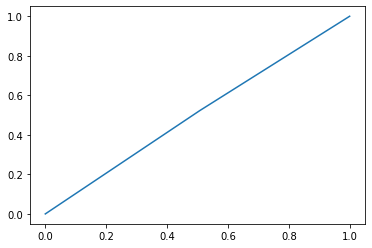

threshold =  0.5


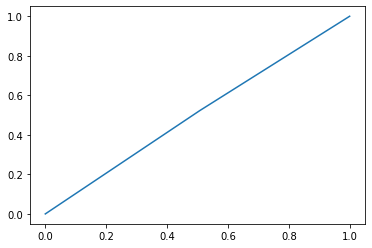

threshold =  0.7


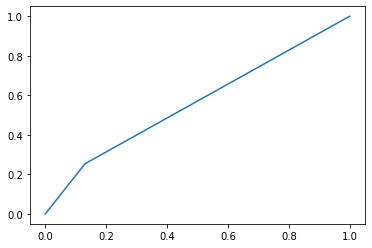

threshold =  0.8


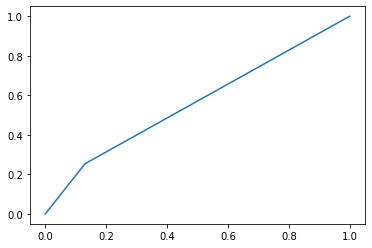

auto threshold


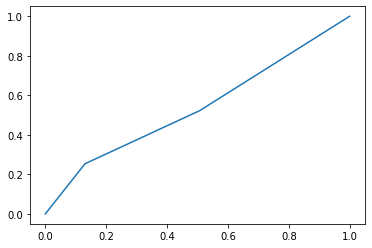

neighbours = 2 err_train = 0.09036144578313253 err_test = 0.4338235294117647
[[60  9]
 [50 17]]
Mera F1 Train: 0.3655913978494624
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


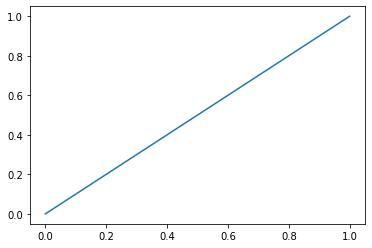

threshold =  0.2


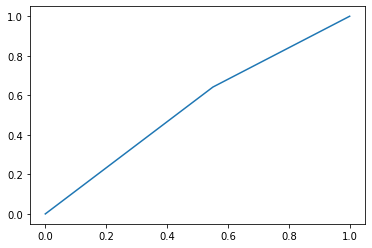

threshold =  0.4


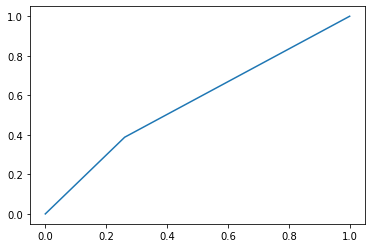

threshold =  0.5


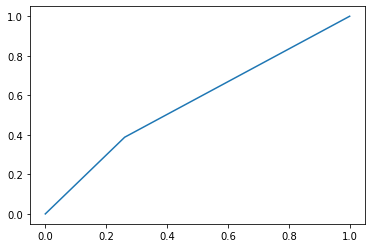

threshold =  0.7


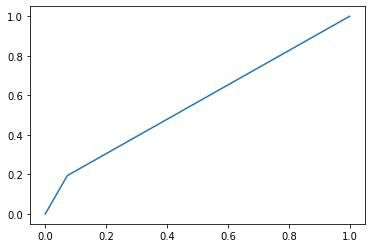

threshold =  0.8


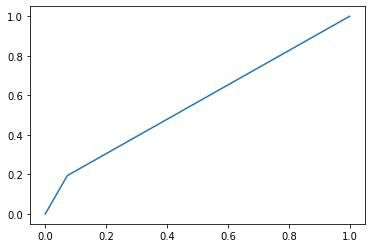

auto threshold


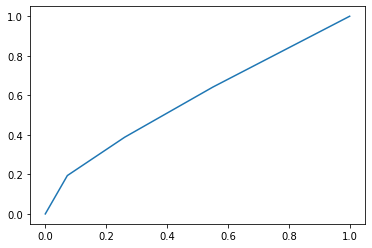

neighbours = 3 err_train = 0.10542168674698796 err_test = 0.4338235294117647
[[51 18]
 [41 26]]
Mera F1 Train: 0.46846846846846846
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


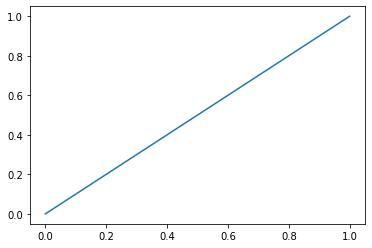

threshold =  0.2


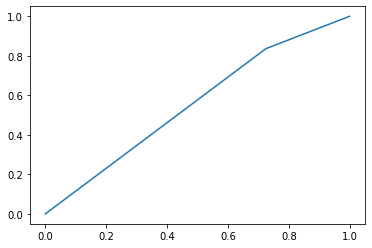

threshold =  0.4


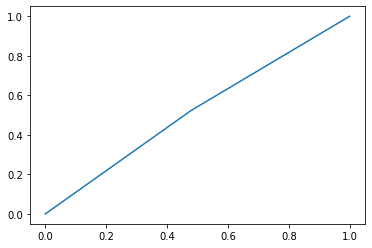

threshold =  0.5


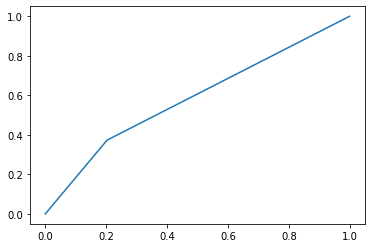

threshold =  0.7


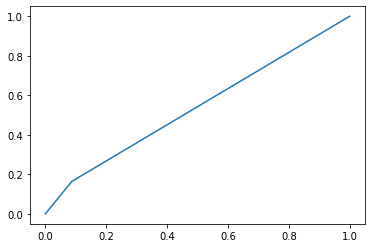

threshold =  0.8


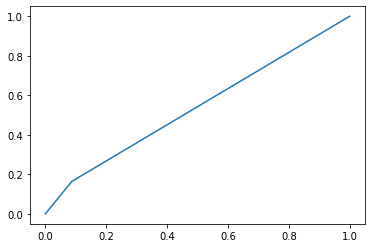

auto threshold


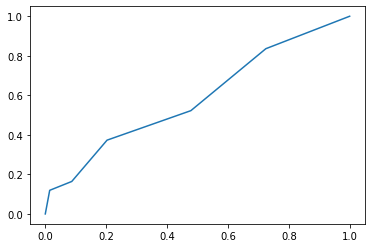

neighbours = 5 err_train = 0.1716867469879518 err_test = 0.4117647058823529
[[55 14]
 [42 25]]
Mera F1 Train: 0.4716981132075472
Precision Score Train:  0.5882352941176471
Recall Score Train:  0.5882352941176471
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


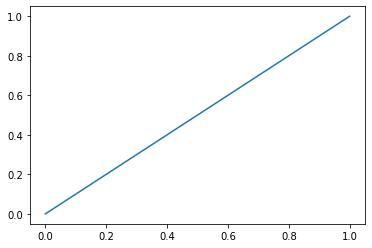

threshold =  0.2


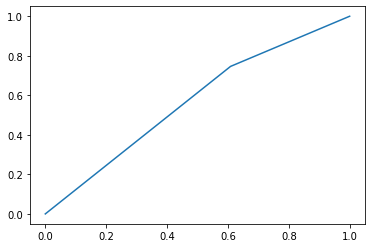

threshold =  0.4


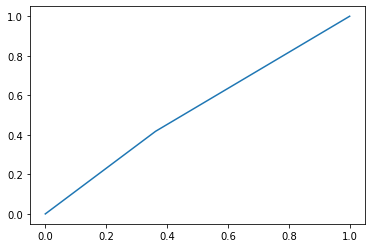

threshold =  0.5


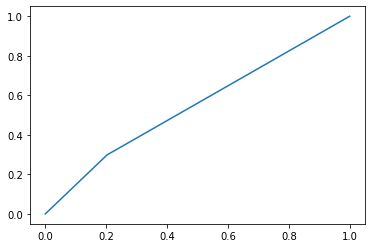

threshold =  0.7


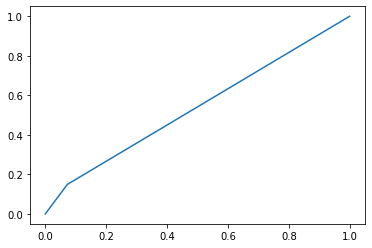

threshold =  0.8


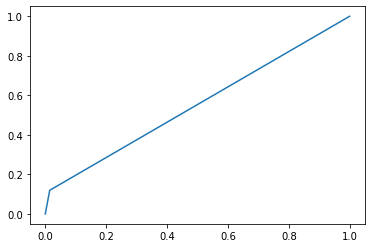

auto threshold


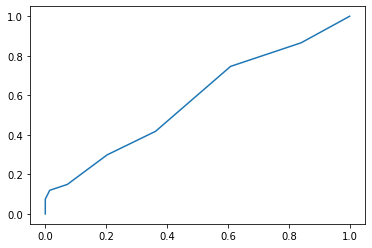

neighbours = 7 err_train = 0.21385542168674698 err_test = 0.4485294117647059
[[55 14]
 [47 20]]
Mera F1 Train: 0.396039603960396
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


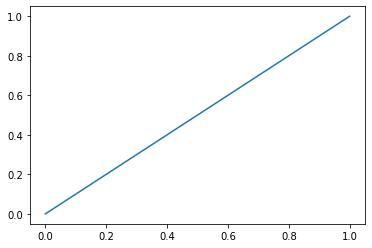

threshold =  0.2


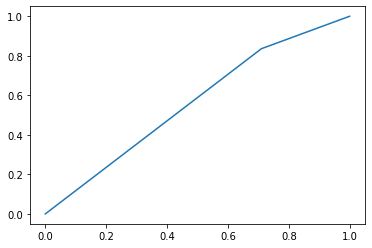

threshold =  0.4


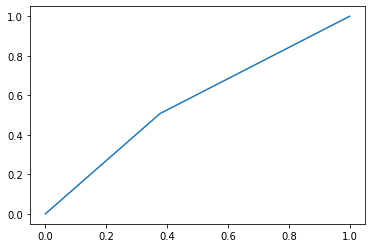

threshold =  0.5


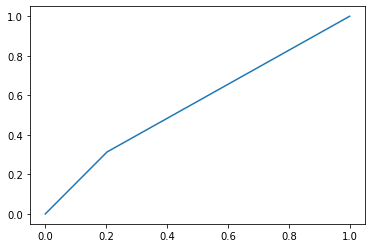

threshold =  0.7


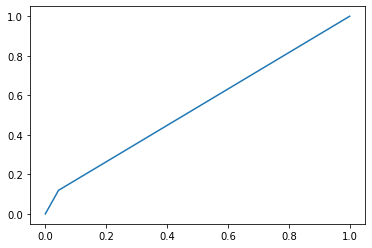

threshold =  0.8


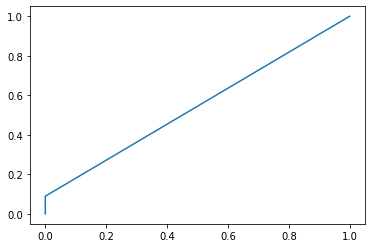

auto threshold


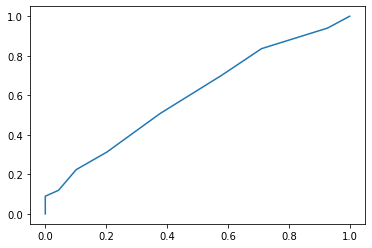

neighbours = 10 err_train = 0.27710843373493976 err_test = 0.4338235294117647
[[62  7]
 [52 15]]
Mera F1 Train: 0.3370786516853933
Precision Score Train:  0.5661764705882353
Recall Score Train:  0.5661764705882353
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


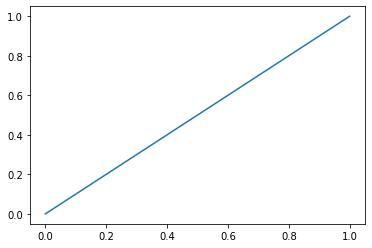

threshold =  0.2


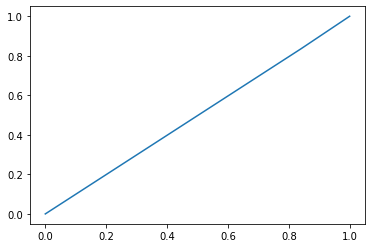

threshold =  0.4


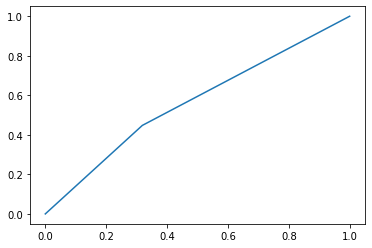

threshold =  0.5


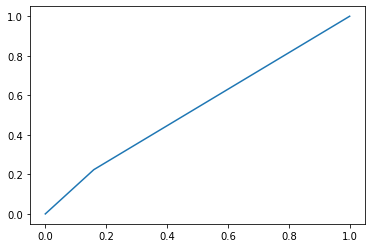

threshold =  0.7


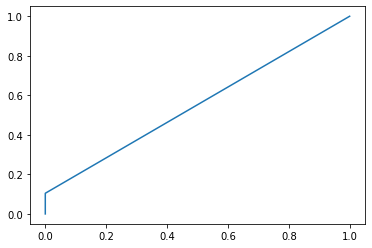

threshold =  0.8


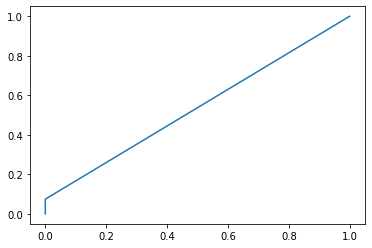

auto threshold


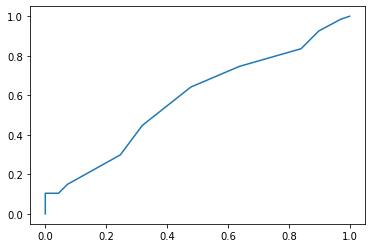

neighbours = 15 err_train = 0.30120481927710846 err_test = 0.4632352941176471
[[58 11]
 [52 15]]
Mera F1 Train: 0.3225806451612903
Precision Score Train:  0.5367647058823529
Recall Score Train:  0.5367647058823529
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


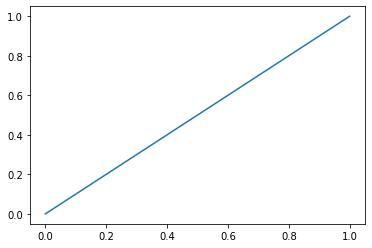

threshold =  0.2


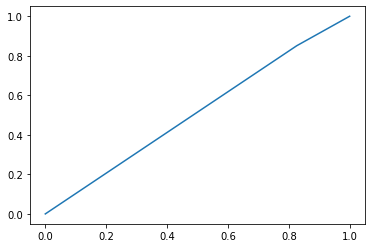

threshold =  0.4


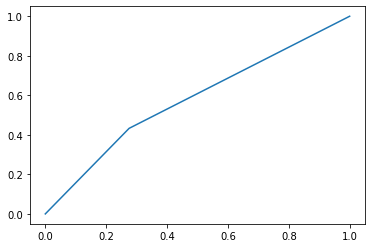

threshold =  0.5


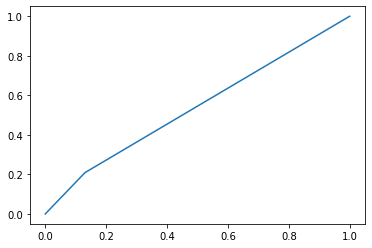

threshold =  0.7


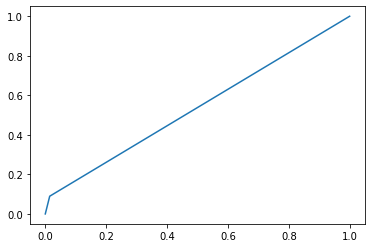

threshold =  0.8


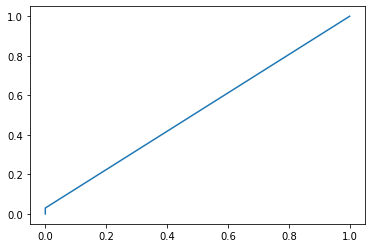

auto threshold


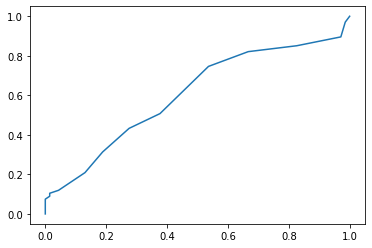

neighbours = 20 err_train = 0.34036144578313254 err_test = 0.45588235294117646
[[64  5]
 [57 10]]
Mera F1 Train: 0.24390243902439024
Precision Score Train:  0.5441176470588235
Recall Score Train:  0.5441176470588235
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


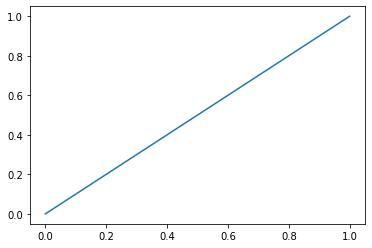

threshold =  0.2


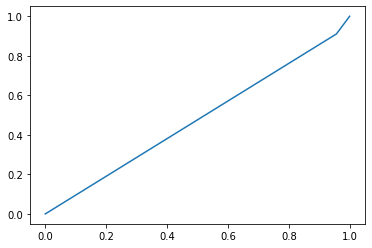

threshold =  0.4


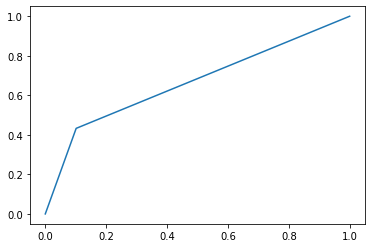

threshold =  0.5


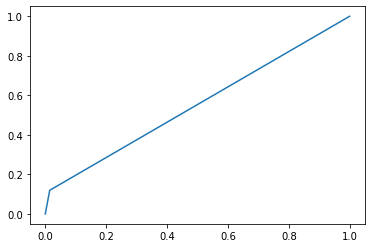

threshold =  0.7


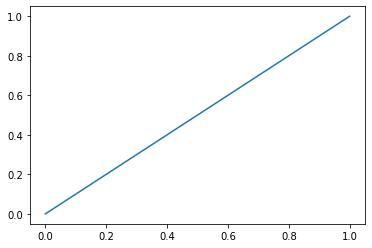

threshold =  0.8


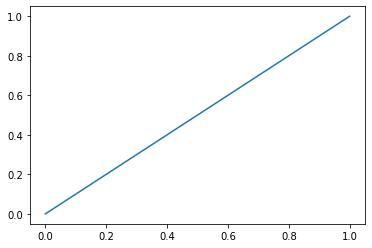

auto threshold


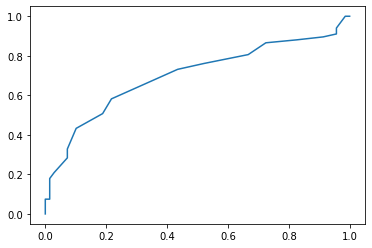

neighbours = 50 err_train = 0.4246987951807229 err_test = 0.4485294117647059
[[68  1]
 [60  7]]
Mera F1 Train: 0.18666666666666668
Precision Score Train:  0.5514705882352942
Recall Score Train:  0.5514705882352942
threshold =  0.0


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


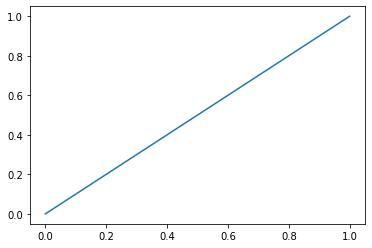

threshold =  0.2


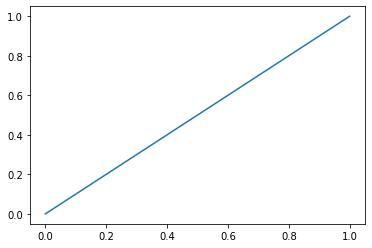

threshold =  0.4


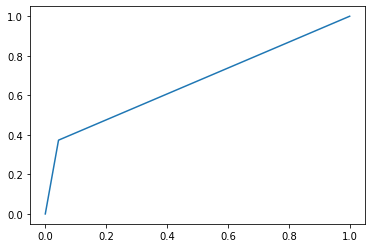

threshold =  0.5


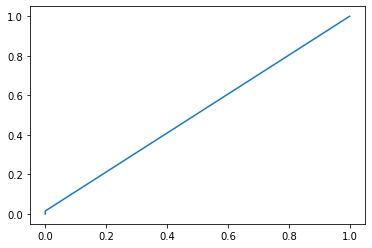

threshold =  0.7


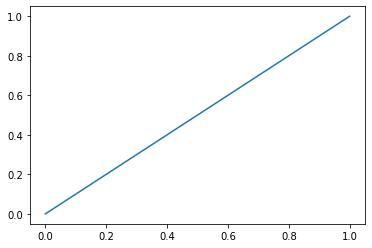

threshold =  0.8


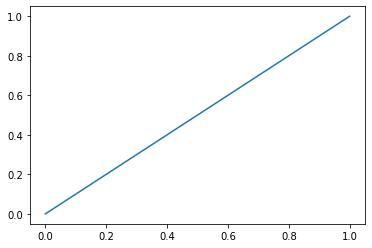

auto threshold


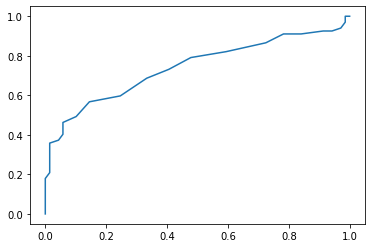

neighbours = 100 err_train = 0.4819277108433735 err_test = 0.49264705882352944
[[69  0]
 [67  0]]
Mera F1 Train: 0.0
Precision Score Train:  0.5073529411764706
Recall Score Train:  0.5073529411764706


H:\Anaconda\lib\site-packages\sklearn\metrics\_classification.py:1270: UserWarning: Note that pos_label (set to 'positive') is ignored when average != 'binary' (got 'micro'). You may use labels=[pos_label] to specify a single positive class.
  % (pos_label, average), UserWarning)


In [467]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,precision_score,recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
neighbors_array = np.array([2,3,5,7,10,15,20,50,100])
tresholds_array = np.array([0.0,0.2,0.4,0.5,0.7,0.8])
for i in range (9):
    knn = KNeighborsClassifier(n_neighbors = neighbors_array[i])
    knn.fit(X_resampled, y_resampled)
    
    y_train_predict = knn.predict(X_resampled)
    err_train  = np.mean(y_resampled  !=  y_train_predict)
    y_test_predict = knn.predict(X_test)
    err_test  = np.mean(y_test  != y_test_predict)
    Knn_test[15][i]=err_test
    Knn_train[15][i]=err_train
    for j in range (6):
        print("threshold = ",tresholds_array[j])
        fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1]>=tresholds_array[j])
        plt.plot(fpr,tpr,label="ROC")
        plt.show()
    print("auto threshold")
    fpr,tpr,thresholds=roc_curve(y_test,knn.predict_proba(X_test)[:,1])
    plt.plot(fpr,tpr,label="ROC")
    plt.show()
    print('neighbours =',neighbors_array[i],'err_train =',err_train,'err_test =', err_test)
    print(confusion_matrix(y_test,y_test_predict))
    print("Mera F1 Train:",f1_score(y_test,y_test_predict))
    print("Precision Score Train: ",precision_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    print("Recall Score Train: ",recall_score(y_test, y_test_predict, pos_label='positive',average='micro'))
    i=i+1

## Support Vector Classifier

In [468]:
from sklearn.svm import SVC
svc_model = SVC(kernel = 'rbf')
svc_model.fit(X_resampled, y_resampled)
err_train = np.mean(y_resampled != svc_model.predict(X_resampled))
err_test = np.mean(y_test != svc_model.predict(X_test))
SVC_test[15]= err_test
SVC_train[15]= err_train
print ('err_train_SVC =',err_train,'err_test_SVC =', err_test)

err_train_SVC = 0.21686746987951808 err_test_SVC = 0.2867647058823529


In [469]:
print('Test Err in Knn')
print("%-31s"%('Method'),'|',"%-7s"%('n = 2'),'|',"%-7s"%('n = 3'),'|',"%-7s"%('n = 5'),'|',"%-7s"%('n = 7'),'|',"%-7s"%('n = 10'),'|',"%-7s"%('n = 15'),'|',"%-7s"%('n = 20'),'|',"%-7s"%('n = 50'),'|',"%-7s"%('n = 100'))
for i in range(16):
    print("%-31s"%(methods[i]),'|',"%.5f"%(Knn_test[i][0]),'|',"%.5f"%(Knn_test[i][1]),'|',"%.5f"%(Knn_test[i][2]),'|',"%.5f"%(Knn_test[i][3]),'|',"%.5f"%(Knn_test[i][4]),'|',"%.5f"%(Knn_test[i][5]),'|',"%.5f"%(Knn_test[i][6]),'|',"%.5f"%(Knn_test[i][7]),'|',"%.5f"%(Knn_test[i][8]))

Test Err in Knn
Method                          | n = 2   | n = 3   | n = 5   | n = 7   | n = 10  | n = 15  | n = 20  | n = 50  | n = 100
Naive                           | 0.42647 | 0.42647 | 0.44118 | 0.44118 | 0.47059 | 0.50735 | 0.47794 | 0.46324 | 0.49265
SMOTE                           | 0.45588 | 0.47794 | 0.46324 | 0.44853 | 0.43382 | 0.46324 | 0.47059 | 0.41912 | 0.45588
BorderlineSMOTE                 | 0.41176 | 0.38235 | 0.43382 | 0.44853 | 0.44853 | 0.47794 | 0.44118 | 0.45588 | 0.48529
ADASYN                          | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000
ClusterCentroids                | 0.41176 | 0.39706 | 0.44853 | 0.45588 | 0.47059 | 0.45588 | 0.43382 | 0.45588 | 0.49265
RandomUnderSampler              | 0.41176 | 0.41912 | 0.44853 | 0.46324 | 0.47794 | 0.45588 | 0.44118 | 0.46324 | 0.49265
NearMiss                        | 0.41176 | 0.39706 | 0.44118 | 0.44853 | 0.45588 | 0.44118 | 0.45588 | 0.47059 | 0.49265
EditedNe

In [470]:
print('Train Err in Knn')
print("%-31s"%('Method'),'|',"%-7s"%('n = 2'),'|',"%-7s"%('n = 3'),'|',"%-7s"%('n = 5'),'|',"%-7s"%('n = 7'),'|',"%-7s"%('n = 10'),'|',"%-7s"%('n = 15'),'|',"%-7s"%('n = 20'),'|',"%-7s"%('n = 50'),'|',"%-7s"%('n = 100'))
for i in range(16):
    print("%-31s"%(methods[i]),'|',"%.5f"%(Knn_train[i][0]),'|',"%.5f"%(Knn_train[i][1]),'|',"%.5f"%(Knn_train[i][2]),'|',"%.5f"%(Knn_train[i][3]),'|',"%.5f"%(Knn_train[i][4]),'|',"%.5f"%(Knn_train[i][5]),'|',"%.5f"%(Knn_train[i][6]),'|',"%.5f"%(Knn_train[i][7]),'|',"%.5f"%(Knn_train[i][8]))

Train Err in Knn
Method                          | n = 2   | n = 3   | n = 5   | n = 7   | n = 10  | n = 15  | n = 20  | n = 50  | n = 100
Naive                           | 0.15909 | 0.15057 | 0.18466 | 0.21591 | 0.28693 | 0.29545 | 0.34943 | 0.43466 | 0.48580
SMOTE                           | 0.12216 | 0.13068 | 0.17898 | 0.21023 | 0.29545 | 0.29830 | 0.33523 | 0.41193 | 0.45739
BorderlineSMOTE                 | 0.11932 | 0.13636 | 0.15909 | 0.17898 | 0.26705 | 0.26420 | 0.34375 | 0.41761 | 0.47443
ADASYN                          | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000 | 0.00000
ClusterCentroids                | 0.24286 | 0.18571 | 0.25000 | 0.30000 | 0.33571 | 0.33571 | 0.37143 | 0.46071 | 0.49643
RandomUnderSampler              | 0.22500 | 0.15000 | 0.23929 | 0.28929 | 0.33571 | 0.32500 | 0.38571 | 0.45357 | 0.49643
NearMiss                        | 0.22857 | 0.17143 | 0.23929 | 0.27143 | 0.35357 | 0.35357 | 0.38214 | 0.46071 | 0.50000
EditedN

In [471]:
print('Errors in SVC')
print("%-31s"%('Method'),'|',"{:^10}".format('Train'),'|',"{:^10}".format('Test'),'|')
for i in range(16):
    print("%-31s"%(methods[i]),'|',"%.8f"%(SVC_train[i]),'|',"%.8f"%(SVC_test[i]),'|')


Errors in SVC
Method                          |   Train    |    Test    |
Naive                           | 0.20170455 | 0.30882353 |
SMOTE                           | 0.24715909 | 0.29411765 |
BorderlineSMOTE                 | 0.22443182 | 0.27941176 |
ADASYN                          | 0.00000000 | 0.00000000 |
ClusterCentroids                | 0.23571429 | 0.32352941 |
RandomUnderSampler              | 0.22857143 | 0.31617647 |
NearMiss                        | 0.21428571 | 0.30882353 |
EditedNearestNeighbours         | 0.16000000 | 0.38970588 |
RepeatedEditedNearestNeighbours | 0.16000000 | 0.38970588 |
AllKNN                          | 0.07065217 | 0.37500000 |
CondensedNearestNeighbour       | 0.33014354 | 0.50735294 |
OneSidedSelection               | 0.20333333 | 0.31617647 |
NeighbourhoodCleaningRule       | 0.25120773 | 0.50735294 |
Instance hardness threshold     | 0.21071429 | 0.30147059 |
SMOTEENN                        | 0.14503817 | 0.34558824 |
SMOTETomek                